In [1]:
import torch
from torch import nn
import torch.utils.data as Data
import torch.optim as optim
import numpy as np
from os.path import join as PJ
import matplotlib.pyplot as plt 

In [2]:
from torch.utils.data import Dataset
from torchvision import transforms
from PIL import Image,ImageOps

In [3]:
import tensorflow as tf

In [5]:
def LoadFiles(mode="train"):
    if mode == "train":
        with open(TrainFile, 'r') as trainf:
            image_info = trainf.readlines()
            image_info = [path.strip().split() for path in image_info]
            image_info = np.asarray(image_info)

            # Split to image path and label
            image_paths = image_info[:, 0]
            label_ids = image_info[:, 1].astype(int)

#             labels = tf.one_hot(label_ids, num_class, dtype=tf.int32)
            print("in Load : ", label_ids.shape)
            return image_paths, label_ids
    else:
        with open(TestFile, 'r') as testf:
            image_info = testf.readlines()
            image_info = [path.strip().split() for path in image_info]
            image_info = np.asarray(image_info)

            # Split to image path and label
            image_paths = image_info[:, 0]
            label_ids = image_info[:, 1].astype(int)
#             labels = tf.one_hot(label_ids, num_class, dtype=tf.int32)
            return image_paths, label_ids

In [6]:
import cv2
class TermiteDataset(Dataset):
    def __init__(self, data_file, transform):
        
        with open(data_file, 'r') as f:
            image_info = f.readlines()
        image_info = [path.strip().split() for path in image_info]
        image_info = np.asarray(image_info)

        # Split to image path and label
        self.image_paths = image_info[:, 0]
        self.label_ids = image_info[:, 1].astype(int)
        self.transform = transform
        
    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
#         print(idx, self.label_ids.shape, self.label_ids[idx])
        label = self.label_ids[idx]
        image_path = self.image_paths[idx]
        original_image = Image.open(image_path).convert('RGB')
        
#         print(original_image.size)
        
        if original_image.size[0] > 1000:
            original_image = original_image.resize((1000, original_image.size[1]*1000//original_image.size[0]))
        elif original_image.size[1] > 1000:
            original_image = original_image.resize((original_image.size[0]*1000//original_image.size[1], 1000))
#         print(original_image.shape)
        left = 500-original_image.size[0]//2
        right = 500-original_image.size[0]//2
        top = 500-original_image.size[1]//2
        bottom = 500-original_image.size[1]//2
        
        if left + right + original_image.size[0] != 1000:
            right = 1000 - left - original_image.size[0]
        if top + bottom + original_image.size[1] != 1000:
            top = 1000 - bottom - original_image.size[1]
        
#         original_image= cv2.copyMakeBorder(original_image,left,right,top,bottom,cv2.BORDER_CONSTANT,value=(0, 0, 0))
        original_image = ImageOps.expand(original_image, border=(left,top,right,bottom), fill=0)##left,top,right,bottom
        original_image = original_image.resize((130,130))
        transform1 = transforms.Compose([transforms.ToTensor()])
        original_image = transform1(original_image)
#         print(original_image.shape)
        
        
#         original_image = self.transform(original_image)
#         original_image.permute(2,0,1)
#         print(original_image.shape, answer.shape)
        return label, original_image, self.image_paths[idx]

def transform_set(train, new_size=None, pad=None):
    """
    train: True or False
    new_size: int or tuple
    
    """
#     transform_list = [transforms.ToTensor(),
#                       transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])]
    transform_list = [transforms.ToTensor()]
    # replace centercrop to padding
#     transform_list = [transforms.CenterCrop((crop_h, crop_w))] + transform_list if crop else transform_list
#     transform_list = [transforms.Resize(new_size)] + transform_list if new_size is not None else transform_list

#     transform_list = [transforms.RandomHorizontalFlip()] + transform_list if train else transform_list
    transform = transforms.Compose(transform_list)
    return transform

In [7]:
def CheckFile(filename):
    with open(filename, 'r') as f:
            image_info = f.readlines()
    image_info = [path.strip().split() for path in image_info]
    image_info = np.asarray(image_info)
    counts = {"台灣土白蟻兵蟻" : 0,
             "台灣土白蟻工蟻" : 0,
             "台灣家白蟻兵蟻" : 0,
             "台灣家白蟻工蟻" : 0,
             "截頭堆沙兵蟻" : 0,
             "截頭堆沙工蟻" : 0,
             "黃肢散工蟻" : 0,
             "黃肢散兵蟻" : 0,}
        
    Locations = {"L1" : 0,
             "L2" : 0,
             "L3" : 0}
    for line in image_info:
        path = line[0]
        if "L1" in path:
            Locations["L1"] += 1
        if "L2" in path:
            Locations["L2"] += 1
        if "L3" in path:
            Locations["L3"] += 1
        if "台灣土白蟻兵蟻" in path:
            counts["台灣土白蟻兵蟻"] += 1
        if "台灣土白蟻工蟻" in path:
            counts["台灣土白蟻工蟻"] += 1
        if "台灣家白蟻兵蟻" in path:
            counts["台灣家白蟻兵蟻"] += 1
        if "台灣家白蟻工蟻" in path:
            counts["台灣家白蟻工蟻"] += 1
        if "截頭堆沙兵蟻" in path:
            counts["截頭堆沙兵蟻"] += 1
        if "截頭堆沙工蟻" in path:
            counts["截頭堆沙工蟻"] += 1
        if "黃肢散兵蟻" in path:
            counts["黃肢散兵蟻"] += 1
        if "黃肢散工蟻" in path:
            counts["黃肢散工蟻"] += 1
    print(Locations, counts)

In [8]:
BATCH_SIZE = 64
EPOCH = 164
LearningRate = 0.0001
Momentum = 0.9
TrainFile = "/home/ytliu/Termite-Bonnie/PAPER_termite/BENCHMARK-LARGE_Ind_trainfile_worker_2.txt"
ValFile = "/home/ytliu/Termite-Bonnie/PAPER_termite/BENCHMARK-LARGE_Ind_valfile_worker_2.txt"
TestFile = "/home/ytliu/Termite-Bonnie/PAPER_termite/BENCHMARK-LARGE_Ind_testfile_worker_2.txt"
classes = ["O.f Worker","C.f Worker","C.d Worker", "R.f Worker"]
model_directory = "/home/ytliu/Termite-Bonnie/PAPER_termite/*BENCHMARK-LARGE_Worker_2/"
test_directory = "/home/ytliu/Termite-Bonnie/PAPER_termite/*BENCHMARK-LARGE_Worker_2/"

In [1]:
print("TrainFile : ", TrainFile)
print("ValidationFile : ", ValFile)
print("TestFile : ", TestFile)
CheckFile(TrainFile)
CheckFile(ValFile)
CheckFile(TestFile)

NameError: name 'TrainFile' is not defined

In [10]:
import torchvision.models as models
import os
# from MobileNetV2 import MobileNetV2
print(torch.__version__)
# torch.cuda.set_device(0)
print(torch.cuda.current_device())
# mobilenet =  MobileNetV2(n_class=len(classes)).cuda()
mobilenet =  nn.Sequential(models.mobilenet_v2(pretrained=True), nn.Linear(1000, len(classes))).cuda()

1.3.0
0


In [11]:
model = mobilenet
# model = MobileNet(len(classes))
# model.to(cuda)
# model = model.cuda()
model = model
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(model.parameters(), lr=LearningRate, momentum=Momentum)

In [12]:
transform = transform_set(train=True)
trainset = TermiteDataset(TrainFile, transform)
trainloader = Data.DataLoader(
    dataset=trainset,      # torch TensorDataset format
    batch_size=BATCH_SIZE,      # mini batch size
    shuffle=True,               # 要不要打乱数据 (打乱比较好)
    num_workers=0,              # 多线程来读数据
)

In [13]:
transform2 = transform_set(train=False)
valset = TermiteDataset(ValFile, transform2)
valloader = Data.DataLoader(
    dataset=valset,      # torch TensorDataset format
    batch_size=BATCH_SIZE,      # mini batch size
    shuffle=True,               # 要不要打乱数据 (打乱比较好)
    num_workers=0,              # 多线程来读数据
)

In [14]:
# for labels, images in loader:
#     print(labels.shape)
#     print(images.shape)
#     ssssss

# TRAIN
### 
### validation

Train
[1, 00020] loss: 22.918 acc: 0.550
[1, 00040] loss: 29.991 acc: 0.710
[1, 00060] loss: 34.696 acc: 0.780
[1, 00080] loss: 38.364 acc: 0.819
[1, 00100] loss: 41.633 acc: 0.843
[0.8434375]
[41.63294889032841]


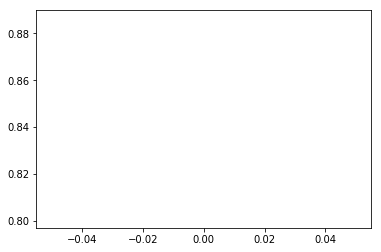

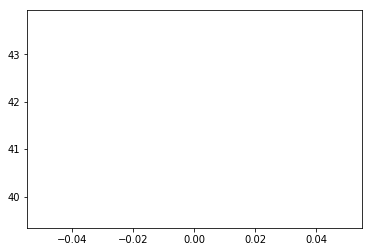

Validation
[0.948125]
[3.797313243150711]


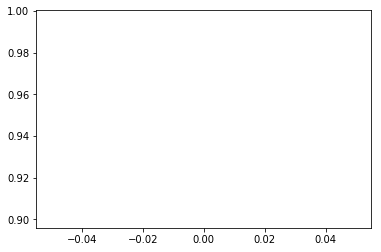

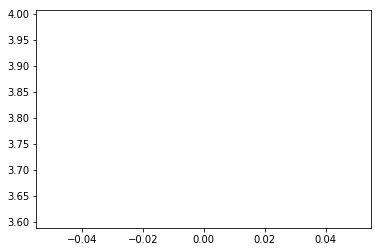


[1] accuracy: 0.948 loss: 3.797

Train
[2, 00020] loss: 2.522 acc: 0.962
[2, 00040] loss: 4.982 acc: 0.958
[2, 00060] loss: 7.087 acc: 0.960
[2, 00080] loss: 8.992 acc: 0.962
[2, 00100] loss: 10.686 acc: 0.964
[0.8434375, 0.96375]
[41.63294889032841, 10.686292132362723]


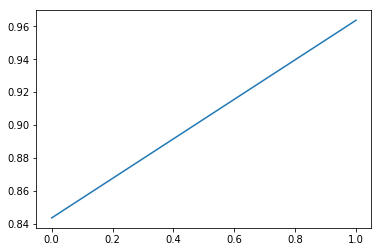

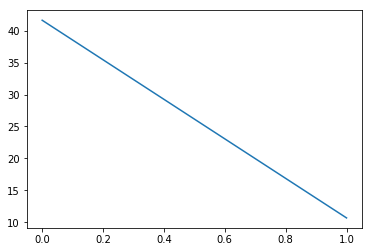

Validation
[0.948125, 0.961875]
[3.797313243150711, 2.652056358754635]


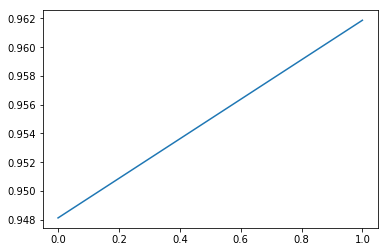

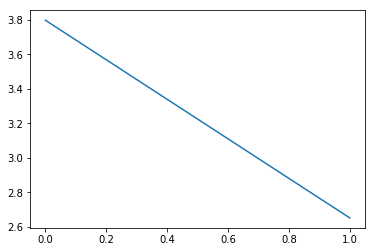


[2] accuracy: 0.962 loss: 2.652

Train
[3, 00020] loss: 1.426 acc: 0.978
[3, 00040] loss: 2.885 acc: 0.975
[3, 00060] loss: 4.143 acc: 0.977
[3, 00080] loss: 5.450 acc: 0.977
[3, 00100] loss: 6.593 acc: 0.977
[0.8434375, 0.96375, 0.97734375]
[41.63294889032841, 10.686292132362723, 6.593271611258388]


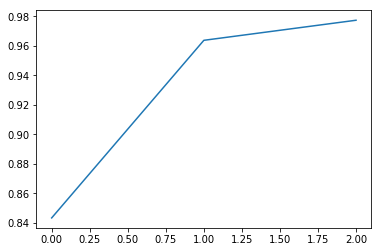

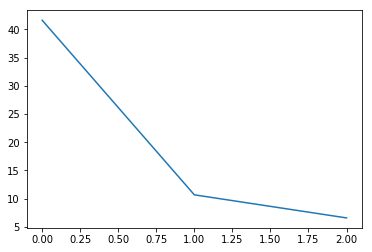

Validation
[0.948125, 0.961875, 0.97375]
[3.797313243150711, 2.652056358754635, 1.8950053676962852]


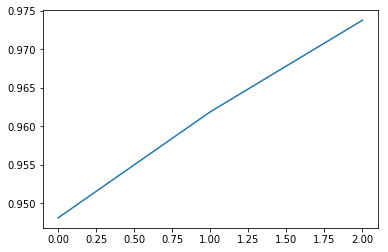

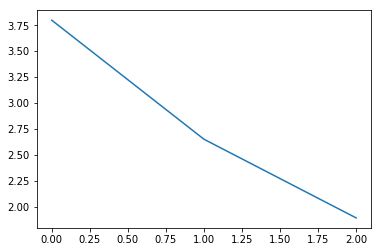


[3] accuracy: 0.974 loss: 1.895

Train
[4, 00020] loss: 0.906 acc: 0.984
[4, 00040] loss: 1.828 acc: 0.985
[4, 00060] loss: 2.580 acc: 0.986
[4, 00080] loss: 3.580 acc: 0.987
[4, 00100] loss: 4.517 acc: 0.987
[0.8434375, 0.96375, 0.97734375, 0.9865625]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073]


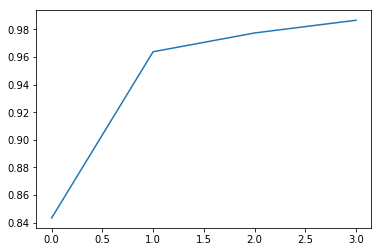

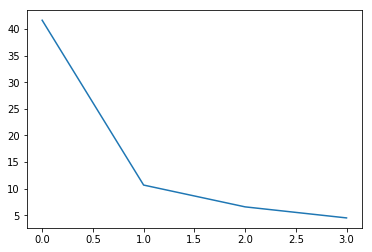

Validation
[0.948125, 0.961875, 0.97375, 0.97125]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742]


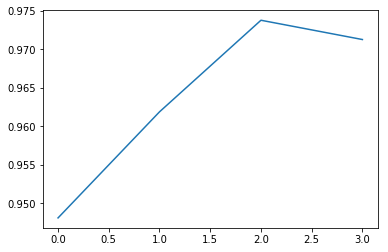

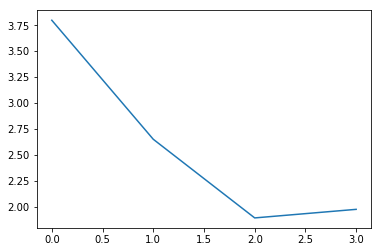


[4] accuracy: 0.971 loss: 1.977

Train
[5, 00020] loss: 0.724 acc: 0.992
[5, 00040] loss: 1.265 acc: 0.993
[5, 00060] loss: 1.756 acc: 0.994
[5, 00080] loss: 2.449 acc: 0.993
[5, 00100] loss: 3.045 acc: 0.993
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911]


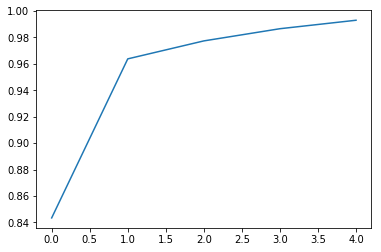

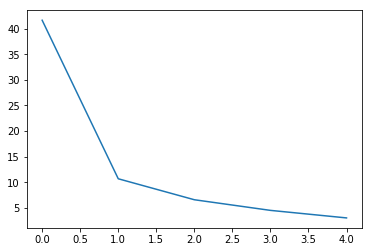

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416]


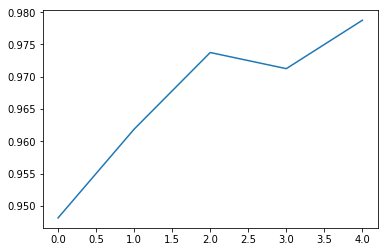

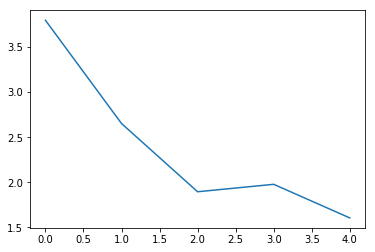


[5] accuracy: 0.979 loss: 1.605

Train
[6, 00020] loss: 0.539 acc: 0.995
[6, 00040] loss: 1.027 acc: 0.994
[6, 00060] loss: 1.437 acc: 0.994
[6, 00080] loss: 1.872 acc: 0.994
[6, 00100] loss: 2.403 acc: 0.994
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955]


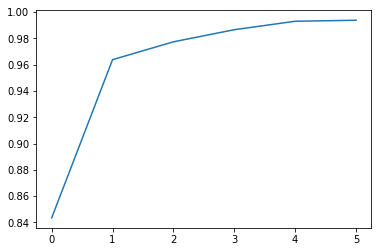

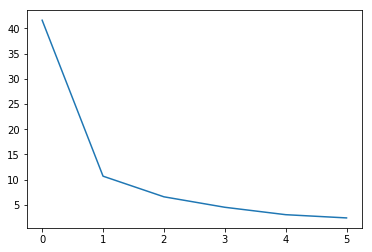

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562]


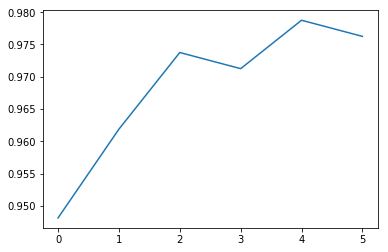

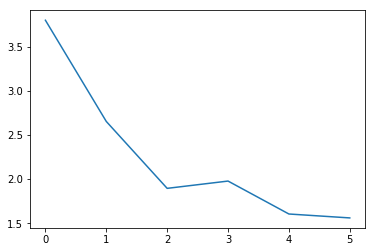


[6] accuracy: 0.976 loss: 1.560

Train
[7, 00020] loss: 0.355 acc: 0.996
[7, 00040] loss: 0.695 acc: 0.996
[7, 00060] loss: 0.990 acc: 0.996
[7, 00080] loss: 1.275 acc: 0.996
[7, 00100] loss: 1.708 acc: 0.996
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034]


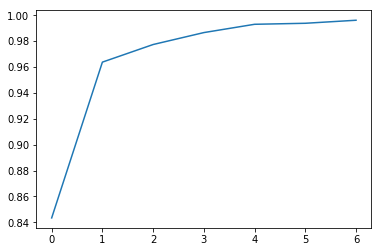

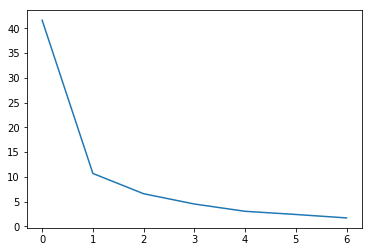

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816]


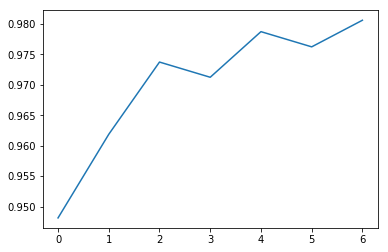

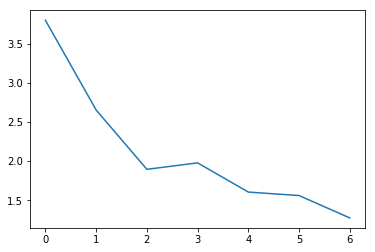


[7] accuracy: 0.981 loss: 1.275

Train
[8, 00020] loss: 0.350 acc: 0.995
[8, 00040] loss: 0.927 acc: 0.993
[8, 00060] loss: 1.164 acc: 0.995
[8, 00080] loss: 1.410 acc: 0.996
[8, 00100] loss: 1.664 acc: 0.996
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507]


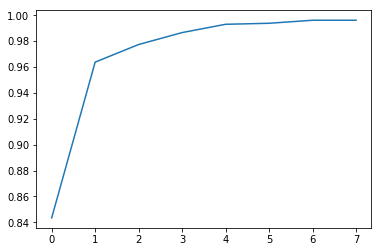

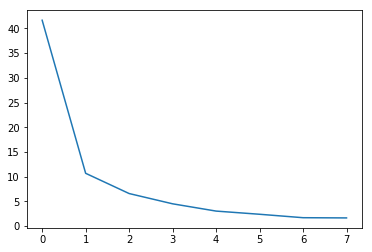

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647]


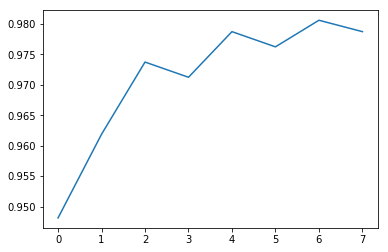

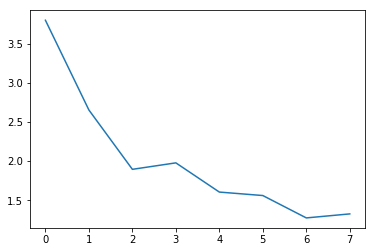


[8] accuracy: 0.979 loss: 1.326

Train
[9, 00020] loss: 0.195 acc: 0.998
[9, 00040] loss: 0.406 acc: 0.998
[9, 00060] loss: 0.642 acc: 0.997
[9, 00080] loss: 0.907 acc: 0.997
[9, 00100] loss: 1.119 acc: 0.998
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927]


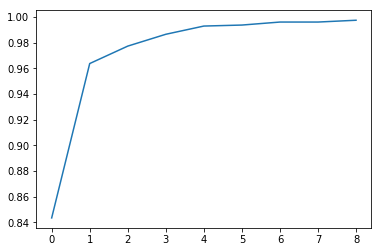

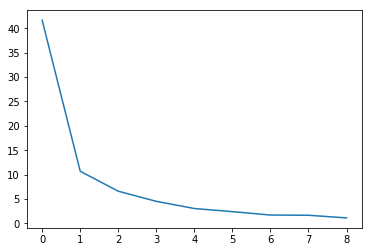

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027]


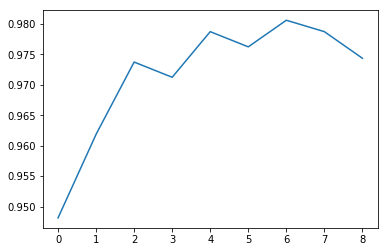

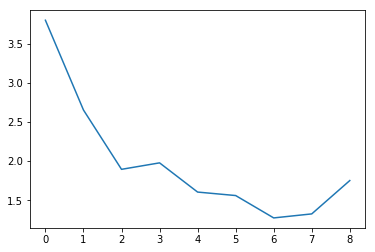


[9] accuracy: 0.974 loss: 1.752

Train
[10, 00020] loss: 0.195 acc: 0.998
[10, 00040] loss: 0.397 acc: 0.999
[10, 00060] loss: 0.570 acc: 0.999
[10, 00080] loss: 0.705 acc: 0.999
[10, 00100] loss: 0.870 acc: 0.999
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445]


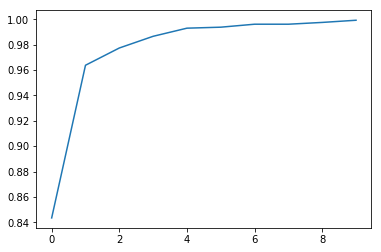

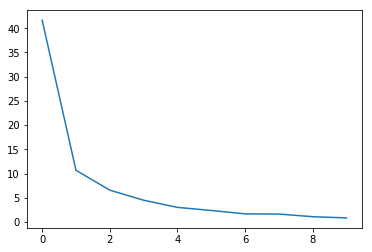

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707]


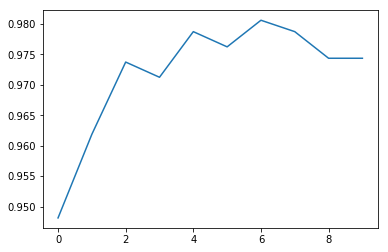

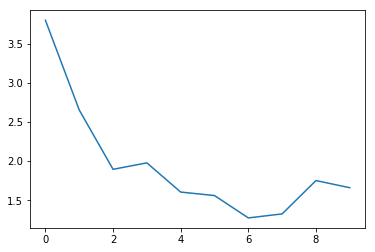


[10] accuracy: 0.974 loss: 1.660

Train
[11, 00020] loss: 0.136 acc: 1.000
[11, 00040] loss: 0.321 acc: 0.999
[11, 00060] loss: 0.509 acc: 0.999
[11, 00080] loss: 0.694 acc: 0.999
[11, 00100] loss: 0.865 acc: 0.999
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226]


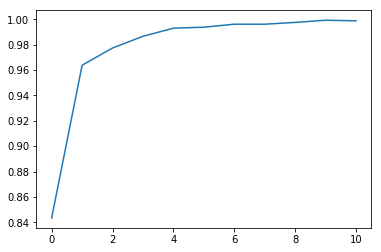

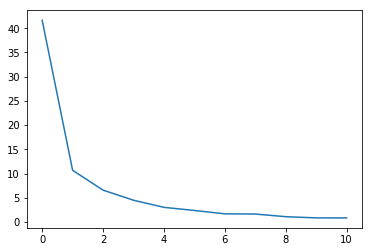

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597]


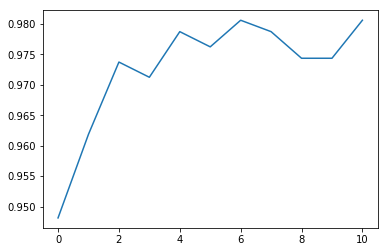

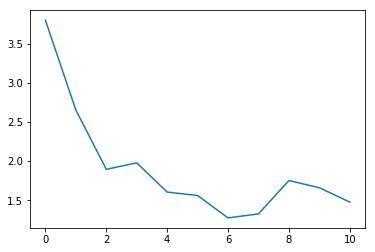


[11] accuracy: 0.981 loss: 1.477

Train
[12, 00020] loss: 0.106 acc: 1.000
[12, 00040] loss: 0.250 acc: 0.999
[12, 00060] loss: 0.466 acc: 0.999
[12, 00080] loss: 0.620 acc: 0.999
[12, 00100] loss: 0.767 acc: 0.999
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869]


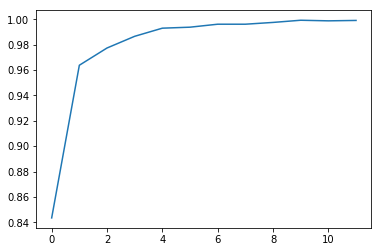

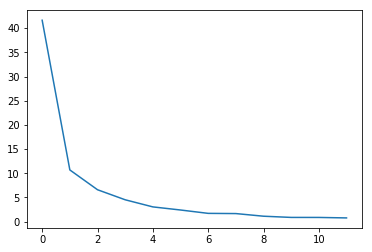

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446]


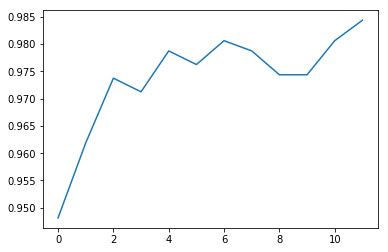

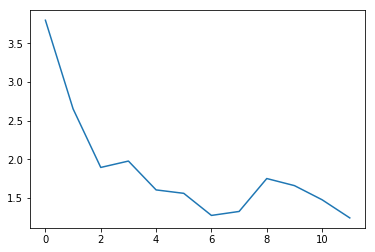


[12] accuracy: 0.984 loss: 1.243

Train
[13, 00020] loss: 0.129 acc: 0.998
[13, 00040] loss: 0.250 acc: 0.999
[13, 00060] loss: 0.425 acc: 0.998
[13, 00080] loss: 0.545 acc: 0.998
[13, 00100] loss: 0.691 acc: 0.999
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048]


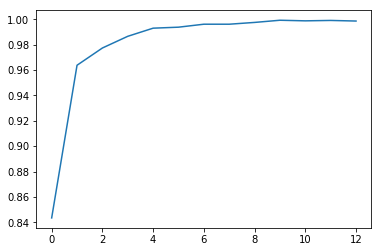

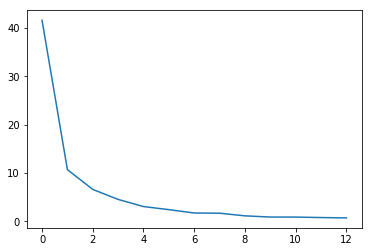

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926]


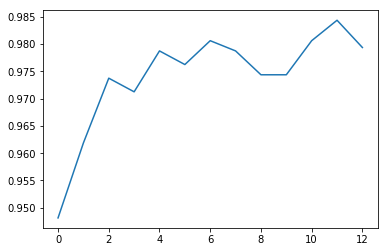

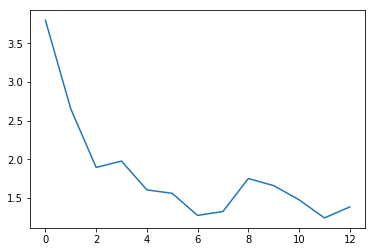


[13] accuracy: 0.979 loss: 1.385

Train
[14, 00020] loss: 0.097 acc: 1.000
[14, 00040] loss: 0.180 acc: 1.000
[14, 00060] loss: 0.284 acc: 1.000
[14, 00080] loss: 0.388 acc: 1.000
[14, 00100] loss: 0.494 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492]


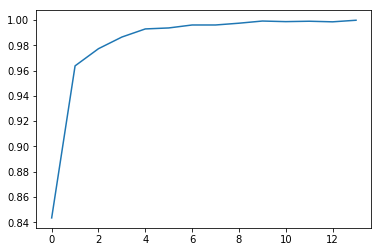

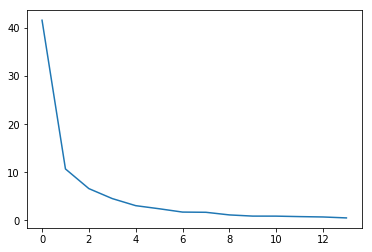

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412]


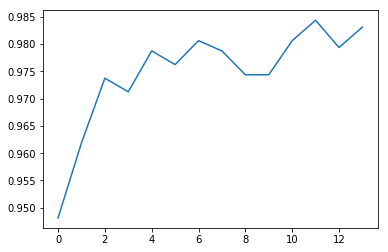

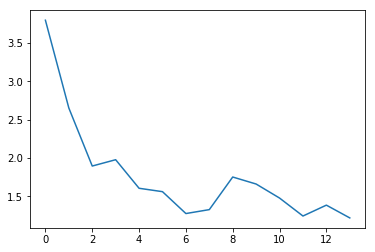


[14] accuracy: 0.983 loss: 1.218

Train
[15, 00020] loss: 0.080 acc: 1.000
[15, 00040] loss: 0.155 acc: 1.000
[15, 00060] loss: 0.259 acc: 1.000
[15, 00080] loss: 0.360 acc: 1.000
[15, 00100] loss: 0.425 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815]


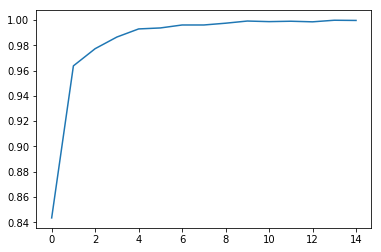

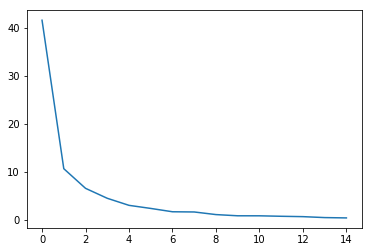

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977]


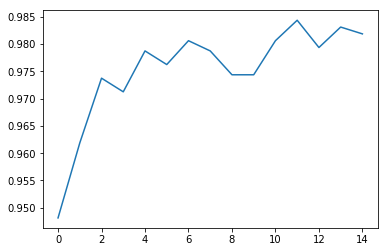

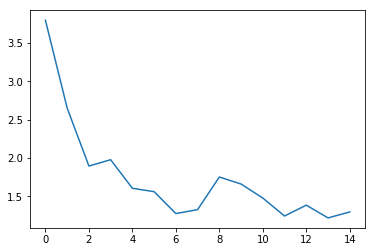


[15] accuracy: 0.982 loss: 1.296

Train
[16, 00020] loss: 0.158 acc: 0.998
[16, 00040] loss: 0.218 acc: 0.999
[16, 00060] loss: 0.314 acc: 0.999
[16, 00080] loss: 0.402 acc: 0.999
[16, 00100] loss: 0.482 acc: 0.999
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506]


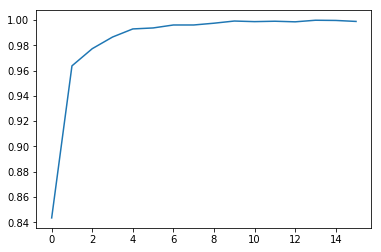

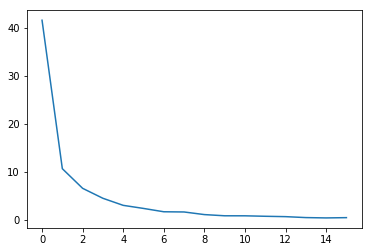

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392]


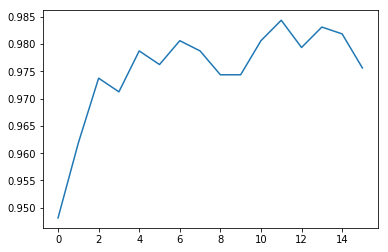

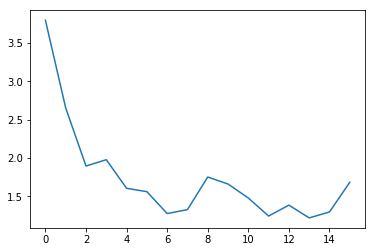


[16] accuracy: 0.976 loss: 1.683

Train
[17, 00020] loss: 0.083 acc: 1.000
[17, 00040] loss: 0.136 acc: 1.000
[17, 00060] loss: 0.230 acc: 1.000
[17, 00080] loss: 0.310 acc: 1.000
[17, 00100] loss: 0.359 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506, 0.35908495262265205]


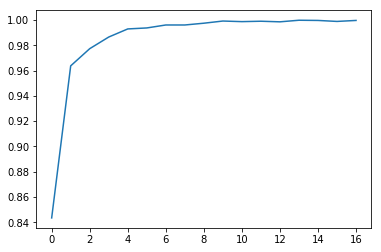

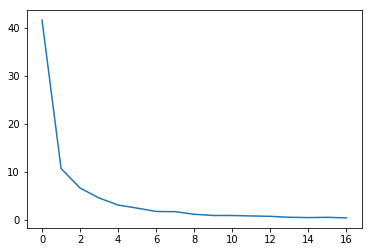

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821]


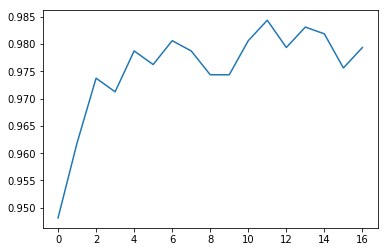

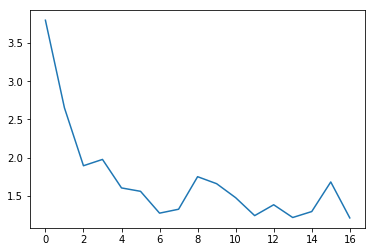


[17] accuracy: 0.979 loss: 1.213

Train
[18, 00020] loss: 0.080 acc: 0.999
[18, 00040] loss: 0.140 acc: 1.000
[18, 00060] loss: 0.243 acc: 0.999
[18, 00080] loss: 0.332 acc: 0.999
[18, 00100] loss: 0.401 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506, 0.35908495262265205, 0.4005425460636616]


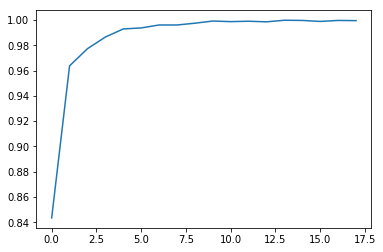

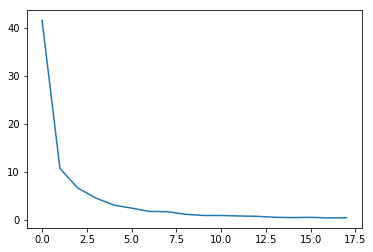

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056]


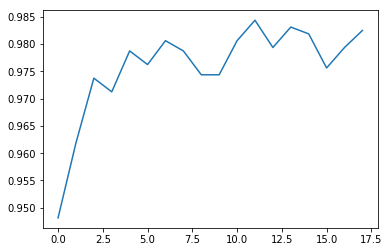

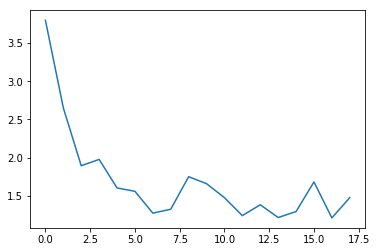


[18] accuracy: 0.983 loss: 1.478

Train
[19, 00020] loss: 0.080 acc: 1.000
[19, 00040] loss: 0.157 acc: 1.000
[19, 00060] loss: 0.274 acc: 1.000
[19, 00080] loss: 0.356 acc: 1.000
[19, 00100] loss: 0.468 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506, 0.35908495262265205, 0.4005425460636616, 0.4675099439918995]


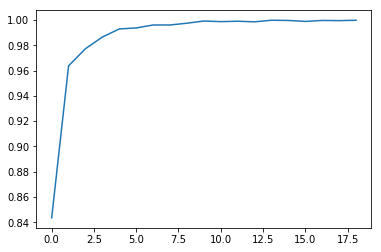

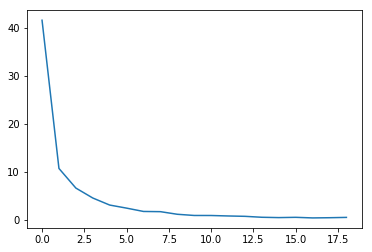

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527]


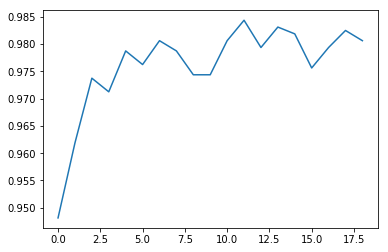

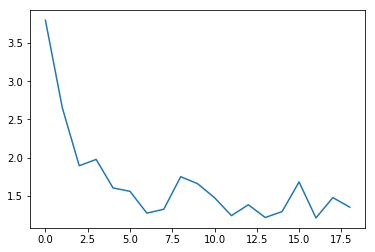


[19] accuracy: 0.981 loss: 1.353

Train
[20, 00020] loss: 0.030 acc: 1.000
[20, 00040] loss: 0.146 acc: 0.999
[20, 00060] loss: 0.194 acc: 0.999
[20, 00080] loss: 0.255 acc: 1.000
[20, 00100] loss: 0.303 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506, 0.35908495262265205, 0.4005425460636616, 0.4675099439918995, 0.30268749594688416]


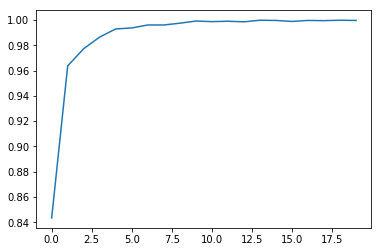

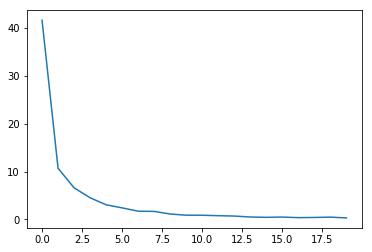

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257]


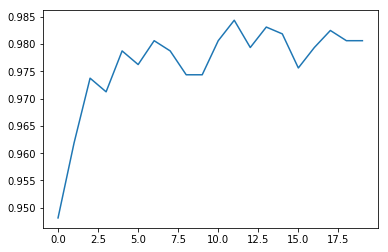

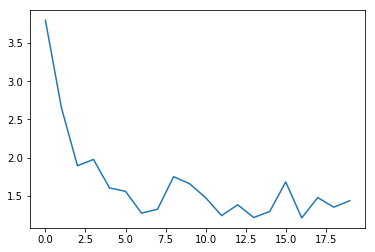


[20] accuracy: 0.981 loss: 1.438

Train
[21, 00020] loss: 0.049 acc: 1.000
[21, 00040] loss: 0.109 acc: 1.000
[21, 00060] loss: 0.205 acc: 1.000
[21, 00080] loss: 0.259 acc: 1.000
[21, 00100] loss: 0.307 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506, 0.35908495262265205, 0.4005425460636616, 0.4675099439918995, 0.30268749594688416, 0.30661361292004585]


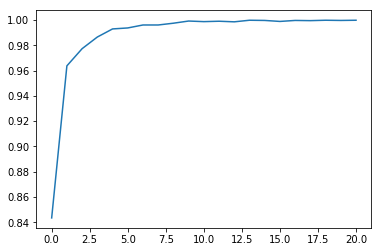

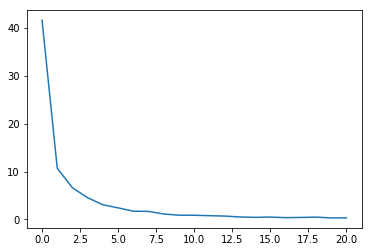

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198]


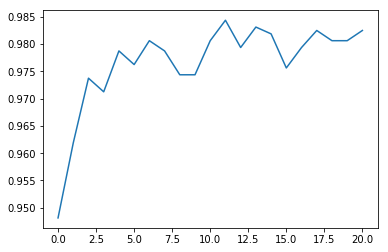

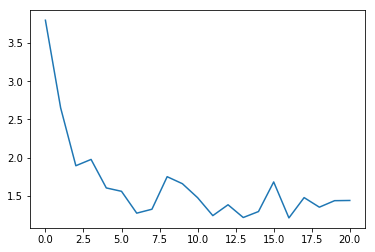


[21] accuracy: 0.983 loss: 1.441

Train
[22, 00020] loss: 0.054 acc: 0.999
[22, 00040] loss: 0.097 acc: 1.000
[22, 00060] loss: 0.156 acc: 1.000
[22, 00080] loss: 0.201 acc: 1.000
[22, 00100] loss: 0.246 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506, 0.35908495262265205, 0.4005425460636616, 0.4675099439918995, 0.30268749594688416, 0.30661361292004585, 0.2460223101079464]


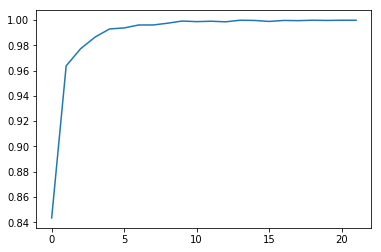

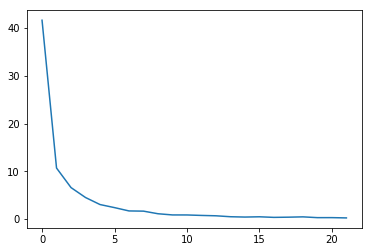

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848]


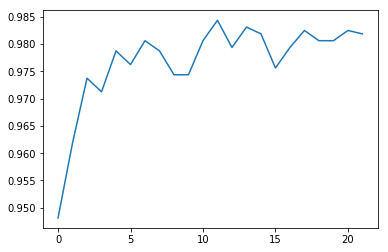

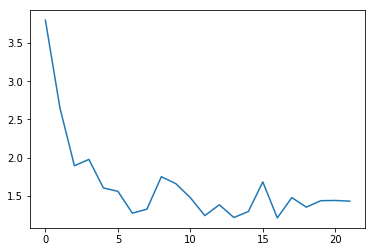


[22] accuracy: 0.982 loss: 1.432

Train
[23, 00020] loss: 0.039 acc: 1.000
[23, 00040] loss: 0.089 acc: 1.000
[23, 00060] loss: 0.141 acc: 1.000
[23, 00080] loss: 0.172 acc: 1.000
[23, 00100] loss: 0.240 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506, 0.35908495262265205, 0.4005425460636616, 0.4675099439918995, 0.30268749594688416, 0.30661361292004585, 0.2460223101079464, 0.23966453224420547]


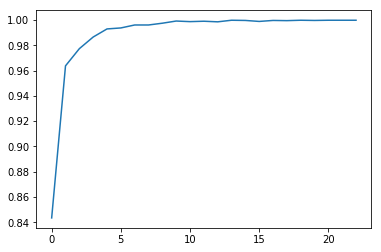

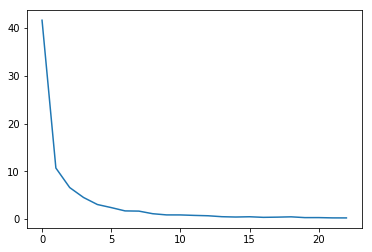

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527]


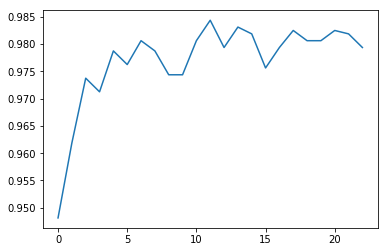

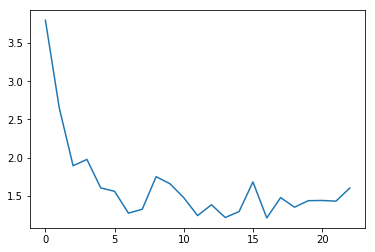


[23] accuracy: 0.979 loss: 1.603

Train
[24, 00020] loss: 0.058 acc: 1.000
[24, 00040] loss: 0.130 acc: 1.000
[24, 00060] loss: 0.166 acc: 1.000
[24, 00080] loss: 0.218 acc: 1.000
[24, 00100] loss: 0.256 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506, 0.35908495262265205, 0.4005425460636616, 0.4675099439918995, 0.30268749594688416, 0.30661361292004585, 0.2460223101079464, 0.23966453224420547, 0.256050780415535]


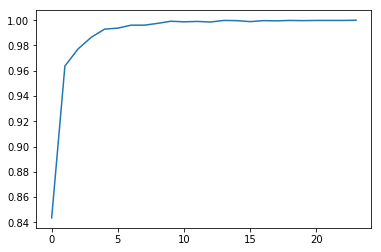

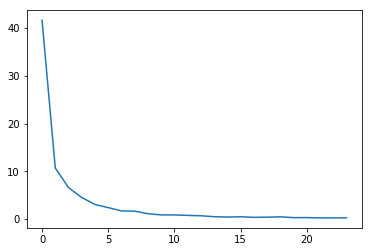

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093]


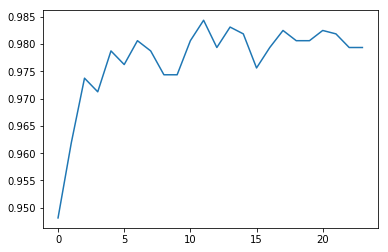

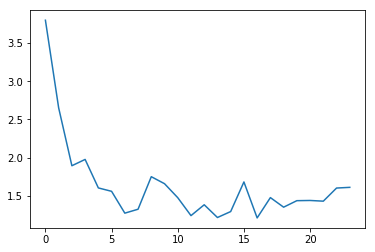


[24] accuracy: 0.979 loss: 1.612

Train
[25, 00020] loss: 0.038 acc: 1.000
[25, 00040] loss: 0.098 acc: 1.000
[25, 00060] loss: 0.157 acc: 0.999
[25, 00080] loss: 0.192 acc: 1.000
[25, 00100] loss: 0.224 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506, 0.35908495262265205, 0.4005425460636616, 0.4675099439918995, 0.30268749594688416, 0.30661361292004585, 0.2460223101079464, 0.23966453224420547, 0.256050780415535, 0.22383075580000877]


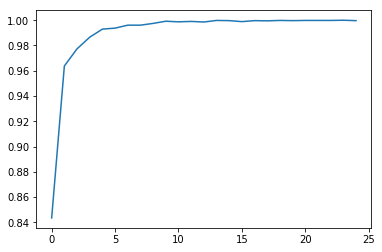

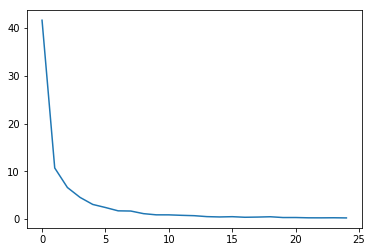

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093, 1.4239105880260468]


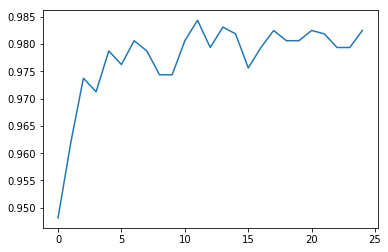

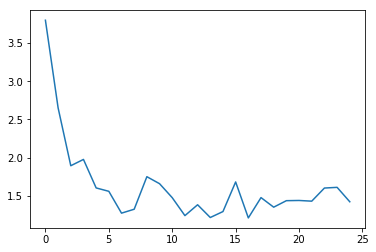


[25] accuracy: 0.983 loss: 1.424

Train
[26, 00020] loss: 0.026 acc: 1.000
[26, 00040] loss: 0.059 acc: 1.000
[26, 00060] loss: 0.116 acc: 1.000
[26, 00080] loss: 0.164 acc: 1.000
[26, 00100] loss: 0.257 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506, 0.35908495262265205, 0.4005425460636616, 0.4675099439918995, 0.30268749594688416, 0.30661361292004585, 0.2460223101079464, 0.23966453224420547, 0.256050780415535, 0.223830755800008

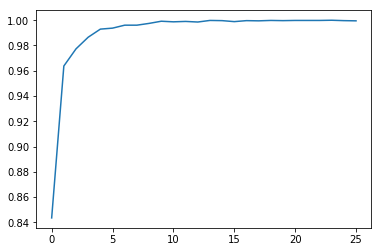

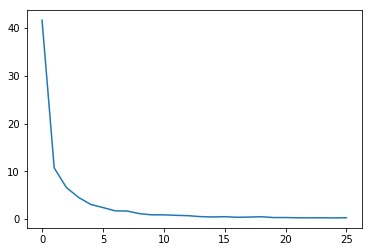

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093, 1.4239105880260468, 1.2953356578946114]


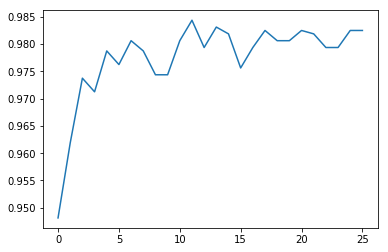

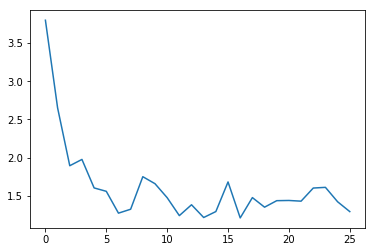


[26] accuracy: 0.983 loss: 1.295

Train
[27, 00020] loss: 0.050 acc: 1.000
[27, 00040] loss: 0.105 acc: 1.000
[27, 00060] loss: 0.134 acc: 1.000
[27, 00080] loss: 0.182 acc: 1.000
[27, 00100] loss: 0.232 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506, 0.35908495262265205, 0.4005425460636616, 0.4675099439918995, 0.30268749594688416, 0.30661361292004585, 0.2460223101079464, 0.23966453224420547, 0.256050780415535, 0.2238307558

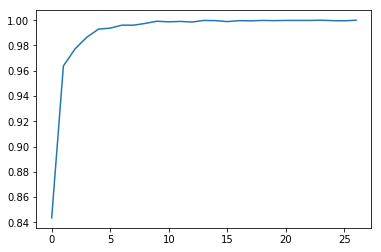

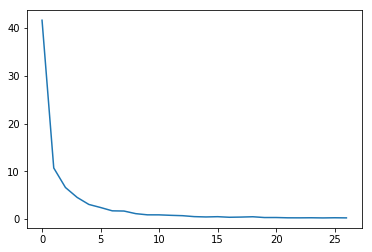

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093, 1.4239105880260468, 1.2953356578946114, 1.3487350270152092]


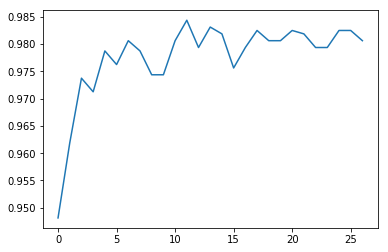

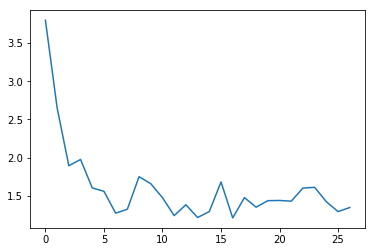


[27] accuracy: 0.981 loss: 1.349

Train
[28, 00020] loss: 0.024 acc: 1.000
[28, 00040] loss: 0.052 acc: 1.000
[28, 00060] loss: 0.107 acc: 1.000
[28, 00080] loss: 0.158 acc: 1.000
[28, 00100] loss: 0.251 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506, 0.35908495262265205, 0.4005425460636616, 0.4675099439918995, 0.30268749594688416, 0.30661361292004585, 0.2460223101079464, 0.23966453224420547, 0.256050780415535, 

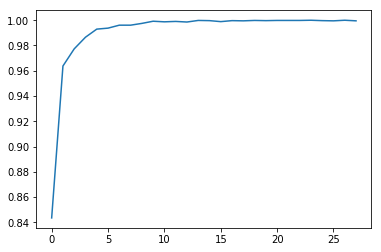

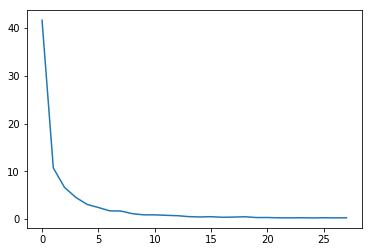

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093, 1.4239105880260468, 1.2953356578946114, 1.3487350270152092, 1.6029614061117172]


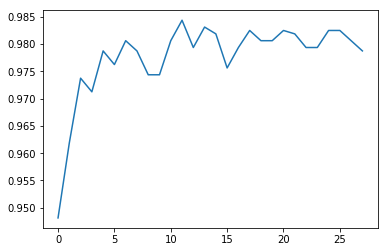

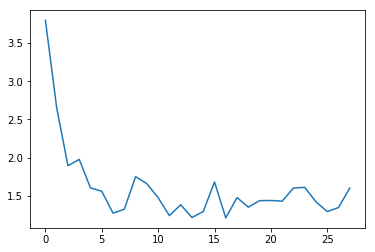


[28] accuracy: 0.979 loss: 1.603

Train
[29, 00020] loss: 0.045 acc: 1.000
[29, 00040] loss: 0.141 acc: 1.000
[29, 00060] loss: 0.163 acc: 1.000
[29, 00080] loss: 0.191 acc: 1.000
[29, 00100] loss: 0.210 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506, 0.35908495262265205, 0.4005425460636616, 0.4675099439918995, 0.30268749594688416, 0.30661361292004585, 0.2460223101079464, 0.23966453224420547, 0.25605

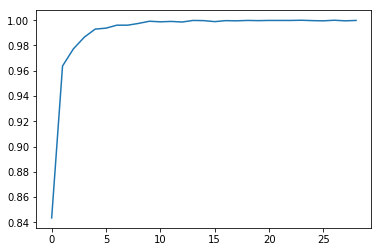

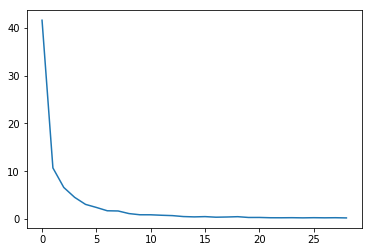

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093, 1.4239105880260468, 1.2953356578946114, 1.3487350270152092, 1.6029614061117172, 1.5255930610001087]


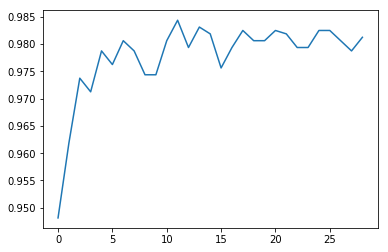

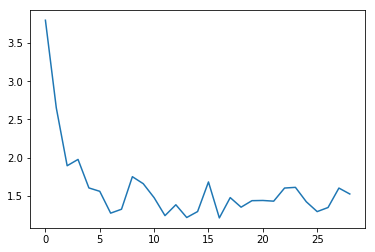


[29] accuracy: 0.981 loss: 1.526

Train
[30, 00020] loss: 0.072 acc: 1.000
[30, 00040] loss: 0.092 acc: 1.000
[30, 00060] loss: 0.140 acc: 1.000
[30, 00080] loss: 0.208 acc: 1.000
[30, 00100] loss: 0.243 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506, 0.35908495262265205, 0.4005425460636616, 0.4675099439918995, 0.30268749594688416, 0.30661361292004585, 0.2460223101079464, 0.239664532244205

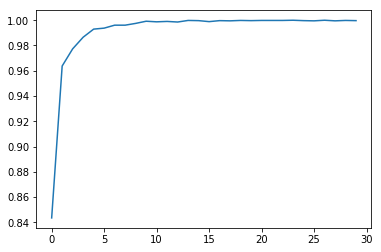

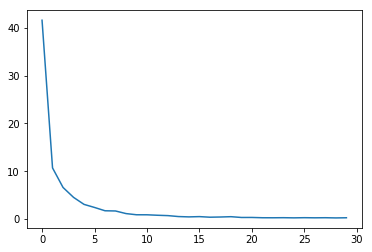

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093, 1.4239105880260468, 1.2953356578946114, 1.3487350270152092, 1.6029614061117172, 1.5255930610001087, 1.5568305253982544]


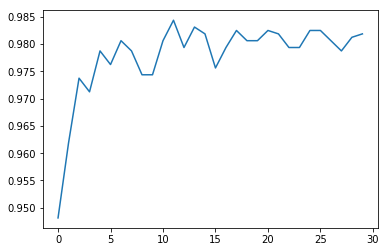

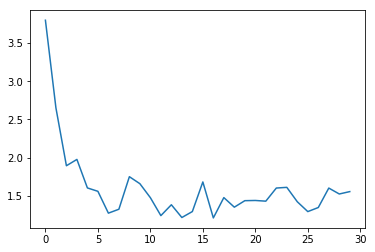


[30] accuracy: 0.982 loss: 1.557

Train
[31, 00020] loss: 0.017 acc: 1.000
[31, 00040] loss: 0.059 acc: 1.000
[31, 00060] loss: 0.100 acc: 1.000
[31, 00080] loss: 0.126 acc: 1.000
[31, 00100] loss: 0.161 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506, 0.35908495262265205, 0.4005425460636616, 0.4675099439918995, 0.30268749594688416, 0.30661361292004585, 0.2460223101079464, 0.2396645322

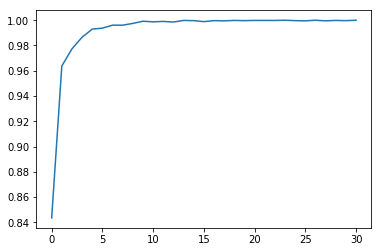

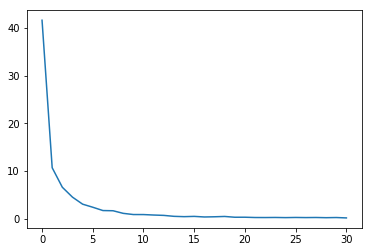

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093, 1.4239105880260468, 1.2953356578946114, 1.3487350270152092, 1.6029614061117172, 1.5255930610001087, 1.5568305253982544, 1.2454878017306328]


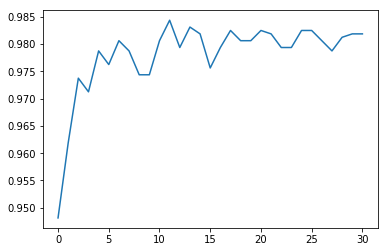

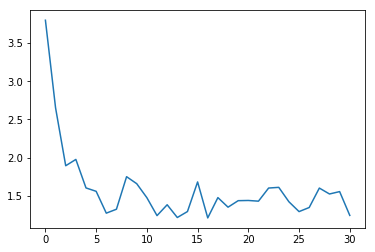


[31] accuracy: 0.982 loss: 1.245

Train
[32, 00020] loss: 0.025 acc: 1.000
[32, 00040] loss: 0.046 acc: 1.000
[32, 00060] loss: 0.077 acc: 1.000
[32, 00080] loss: 0.114 acc: 1.000
[32, 00100] loss: 0.145 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506, 0.35908495262265205, 0.4005425460636616, 0.4675099439918995, 0.30268749594688416, 0.30661361292004585, 0.2460223101079464, 0.23966

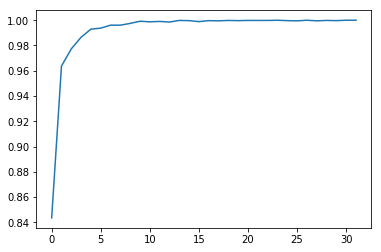

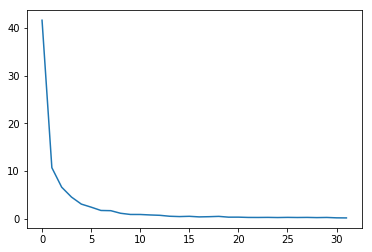

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093, 1.4239105880260468, 1.2953356578946114, 1.3487350270152092, 1.6029614061117172, 1.5255930610001087, 1.5568305253982544, 1.2454878017306328, 1.2591561079025269]


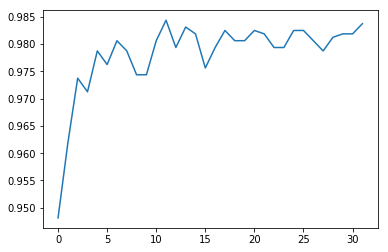

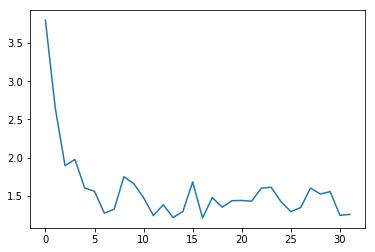


[32] accuracy: 0.984 loss: 1.259

Train
[33, 00020] loss: 0.050 acc: 0.999
[33, 00040] loss: 0.075 acc: 1.000
[33, 00060] loss: 0.109 acc: 1.000
[33, 00080] loss: 0.174 acc: 1.000
[33, 00100] loss: 0.193 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506, 0.35908495262265205, 0.4005425460636616, 0.4675099439918995, 0.30268749594688416, 0.30661361292004585, 0.24602231010794

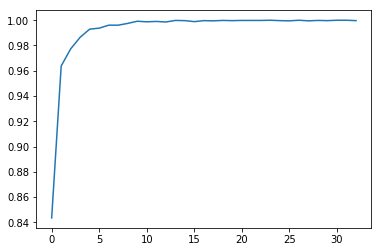

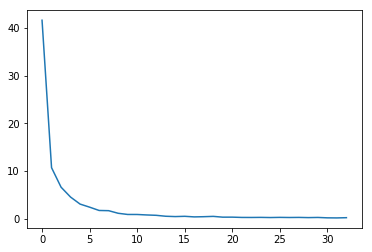

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093, 1.4239105880260468, 1.2953356578946114, 1.3487350270152092, 1.6029614061117172, 1.5255930610001087, 1.5568305253982544, 1.2454878017306328, 1.2591561079025269, 1.453721210360527]


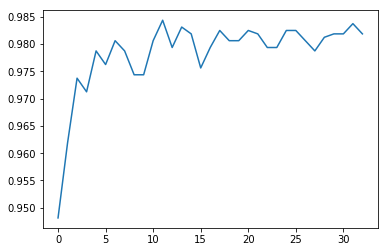

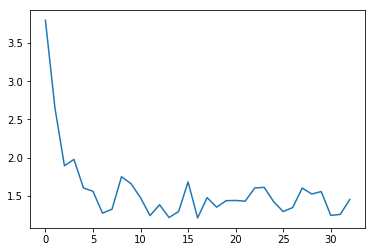


[33] accuracy: 0.982 loss: 1.454

Train
[34, 00020] loss: 0.032 acc: 1.000
[34, 00040] loss: 0.048 acc: 1.000
[34, 00060] loss: 0.077 acc: 1.000
[34, 00080] loss: 0.099 acc: 1.000
[34, 00100] loss: 0.167 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506, 0.35908495262265205, 0.4005425460636616, 0.4675099439918995, 0.30268749594688416, 0.30661361292004585, 0.24

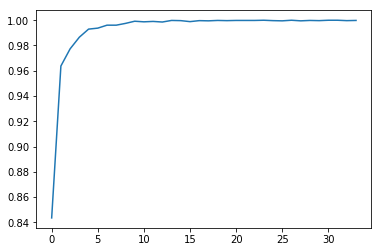

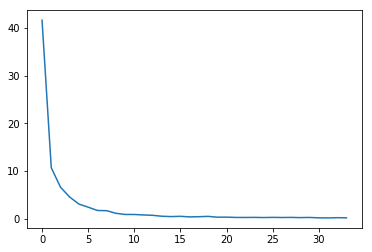

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093, 1.4239105880260468, 1.2953356578946114, 1.3487350270152092, 1.6029614061117172, 1.5255930610001087, 1.5568305253982544, 1.2454878017306328, 1.2591561079025269, 1.453721210360527, 1.79388334974

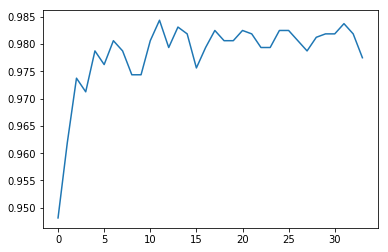

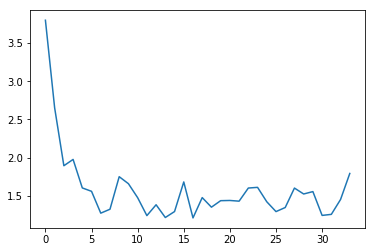


[34] accuracy: 0.978 loss: 1.794

Train
[35, 00020] loss: 0.028 acc: 1.000
[35, 00040] loss: 0.062 acc: 1.000
[35, 00060] loss: 0.089 acc: 1.000
[35, 00080] loss: 0.124 acc: 1.000
[35, 00100] loss: 0.171 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506, 0.35908495262265205, 0.4005425460636616, 0.4675099439918995, 0.30268749594688416, 0.30661361292004585,

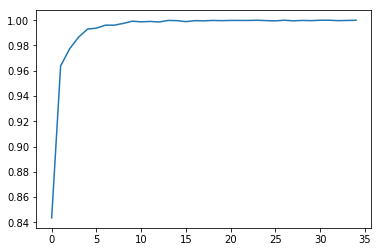

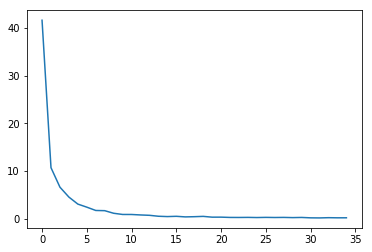

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093, 1.4239105880260468, 1.2953356578946114, 1.3487350270152092, 1.6029614061117172, 1.5255930610001087, 1.5568305253982544, 1.2454878017306328, 1.2591561079025269, 1.453721210360527, 1.79

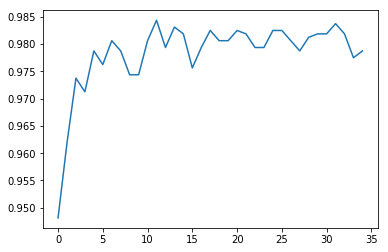

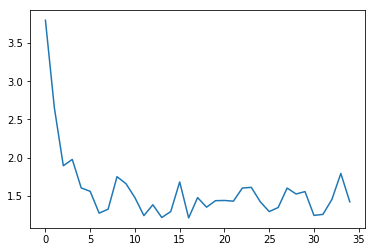


[35] accuracy: 0.979 loss: 1.423

Train
[36, 00020] loss: 0.026 acc: 1.000
[36, 00040] loss: 0.045 acc: 1.000
[36, 00060] loss: 0.074 acc: 1.000
[36, 00080] loss: 0.095 acc: 1.000
[36, 00100] loss: 0.120 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506, 0.35908495262265205, 0.4005425460636616, 0.4675099439918995, 0.30268749594688416, 0.3066136129200

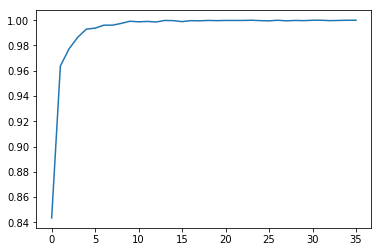

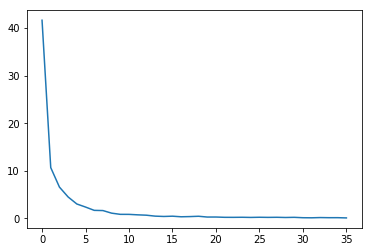

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093, 1.4239105880260468, 1.2953356578946114, 1.3487350270152092, 1.6029614061117172, 1.5255930610001087, 1.5568305253982544, 1.2454878017306328, 1.2591561079025269, 1.45372121036

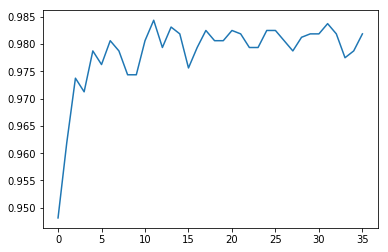

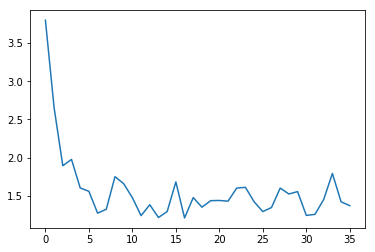


[36] accuracy: 0.982 loss: 1.373

Train
[37, 00020] loss: 0.026 acc: 1.000
[37, 00040] loss: 0.043 acc: 1.000
[37, 00060] loss: 0.061 acc: 1.000
[37, 00080] loss: 0.085 acc: 1.000
[37, 00100] loss: 0.113 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506, 0.35908495262265205, 0.4005425460636616, 0.4675099439918995, 0.30268749594688416, 0.3

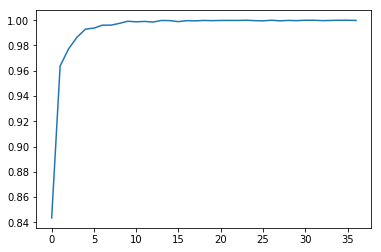

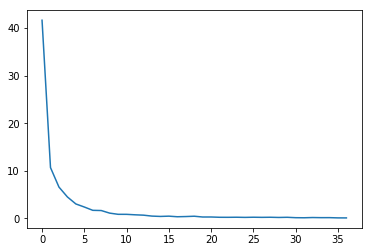

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093, 1.4239105880260468, 1.2953356578946114, 1.3487350270152092, 1.6029614061117172, 1.5255930610001087, 1.5568305253982544, 1.2454878017306328, 1.2591561079025269, 1.4

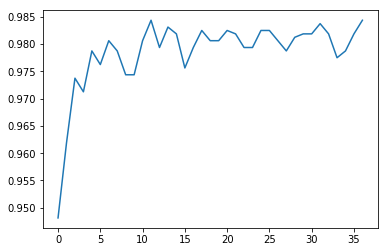

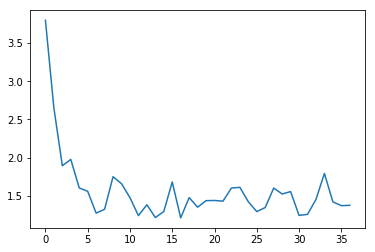


[37] accuracy: 0.984 loss: 1.377

Train
[38, 00020] loss: 0.013 acc: 1.000
[38, 00040] loss: 0.037 acc: 1.000
[38, 00060] loss: 0.075 acc: 1.000
[38, 00080] loss: 0.130 acc: 1.000
[38, 00100] loss: 0.156 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506, 0.35908495262265205, 0.4005425460636616, 0.4675099439918995, 0.30268749594

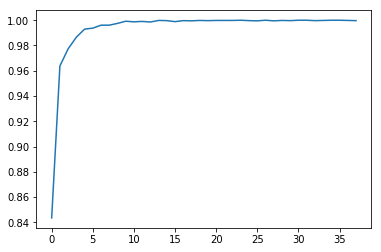

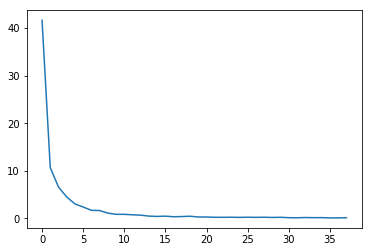

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093, 1.4239105880260468, 1.2953356578946114, 1.3487350270152092, 1.6029614061117172, 1.5255930610001087, 1.5568305253982544, 1.2454878017306328, 1.259156107902

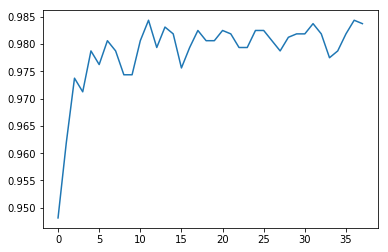

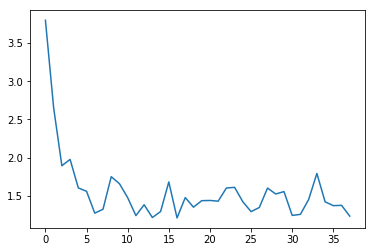


[38] accuracy: 0.984 loss: 1.236

Train
[39, 00020] loss: 0.013 acc: 1.000
[39, 00040] loss: 0.034 acc: 1.000
[39, 00060] loss: 0.058 acc: 1.000
[39, 00080] loss: 0.092 acc: 1.000
[39, 00100] loss: 0.116 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506, 0.35908495262265205, 0.4005425460636616, 0.4675099439918995, 0.302687

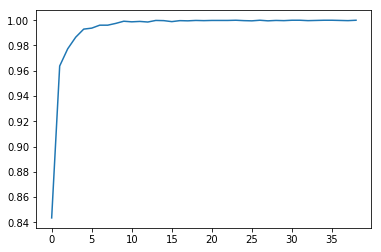

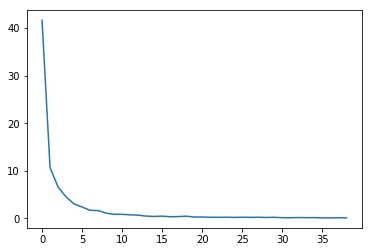

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093, 1.4239105880260468, 1.2953356578946114, 1.3487350270152092, 1.6029614061117172, 1.5255930610001087, 1.5568305253982544, 1.2454878017306328, 1.2591

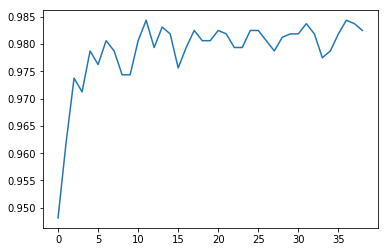

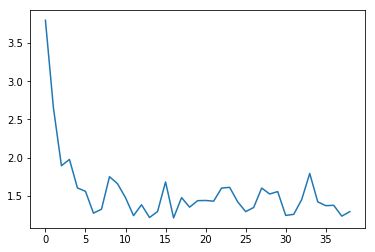


[39] accuracy: 0.983 loss: 1.295

Train
[40, 00020] loss: 0.013 acc: 1.000
[40, 00040] loss: 0.033 acc: 1.000
[40, 00060] loss: 0.050 acc: 1.000
[40, 00080] loss: 0.070 acc: 1.000
[40, 00100] loss: 0.080 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506, 0.35908495262265205, 0.4005425460636616, 0.4675099439918995, 0.3

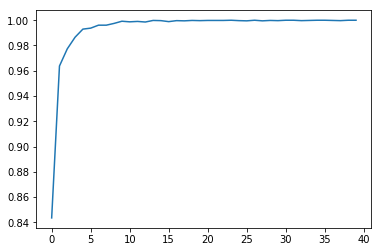

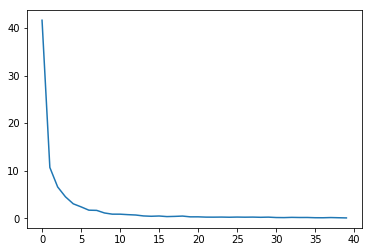

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093, 1.4239105880260468, 1.2953356578946114, 1.3487350270152092, 1.6029614061117172, 1.5255930610001087, 1.5568305253982544, 1.245487801730632

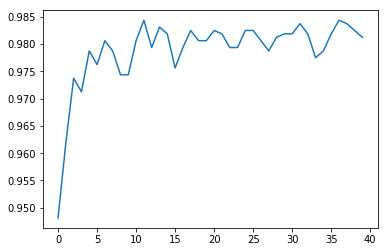

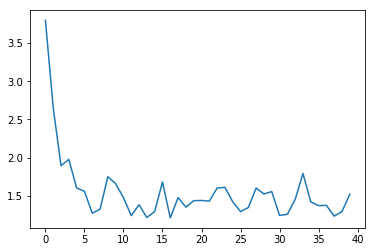


[40] accuracy: 0.981 loss: 1.523

Train
[41, 00020] loss: 0.013 acc: 1.000
[41, 00040] loss: 0.042 acc: 1.000
[41, 00060] loss: 0.061 acc: 1.000
[41, 00080] loss: 0.076 acc: 1.000
[41, 00100] loss: 0.100 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506, 0.35908495262265205, 0.4005425460636616, 0.4675099439918995

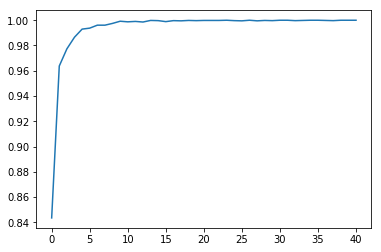

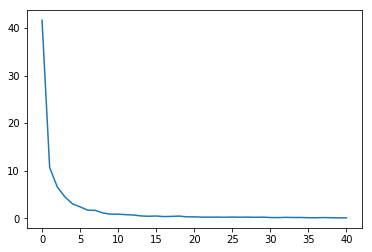

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093, 1.4239105880260468, 1.2953356578946114, 1.3487350270152092, 1.6029614061117172, 1.5255930610001087, 1.5568305253982544, 1.24548

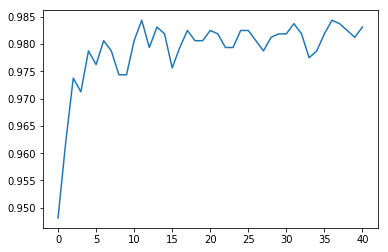

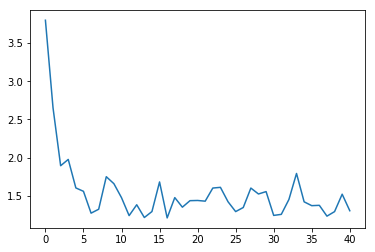


[41] accuracy: 0.983 loss: 1.307

Train
[42, 00020] loss: 0.028 acc: 1.000
[42, 00040] loss: 0.067 acc: 1.000
[42, 00060] loss: 0.103 acc: 1.000
[42, 00080] loss: 0.154 acc: 1.000
[42, 00100] loss: 0.185 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506, 0.35908495262265205, 0.4005425460636616, 0.46750

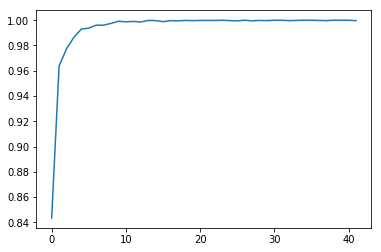

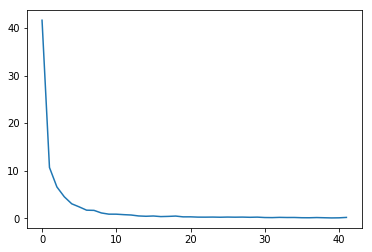

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093, 1.4239105880260468, 1.2953356578946114, 1.3487350270152092, 1.6029614061117172, 1.5255930610001087, 1.556830525398254

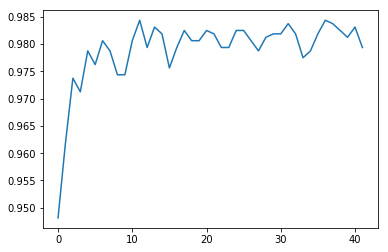

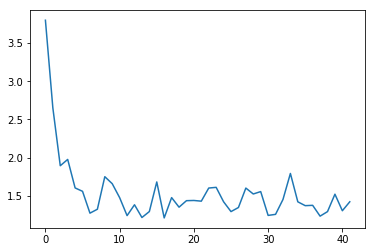


[42] accuracy: 0.979 loss: 1.424

Train
[43, 00020] loss: 0.016 acc: 1.000
[43, 00040] loss: 0.046 acc: 1.000
[43, 00060] loss: 0.075 acc: 1.000
[43, 00080] loss: 0.093 acc: 1.000
[43, 00100] loss: 0.109 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506, 0.35908495262265205, 0.4005425460636616, 0.

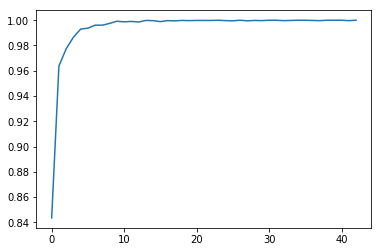

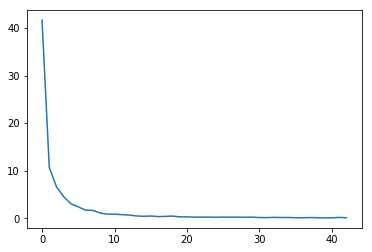

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093, 1.4239105880260468, 1.2953356578946114, 1.3487350270152092, 1.6029614061117172, 1.5255930610001087, 1.55683052

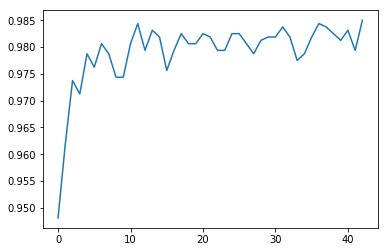

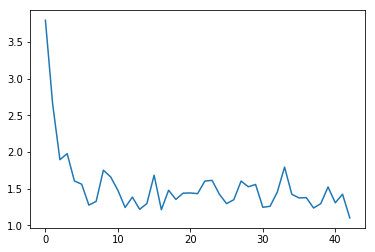


[43] accuracy: 0.985 loss: 1.100

Train
[44, 00020] loss: 0.019 acc: 1.000
[44, 00040] loss: 0.043 acc: 1.000
[44, 00060] loss: 0.063 acc: 1.000
[44, 00080] loss: 0.073 acc: 1.000
[44, 00100] loss: 0.084 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506, 0.35908495262265205, 0.400542546063661

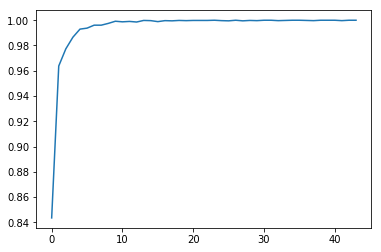

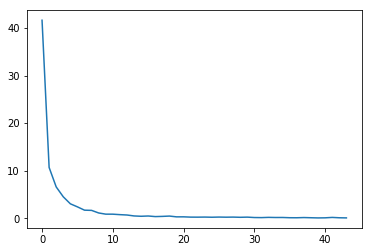

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093, 1.4239105880260468, 1.2953356578946114, 1.3487350270152092, 1.6029614061117172, 1.5255930610001087, 1.

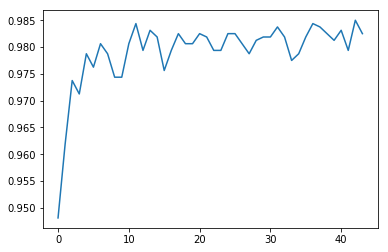

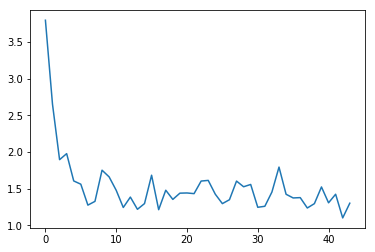


[44] accuracy: 0.983 loss: 1.301

Train
[45, 00020] loss: 0.016 acc: 1.000
[45, 00040] loss: 0.032 acc: 1.000
[45, 00060] loss: 0.082 acc: 1.000
[45, 00080] loss: 0.111 acc: 1.000
[45, 00100] loss: 0.135 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506, 0.35908495262265205, 0.4005425460

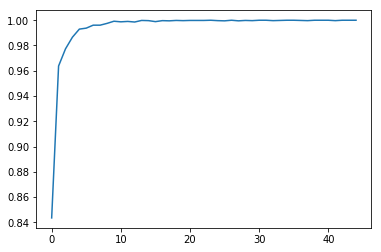

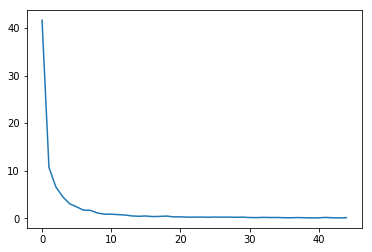

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093, 1.4239105880260468, 1.2953356578946114, 1.3487350270152092, 1.6029614061117172, 1.52559306100

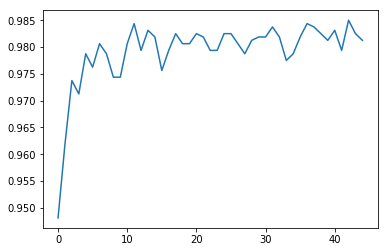

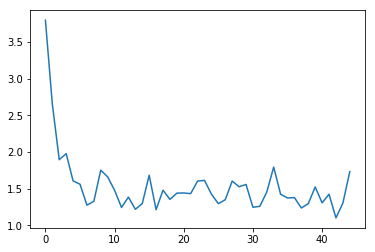


[45] accuracy: 0.981 loss: 1.732

Train
[46, 00020] loss: 0.024 acc: 1.000
[46, 00040] loss: 0.043 acc: 1.000
[46, 00060] loss: 0.063 acc: 1.000
[46, 00080] loss: 0.079 acc: 1.000
[46, 00100] loss: 0.089 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506, 0.35908495262265205, 0.40054

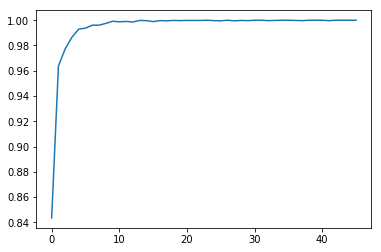

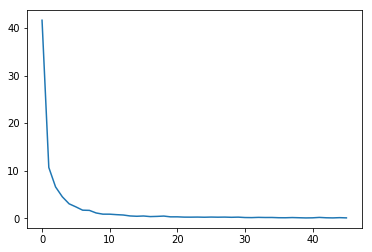

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093, 1.4239105880260468, 1.2953356578946114, 1.3487350270152092, 1.6029614061117172, 1.5

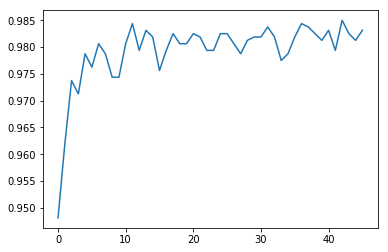

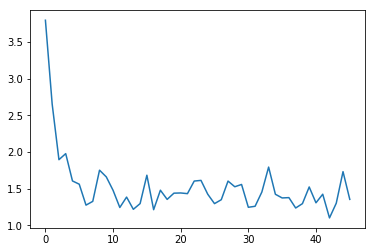


[46] accuracy: 0.983 loss: 1.353

Train
[47, 00020] loss: 0.031 acc: 0.999
[47, 00040] loss: 0.043 acc: 1.000
[47, 00060] loss: 0.055 acc: 1.000
[47, 00080] loss: 0.074 acc: 1.000
[47, 00100] loss: 0.092 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506, 0.35908495262265

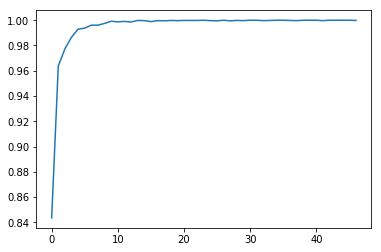

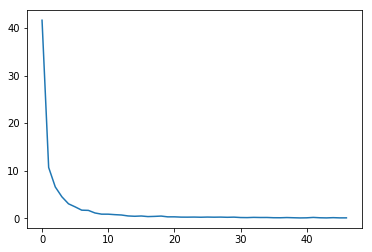

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093, 1.4239105880260468, 1.2953356578946114, 1.3487350270152092, 1.60296140611171

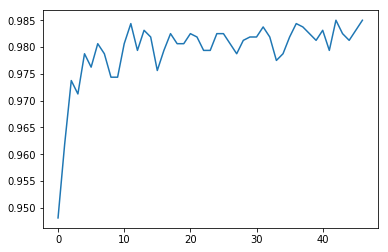

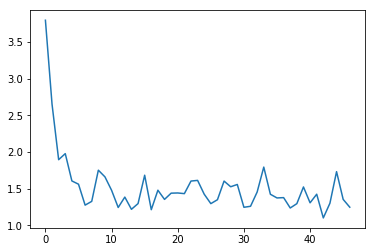


[47] accuracy: 0.985 loss: 1.247

Train
[48, 00020] loss: 0.018 acc: 1.000
[48, 00040] loss: 0.031 acc: 1.000
[48, 00060] loss: 0.049 acc: 1.000
[48, 00080] loss: 0.072 acc: 1.000
[48, 00100] loss: 0.101 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506, 0.359084952

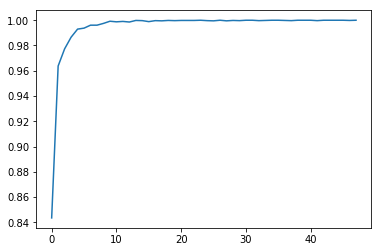

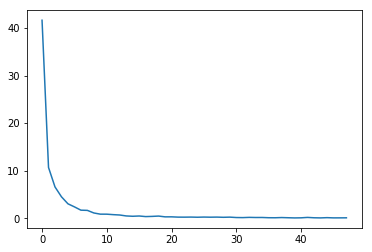

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093, 1.4239105880260468, 1.2953356578946114, 1.3487350270152092, 1.602961

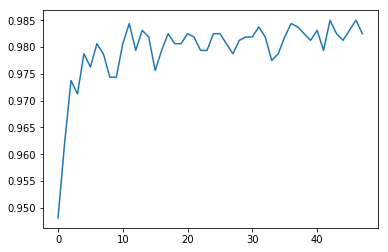

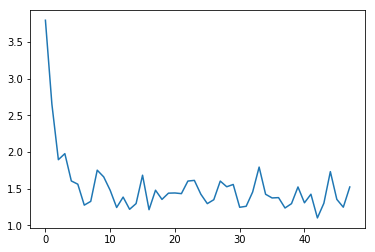


[48] accuracy: 0.983 loss: 1.523

Train
[49, 00020] loss: 0.024 acc: 1.000
[49, 00040] loss: 0.049 acc: 1.000
[49, 00060] loss: 0.059 acc: 1.000
[49, 00080] loss: 0.089 acc: 1.000
[49, 00100] loss: 0.114 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768716454506,

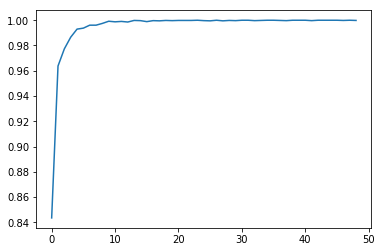

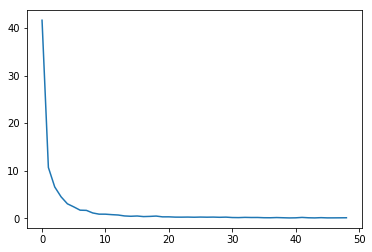

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093, 1.4239105880260468, 1.2953356578946114, 1.3487350270152092, 1.

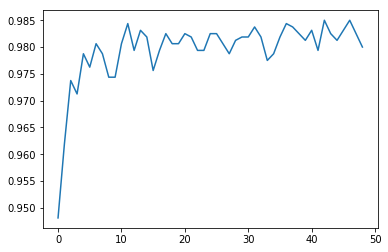

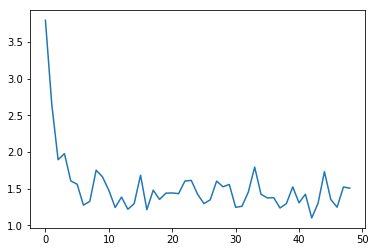


[49] accuracy: 0.980 loss: 1.507

Train
[50, 00020] loss: 0.009 acc: 1.000
[50, 00040] loss: 0.032 acc: 1.000
[50, 00060] loss: 0.060 acc: 1.000
[50, 00080] loss: 0.069 acc: 1.000
[50, 00100] loss: 0.081 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.4823376871645

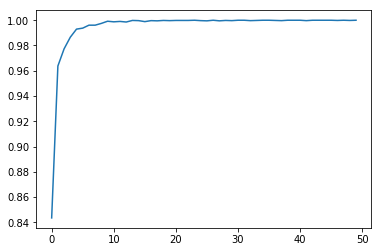

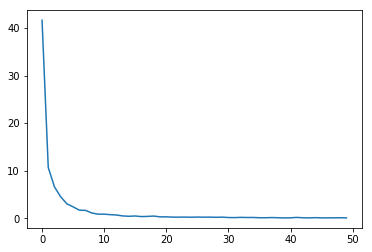

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093, 1.4239105880260468, 1.2953356578946114, 1.348735027015

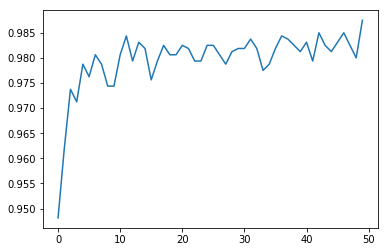

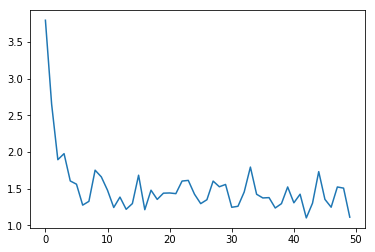


[50] accuracy: 0.988 loss: 1.110

Train
[51, 00020] loss: 0.028 acc: 1.000
[51, 00040] loss: 0.050 acc: 1.000
[51, 00060] loss: 0.065 acc: 1.000
[51, 00080] loss: 0.089 acc: 1.000
[51, 00100] loss: 0.102 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.48233768

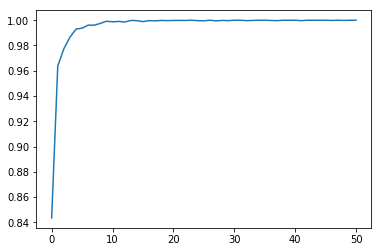

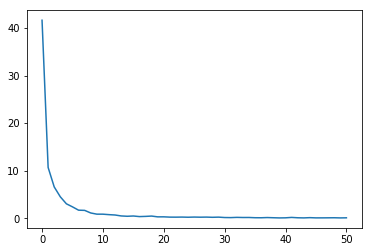

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093, 1.4239105880260468, 1.2953356578946114, 1.348

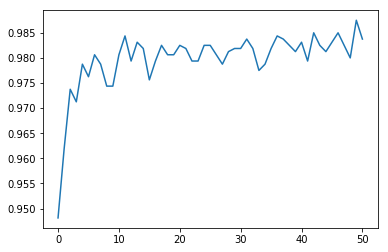

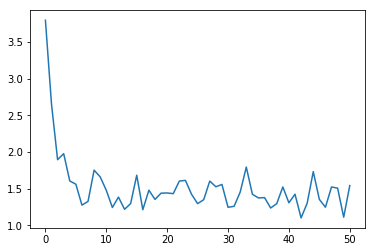


[51] accuracy: 0.984 loss: 1.542

Train
[52, 00020] loss: 0.026 acc: 1.000
[52, 00040] loss: 0.036 acc: 1.000
[52, 00060] loss: 0.055 acc: 1.000
[52, 00080] loss: 0.063 acc: 1.000
[52, 00100] loss: 0.074 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42547486536204815, 0.482

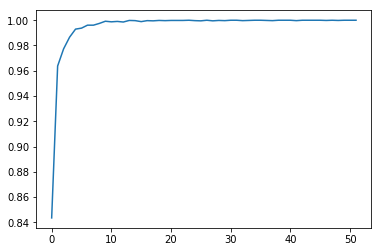

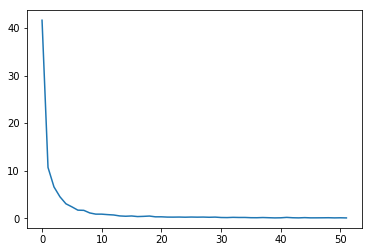

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093, 1.4239105880260468, 1.2953356578946114,

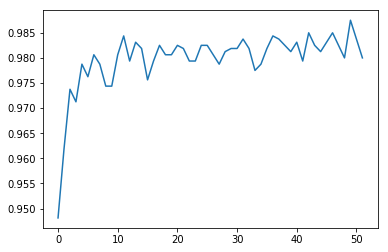

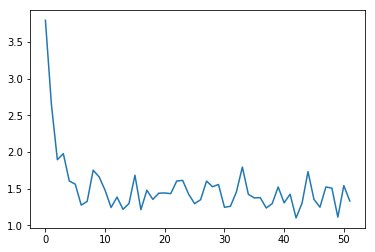


[52] accuracy: 0.980 loss: 1.331

Train
[53, 00020] loss: 0.013 acc: 1.000
[53, 00040] loss: 0.033 acc: 1.000
[53, 00060] loss: 0.065 acc: 1.000
[53, 00080] loss: 0.073 acc: 1.000
[53, 00100] loss: 0.105 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.425474865362

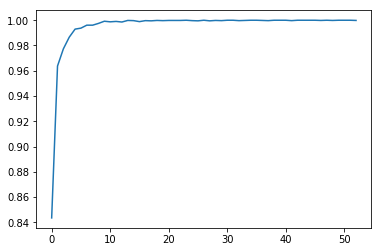

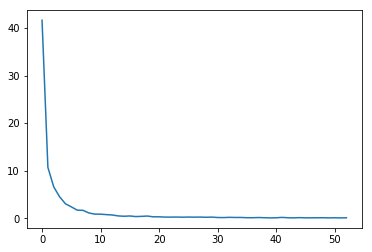

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093, 1.4239105880260468, 1.2953356

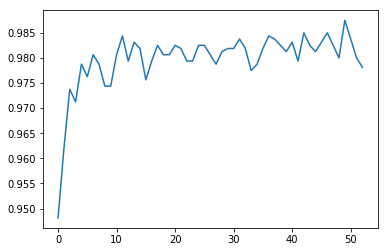

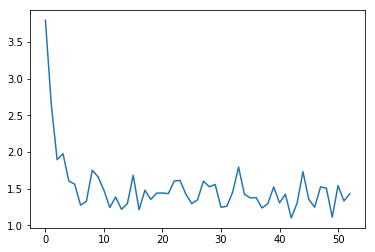


[53] accuracy: 0.978 loss: 1.431

Train
[54, 00020] loss: 0.012 acc: 1.000
[54, 00040] loss: 0.027 acc: 1.000
[54, 00060] loss: 0.053 acc: 1.000
[54, 00080] loss: 0.065 acc: 1.000
[54, 00100] loss: 0.093 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.4254748

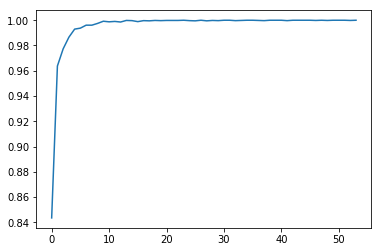

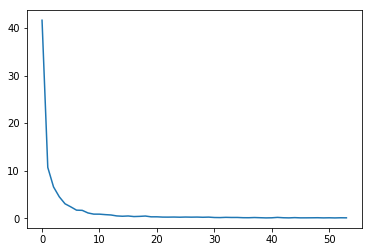

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093, 1.4239105880260468,

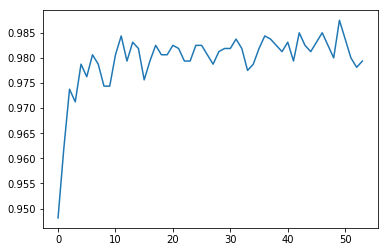

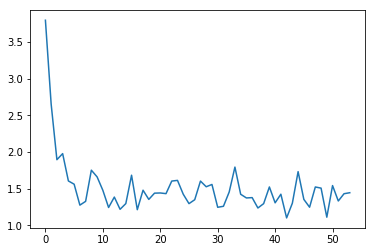


[54] accuracy: 0.979 loss: 1.444

Train
[55, 00020] loss: 0.031 acc: 1.000
[55, 00040] loss: 0.045 acc: 1.000
[55, 00060] loss: 0.057 acc: 1.000
[55, 00080] loss: 0.080 acc: 1.000
[55, 00100] loss: 0.090 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492, 0.42

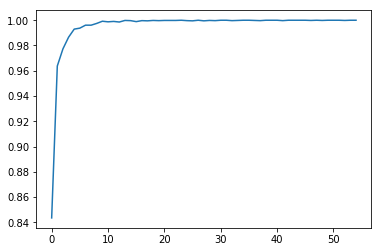

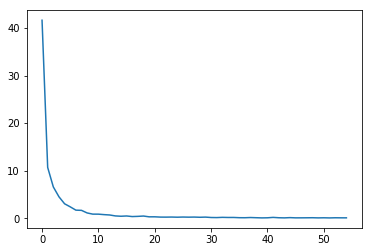

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093, 1.4239105

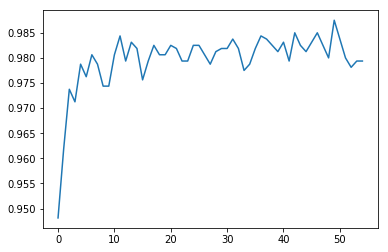

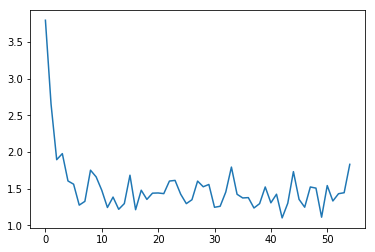


[55] accuracy: 0.979 loss: 1.831

Train
[56, 00020] loss: 0.013 acc: 1.000
[56, 00040] loss: 0.037 acc: 1.000
[56, 00060] loss: 0.064 acc: 1.000
[56, 00080] loss: 0.084 acc: 1.000
[56, 00100] loss: 0.095 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.494243998080492,

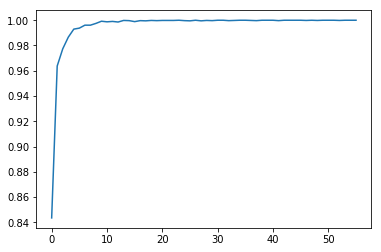

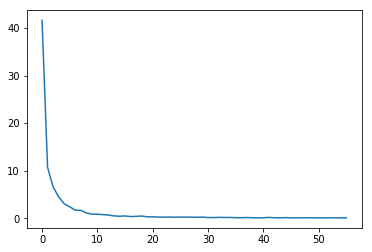

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389974296093,

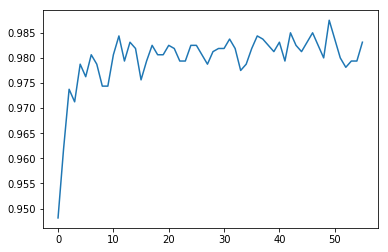

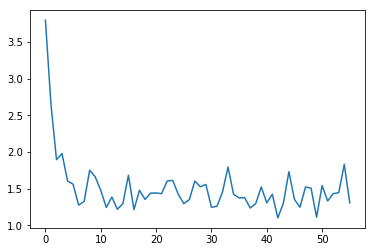


[56] accuracy: 0.983 loss: 1.306

Train
[57, 00020] loss: 0.016 acc: 1.000
[57, 00040] loss: 0.028 acc: 1.000
[57, 00060] loss: 0.040 acc: 1.000
[57, 00080] loss: 0.088 acc: 1.000
[57, 00100] loss: 0.100 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0.4942

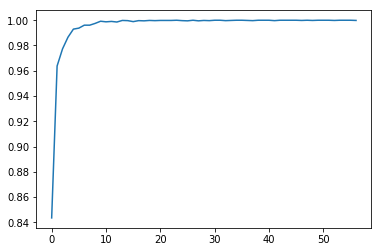

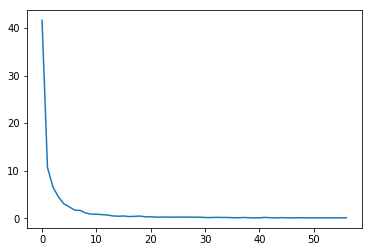

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527, 1.612389

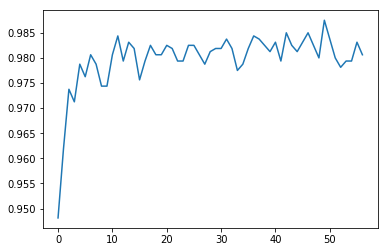

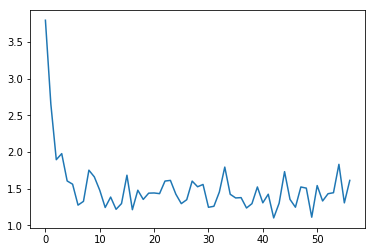


[57] accuracy: 0.981 loss: 1.612

Train
[58, 00020] loss: 0.027 acc: 1.000
[58, 00040] loss: 0.041 acc: 1.000
[58, 00060] loss: 0.069 acc: 1.000
[58, 00080] loss: 0.079 acc: 1.000
[58, 00100] loss: 0.095 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.6908948123455048, 0

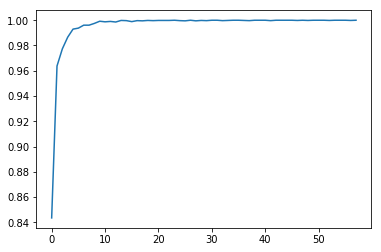

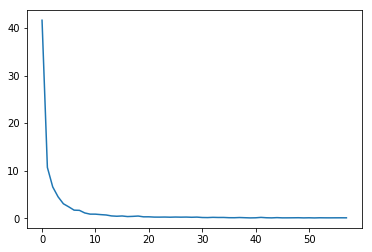

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.6032927371561527

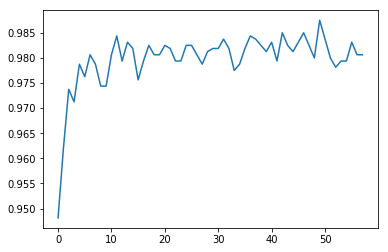

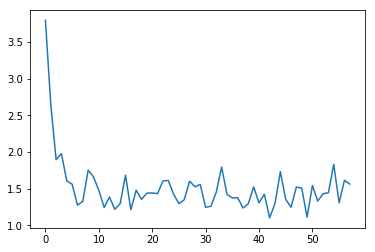


[58] accuracy: 0.981 loss: 1.562

Train
[59, 00020] loss: 0.011 acc: 1.000
[59, 00040] loss: 0.029 acc: 1.000
[59, 00060] loss: 0.041 acc: 1.000
[59, 00080] loss: 0.087 acc: 1.000
[59, 00100] loss: 0.097 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.69089481234550

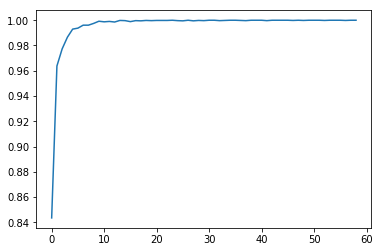

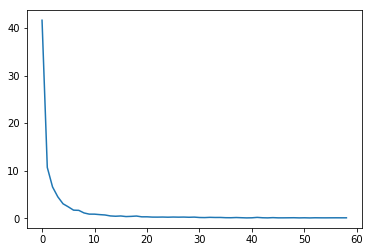

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848, 1.603292

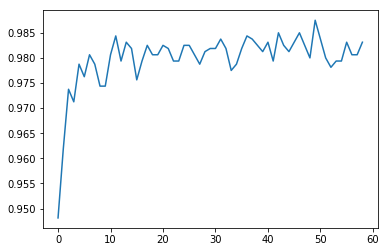

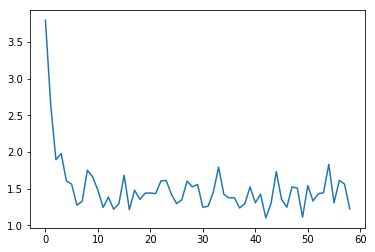


[59] accuracy: 0.983 loss: 1.224

Train
[60, 00020] loss: 0.018 acc: 1.000
[60, 00040] loss: 0.044 acc: 1.000
[60, 00060] loss: 0.071 acc: 1.000
[60, 00080] loss: 0.082 acc: 1.000
[60, 00100] loss: 0.091 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869, 0.69

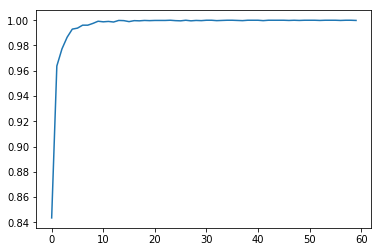

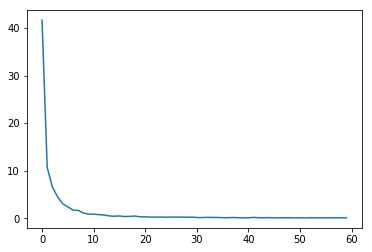

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.43169604241848

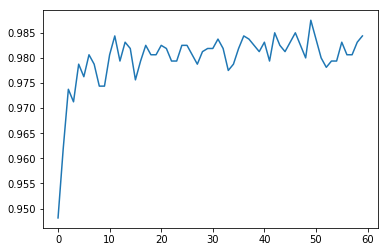

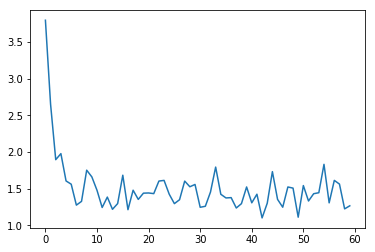


[60] accuracy: 0.984 loss: 1.266

Train
[61, 00020] loss: 0.033 acc: 1.000
[61, 00040] loss: 0.047 acc: 1.000
[61, 00060] loss: 0.060 acc: 1.000
[61, 00080] loss: 0.077 acc: 1.000
[61, 00100] loss: 0.101 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595408856869,

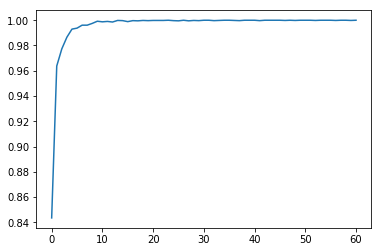

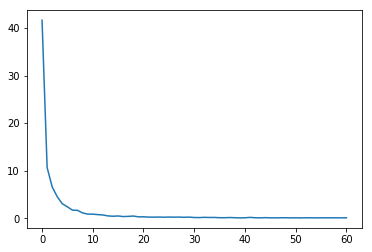

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198, 1.431696

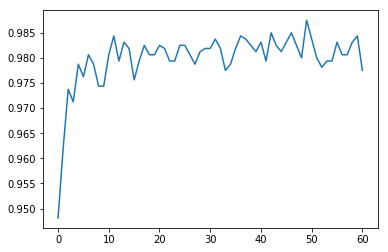

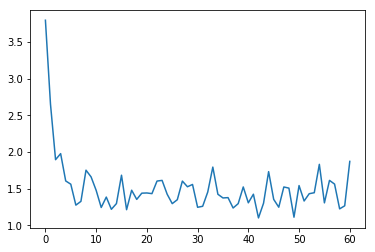


[61] accuracy: 0.978 loss: 1.872

Train
[62, 00020] loss: 0.013 acc: 1.000
[62, 00040] loss: 0.018 acc: 1.000
[62, 00060] loss: 0.029 acc: 1.000
[62, 00080] loss: 0.051 acc: 1.000
[62, 00100] loss: 0.062 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.766759540885

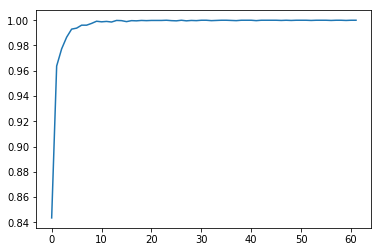

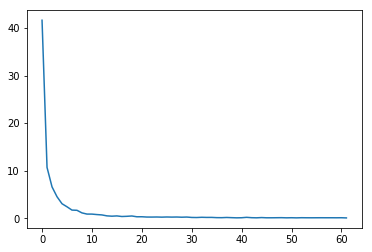

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.4408252276480198

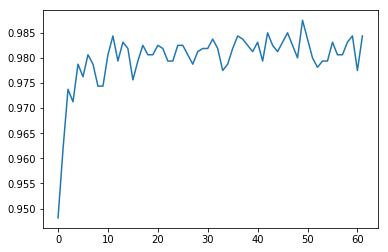

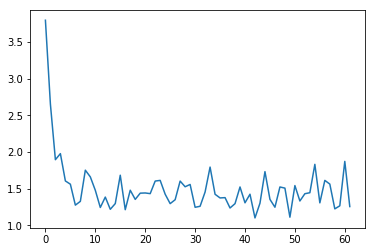


[62] accuracy: 0.984 loss: 1.255

Train
[63, 00020] loss: 0.021 acc: 1.000
[63, 00040] loss: 0.039 acc: 1.000
[63, 00060] loss: 0.052 acc: 1.000
[63, 00080] loss: 0.072 acc: 1.000
[63, 00100] loss: 0.092 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.7667595

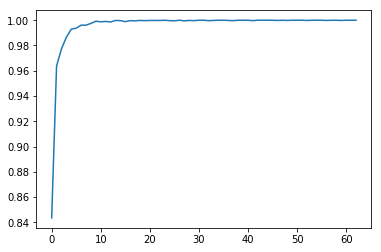

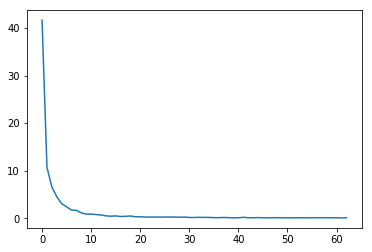

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1.440825227

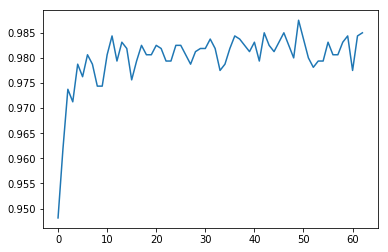

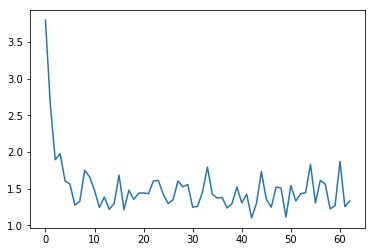


[63] accuracy: 0.985 loss: 1.332

Train
[64, 00020] loss: 0.009 acc: 1.000
[64, 00040] loss: 0.016 acc: 1.000
[64, 00060] loss: 0.024 acc: 1.000
[64, 00080] loss: 0.033 acc: 1.000
[64, 00100] loss: 0.044 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226, 0.76

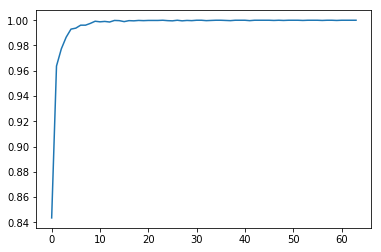

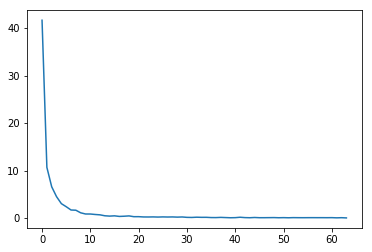

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982159257, 1

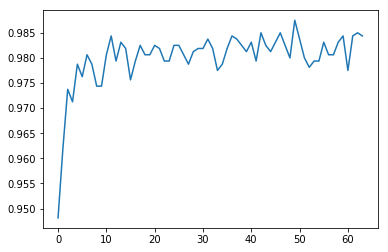

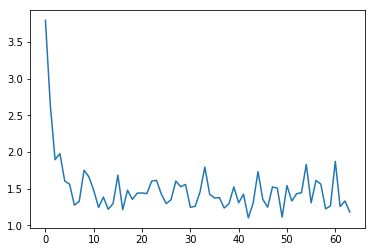


[64] accuracy: 0.984 loss: 1.181

Train
[65, 00020] loss: 0.007 acc: 1.000
[65, 00040] loss: 0.028 acc: 1.000
[65, 00060] loss: 0.044 acc: 1.000
[65, 00080] loss: 0.053 acc: 1.000
[65, 00100] loss: 0.066 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316470742226,

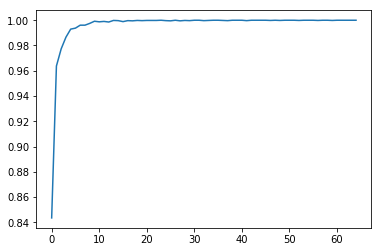

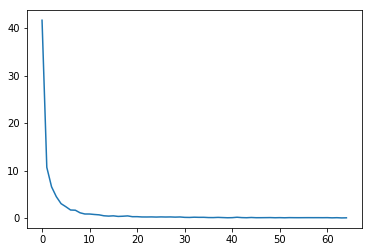

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1.438122982

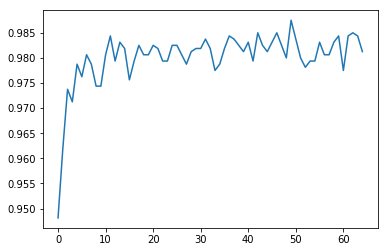

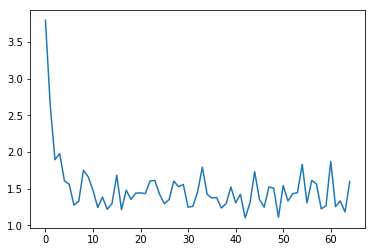


[65] accuracy: 0.981 loss: 1.596

Train
[66, 00020] loss: 0.011 acc: 1.000
[66, 00040] loss: 0.035 acc: 1.000
[66, 00060] loss: 0.048 acc: 1.000
[66, 00080] loss: 0.062 acc: 1.000
[66, 00100] loss: 0.076 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.864731647074

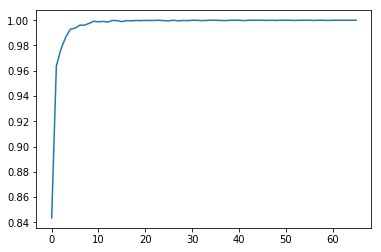

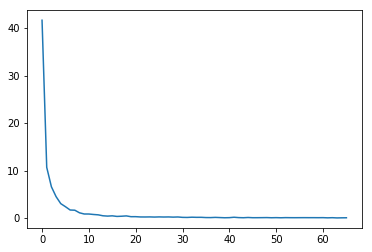

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.353145256638527, 1

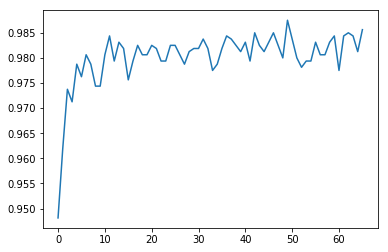

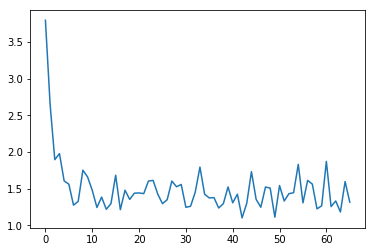


[66] accuracy: 0.986 loss: 1.315

Train
[67, 00020] loss: 0.015 acc: 1.000
[67, 00040] loss: 0.030 acc: 1.000
[67, 00060] loss: 0.037 acc: 1.000
[67, 00080] loss: 0.051 acc: 1.000
[67, 00100] loss: 0.058 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.8647316

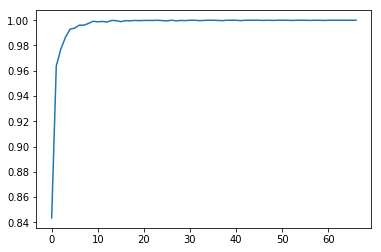

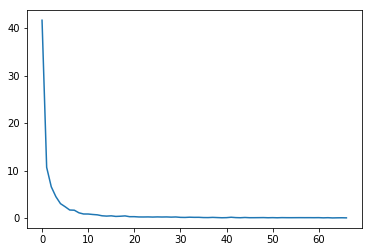

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.35314525663

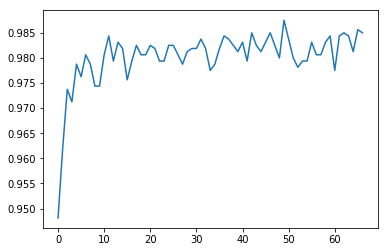

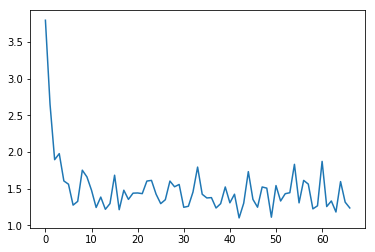


[67] accuracy: 0.985 loss: 1.236

Train
[68, 00020] loss: 0.014 acc: 1.000
[68, 00040] loss: 0.020 acc: 1.000
[68, 00060] loss: 0.034 acc: 1.000
[68, 00080] loss: 0.040 acc: 1.000
[68, 00100] loss: 0.049 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445, 0.86

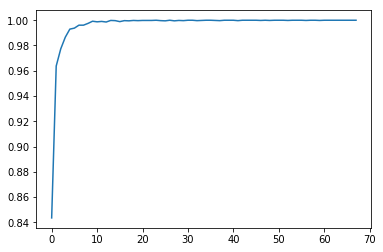

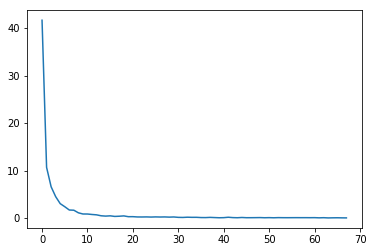

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.4783617965877056, 1.3

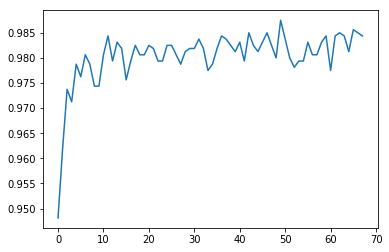

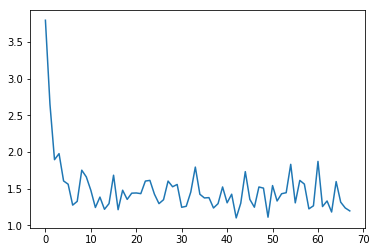


[68] accuracy: 0.984 loss: 1.196

Train
[69, 00020] loss: 0.012 acc: 1.000
[69, 00040] loss: 0.043 acc: 1.000
[69, 00060] loss: 0.068 acc: 1.000
[69, 00080] loss: 0.078 acc: 1.000
[69, 00100] loss: 0.097 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.8700445387512445,

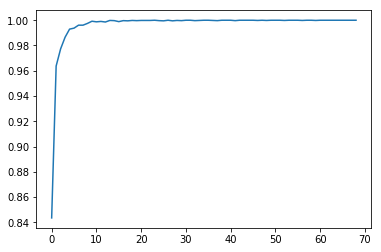

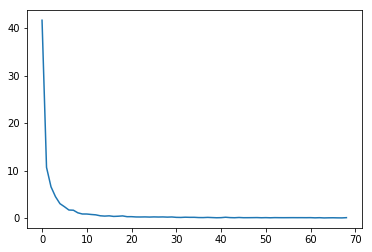

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.47836179658

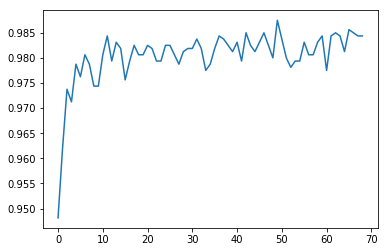

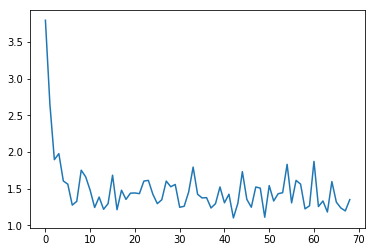


[69] accuracy: 0.984 loss: 1.350

Train
[70, 00020] loss: 0.027 acc: 1.000
[70, 00040] loss: 0.060 acc: 1.000
[70, 00060] loss: 0.068 acc: 1.000
[70, 00080] loss: 0.082 acc: 1.000
[70, 00100] loss: 0.100 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.870044538751

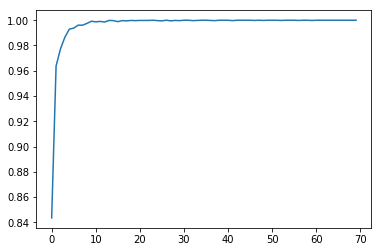

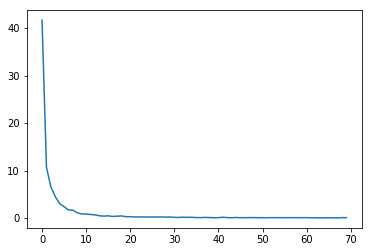

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526821, 1.478

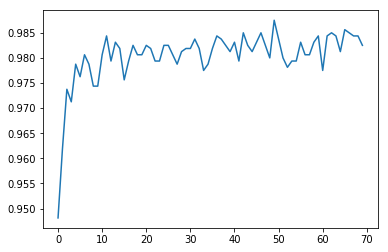

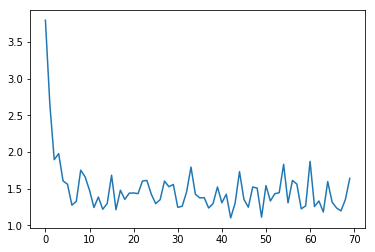


[70] accuracy: 0.983 loss: 1.640

Train
[71, 00020] loss: 0.028 acc: 0.999
[71, 00040] loss: 0.043 acc: 1.000
[71, 00060] loss: 0.053 acc: 1.000
[71, 00080] loss: 0.070 acc: 1.000
[71, 00100] loss: 0.082 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.1194033343344927, 0.

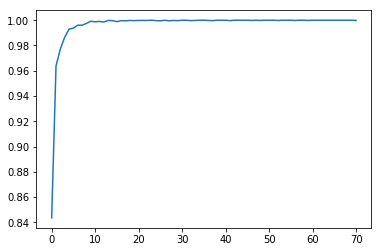

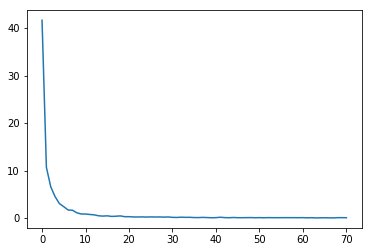

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.2127055488526

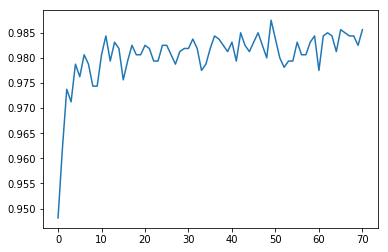

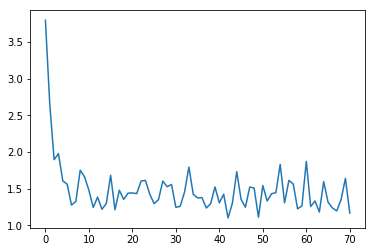


[71] accuracy: 0.986 loss: 1.166

Train
[72, 00020] loss: 0.008 acc: 1.000
[72, 00040] loss: 0.017 acc: 1.000
[72, 00060] loss: 0.043 acc: 1.000
[72, 00080] loss: 0.053 acc: 1.000
[72, 00100] loss: 0.083 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507, 1.119403334

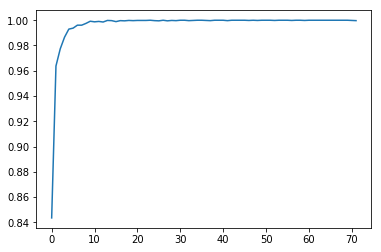

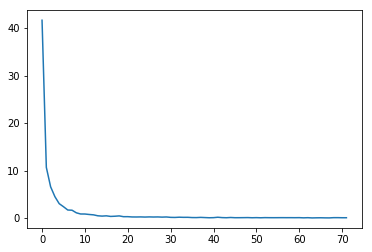

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392, 1.21270

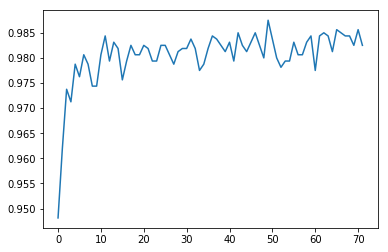

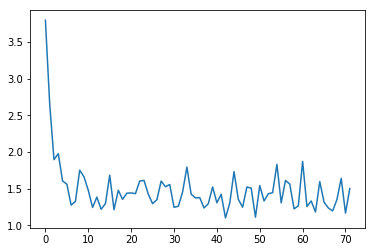


[72] accuracy: 0.983 loss: 1.501

Train
[73, 00020] loss: 0.015 acc: 1.000
[73, 00040] loss: 0.021 acc: 1.000
[73, 00060] loss: 0.032 acc: 1.000
[73, 00080] loss: 0.037 acc: 1.000
[73, 00100] loss: 0.098 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.6644627321511507,

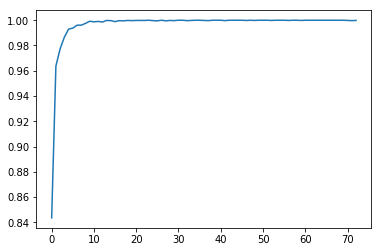

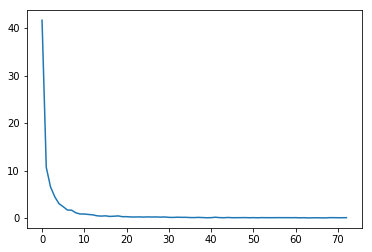

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153308392,

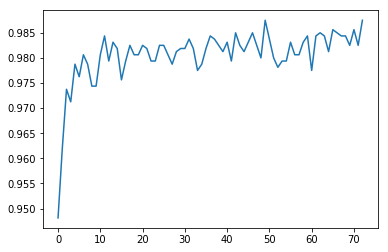

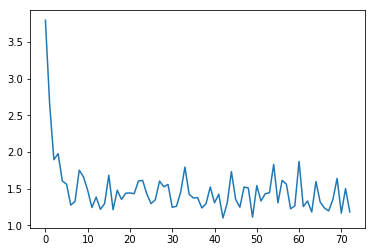


[73] accuracy: 0.988 loss: 1.183

Train
[74, 00020] loss: 0.015 acc: 1.000
[74, 00040] loss: 0.021 acc: 1.000
[74, 00060] loss: 0.029 acc: 1.000
[74, 00080] loss: 0.035 acc: 1.000
[74, 00100] loss: 0.060 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.66446

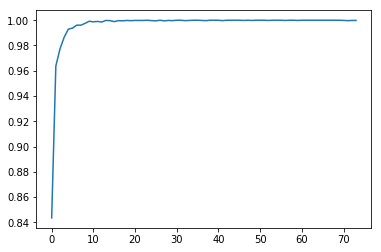

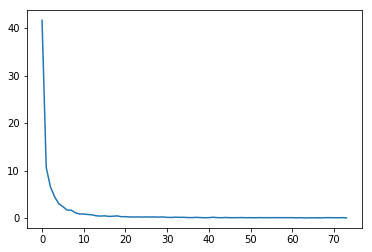

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.6830157153

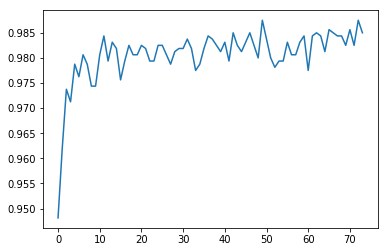

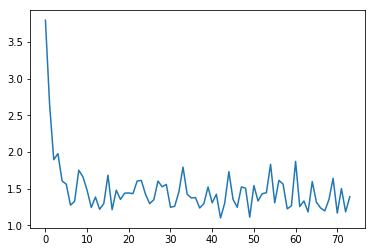


[74] accuracy: 0.985 loss: 1.390

Train
[75, 00020] loss: 0.014 acc: 1.000
[75, 00040] loss: 0.019 acc: 1.000
[75, 00060] loss: 0.026 acc: 1.000
[75, 00080] loss: 0.033 acc: 1.000
[75, 00100] loss: 0.059 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891844034, 1.

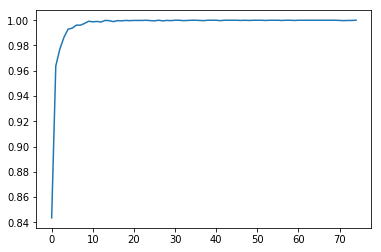

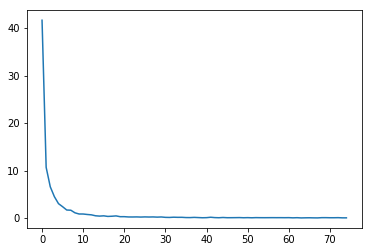

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2958997823297977, 1.

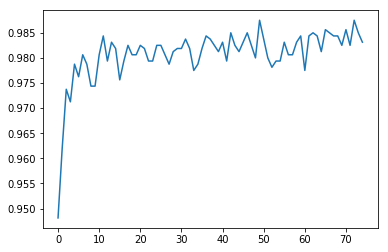

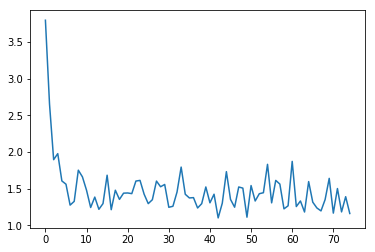


[75] accuracy: 0.983 loss: 1.161

Train
[76, 00020] loss: 0.005 acc: 1.000
[76, 00040] loss: 0.012 acc: 1.000
[76, 00060] loss: 0.022 acc: 1.000
[76, 00080] loss: 0.029 acc: 1.000
[76, 00100] loss: 0.033 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.707636589184403

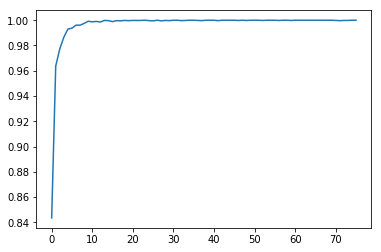

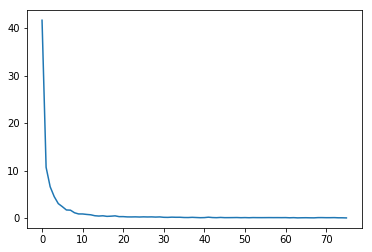

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.29589978232

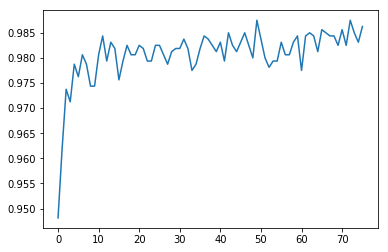

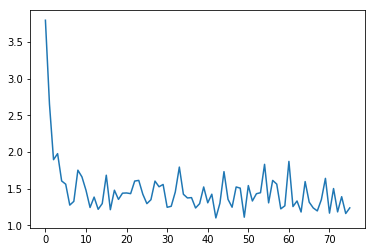


[76] accuracy: 0.986 loss: 1.237

Train
[77, 00020] loss: 0.012 acc: 1.000
[77, 00040] loss: 0.021 acc: 1.000
[77, 00060] loss: 0.036 acc: 1.000
[77, 00080] loss: 0.047 acc: 1.000
[77, 00100] loss: 0.061 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.7076365891

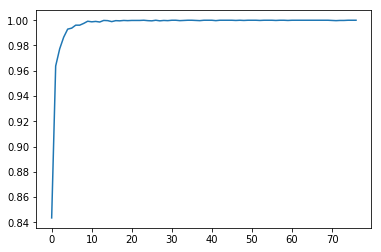

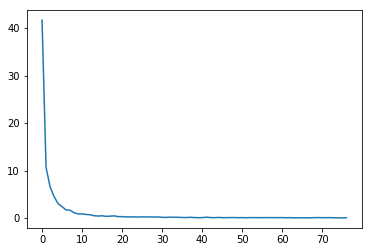

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.2180067338049412, 1.2

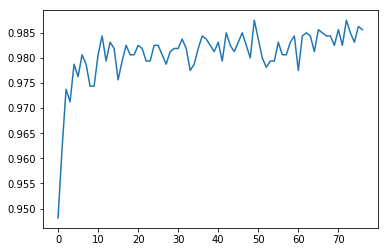

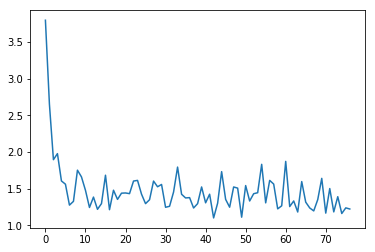


[77] accuracy: 0.986 loss: 1.222

Train
[78, 00020] loss: 0.009 acc: 1.000
[78, 00040] loss: 0.034 acc: 1.000
[78, 00060] loss: 0.046 acc: 1.000
[78, 00080] loss: 0.053 acc: 1.000
[78, 00100] loss: 0.065 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362955, 1.70763

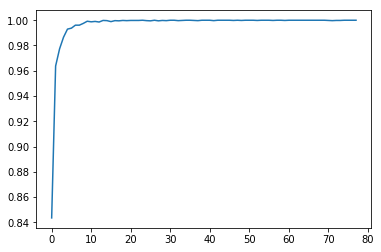

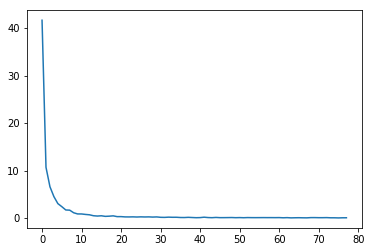

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.21800673380

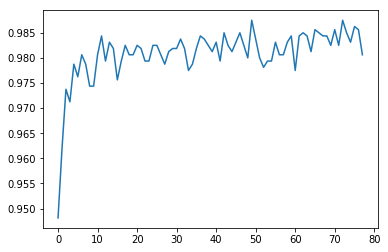

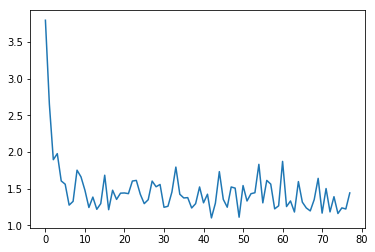


[78] accuracy: 0.981 loss: 1.441

Train
[79, 00020] loss: 0.006 acc: 1.000
[79, 00040] loss: 0.038 acc: 1.000
[79, 00060] loss: 0.044 acc: 1.000
[79, 00080] loss: 0.058 acc: 1.000
[79, 00100] loss: 0.065 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.4029856864362

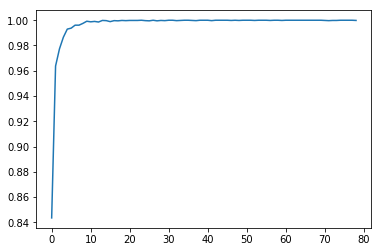

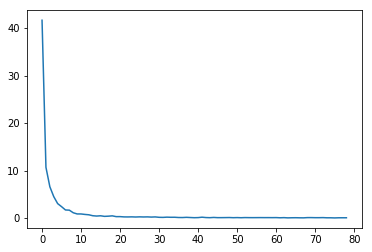

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926, 1.21800

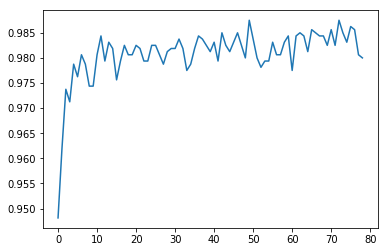

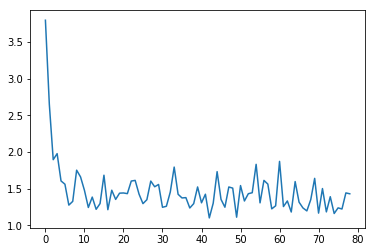


[79] accuracy: 0.980 loss: 1.430

Train
[80, 00020] loss: 0.016 acc: 1.000
[80, 00040] loss: 0.024 acc: 1.000
[80, 00060] loss: 0.030 acc: 1.000
[80, 00080] loss: 0.034 acc: 1.000
[80, 00100] loss: 0.046 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911, 2.40298568

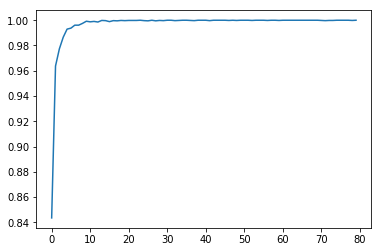

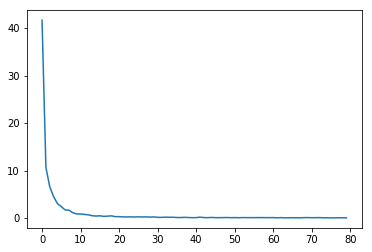

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.3847034983336926

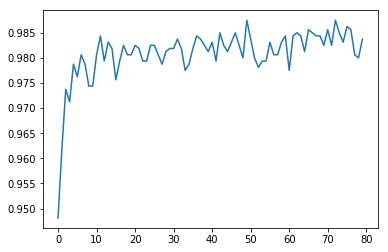

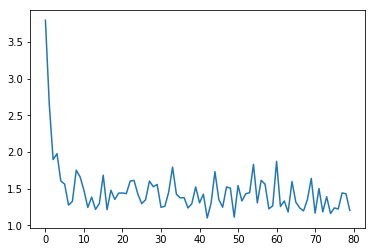


[80] accuracy: 0.984 loss: 1.203

Train
[81, 00020] loss: 0.008 acc: 1.000
[81, 00040] loss: 0.013 acc: 1.000
[81, 00060] loss: 0.021 acc: 1.000
[81, 00080] loss: 0.035 acc: 1.000
[81, 00100] loss: 0.061 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.045334218069911

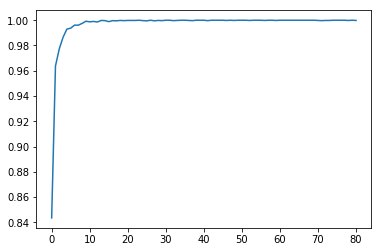

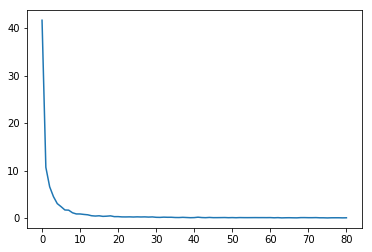

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446, 1.384703

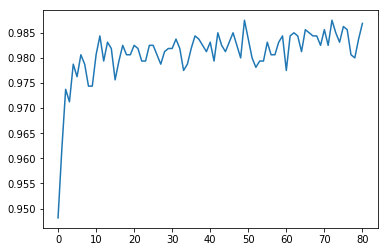

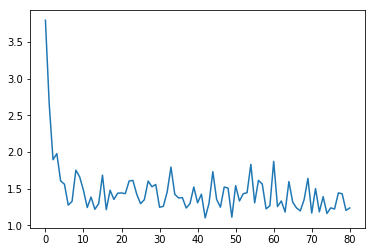


[81] accuracy: 0.987 loss: 1.237

Train
[82, 00020] loss: 0.004 acc: 1.000
[82, 00040] loss: 0.021 acc: 1.000
[82, 00060] loss: 0.031 acc: 1.000
[82, 00080] loss: 0.035 acc: 1.000
[82, 00100] loss: 0.050 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 3.0453342180

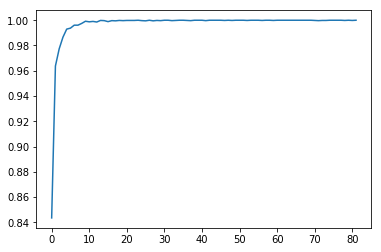

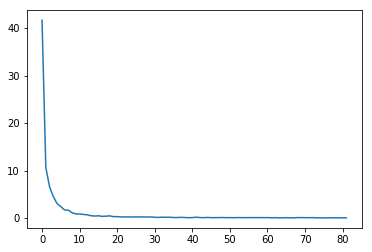

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.2427839916199446,

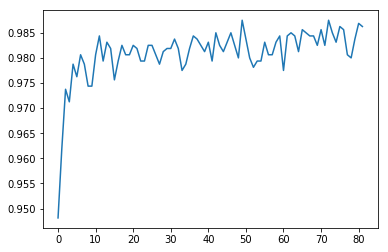

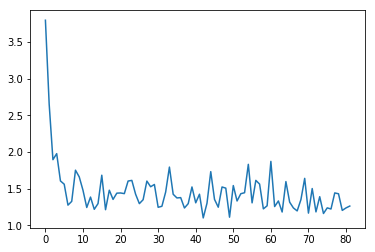


[82] accuracy: 0.986 loss: 1.262

Train
[83, 00020] loss: 0.005 acc: 1.000
[83, 00040] loss: 0.020 acc: 1.000
[83, 00060] loss: 0.027 acc: 1.000
[83, 00080] loss: 0.052 acc: 1.000
[83, 00100] loss: 0.055 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025073, 

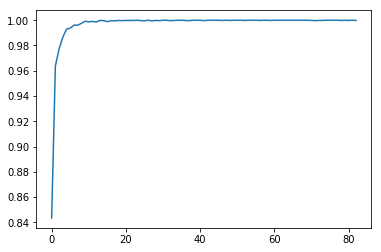

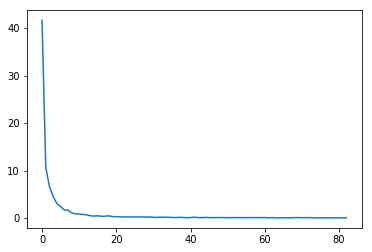

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1.242783991

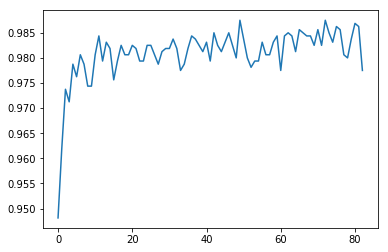

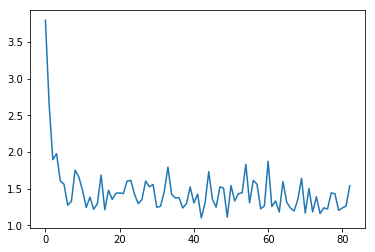


[83] accuracy: 0.978 loss: 1.541

Train
[84, 00020] loss: 0.005 acc: 1.000
[84, 00040] loss: 0.016 acc: 1.000
[84, 00060] loss: 0.022 acc: 1.000
[84, 00080] loss: 0.035 acc: 1.000
[84, 00100] loss: 0.039 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.516944034025

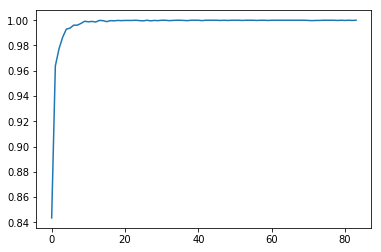

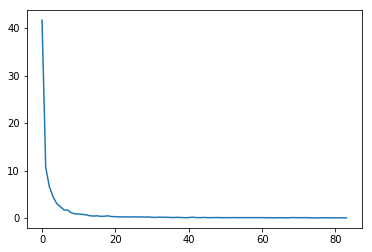

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.4772313870489597, 1

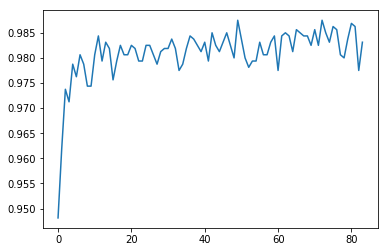

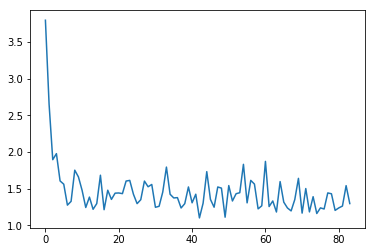


[84] accuracy: 0.983 loss: 1.296

Train
[85, 00020] loss: 0.041 acc: 1.000
[85, 00040] loss: 0.048 acc: 1.000
[85, 00060] loss: 0.057 acc: 1.000
[85, 00080] loss: 0.061 acc: 1.000
[85, 00100] loss: 0.065 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611258388, 4.5169440

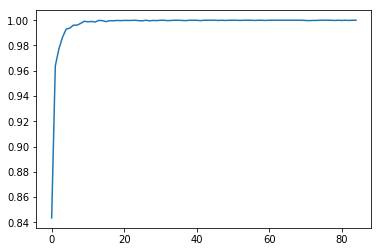

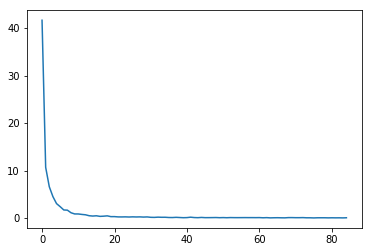

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1.477231387

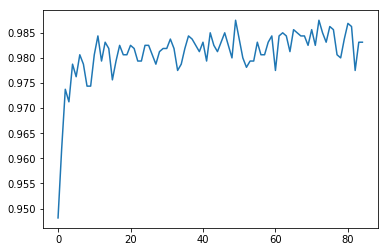

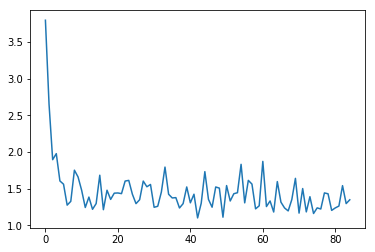


[85] accuracy: 0.983 loss: 1.348

Train
[86, 00020] loss: 0.042 acc: 0.999
[86, 00040] loss: 0.049 acc: 1.000
[86, 00060] loss: 0.053 acc: 1.000
[86, 00080] loss: 0.061 acc: 1.000
[86, 00100] loss: 0.069 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375]
[41.63294889032841, 10.686292132362723, 6.59327161125838

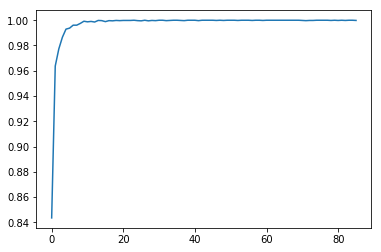

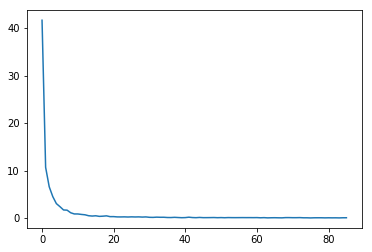

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6601712368428707, 1

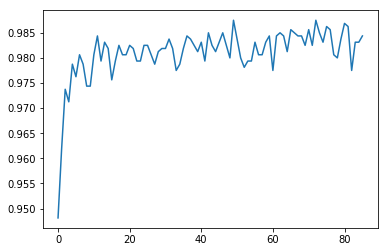

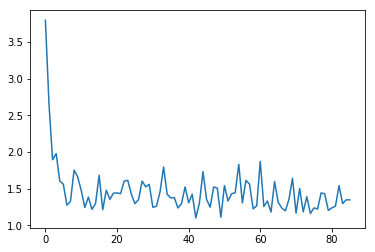


[86] accuracy: 0.984 loss: 1.346

Train
[87, 00020] loss: 0.006 acc: 1.000
[87, 00040] loss: 0.013 acc: 1.000
[87, 00060] loss: 0.022 acc: 1.000
[87, 00080] loss: 0.032 acc: 1.000
[87, 00100] loss: 0.037 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0]
[41.63294889032841, 10.686292132362723, 6.593271611

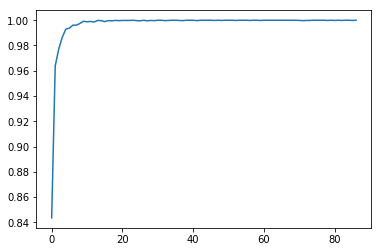

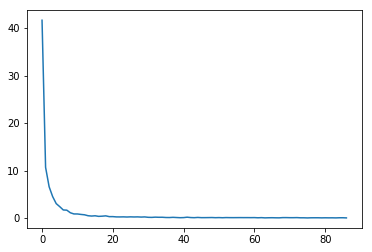

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.660171236

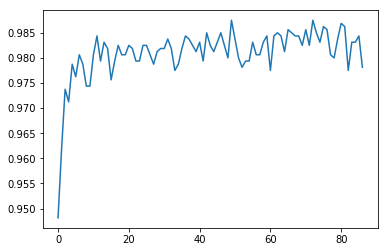

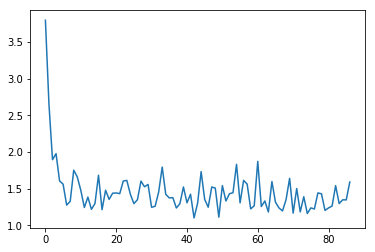


[87] accuracy: 0.978 loss: 1.590

Train
[88, 00020] loss: 0.005 acc: 1.000
[88, 00040] loss: 0.011 acc: 1.000
[88, 00060] loss: 0.015 acc: 1.000
[88, 00080] loss: 0.021 acc: 1.000
[88, 00100] loss: 0.030 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0]
[41.63294889032841, 10.686292132362723, 6.5932

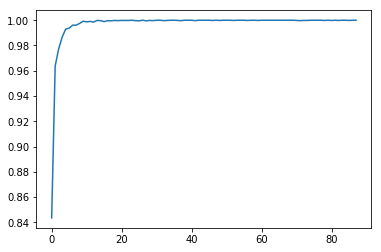

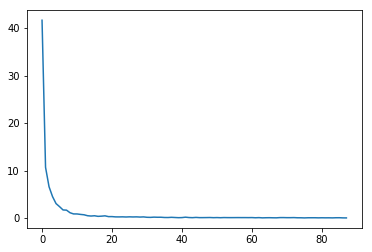

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7516746930778027, 1.6

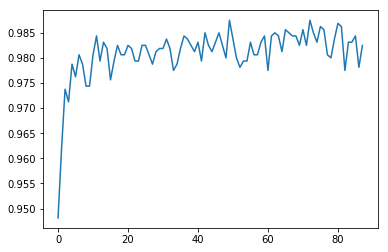

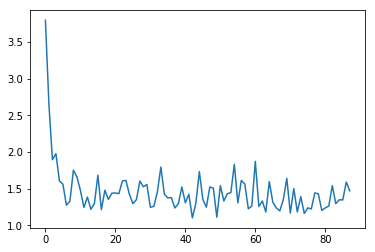


[88] accuracy: 0.983 loss: 1.471

Train
[89, 00020] loss: 0.013 acc: 1.000
[89, 00040] loss: 0.016 acc: 1.000
[89, 00060] loss: 0.024 acc: 1.000
[89, 00080] loss: 0.032 acc: 1.000
[89, 00100] loss: 0.039 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0]
[41.63294889032841, 10.686292132362723, 6

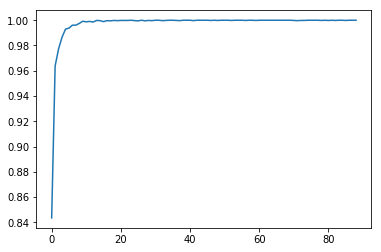

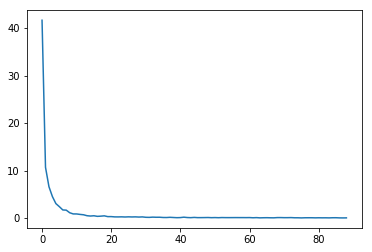

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.75167469307

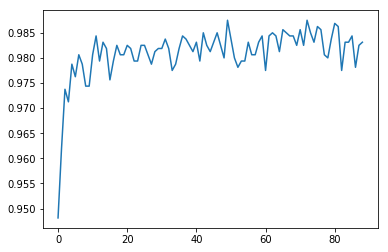

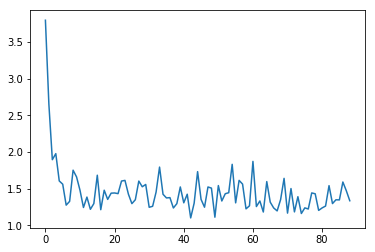


[89] accuracy: 0.983 loss: 1.335

Train
[90, 00020] loss: 0.004 acc: 1.000
[90, 00040] loss: 0.016 acc: 1.000
[90, 00060] loss: 0.023 acc: 1.000
[90, 00080] loss: 0.033 acc: 1.000
[90, 00100] loss: 0.041 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0]
[41.63294889032841, 10.6862921323627

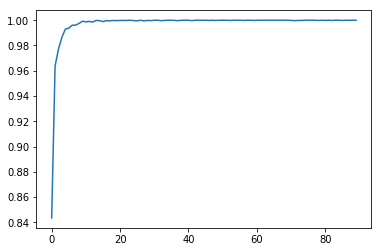

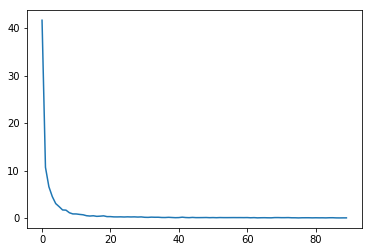

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3262515664100647, 1.7

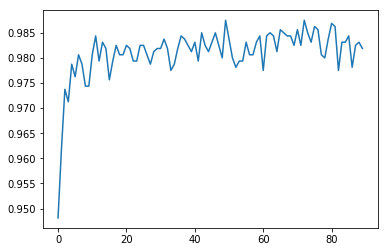

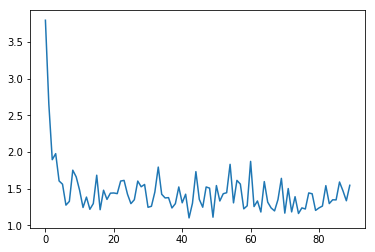


[90] accuracy: 0.982 loss: 1.545

Train
[91, 00020] loss: 0.004 acc: 1.000
[91, 00040] loss: 0.079 acc: 1.000
[91, 00060] loss: 0.087 acc: 1.000
[91, 00080] loss: 0.096 acc: 1.000
[91, 00100] loss: 0.101 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375]
[41.63294889032841, 10.6

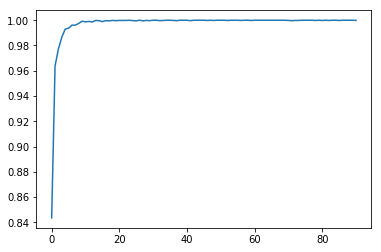

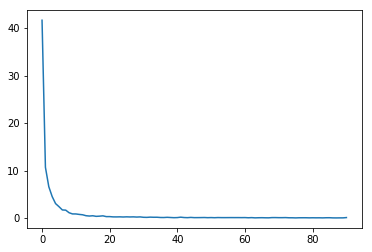

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.32625156641

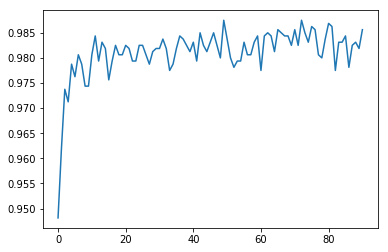

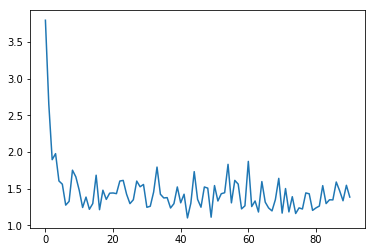


[91] accuracy: 0.986 loss: 1.385

Train
[92, 00020] loss: 0.008 acc: 1.000
[92, 00040] loss: 0.011 acc: 1.000
[92, 00060] loss: 0.018 acc: 1.000
[92, 00080] loss: 0.030 acc: 1.000
[92, 00100] loss: 0.034 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0]
[41.63294889032841,

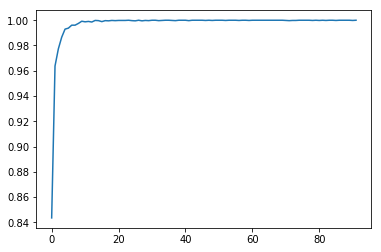

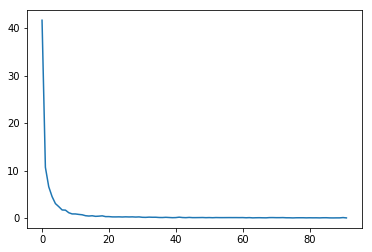

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2750028409063816, 1.3

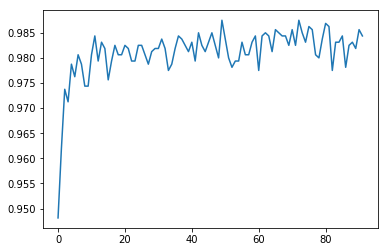

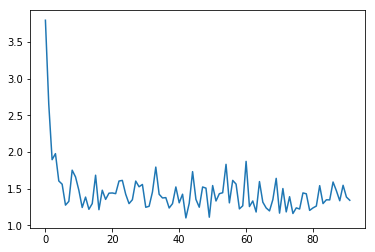


[92] accuracy: 0.984 loss: 1.341

Train
[93, 00020] loss: 0.005 acc: 1.000
[93, 00040] loss: 0.009 acc: 1.000
[93, 00060] loss: 0.017 acc: 1.000
[93, 00080] loss: 0.022 acc: 1.000
[93, 00100] loss: 0.043 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375]
[41.632

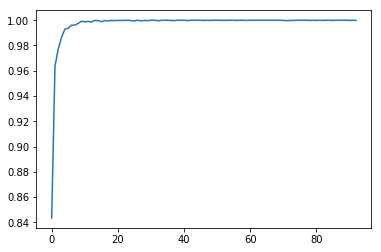

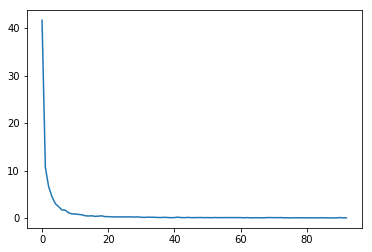

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.27500284090

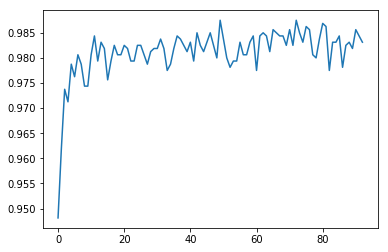

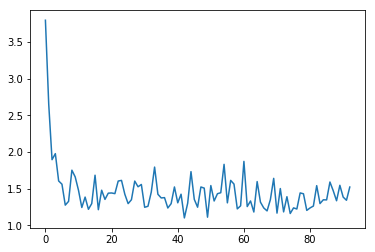


[93] accuracy: 0.983 loss: 1.522

Train
[94, 00020] loss: 0.003 acc: 1.000
[94, 00040] loss: 0.025 acc: 1.000
[94, 00060] loss: 0.028 acc: 1.000
[94, 00080] loss: 0.035 acc: 1.000
[94, 00100] loss: 0.041 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0.99984

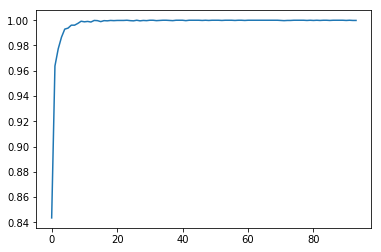

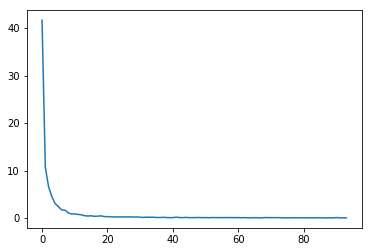

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604948420077562, 1.2

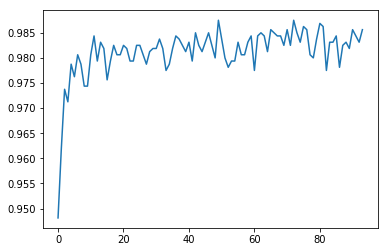

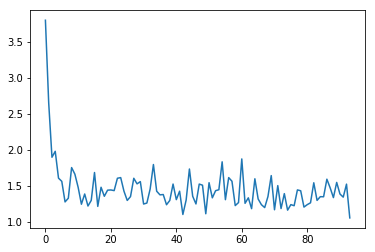


[94] accuracy: 0.986 loss: 1.053

Train
[95, 00020] loss: 0.004 acc: 1.000
[95, 00040] loss: 0.018 acc: 1.000
[95, 00060] loss: 0.027 acc: 1.000
[95, 00080] loss: 0.035 acc: 1.000
[95, 00100] loss: 0.044 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0.99984

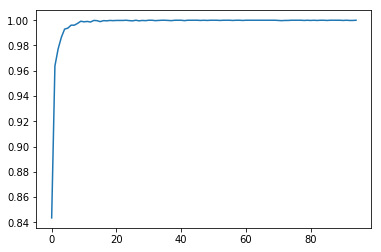

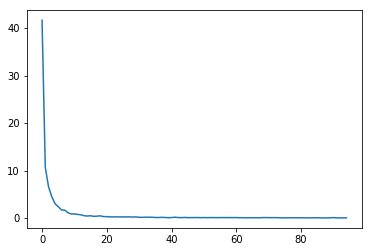

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.56049484200775

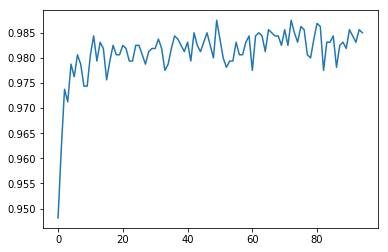

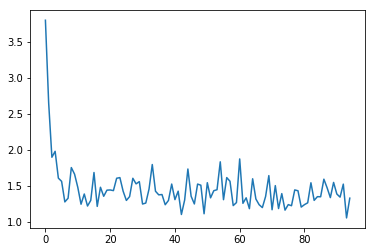


[95] accuracy: 0.985 loss: 1.327

Train
[96, 00020] loss: 0.008 acc: 1.000
[96, 00040] loss: 0.021 acc: 1.000
[96, 00060] loss: 0.025 acc: 1.000
[96, 00080] loss: 0.053 acc: 1.000
[96, 00100] loss: 0.062 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0.99984

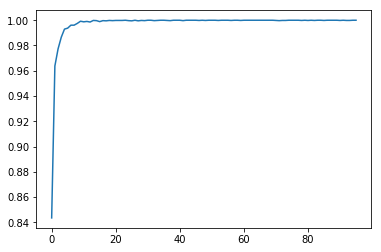

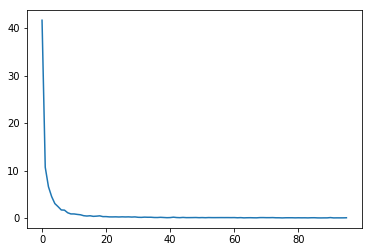

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048156060278416, 1.5604

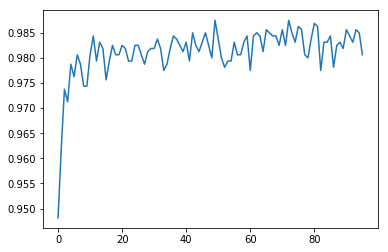

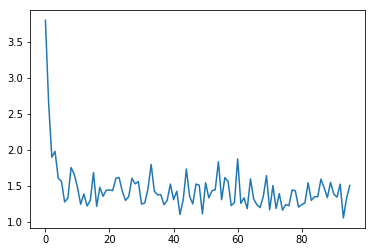


[96] accuracy: 0.981 loss: 1.503

Train
[97, 00020] loss: 0.005 acc: 1.000
[97, 00040] loss: 0.009 acc: 1.000
[97, 00060] loss: 0.014 acc: 1.000
[97, 00080] loss: 0.024 acc: 1.000
[97, 00100] loss: 0.030 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0.99984

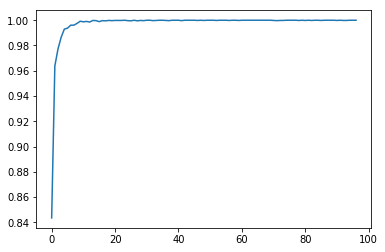

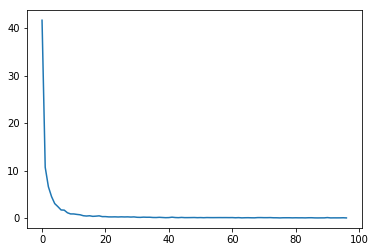

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.60481560602784

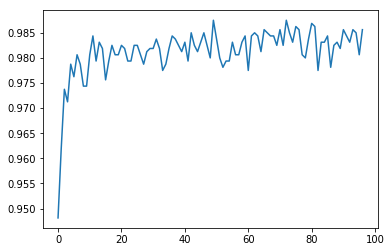

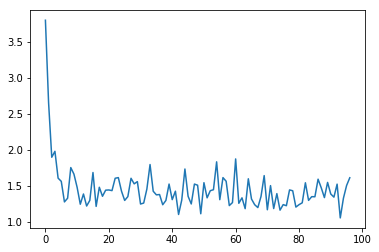


[97] accuracy: 0.986 loss: 1.610

Train
[98, 00020] loss: 0.006 acc: 1.000
[98, 00040] loss: 0.013 acc: 1.000
[98, 00060] loss: 0.017 acc: 1.000
[98, 00080] loss: 0.020 acc: 1.000
[98, 00100] loss: 0.024 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0.99984

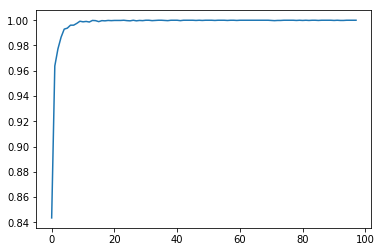

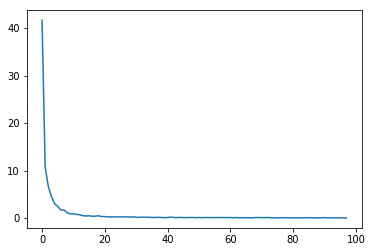

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774797651916742, 1.6048

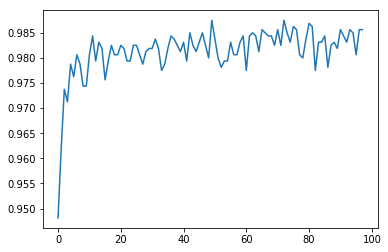

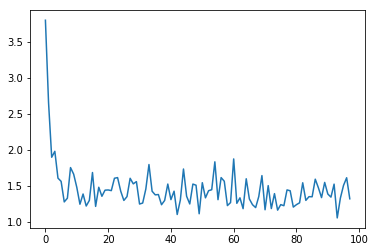


[98] accuracy: 0.986 loss: 1.318

Train
[99, 00020] loss: 0.030 acc: 0.999
[99, 00040] loss: 0.034 acc: 1.000
[99, 00060] loss: 0.046 acc: 1.000
[99, 00080] loss: 0.054 acc: 1.000
[99, 00100] loss: 0.058 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0.99984

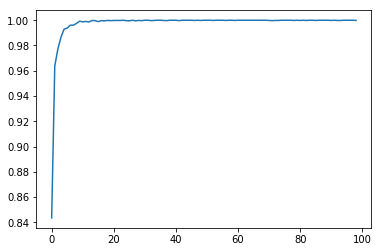

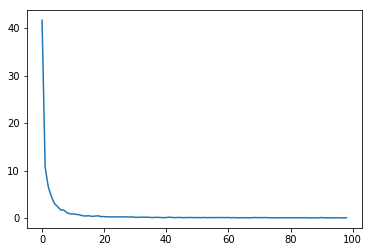

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.97747976519167

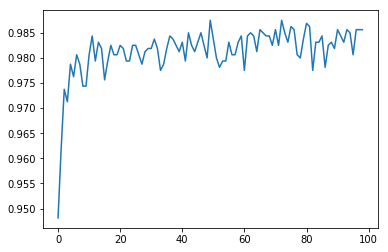

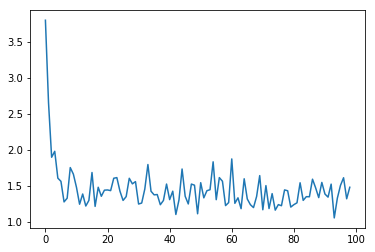


[99] accuracy: 0.986 loss: 1.478

Train
[100, 00020] loss: 0.017 acc: 1.000
[100, 00040] loss: 0.021 acc: 1.000
[100, 00060] loss: 0.039 acc: 1.000
[100, 00080] loss: 0.043 acc: 1.000
[100, 00100] loss: 0.053 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0.

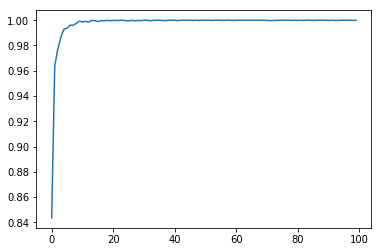

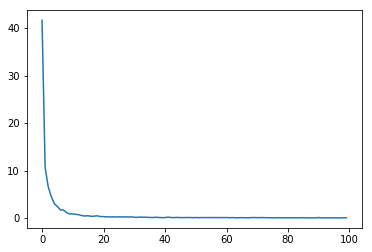

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125]
[3.797313243150711, 2.652056358754635, 1.8950053676962852, 1.9774

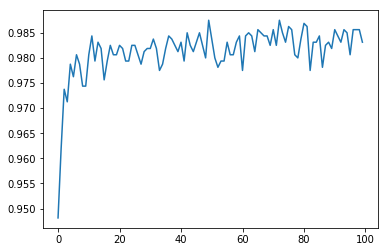

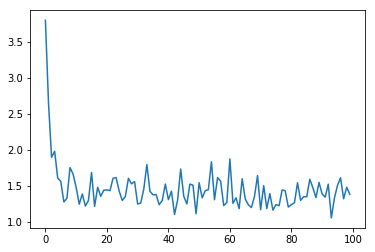


[100] accuracy: 0.983 loss: 1.380

Train
[101, 00020] loss: 0.006 acc: 1.000
[101, 00040] loss: 0.012 acc: 1.000
[101, 00060] loss: 0.021 acc: 1.000
[101, 00080] loss: 0.029 acc: 1.000
[101, 00100] loss: 0.047 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

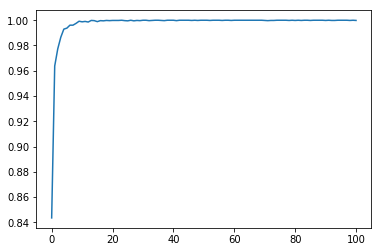

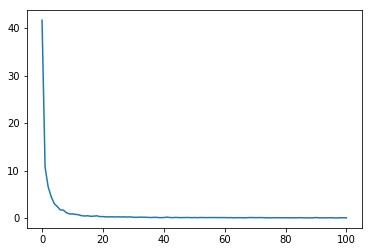

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875]
[3.797313243150711, 2.652056358754635, 1.89500536769628

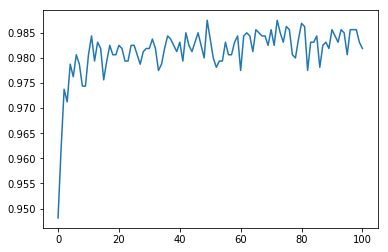

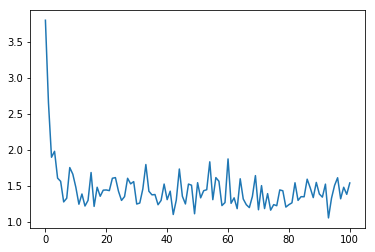


[101] accuracy: 0.982 loss: 1.538

Train
[102, 00020] loss: 0.005 acc: 1.000
[102, 00040] loss: 0.009 acc: 1.000
[102, 00060] loss: 0.019 acc: 1.000
[102, 00080] loss: 0.022 acc: 1.000
[102, 00100] loss: 0.028 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

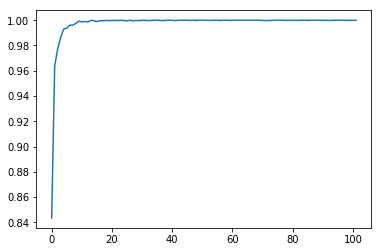

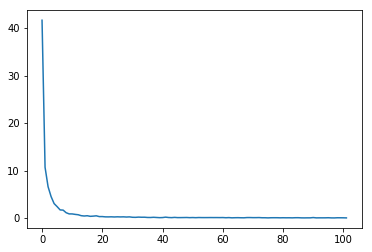

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375]
[3.797313243150711, 2.652056358754635, 1.89500

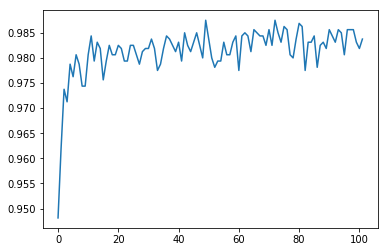

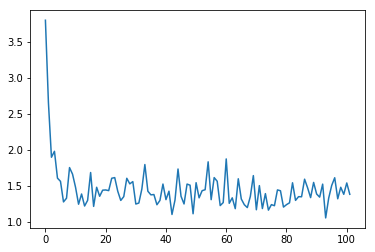


[102] accuracy: 0.984 loss: 1.381

Train
[103, 00020] loss: 0.007 acc: 1.000
[103, 00040] loss: 0.024 acc: 1.000
[103, 00060] loss: 0.029 acc: 1.000
[103, 00080] loss: 0.033 acc: 1.000
[103, 00100] loss: 0.050 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

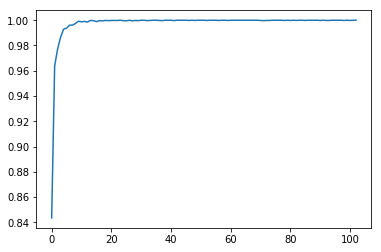

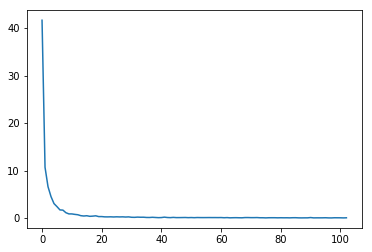

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825]
[3.797313243150711, 2.652056358754635,

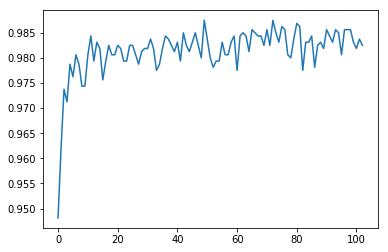

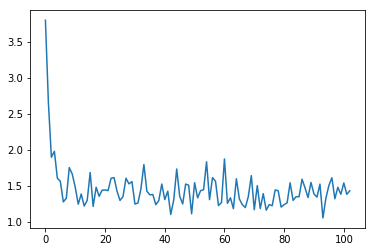


[103] accuracy: 0.983 loss: 1.429

Train
[104, 00020] loss: 0.009 acc: 1.000
[104, 00040] loss: 0.015 acc: 1.000
[104, 00060] loss: 0.025 acc: 1.000
[104, 00080] loss: 0.047 acc: 1.000
[104, 00100] loss: 0.054 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

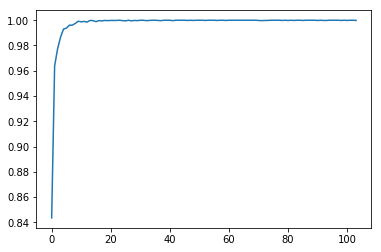

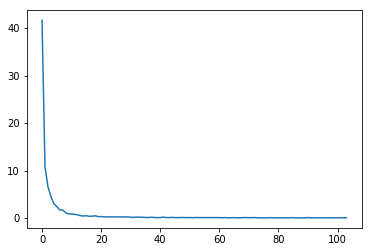

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625]
[3.797313243150711, 2.6520563

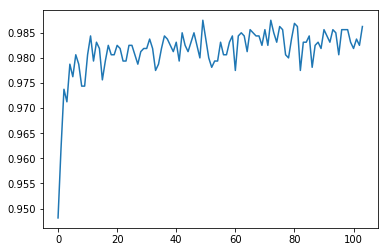

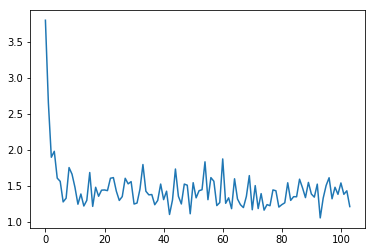


[104] accuracy: 0.986 loss: 1.210

Train
[105, 00020] loss: 0.002 acc: 1.000
[105, 00040] loss: 0.006 acc: 1.000
[105, 00060] loss: 0.012 acc: 1.000
[105, 00080] loss: 0.021 acc: 1.000
[105, 00100] loss: 0.045 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

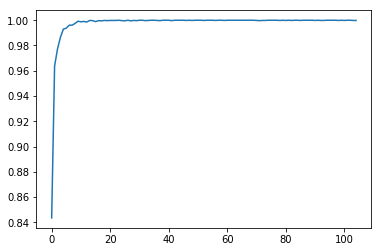

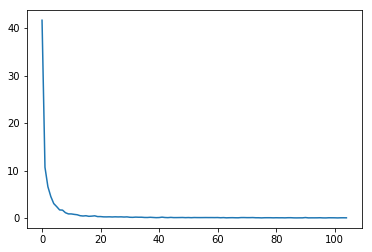

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125]
[3.797313243150711,

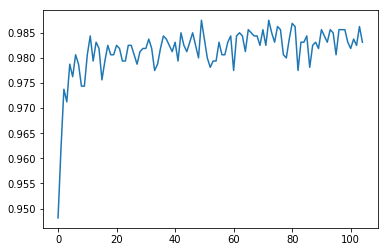

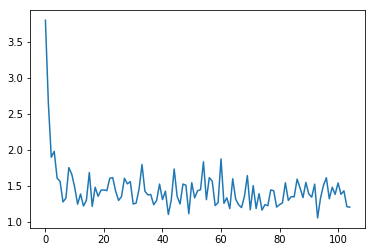


[105] accuracy: 0.983 loss: 1.201

Train
[106, 00020] loss: 0.012 acc: 1.000
[106, 00040] loss: 0.019 acc: 1.000
[106, 00060] loss: 0.025 acc: 1.000
[106, 00080] loss: 0.030 acc: 1.000
[106, 00100] loss: 0.035 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

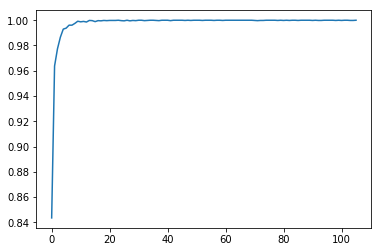

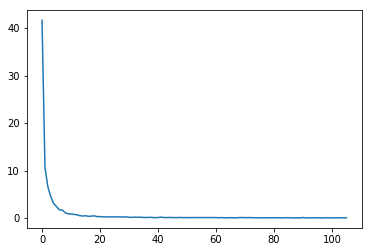

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985]
[3.797313243

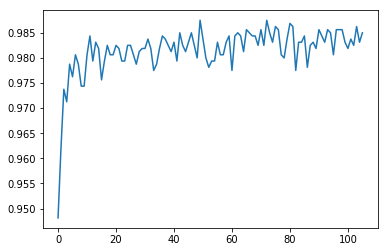

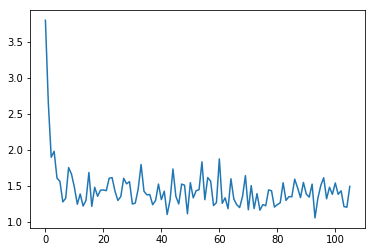


[106] accuracy: 0.985 loss: 1.490

Train
[107, 00020] loss: 0.002 acc: 1.000
[107, 00040] loss: 0.054 acc: 1.000
[107, 00060] loss: 0.077 acc: 0.999
[107, 00080] loss: 0.088 acc: 1.000
[107, 00100] loss: 0.092 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

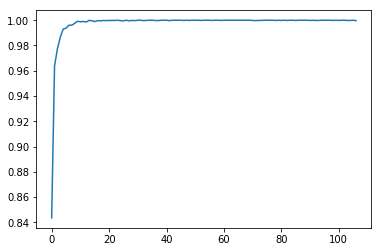

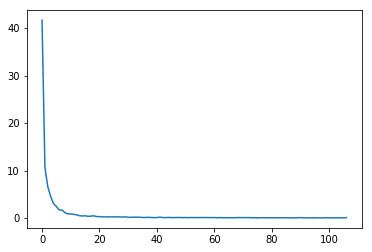

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625]
[3

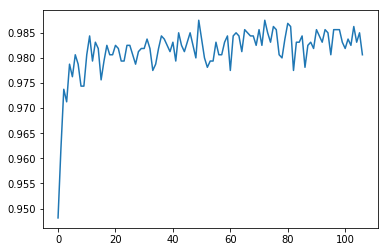

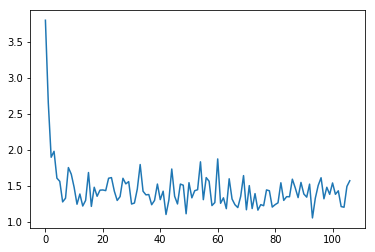


[107] accuracy: 0.981 loss: 1.569

Train
[108, 00020] loss: 0.006 acc: 1.000
[108, 00040] loss: 0.015 acc: 1.000
[108, 00060] loss: 0.035 acc: 1.000
[108, 00080] loss: 0.041 acc: 1.000
[108, 00100] loss: 0.179 acc: 0.999
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

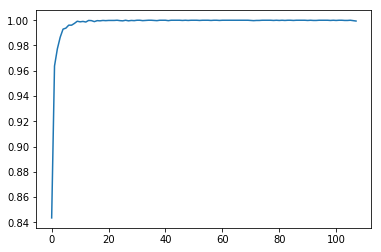

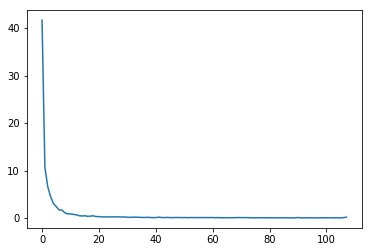

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

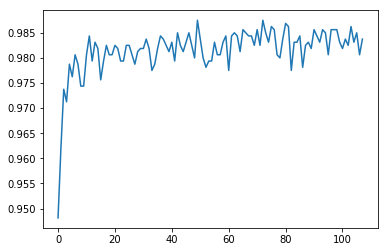

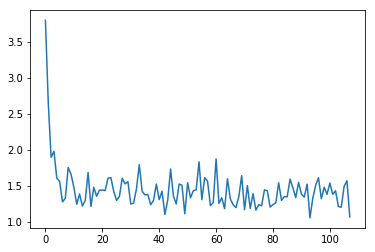


[108] accuracy: 0.984 loss: 1.068

Train
[109, 00020] loss: 0.004 acc: 1.000
[109, 00040] loss: 0.008 acc: 1.000
[109, 00060] loss: 0.013 acc: 1.000
[109, 00080] loss: 0.020 acc: 1.000
[109, 00100] loss: 0.024 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

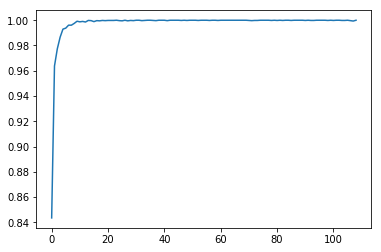

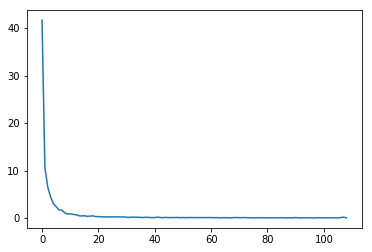

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

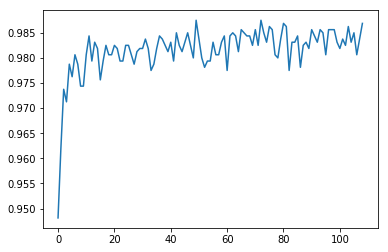

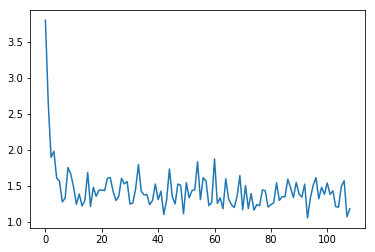


[109] accuracy: 0.987 loss: 1.181

Train
[110, 00020] loss: 0.051 acc: 0.999
[110, 00040] loss: 0.056 acc: 1.000
[110, 00060] loss: 0.065 acc: 1.000
[110, 00080] loss: 0.069 acc: 1.000
[110, 00100] loss: 0.076 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

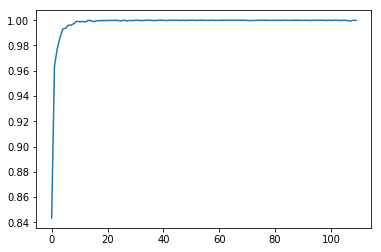

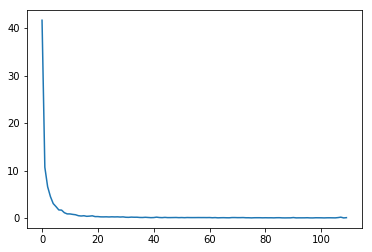

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

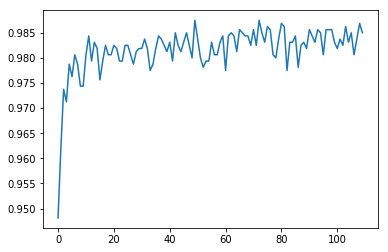

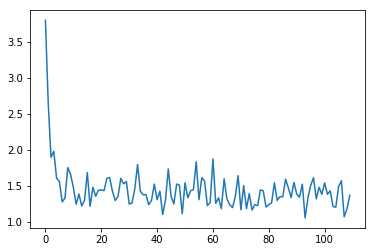


[110] accuracy: 0.985 loss: 1.367

Train
[111, 00020] loss: 0.014 acc: 1.000
[111, 00040] loss: 0.018 acc: 1.000
[111, 00060] loss: 0.026 acc: 1.000
[111, 00080] loss: 0.034 acc: 1.000
[111, 00100] loss: 0.044 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

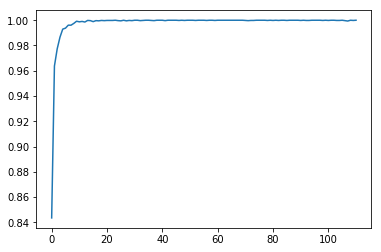

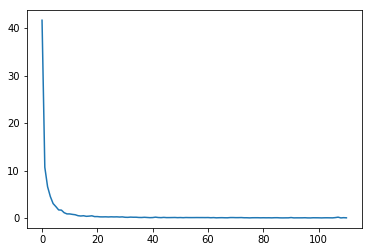

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

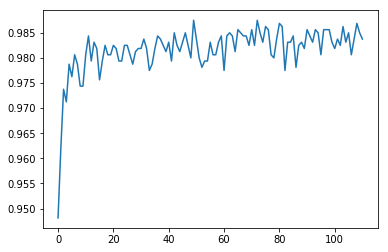

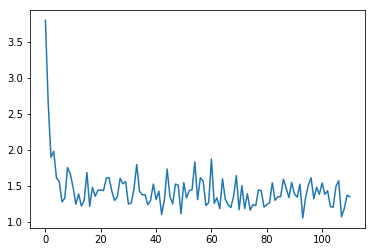


[111] accuracy: 0.984 loss: 1.347

Train
[112, 00020] loss: 0.005 acc: 1.000
[112, 00040] loss: 0.020 acc: 1.000
[112, 00060] loss: 0.033 acc: 1.000
[112, 00080] loss: 0.036 acc: 1.000
[112, 00100] loss: 0.041 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

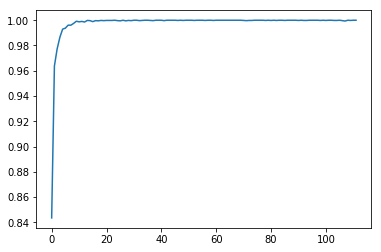

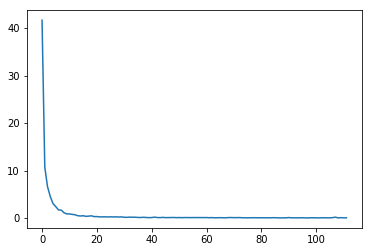

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

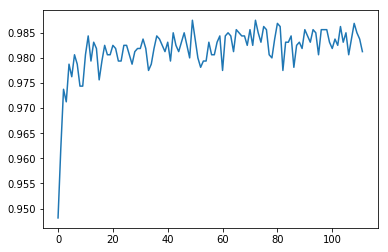

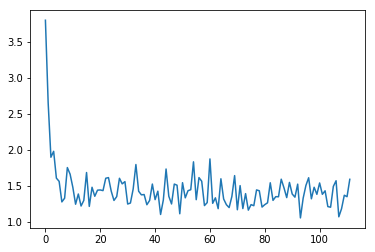


[112] accuracy: 0.981 loss: 1.589

Train
[113, 00020] loss: 0.006 acc: 1.000
[113, 00040] loss: 0.012 acc: 1.000
[113, 00060] loss: 0.015 acc: 1.000
[113, 00080] loss: 0.021 acc: 1.000
[113, 00100] loss: 0.025 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

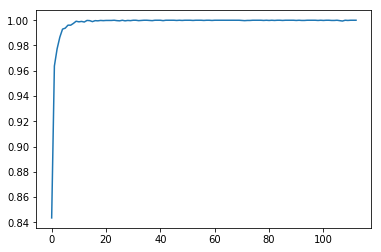

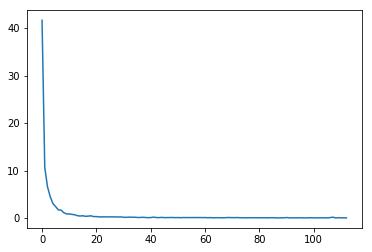

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

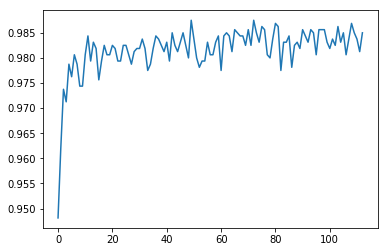

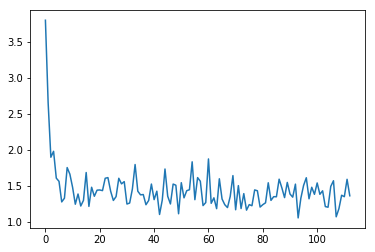


[113] accuracy: 0.985 loss: 1.360

Train
[114, 00020] loss: 0.009 acc: 1.000
[114, 00040] loss: 0.016 acc: 1.000
[114, 00060] loss: 0.019 acc: 1.000
[114, 00080] loss: 0.022 acc: 1.000
[114, 00100] loss: 0.033 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

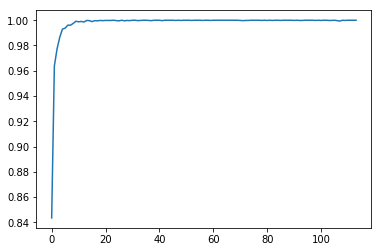

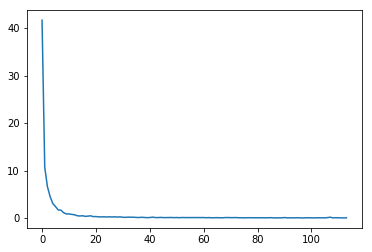

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

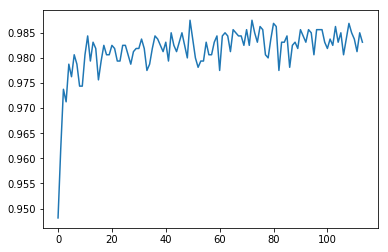

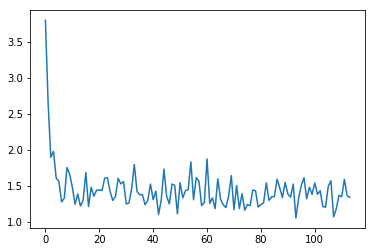


[114] accuracy: 0.983 loss: 1.338

Train
[115, 00020] loss: 0.007 acc: 1.000
[115, 00040] loss: 0.012 acc: 1.000
[115, 00060] loss: 0.020 acc: 1.000
[115, 00080] loss: 0.024 acc: 1.000
[115, 00100] loss: 0.033 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

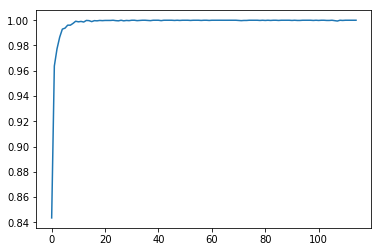

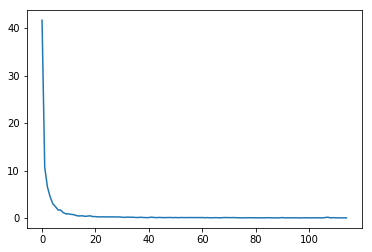

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

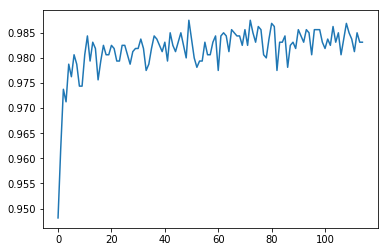

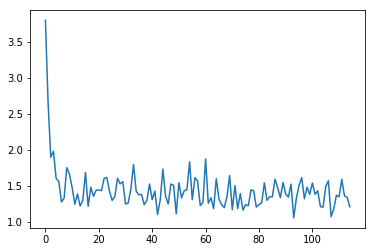


[115] accuracy: 0.983 loss: 1.208

Train
[116, 00020] loss: 0.007 acc: 1.000
[116, 00040] loss: 0.014 acc: 1.000
[116, 00060] loss: 0.029 acc: 1.000
[116, 00080] loss: 0.033 acc: 1.000
[116, 00100] loss: 0.036 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

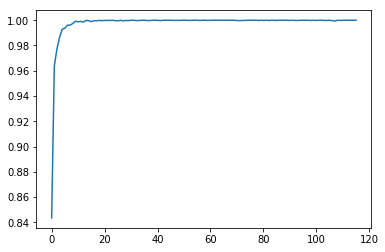

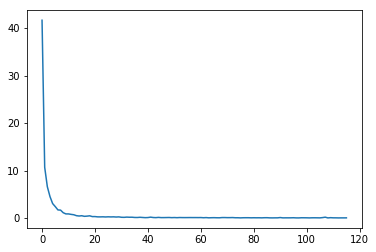

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

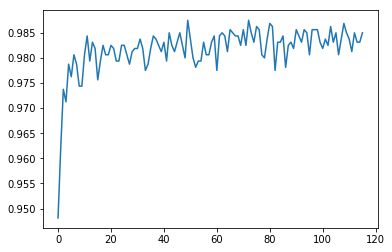

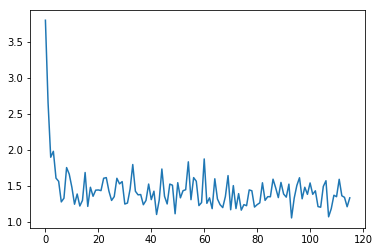


[116] accuracy: 0.985 loss: 1.331

Train
[117, 00020] loss: 0.006 acc: 1.000
[117, 00040] loss: 0.012 acc: 1.000
[117, 00060] loss: 0.029 acc: 1.000
[117, 00080] loss: 0.034 acc: 1.000
[117, 00100] loss: 0.042 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

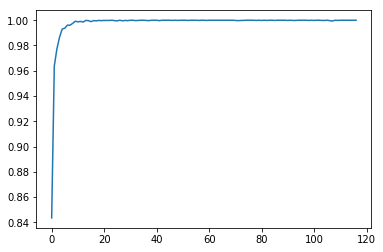

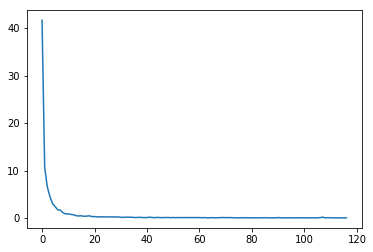

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

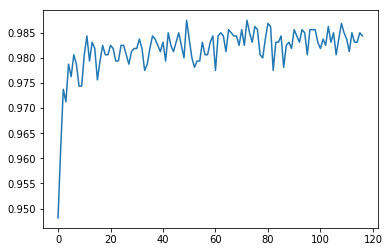

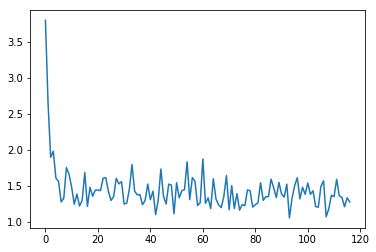


[117] accuracy: 0.984 loss: 1.274

Train
[118, 00020] loss: 0.006 acc: 1.000
[118, 00040] loss: 0.015 acc: 1.000
[118, 00060] loss: 0.021 acc: 1.000
[118, 00080] loss: 0.025 acc: 1.000
[118, 00100] loss: 0.031 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

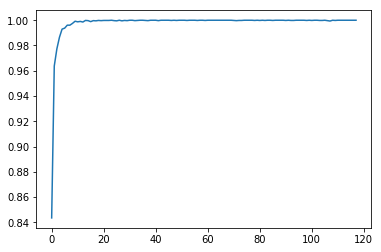

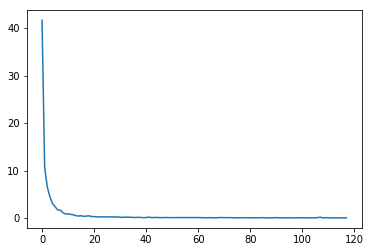

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

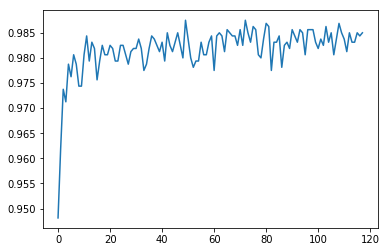

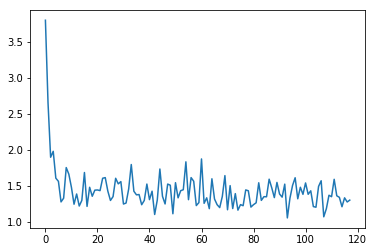


[118] accuracy: 0.985 loss: 1.300

Train
[119, 00020] loss: 0.006 acc: 1.000
[119, 00040] loss: 0.016 acc: 1.000
[119, 00060] loss: 0.019 acc: 1.000
[119, 00080] loss: 0.032 acc: 1.000
[119, 00100] loss: 0.040 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

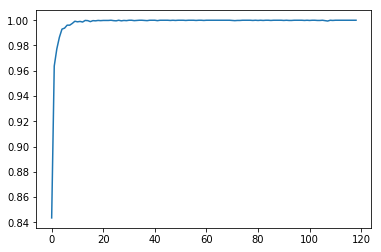

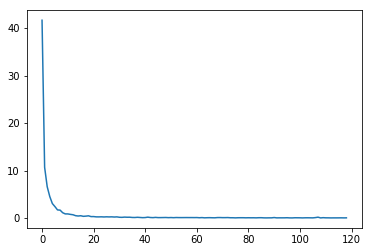

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

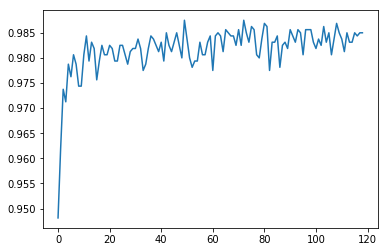

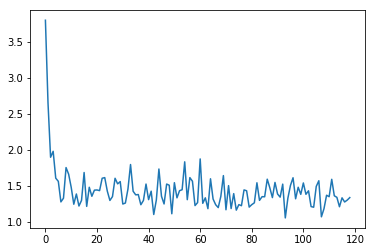


[119] accuracy: 0.985 loss: 1.335

Train
[120, 00020] loss: 0.006 acc: 1.000
[120, 00040] loss: 0.008 acc: 1.000
[120, 00060] loss: 0.014 acc: 1.000
[120, 00080] loss: 0.018 acc: 1.000
[120, 00100] loss: 0.025 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

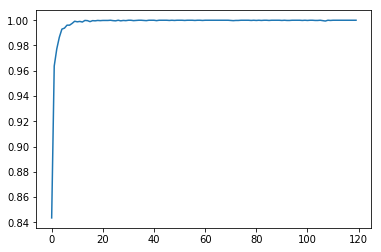

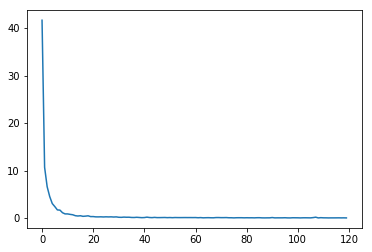

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

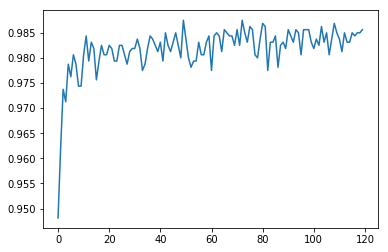

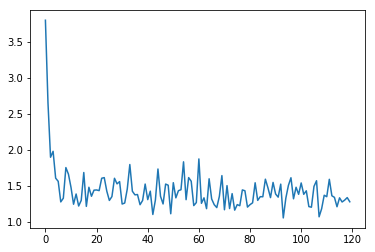


[120] accuracy: 0.986 loss: 1.277

Train
[121, 00020] loss: 0.005 acc: 1.000
[121, 00040] loss: 0.013 acc: 1.000
[121, 00060] loss: 0.026 acc: 1.000
[121, 00080] loss: 0.030 acc: 1.000
[121, 00100] loss: 0.035 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

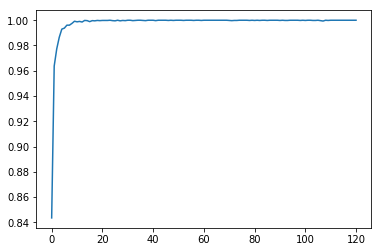

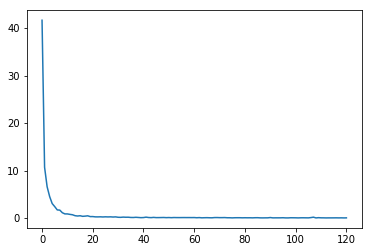

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

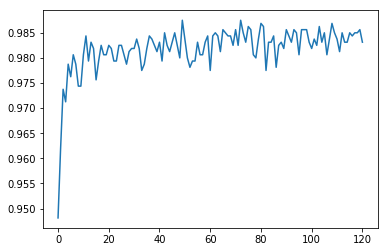

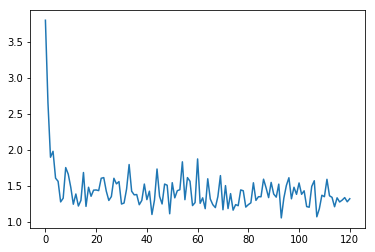


[121] accuracy: 0.983 loss: 1.319

Train
[122, 00020] loss: 0.003 acc: 1.000
[122, 00040] loss: 0.008 acc: 1.000
[122, 00060] loss: 0.014 acc: 1.000
[122, 00080] loss: 0.039 acc: 1.000
[122, 00100] loss: 0.046 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

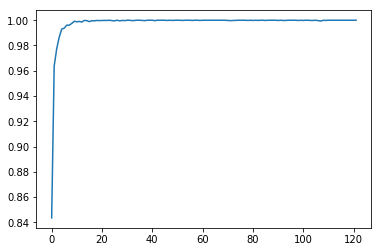

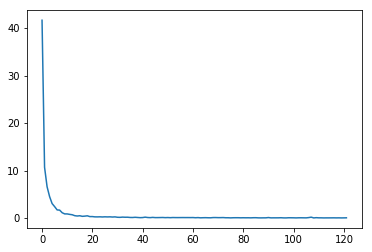

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

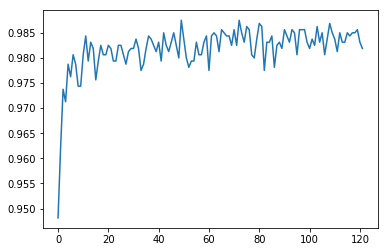

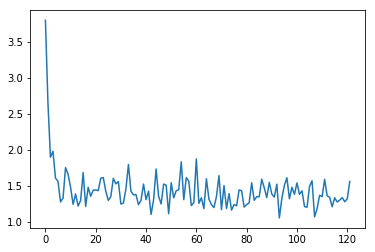


[122] accuracy: 0.982 loss: 1.559

Train
[123, 00020] loss: 0.009 acc: 1.000
[123, 00040] loss: 0.012 acc: 1.000
[123, 00060] loss: 0.016 acc: 1.000
[123, 00080] loss: 0.020 acc: 1.000
[123, 00100] loss: 0.024 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

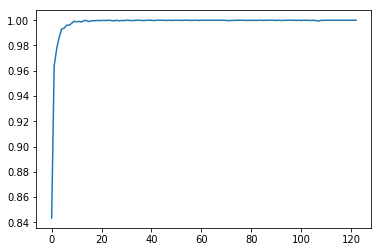

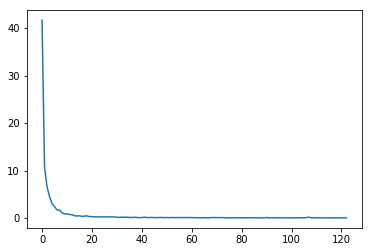

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

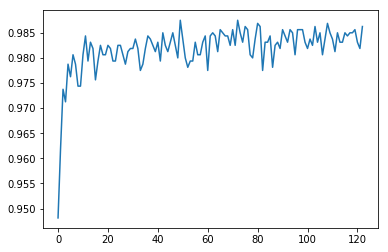

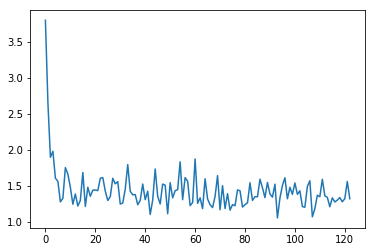


[123] accuracy: 0.986 loss: 1.319

Train
[124, 00020] loss: 0.005 acc: 1.000
[124, 00040] loss: 0.024 acc: 1.000
[124, 00060] loss: 0.026 acc: 1.000
[124, 00080] loss: 0.031 acc: 1.000
[124, 00100] loss: 0.036 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

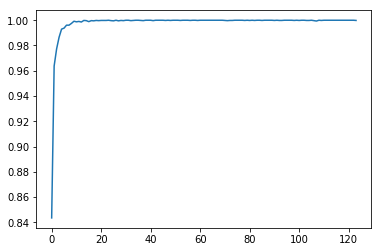

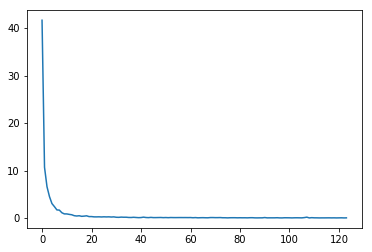

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

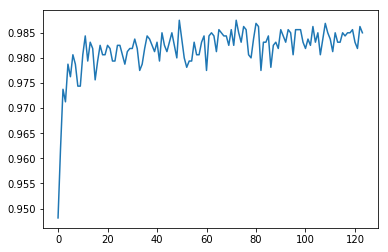

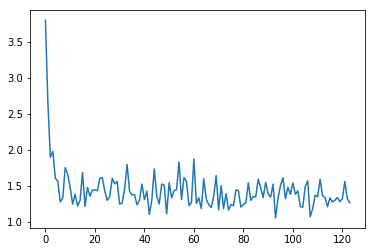


[124] accuracy: 0.985 loss: 1.264

Train
[125, 00020] loss: 0.003 acc: 1.000
[125, 00040] loss: 0.012 acc: 1.000
[125, 00060] loss: 0.015 acc: 1.000
[125, 00080] loss: 0.020 acc: 1.000
[125, 00100] loss: 0.022 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

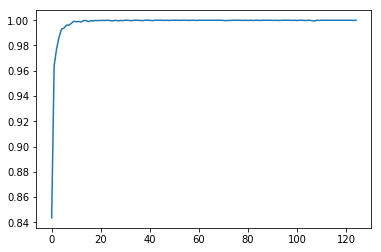

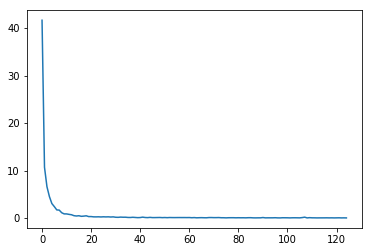

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

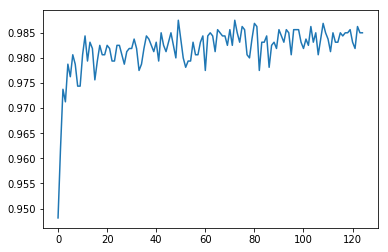

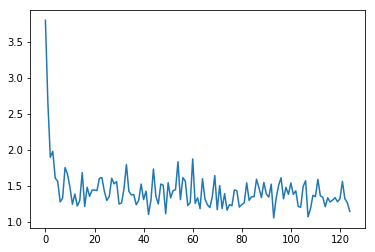


[125] accuracy: 0.985 loss: 1.143

Train
[126, 00020] loss: 0.004 acc: 1.000
[126, 00040] loss: 0.005 acc: 1.000
[126, 00060] loss: 0.014 acc: 1.000
[126, 00080] loss: 0.030 acc: 1.000
[126, 00100] loss: 0.038 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

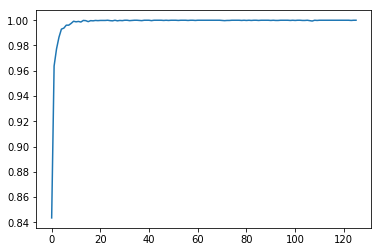

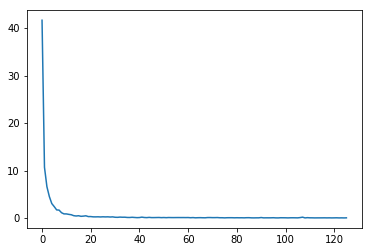

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

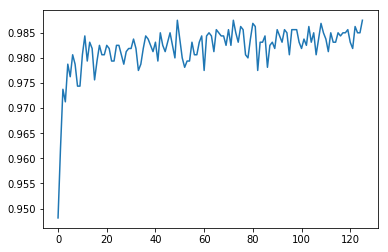

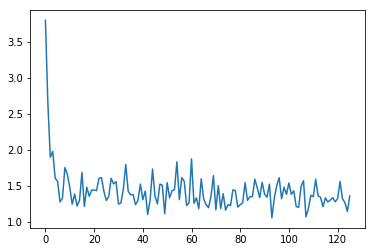


[126] accuracy: 0.988 loss: 1.358

Train
[127, 00020] loss: 0.004 acc: 1.000
[127, 00040] loss: 0.007 acc: 1.000
[127, 00060] loss: 0.014 acc: 1.000
[127, 00080] loss: 0.016 acc: 1.000
[127, 00100] loss: 0.024 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

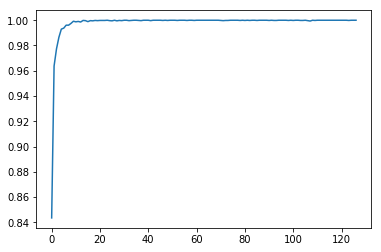

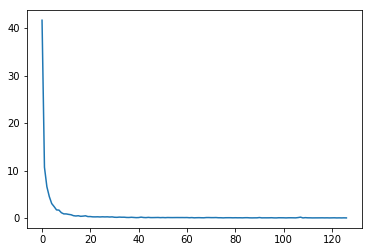

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

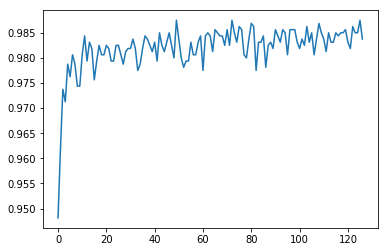

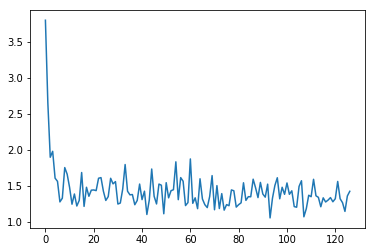


[127] accuracy: 0.984 loss: 1.422

Train
[128, 00020] loss: 0.004 acc: 1.000
[128, 00040] loss: 0.006 acc: 1.000
[128, 00060] loss: 0.010 acc: 1.000
[128, 00080] loss: 0.014 acc: 1.000
[128, 00100] loss: 0.018 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

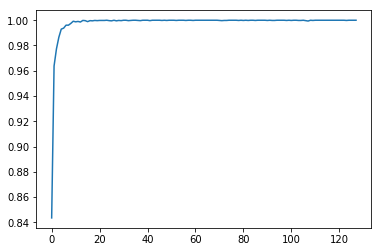

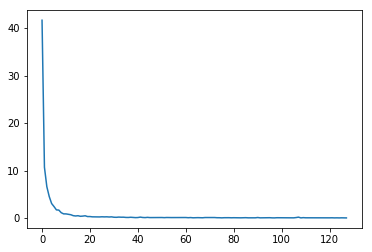

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

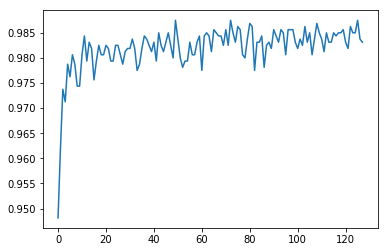

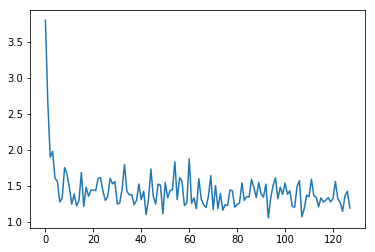


[128] accuracy: 0.983 loss: 1.190

Train
[129, 00020] loss: 0.002 acc: 1.000
[129, 00040] loss: 0.010 acc: 1.000
[129, 00060] loss: 0.016 acc: 1.000
[129, 00080] loss: 0.019 acc: 1.000
[129, 00100] loss: 0.025 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

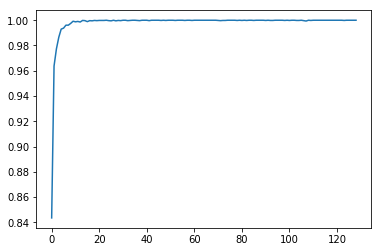

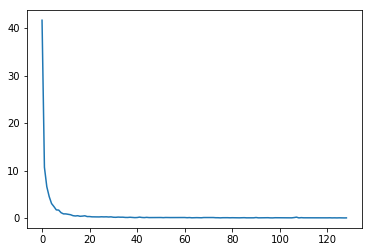

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

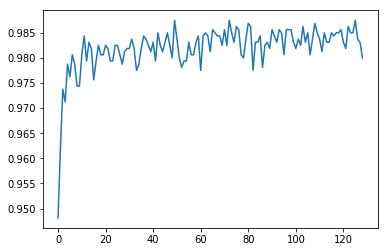

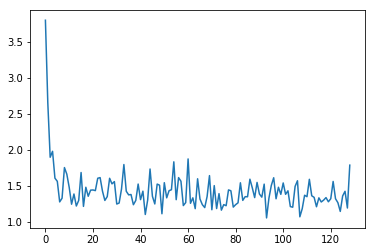


[129] accuracy: 0.980 loss: 1.785

Train
[130, 00020] loss: 0.008 acc: 1.000
[130, 00040] loss: 0.024 acc: 1.000
[130, 00060] loss: 0.027 acc: 1.000
[130, 00080] loss: 0.034 acc: 1.000
[130, 00100] loss: 0.039 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

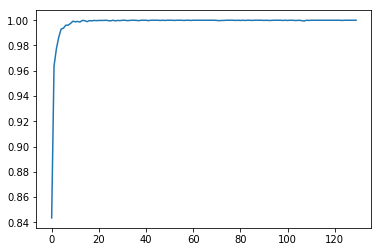

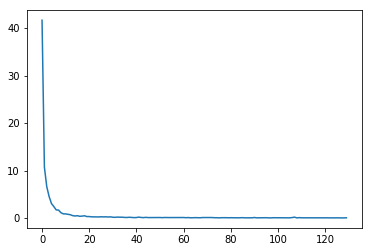

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

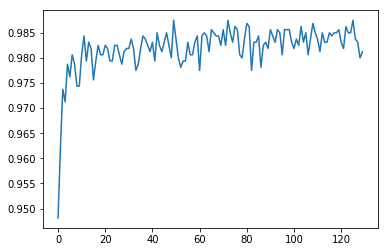

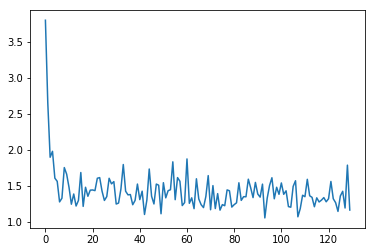


[130] accuracy: 0.981 loss: 1.162

Train
[131, 00020] loss: 0.021 acc: 1.000
[131, 00040] loss: 0.033 acc: 1.000
[131, 00060] loss: 0.037 acc: 1.000
[131, 00080] loss: 0.043 acc: 1.000
[131, 00100] loss: 0.049 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

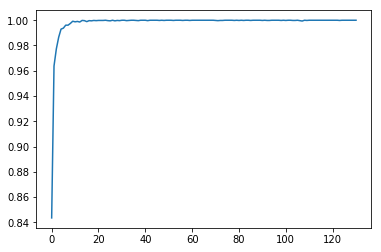

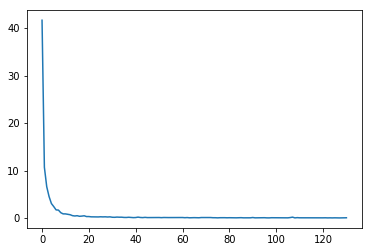

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

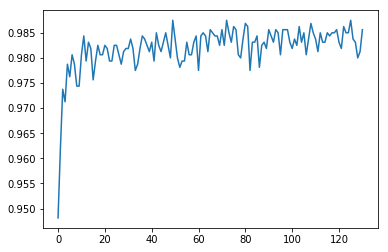

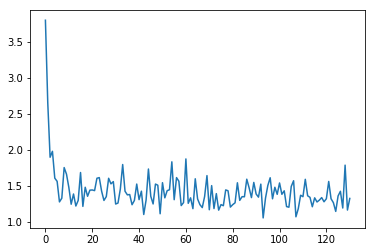


[131] accuracy: 0.986 loss: 1.323

Train
[132, 00020] loss: 0.006 acc: 1.000
[132, 00040] loss: 0.008 acc: 1.000
[132, 00060] loss: 0.013 acc: 1.000
[132, 00080] loss: 0.015 acc: 1.000
[132, 00100] loss: 0.019 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

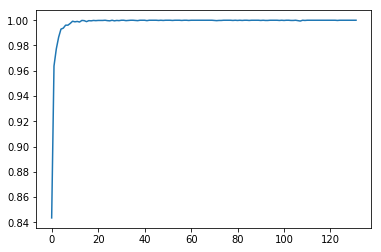

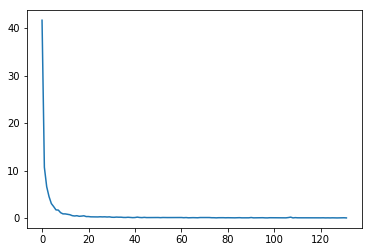

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

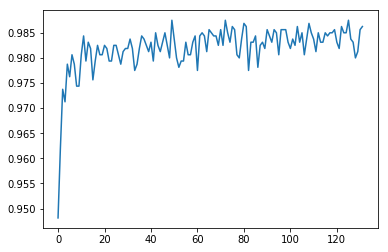

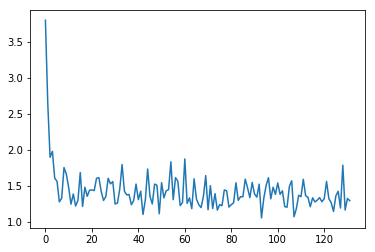


[132] accuracy: 0.986 loss: 1.292

Train
[133, 00020] loss: 0.007 acc: 1.000
[133, 00040] loss: 0.010 acc: 1.000
[133, 00060] loss: 0.015 acc: 1.000
[133, 00080] loss: 0.019 acc: 1.000
[133, 00100] loss: 0.023 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

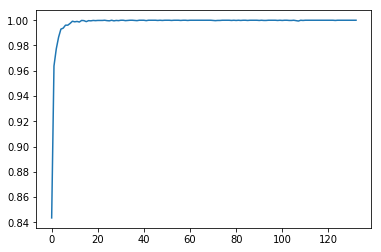

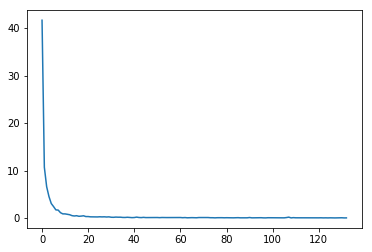

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

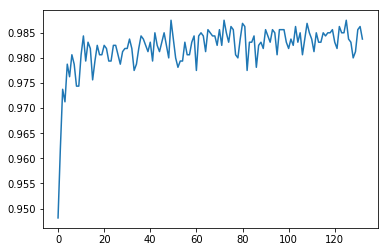

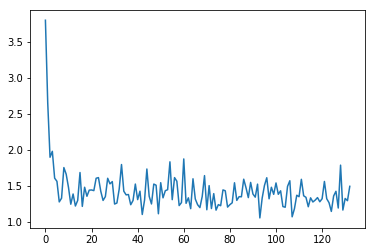


[133] accuracy: 0.984 loss: 1.491

Train
[134, 00020] loss: 0.007 acc: 1.000
[134, 00040] loss: 0.011 acc: 1.000
[134, 00060] loss: 0.014 acc: 1.000
[134, 00080] loss: 0.017 acc: 1.000
[134, 00100] loss: 0.024 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

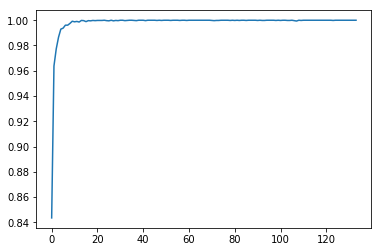

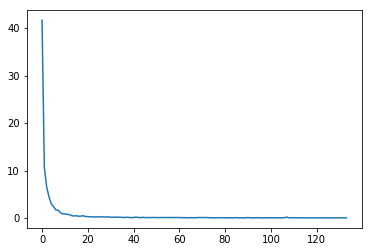

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

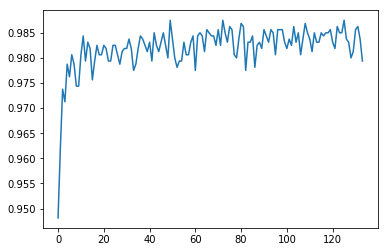

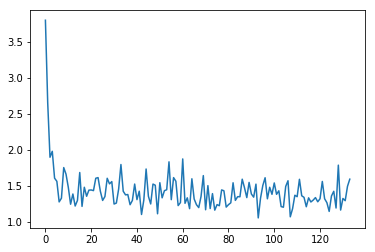


[134] accuracy: 0.979 loss: 1.591

Train
[135, 00020] loss: 0.007 acc: 1.000
[135, 00040] loss: 0.014 acc: 1.000
[135, 00060] loss: 0.021 acc: 1.000
[135, 00080] loss: 0.025 acc: 1.000
[135, 00100] loss: 0.029 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

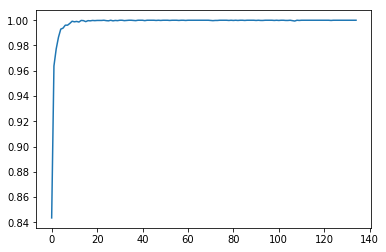

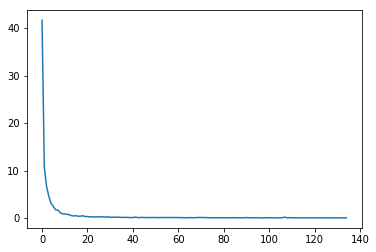

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

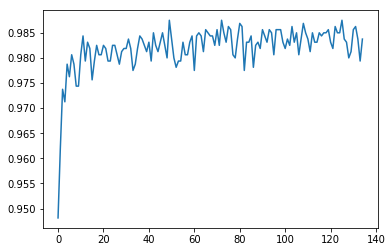

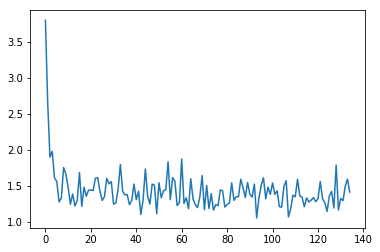


[135] accuracy: 0.984 loss: 1.411

Train
[136, 00020] loss: 0.005 acc: 1.000
[136, 00040] loss: 0.008 acc: 1.000
[136, 00060] loss: 0.011 acc: 1.000
[136, 00080] loss: 0.013 acc: 1.000
[136, 00100] loss: 0.019 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

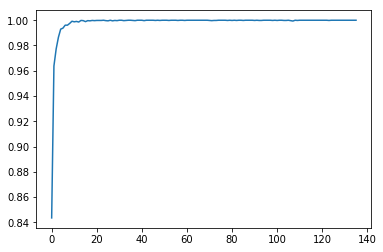

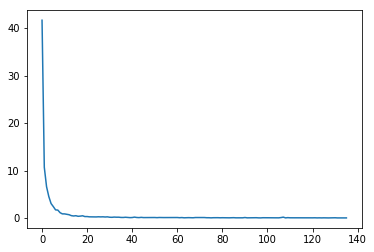

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

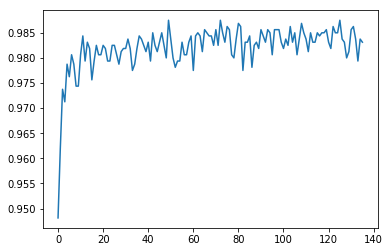

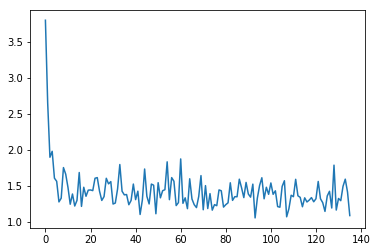


[136] accuracy: 0.983 loss: 1.085

Train
[137, 00020] loss: 0.005 acc: 1.000
[137, 00040] loss: 0.007 acc: 1.000
[137, 00060] loss: 0.009 acc: 1.000
[137, 00080] loss: 0.015 acc: 1.000
[137, 00100] loss: 0.020 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

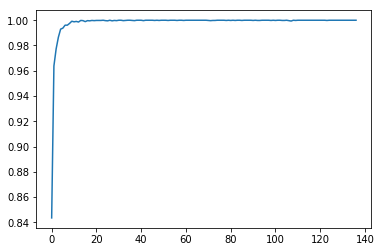

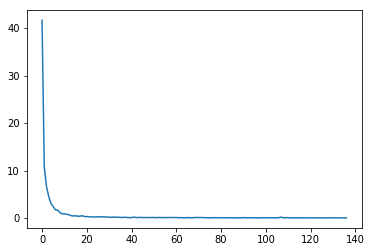

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

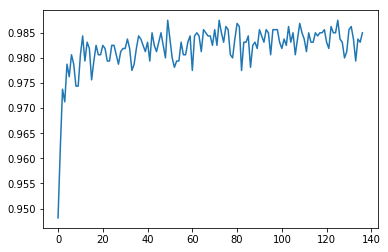

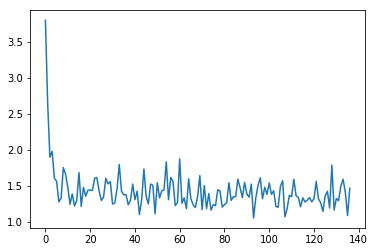


[137] accuracy: 0.985 loss: 1.464

Train
[138, 00020] loss: 0.005 acc: 1.000
[138, 00040] loss: 0.007 acc: 1.000
[138, 00060] loss: 0.011 acc: 1.000
[138, 00080] loss: 0.014 acc: 1.000
[138, 00100] loss: 0.021 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

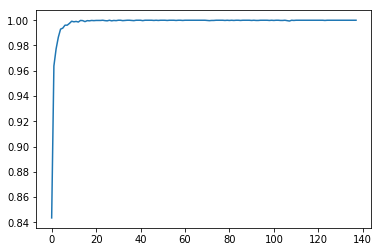

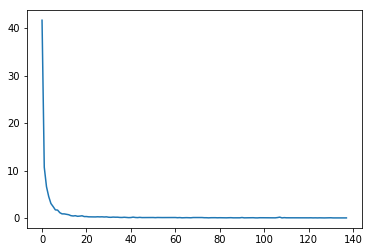

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

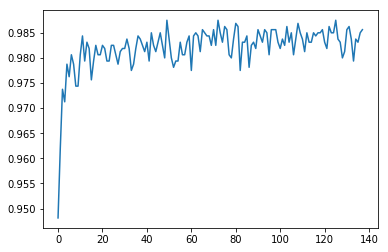

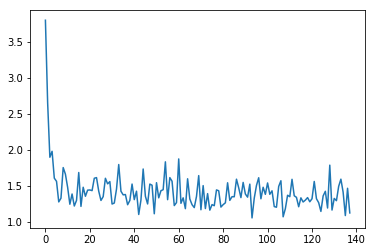


[138] accuracy: 0.986 loss: 1.122

Train
[139, 00020] loss: 0.003 acc: 1.000
[139, 00040] loss: 0.005 acc: 1.000
[139, 00060] loss: 0.008 acc: 1.000
[139, 00080] loss: 0.016 acc: 1.000
[139, 00100] loss: 0.019 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

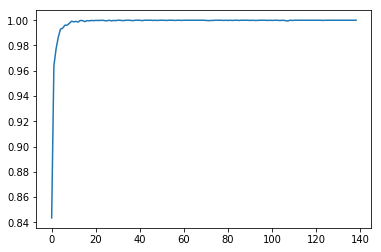

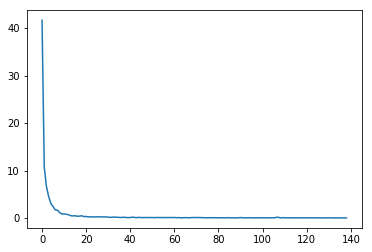

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

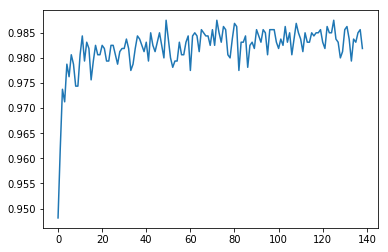

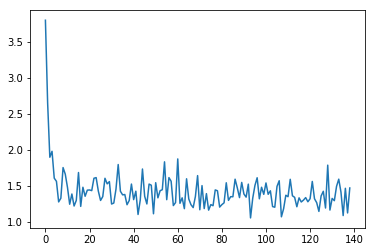


[139] accuracy: 0.982 loss: 1.468

Train
[140, 00020] loss: 0.004 acc: 1.000
[140, 00040] loss: 0.007 acc: 1.000
[140, 00060] loss: 0.010 acc: 1.000
[140, 00080] loss: 0.013 acc: 1.000
[140, 00100] loss: 0.016 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

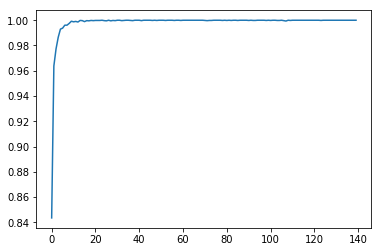

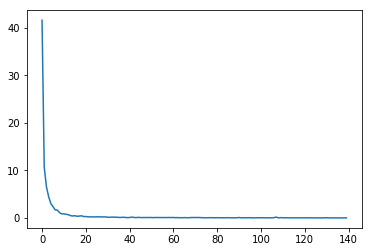

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

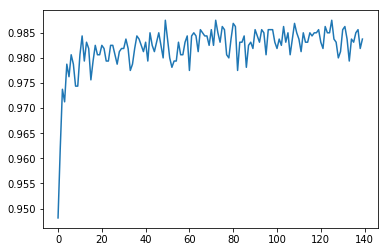

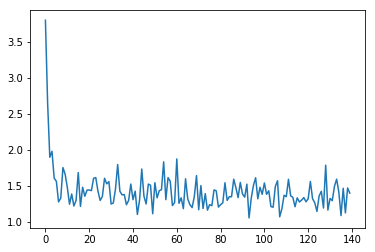


[140] accuracy: 0.984 loss: 1.397

Train
[141, 00020] loss: 0.006 acc: 1.000
[141, 00040] loss: 0.010 acc: 1.000
[141, 00060] loss: 0.012 acc: 1.000
[141, 00080] loss: 0.023 acc: 1.000
[141, 00100] loss: 0.029 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

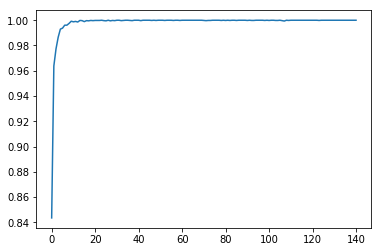

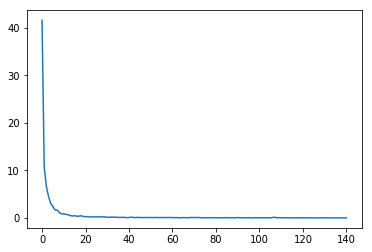

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

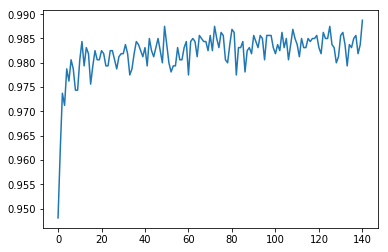

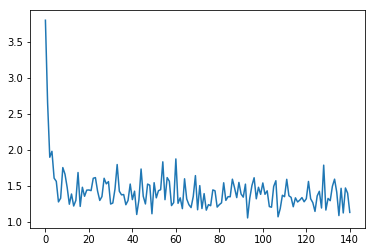


[141] accuracy: 0.989 loss: 1.129

Train
[142, 00020] loss: 0.002 acc: 1.000
[142, 00040] loss: 0.004 acc: 1.000
[142, 00060] loss: 0.006 acc: 1.000
[142, 00080] loss: 0.008 acc: 1.000
[142, 00100] loss: 0.012 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

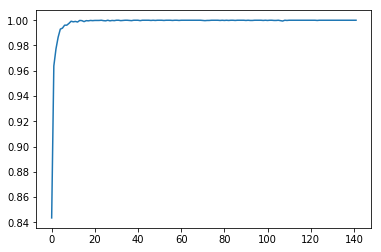

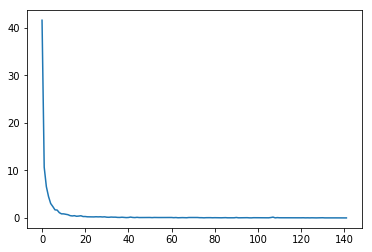

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

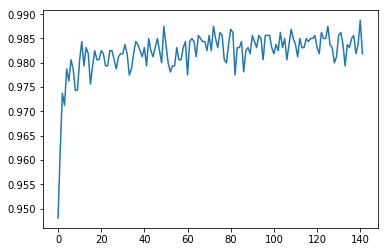

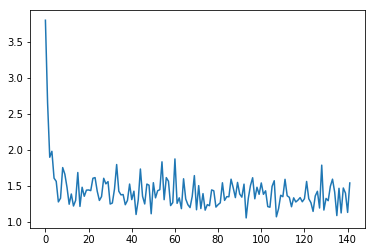


[142] accuracy: 0.982 loss: 1.538

Train
[143, 00020] loss: 0.005 acc: 1.000
[143, 00040] loss: 0.008 acc: 1.000
[143, 00060] loss: 0.011 acc: 1.000
[143, 00080] loss: 0.013 acc: 1.000
[143, 00100] loss: 0.015 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

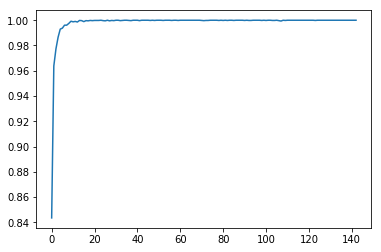

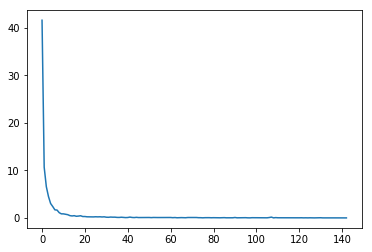

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

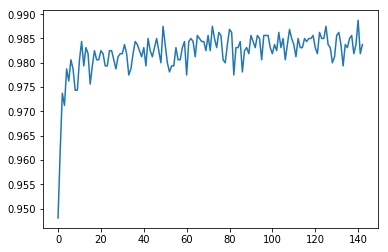

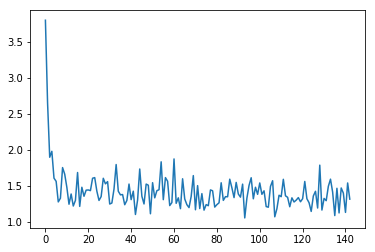


[143] accuracy: 0.984 loss: 1.313

Train
[144, 00020] loss: 0.003 acc: 1.000
[144, 00040] loss: 0.013 acc: 1.000
[144, 00060] loss: 0.015 acc: 1.000
[144, 00080] loss: 0.019 acc: 1.000
[144, 00100] loss: 0.039 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

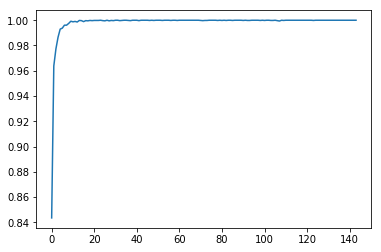

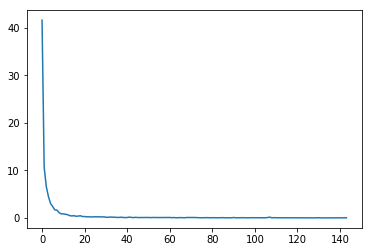

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

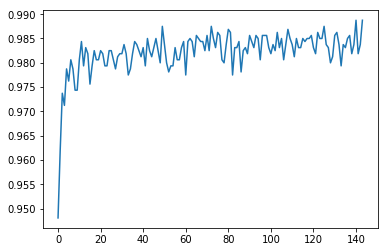

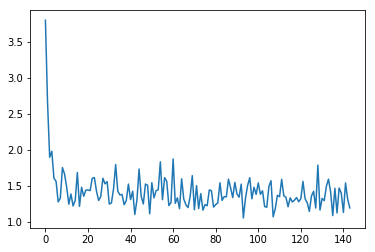


[144] accuracy: 0.989 loss: 1.191

Train
[145, 00020] loss: 0.004 acc: 1.000
[145, 00040] loss: 0.009 acc: 1.000
[145, 00060] loss: 0.010 acc: 1.000
[145, 00080] loss: 0.012 acc: 1.000
[145, 00100] loss: 0.018 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

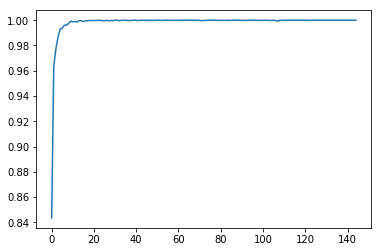

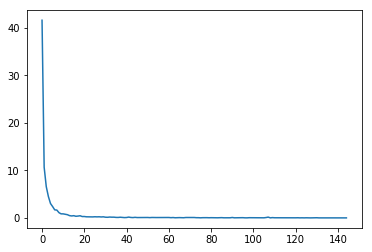

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

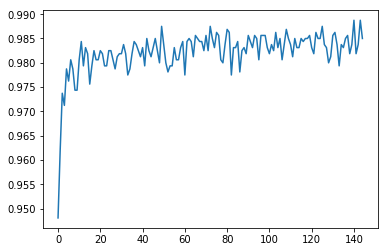

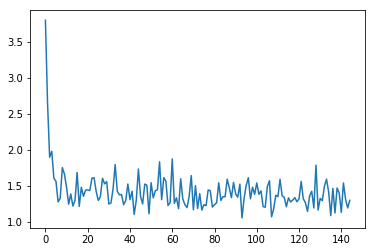


[145] accuracy: 0.985 loss: 1.297

Train
[146, 00020] loss: 0.018 acc: 0.999
[146, 00040] loss: 0.022 acc: 1.000
[146, 00060] loss: 0.026 acc: 1.000
[146, 00080] loss: 0.043 acc: 1.000
[146, 00100] loss: 0.046 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

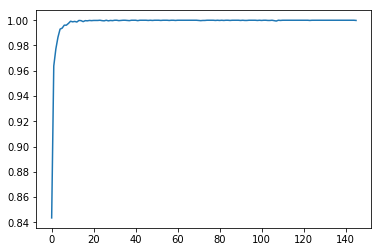

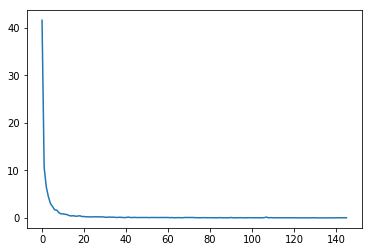

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

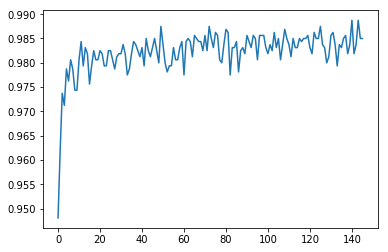

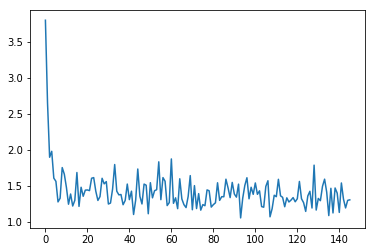


[146] accuracy: 0.985 loss: 1.304

Train
[147, 00020] loss: 0.005 acc: 1.000
[147, 00040] loss: 0.010 acc: 1.000
[147, 00060] loss: 0.016 acc: 1.000
[147, 00080] loss: 0.022 acc: 1.000
[147, 00100] loss: 0.033 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

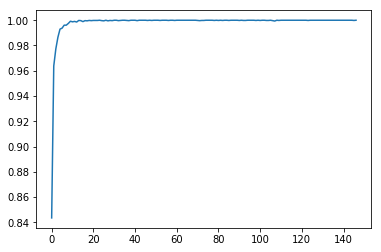

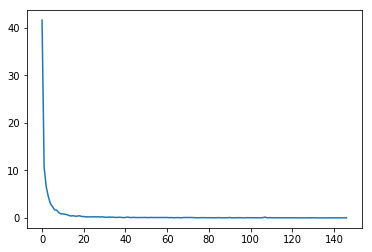

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

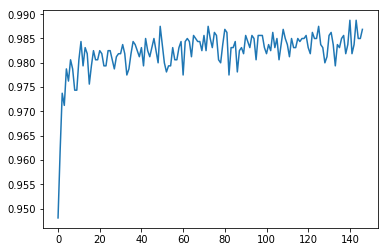

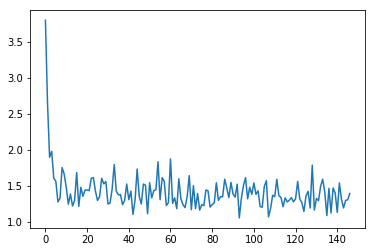


[147] accuracy: 0.987 loss: 1.392

Train
[148, 00020] loss: 0.002 acc: 1.000
[148, 00040] loss: 0.005 acc: 1.000
[148, 00060] loss: 0.018 acc: 1.000
[148, 00080] loss: 0.024 acc: 1.000
[148, 00100] loss: 0.026 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

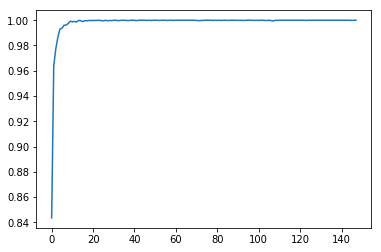

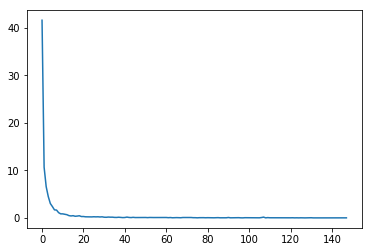

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

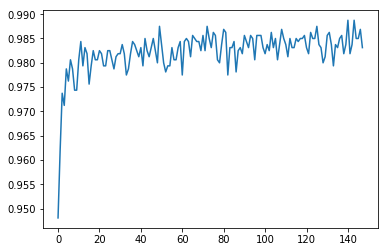

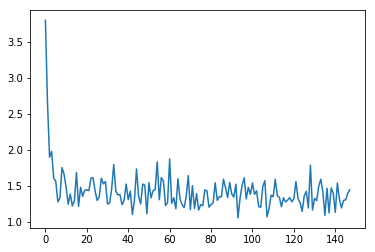


[148] accuracy: 0.983 loss: 1.444

Train
[149, 00020] loss: 0.004 acc: 1.000
[149, 00040] loss: 0.006 acc: 1.000
[149, 00060] loss: 0.011 acc: 1.000
[149, 00080] loss: 0.028 acc: 1.000
[149, 00100] loss: 0.035 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

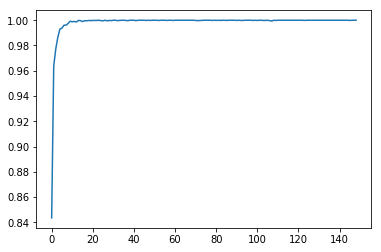

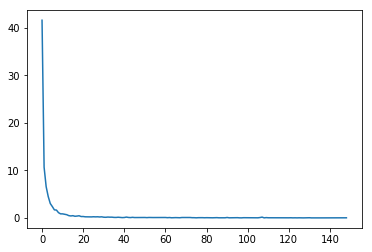

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

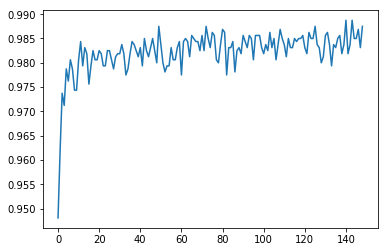

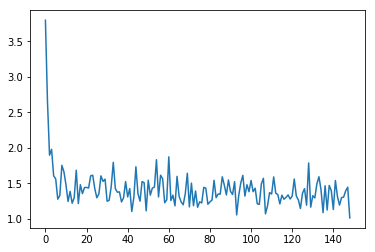


[149] accuracy: 0.988 loss: 1.011

Train
[150, 00020] loss: 0.004 acc: 1.000
[150, 00040] loss: 0.007 acc: 1.000
[150, 00060] loss: 0.011 acc: 1.000
[150, 00080] loss: 0.014 acc: 1.000
[150, 00100] loss: 0.018 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

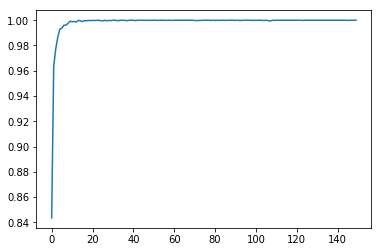

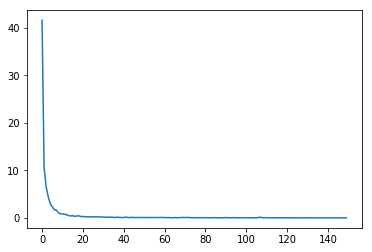

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

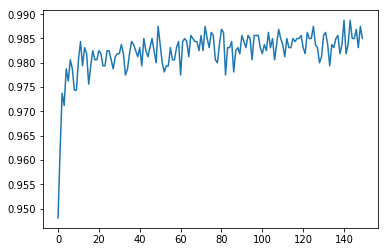

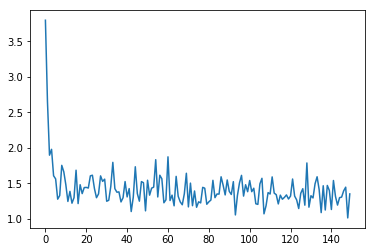


[150] accuracy: 0.985 loss: 1.349

Train
[151, 00020] loss: 0.002 acc: 1.000
[151, 00040] loss: 0.004 acc: 1.000
[151, 00060] loss: 0.007 acc: 1.000
[151, 00080] loss: 0.015 acc: 1.000
[151, 00100] loss: 0.021 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

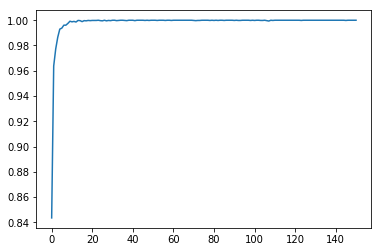

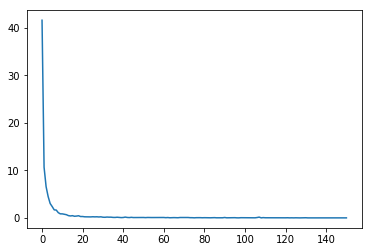

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

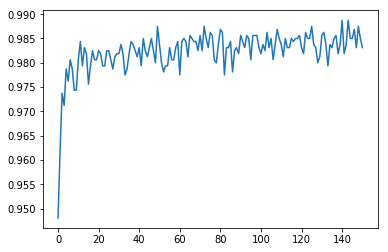

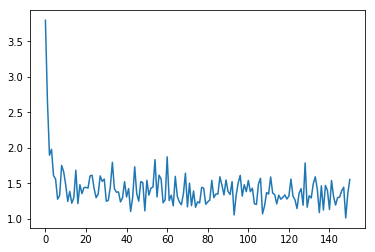


[151] accuracy: 0.983 loss: 1.552

Train
[152, 00020] loss: 0.002 acc: 1.000
[152, 00040] loss: 0.006 acc: 1.000
[152, 00060] loss: 0.008 acc: 1.000
[152, 00080] loss: 0.013 acc: 1.000
[152, 00100] loss: 0.028 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

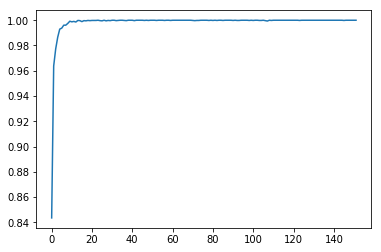

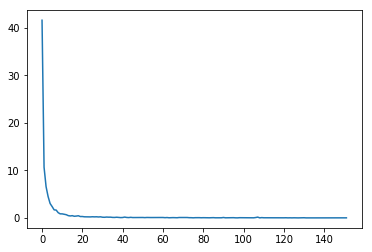

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

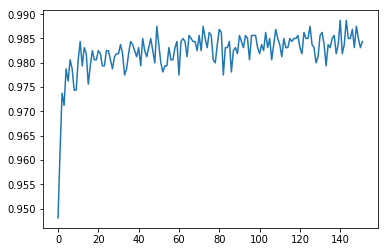

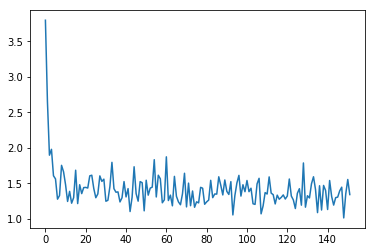


[152] accuracy: 0.984 loss: 1.340

Train
[153, 00020] loss: 0.004 acc: 1.000
[153, 00040] loss: 0.015 acc: 1.000
[153, 00060] loss: 0.018 acc: 1.000
[153, 00080] loss: 0.020 acc: 1.000
[153, 00100] loss: 0.021 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

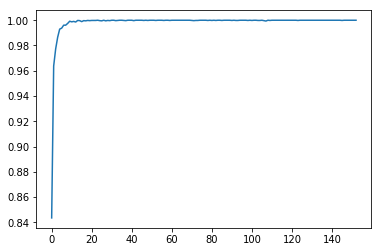

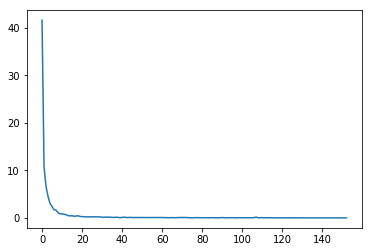

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

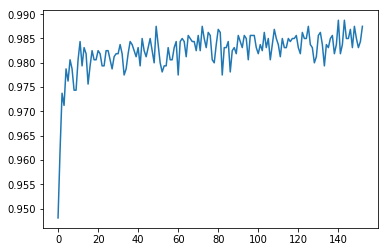

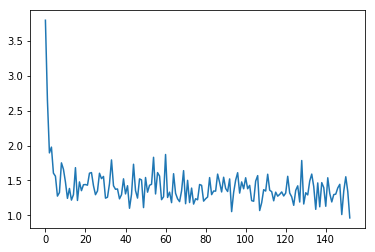


[153] accuracy: 0.988 loss: 0.962

Train
[154, 00020] loss: 0.006 acc: 1.000
[154, 00040] loss: 0.011 acc: 1.000
[154, 00060] loss: 0.013 acc: 1.000
[154, 00080] loss: 0.015 acc: 1.000
[154, 00100] loss: 0.018 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

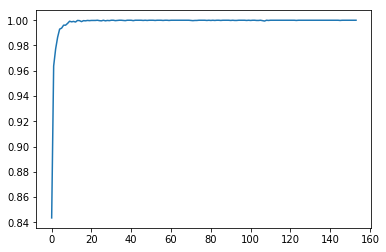

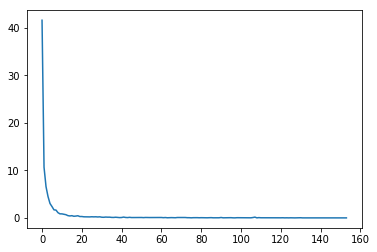

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

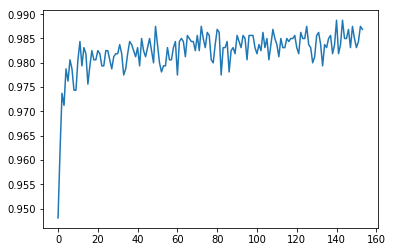

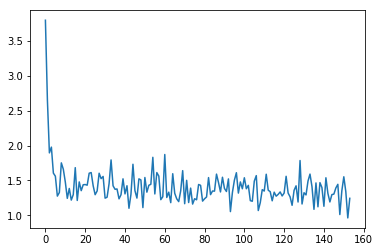


[154] accuracy: 0.987 loss: 1.243

Train
[155, 00020] loss: 0.002 acc: 1.000
[155, 00040] loss: 0.004 acc: 1.000
[155, 00060] loss: 0.007 acc: 1.000
[155, 00080] loss: 0.010 acc: 1.000
[155, 00100] loss: 0.013 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

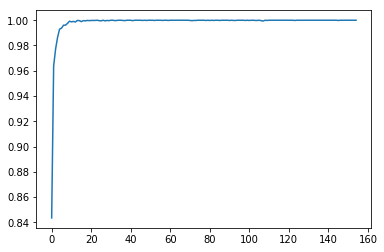

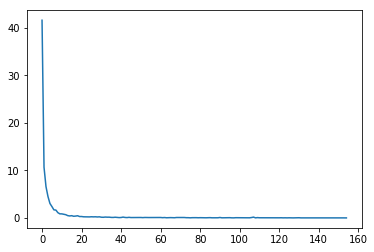

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

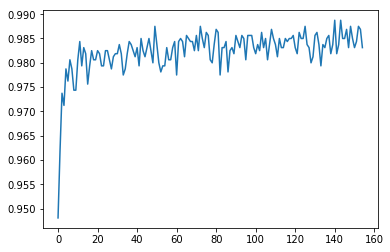

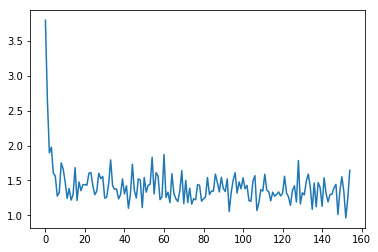


[155] accuracy: 0.983 loss: 1.645

Train
[156, 00020] loss: 0.004 acc: 1.000
[156, 00040] loss: 0.006 acc: 1.000
[156, 00060] loss: 0.009 acc: 1.000
[156, 00080] loss: 0.022 acc: 1.000
[156, 00100] loss: 0.023 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

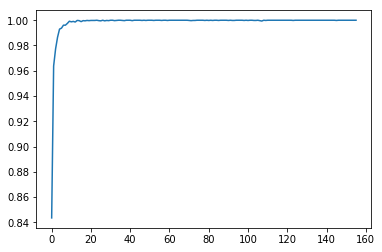

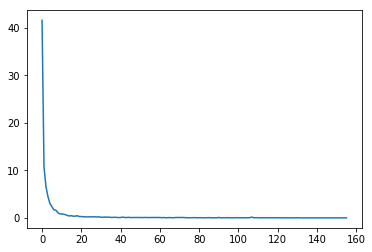

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

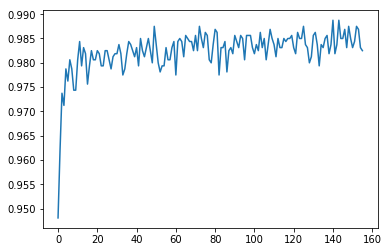

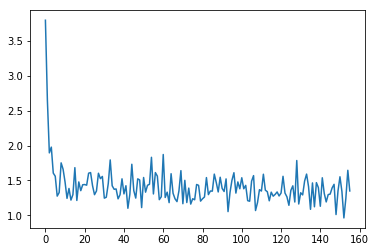


[156] accuracy: 0.983 loss: 1.349

Train
[157, 00020] loss: 0.004 acc: 1.000
[157, 00040] loss: 0.009 acc: 1.000
[157, 00060] loss: 0.014 acc: 1.000
[157, 00080] loss: 0.020 acc: 1.000
[157, 00100] loss: 0.024 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

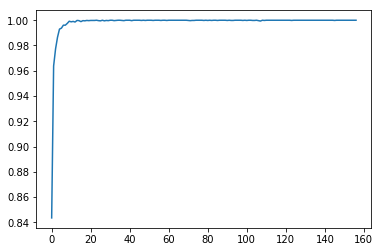

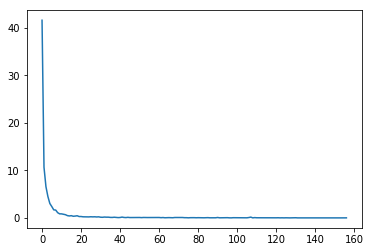

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

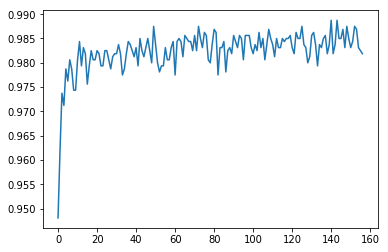

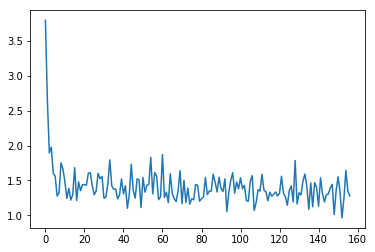


[157] accuracy: 0.982 loss: 1.278

Train
[158, 00020] loss: 0.004 acc: 1.000
[158, 00040] loss: 0.006 acc: 1.000
[158, 00060] loss: 0.014 acc: 1.000
[158, 00080] loss: 0.018 acc: 1.000
[158, 00100] loss: 0.021 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

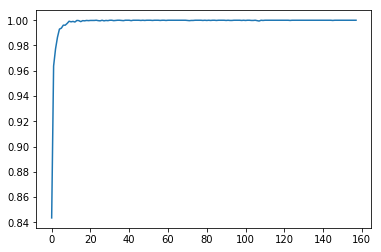

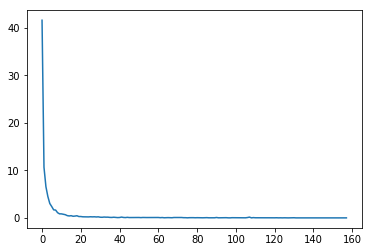

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

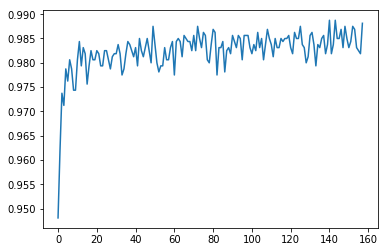

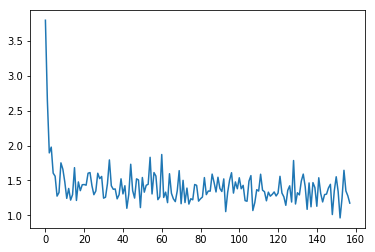


[158] accuracy: 0.988 loss: 1.174

Train
[159, 00020] loss: 0.005 acc: 1.000
[159, 00040] loss: 0.007 acc: 1.000
[159, 00060] loss: 0.011 acc: 1.000
[159, 00080] loss: 0.014 acc: 1.000
[159, 00100] loss: 0.017 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

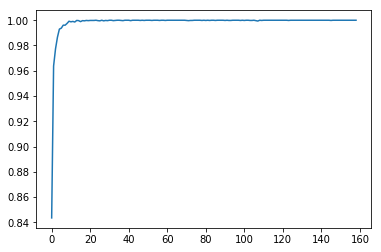

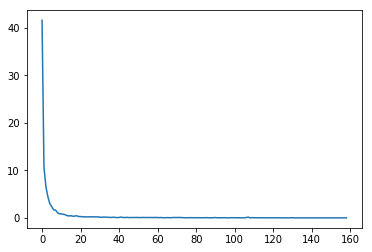

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

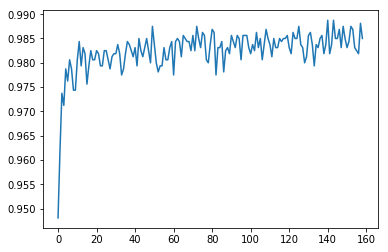

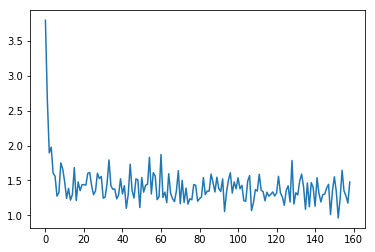


[159] accuracy: 0.985 loss: 1.476

Train
[160, 00020] loss: 0.002 acc: 1.000
[160, 00040] loss: 0.012 acc: 1.000
[160, 00060] loss: 0.027 acc: 1.000
[160, 00080] loss: 0.049 acc: 1.000
[160, 00100] loss: 0.054 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

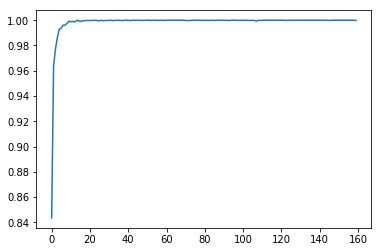

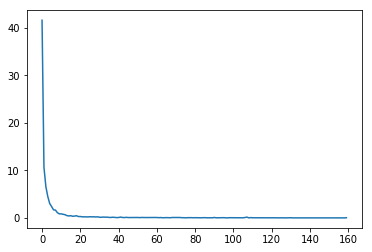

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

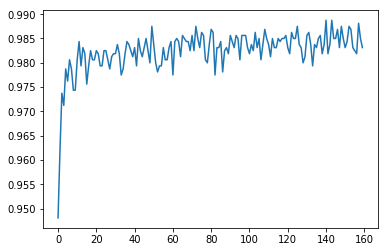

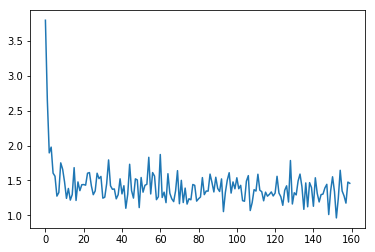


[160] accuracy: 0.983 loss: 1.459

Train
[161, 00020] loss: 0.006 acc: 1.000
[161, 00040] loss: 0.009 acc: 1.000
[161, 00060] loss: 0.011 acc: 1.000
[161, 00080] loss: 0.012 acc: 1.000
[161, 00100] loss: 0.014 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

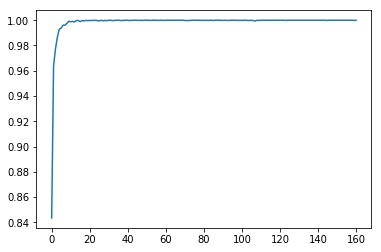

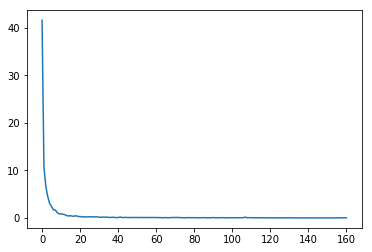

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

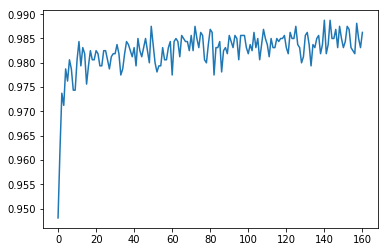

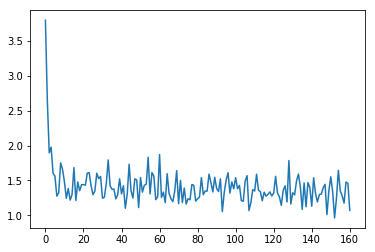


[161] accuracy: 0.986 loss: 1.070

Train
[162, 00020] loss: 0.002 acc: 1.000
[162, 00040] loss: 0.008 acc: 1.000
[162, 00060] loss: 0.014 acc: 1.000
[162, 00080] loss: 0.020 acc: 1.000
[162, 00100] loss: 0.022 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

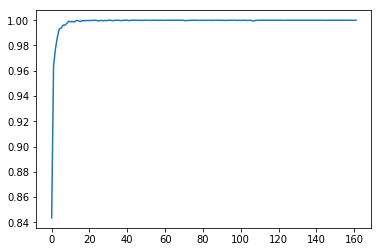

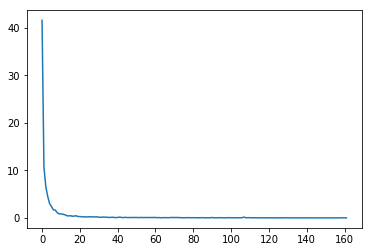

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

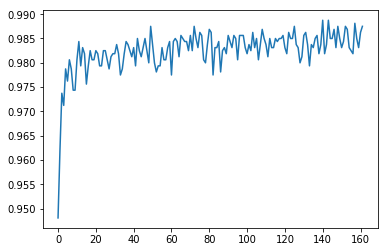

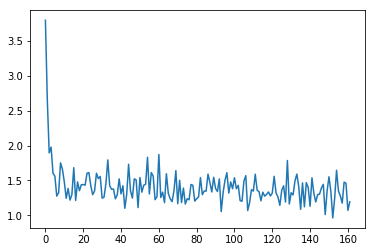


[162] accuracy: 0.988 loss: 1.193

Train
[163, 00020] loss: 0.008 acc: 1.000
[163, 00040] loss: 0.013 acc: 1.000
[163, 00060] loss: 0.016 acc: 1.000
[163, 00080] loss: 0.019 acc: 1.000
[163, 00100] loss: 0.024 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

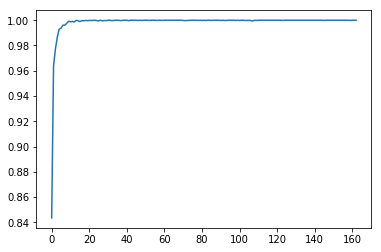

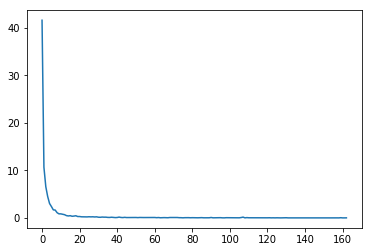

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

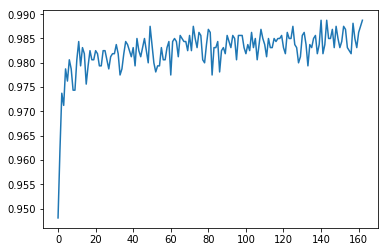

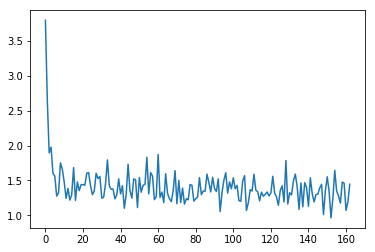


[163] accuracy: 0.989 loss: 1.445

Train
[164, 00020] loss: 0.002 acc: 1.000
[164, 00040] loss: 0.005 acc: 1.000
[164, 00060] loss: 0.008 acc: 1.000
[164, 00080] loss: 0.020 acc: 1.000
[164, 00100] loss: 0.023 acc: 1.000
[0.8434375, 0.96375, 0.97734375, 0.9865625, 0.99296875, 0.99375, 0.99609375, 0.99609375, 0.9975, 0.99921875, 0.99875, 0.9990625, 0.99859375, 0.99984375, 0.9996875, 0.99890625, 0.9996875, 0.99953125, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 0.99984375, 1.0, 0.9996875, 0.99953125, 1.0, 0.99953125, 0.99984375, 0.9996875, 1.0, 1.0, 0.9996875, 0.99984375, 1.0, 1.0, 0.99984375, 0.9996875, 1.0, 1.0, 1.0, 0.9996875, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.99984375, 0.9996875, 0.99984375, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 0.99984375, 1.0, 1.0, 0.99984375, 1.0, 1.0, 1.0, 1.0, 0.99984375, 1.0, 0.99984375, 0

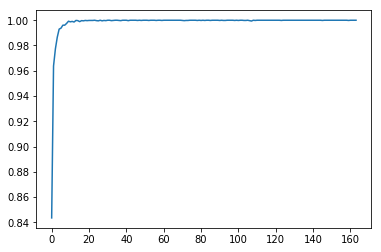

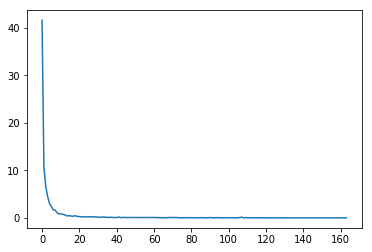

Validation
[0.948125, 0.961875, 0.97375, 0.97125, 0.97875, 0.97625, 0.980625, 0.97875, 0.974375, 0.974375, 0.980625, 0.984375, 0.979375, 0.983125, 0.981875, 0.975625, 0.979375, 0.9825, 0.980625, 0.980625, 0.9825, 0.981875, 0.979375, 0.979375, 0.9825, 0.9825, 0.980625, 0.97875, 0.98125, 0.981875, 0.981875, 0.98375, 0.981875, 0.9775, 0.97875, 0.981875, 0.984375, 0.98375, 0.9825, 0.98125, 0.983125, 0.979375, 0.985, 0.9825, 0.98125, 0.983125, 0.985, 0.9825, 0.98, 0.9875, 0.98375, 0.98, 0.978125, 0.979375, 0.979375, 0.983125, 0.980625, 0.980625, 0.983125, 0.984375, 0.9775, 0.984375, 0.985, 0.984375, 0.98125, 0.985625, 0.985, 0.984375, 0.984375, 0.9825, 0.985625, 0.9825, 0.9875, 0.985, 0.983125, 0.98625, 0.985625, 0.980625, 0.98, 0.98375, 0.986875, 0.98625, 0.9775, 0.983125, 0.983125, 0.984375, 0.978125, 0.9825, 0.983125, 0.981875, 0.985625, 0.984375, 0.983125, 0.985625, 0.985, 0.980625, 0.985625, 0.985625, 0.985625, 0.983125, 0.981875, 0.98375, 0.9825, 0.98625, 0.983125, 0.985, 0.980625, 0.

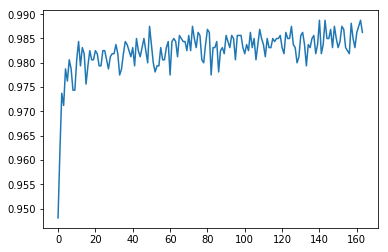

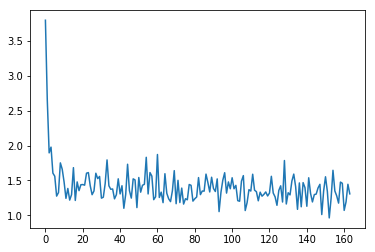


[164] accuracy: 0.986 loss: 1.307



In [15]:
train_acc = []
train_loss = []
val_acc = []
val_loss = []
for epoch in range(EPOCH):
    print("Train")
    total = 0
    correct = 0
    running_loss = 0.0
    for step, (labels, images,_) in enumerate(trainloader):
        optimizer.zero_grad()
#         print("in Train: ", images.shape, labels.shape)
#         images = images.detach()
#         labels = labels.detach()
        images = images.detach().cuda()
        labels = labels.detach().cuda()
        outputs = model(images)
#         print(len(outputs))
#         print(len(labels))
        # loss
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()
        
        # accuracy
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()
        acc = correct / total

        if step % 20 == 19:    # print every 2000 mini-batches
            print('[%d, %05d] loss: %.3f acc: %.3f' %
                  (epoch + 1, step + 1, running_loss, acc))

    train_acc.append(acc)
    train_loss.append(running_loss)
    print(train_acc)
    print(train_loss)
    plt.figure()
    plt.plot(range(0,epoch+1), train_acc)
    plt.savefig(model_directory + "train_acc_E%03d.jpg" % (epoch+1), dpi=500)
    plt.show()
    plt.figure()
    plt.plot(range(0,epoch+1), train_loss)
    plt.savefig(model_directory + "train_loss_E%03d.jpg" % (epoch+1), dpi=500)
    plt.show()
    
    # Evaluate validation set
    print("Validation")
    total = 0
    correct = 0
    running_loss = 0.0
    for step, (labels, images,_) in enumerate(valloader):
        optimizer.zero_grad()
        images = images.detach().cuda()
        labels = labels.detach().cuda()
#         images = images.detach()
#         labels = labels.detach()
        outputs = model(images)
        loss = criterion(outputs, labels)
        _, predicted = torch.max(outputs.data, 1)
        running_loss += loss.item()
        total += labels.size(0)
        correct += (predicted == labels).sum().item()
        acc = correct / total
    
    val_acc.append(acc)
    val_loss.append(running_loss)
    print(val_acc)
    print(val_loss)
    plt.figure()
    plt.plot(range(0,epoch+1), val_acc)
    plt.savefig(model_directory + "val_acc_E%03d.jpg" % (epoch+1), dpi=500)
    plt.show()
    plt.figure()
    plt.plot(range(0,epoch+1), val_loss)
    plt.savefig(model_directory + "val_loss_E%03d.jpg" % (epoch+1), dpi=500)
    plt.show()
    
    print('\n[%d] accuracy: %.3f loss: %.3f\n' % (epoch + 1, acc, running_loss))
    running_loss = 0.0
    # Saving model
    model_path = PJ(model_directory, "%03d_weights.pt" % (epoch+1))
    torch.save(model.state_dict(), model_path)

In [16]:
resultfile = open(model_directory+"train_results.txt", "a")
resultfile.write("train")
resultfile.write(str(train_acc))
resultfile.write("\n")
resultfile.write(str(train_loss))
resultfile.write("\n")
resultfile.write("validation")
resultfile.write("\n")
resultfile.write(str(val_acc))
resultfile.write("\n")
resultfile.write(str(val_loss))
resultfile.write("\n")
resultfile.close()

# TEST
### evaluate
### test every model
### saliency map

In [17]:
transform = transform_set(train=False)
testset = TermiteDataset(TestFile, transform)
testloader = Data.DataLoader(
    dataset=testset,      # torch TensorDataset format
    batch_size=BATCH_SIZE,      # mini batch size
    shuffle=True,               # 要不要打乱数据 (打乱比较好)
    num_workers=0,              # 多线程来读数据
)

1 1
0 0
1 1
3 3
1 1
3 3
3 3
1 3
1 1
1 1
0 0
3 3
2 2
0 0
2 2
0 0
3 0
2 2
3 3
0 0
2 2
2 2
1 3
2 2
0 0
2 2
2 2
2 2
0 0
1 1
3 0
0 0
3 3
2 2
0 0
1 1
1 1
3 3
0 0
1 3
0 0
2 2
2 2
1 1
2 2
1 1
0 0
3 3
3 1
3 3
0 0
3 3
2 2
0 0
3 3
3 3
3 3
1 3
3 3
1 1
3 0
1 1
0 0
0 0
2 2
1 1
2 2
3 3
1 1
1 1
1 1
2 2
2 2
1 1
3 3
3 3
0 0
2 2
2 2
3 3
3 3
2 2
0 0
1 1
1 0
0 0
3 0
3 3
0 0
2 2
2 2
1 1
1 1
3 3
3 3
3 0
1 3
3 0
3 3
3 3
3 3
3 3
1 1
1 1
2 2
1 1
3 3
2 2
3 3
2 2
2 2
0 0
2 2
0 0
3 3
0 0
1 1
1 0
1 1
0 0
1 1
0 0
2 2
3 0
2 2
3 1
2 2
2 2
1 1
3 3
3 3
3 3
1 1
3 0
0 0
3 3
3 3
2 2
0 0
3 2
0 0
2 2
3 3
2 2
3 1
0 0
3 3
2 2
3 1
2 2
2 2
3 3
1 1
0 0
3 1
3 3
3 0
1 1
1 1
0 0
1 3
0 0
1 1
0 0
2 2
0 0
2 2
2 2
3 0
3 3
2 2
3 3
3 3
3 3
1 1
3 3
1 1
1 3
3 3
2 2
2 2
0 0
0 0
2 2
0 1
0 0
0 0
3 3
1 1
0 0
3 0
0 0
2 2
2 2
3 0
0 0
0 0
2 2
0 1
0 0
1 1
3 3
1 1
3 3
3 0
3 3
1 1
2 2
0 0
0 0
3 3
2 2
2 2
1 3
1 1
2 2
3 3
1 1
3 0
2 2
2 2
0 0
1 1
2 2
2 2
1 1
3 3
1 1
0 0
0 0
2 2
2 2
3 3
0 0
2 2
1 1
0 0
0 0
2 2
1 1
3 3
0 0
1 1
1 3
2 2
1 3
3 3
2 2
2 2
1 1


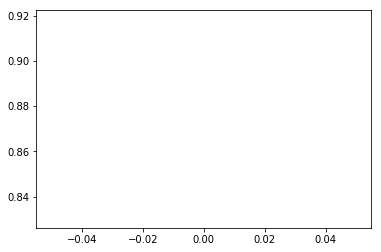

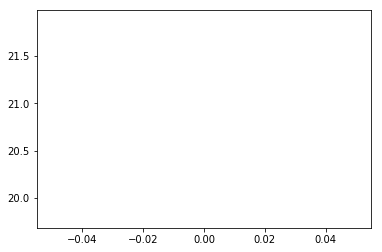

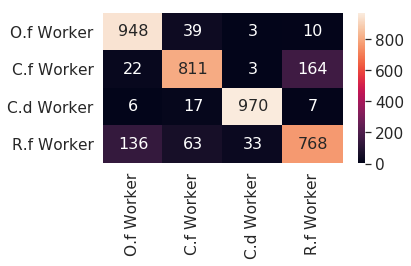

2 2
2 2
1 1
0 0
3 3
0 0
3 3
0 0
0 0
0 0
1 1
3 3
2 2
2 2
1 1
1 3
3 3
3 3
1 1
1 1
2 2
1 1
0 0
0 0
2 2
0 0
0 0
2 2
1 1
1 1
0 0
2 1
2 2
3 3
3 3
1 1
1 1
2 2
1 1
2 2
3 3
3 3
0 0
0 0
3 3
2 2
0 0
2 2
1 3
0 0
2 2
2 2
3 3
3 3
1 1
1 1
2 2
0 0
3 0
0 0
1 1
0 0
3 3
0 0
3 3
1 1
2 2
1 1
1 1
0 0
1 0
0 0
3 3
0 0
3 3
0 0
0 0
1 3
1 1
2 2
2 2
3 3
0 0
2 2
1 1
2 2
2 2
3 3
2 2
0 0
3 3
0 0
3 3
3 3
2 2
1 1
3 3
1 1
1 1
2 2
2 2
0 0
1 1
2 2
3 3
0 0
0 0
1 1
0 0
0 0
3 2
1 1
1 1
2 2
2 2
1 1
3 3
2 2
3 0
3 3
0 0
1 1
3 3
1 1
0 0
3 3
0 0
3 3
1 1
1 1
2 2
1 1
1 1
2 2
2 2
2 2
1 1
0 0
1 1
3 3
1 3
0 0
3 3
1 3
2 2
3 3
0 0
1 1
2 2
2 2
2 2
0 0
0 0
2 2
3 0
1 3
3 3
2 2
2 2
3 3
0 0
0 0
2 2
1 1
2 2
2 2
0 0
1 1
3 3
1 1
1 1
2 2
1 1
0 0
1 1
0 0
2 2
0 0
0 0
3 3
2 2
0 0
1 3
0 0
3 3
3 3
3 3
1 1
1 1
1 1
1 1
2 2
1 1
1 1
2 2
0 0
0 0
1 3
1 1
2 2
3 3
1 1
1 1
1 1
1 3
1 1
0 0
0 0
0 0
2 2
1 3
1 1
0 0
0 0
2 2
2 2
3 3
1 1
1 3
3 3
0 0
2 2
0 0
3 0
3 3
0 0
0 0
1 1
1 1
2 2
2 2
0 0
2 2
2 2
1 1
3 3
1 1
0 0
3 3
2 2
2 2
2 2
1 3
0 0
3 3
3 3
0 1
3 3
1 1
2 2


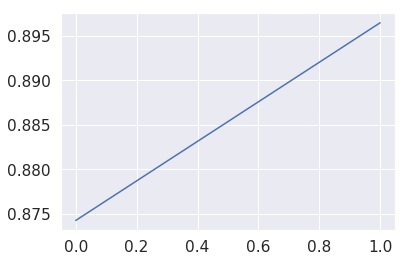

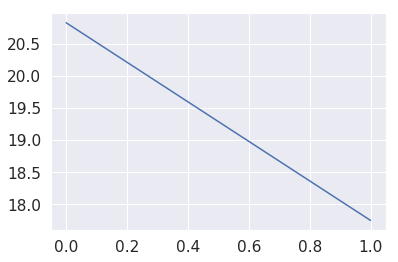

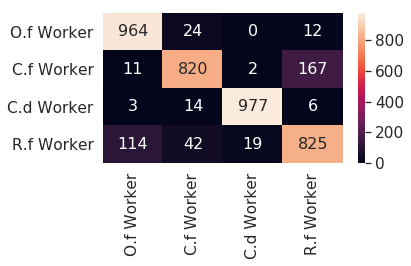

3 3
3 3
1 1
1 1
0 0
0 0
0 0
2 2
2 2
2 2
3 3
1 1
3 3
2 2
1 1
0 0
0 0
1 3
3 1
1 1
2 2
3 3
0 0
0 0
1 1
2 2
0 0
2 2
2 1
3 0
0 0
0 0
3 0
0 0
3 3
3 3
2 2
3 3
3 3
1 1
3 3
2 2
1 1
2 2
0 0
1 1
3 3
0 0
3 3
1 1
0 0
1 3
2 2
3 3
0 0
2 2
1 1
1 1
1 1
2 2
2 2
1 1
2 2
2 2
0 0
3 3
0 1
2 2
3 0
2 2
3 3
2 2
2 2
1 1
0 0
3 3
1 1
1 1
2 2
3 3
1 1
1 1
1 1
3 3
1 1
1 1
1 1
3 3
0 0
3 3
0 0
1 1
3 3
0 0
3 3
0 0
2 2
3 3
3 3
2 2
1 1
3 3
0 0
2 2
2 2
0 0
3 3
3 3
2 2
2 2
3 3
0 0
2 2
0 0
2 2
0 0
1 3
3 0
1 1
1 3
2 2
0 0
2 2
2 2
0 0
1 1
0 0
3 3
1 1
3 3
1 1
3 0
1 1
0 0
0 0
2 2
0 0
1 1
2 2
2 2
1 1
0 0
0 0
2 2
2 2
3 3
0 0
3 3
1 1
2 2
0 0
2 2
3 3
1 1
1 1
3 1
3 3
2 1
3 3
1 3
1 1
1 1
1 1
0 0
3 3
2 2
0 0
1 1
1 1
3 3
1 1
0 0
3 0
1 1
0 0
2 2
0 3
0 0
3 0
0 0
2 2
2 2
0 0
3 3
3 3
1 3
1 3
1 1
0 0
1 1
2 2
2 2
2 2
0 0
2 2
1 1
3 3
1 3
1 1
0 0
2 2
0 0
0 0
0 0
1 1
0 0
3 3
1 1
3 3
2 2
1 1
3 0
3 3
0 0
2 2
2 2
1 1
0 0
0 1
0 0
1 1
1 1
1 1
1 1
1 1
1 1
2 2
1 0
1 1
3 1
1 1
2 2
1 1
3 3
2 2
1 1
0 0
3 3
3 3
3 3
2 2
3 3
0 0
0 0
3 3
3 3
2 2
1 1
1 3
0 0


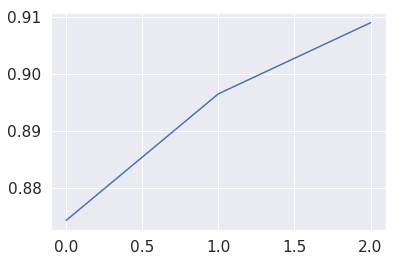

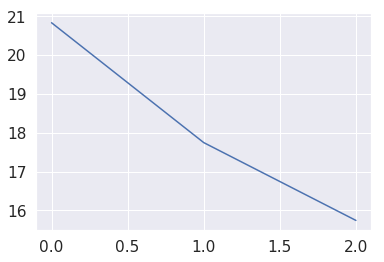

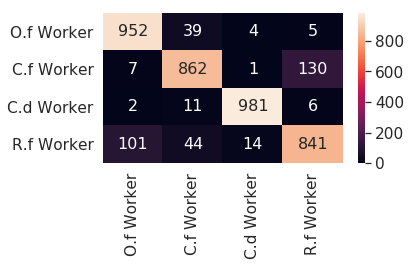

3 3
3 3
0 0
2 2
0 0
2 2
0 0
1 1
2 2
2 2
3 3
3 3
3 3
3 3
2 2
1 1
2 2
1 1
2 2
1 3
3 3
0 0
0 0
2 2
0 0
3 3
0 0
3 3
1 1
3 3
0 0
2 2
0 0
0 0
0 0
0 0
3 3
0 0
2 2
1 1
1 1
3 3
0 0
3 3
3 3
0 0
0 0
2 2
1 1
3 3
1 1
2 2
1 1
3 3
2 2
1 1
2 2
1 1
0 0
1 1
1 1
3 3
0 0
0 0
0 0
1 3
2 2
3 3
0 0
1 1
2 2
1 1
2 2
1 1
2 2
3 3
1 1
3 3
0 0
2 2
1 1
1 1
3 3
3 3
3 3
0 0
0 0
3 3
0 0
3 3
2 2
0 0
2 2
0 0
0 0
2 2
3 3
3 3
3 3
2 2
2 2
0 0
3 3
2 2
0 0
0 0
1 1
1 3
1 1
3 3
3 0
0 0
2 2
3 3
1 1
1 1
1 1
2 2
2 2
3 0
1 1
0 0
1 1
3 0
3 3
1 1
3 3
1 1
1 1
0 0
0 0
3 3
3 3
2 2
3 0
1 3
2 2
0 0
1 1
1 1
2 2
0 0
3 3
2 2
3 2
1 1
1 1
3 3
3 3
1 1
3 3
2 2
0 0
3 3
2 2
2 2
2 2
1 1
2 2
2 2
1 3
0 0
2 2
1 1
0 0
3 3
1 1
2 2
2 2
0 0
0 0
1 1
1 1
1 1
0 0
1 1
3 3
0 0
2 2
3 3
3 3
1 1
0 0
0 0
0 0
1 1
2 2
3 3
3 3
1 1
1 3
1 1
1 1
1 3
0 0
2 3
0 0
1 1
2 2
3 3
0 0
1 1
0 0
2 2
2 2
2 2
1 1
1 1
0 0
3 3
0 0
1 1
3 3
0 0
3 1
0 0
3 0
3 3
1 1
2 2
3 3
0 0
1 1
1 3
3 3
1 1
1 1
1 1
3 1
2 2
0 0
0 0
1 1
0 0
3 3
0 0
2 2
3 3
2 2
1 3
3 3
0 0
2 2
1 1
3 3
2 2
0 0
3 3
0 0
2 2


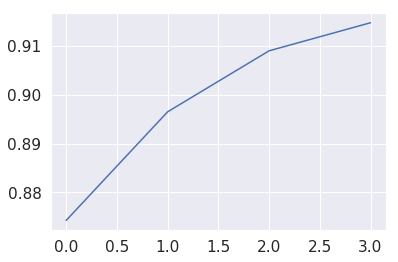

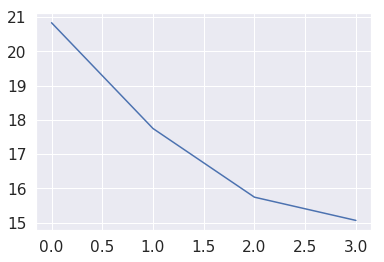

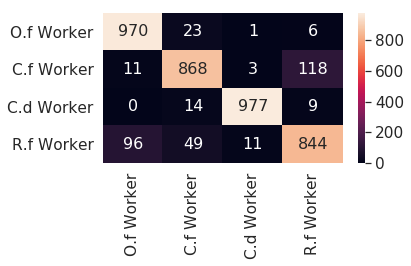

3 3
2 2
1 1
2 2
3 3
1 1
1 1
1 1
0 0
2 2
1 1
3 3
3 3
2 2
0 0
3 3
1 1
1 1
3 0
1 1
2 2
1 1
3 3
1 1
3 3
0 0
0 0
3 3
2 2
2 2
3 3
3 3
0 0
3 3
1 1
1 1
0 0
0 0
2 2
3 3
1 1
0 0
0 0
2 2
0 0
0 0
1 1
3 0
1 1
1 1
0 0
2 2
1 1
3 3
1 3
0 0
2 2
0 0
2 2
1 1
2 2
3 3
1 1
2 2
2 2
2 2
3 3
3 3
1 1
1 1
2 2
0 0
0 0
2 2
3 3
0 0
3 3
0 0
2 2
2 2
0 0
3 3
0 0
2 2
3 3
0 0
1 1
2 2
3 3
3 1
3 1
2 2
0 0
3 3
0 1
0 0
0 0
2 2
2 2
1 1
2 3
1 3
3 3
2 2
2 1
0 0
1 1
1 1
2 2
3 1
0 0
0 0
1 1
3 3
3 3
1 1
0 0
3 3
3 0
2 2
1 3
3 3
3 3
2 2
3 3
1 1
2 2
2 2
1 1
3 1
1 3
1 3
2 2
2 2
2 2
1 1
1 1
2 3
2 2
2 2
1 1
2 1
3 3
3 3
1 1
3 3
0 0
3 3
1 3
1 1
1 1
1 1
2 2
2 1
2 2
0 0
0 0
2 2
3 3
0 0
1 1
3 3
2 2
2 2
2 2
1 1
3 0
0 0
2 2
2 2
2 1
2 2
2 2
3 0
1 1
0 0
0 0
3 3
3 3
2 2
2 2
3 3
1 3
2 2
0 0
1 1
3 3
2 2
1 1
2 2
1 1
2 2
1 1
3 3
1 1
1 1
1 1
0 0
1 1
3 3
0 0
1 1
0 0
0 0
2 2
0 0
3 0
1 1
1 1
0 0
0 0
1 3
2 2
0 0
1 3
2 2
1 1
0 0
0 0
2 2
1 3
2 2
2 2
3 3
0 0
3 3
3 3
1 1
3 3
1 1
2 2
1 3
3 3
0 0
0 0
2 2
0 0
3 3
0 0
2 2
1 1
1 1
2 2
3 3
2 2
3 0
0 0
0 0
2 2
0 0


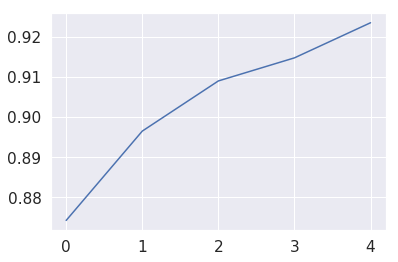

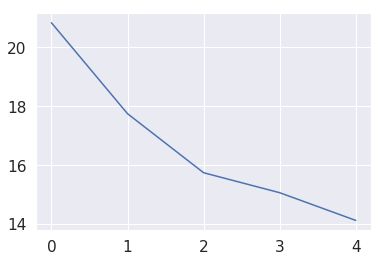

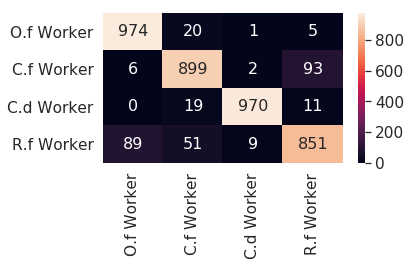

2 2
0 0
1 1
2 2
2 2
1 1
3 3
0 0
3 3
0 0
2 2
0 0
2 2
1 3
2 2
2 2
1 1
3 3
2 2
1 1
0 0
0 0
2 2
0 0
0 0
1 1
3 3
2 2
1 1
0 0
1 1
3 3
1 1
3 3
2 2
0 0
1 1
2 2
1 1
3 3
2 2
1 1
1 3
0 0
1 1
1 1
2 2
3 3
1 1
1 3
2 2
3 3
3 3
1 1
3 3
3 3
1 1
1 1
3 3
2 2
1 3
2 2
3 3
0 0
2 2
2 2
1 1
0 0
0 0
0 0
3 3
0 0
1 1
2 2
3 3
1 1
1 1
3 0
1 1
2 2
1 1
0 0
0 0
2 2
0 0
3 2
0 0
0 0
2 2
0 0
1 1
1 1
0 0
0 0
0 0
3 3
3 3
3 3
0 0
2 2
0 0
3 3
0 0
2 2
0 0
3 3
3 3
0 0
2 2
1 1
0 0
1 3
2 2
1 1
3 3
0 0
1 1
0 0
0 0
0 0
1 1
2 2
3 3
1 1
3 3
0 0
2 2
3 3
0 0
3 3
1 1
1 1
0 0
0 0
2 2
0 0
1 1
1 1
0 0
1 1
1 1
0 0
2 2
1 1
3 3
3 3
0 0
3 3
0 0
1 1
1 1
1 1
3 3
3 3
1 3
1 3
0 0
2 2
2 2
3 3
0 0
0 0
0 0
0 0
1 1
0 0
0 0
3 0
1 1
0 0
2 2
0 0
3 2
1 1
2 2
3 3
1 1
3 2
0 0
3 3
0 0
1 3
1 1
2 2
3 3
3 3
1 3
0 0
2 2
3 2
0 0
3 3
1 1
0 0
0 0
0 0
3 0
3 3
1 2
0 0
3 3
0 0
2 2
0 0
0 0
1 1
0 0
3 3
1 1
2 2
0 0
0 0
3 1
3 3
1 3
1 3
3 1
3 3
1 1
3 3
1 1
0 0
2 2
0 0
3 3
0 0
0 0
1 1
2 2
2 2
1 1
1 1
1 3
0 0
3 3
2 2
2 2
3 3
0 0
2 2
3 3
0 0
0 0
0 0
0 0
3 3
2 2
0 0
2 2
1 1


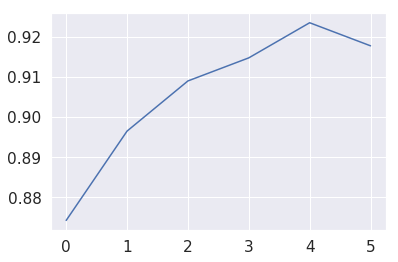

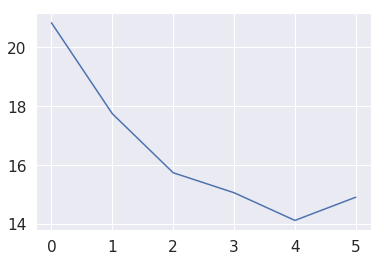

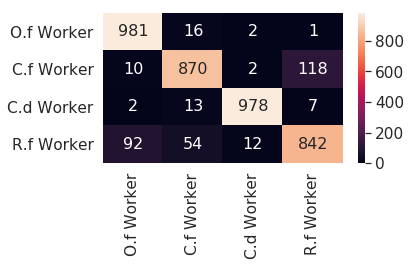

2 2
3 0
2 2
1 1
2 2
3 3
1 1
2 2
0 0
3 3
0 0
1 1
2 2
2 2
2 2
1 1
0 0
1 1
2 2
1 1
3 0
0 0
3 3
1 1
2 2
0 0
2 2
2 2
1 1
0 0
1 1
1 1
2 2
0 0
1 3
1 1
0 0
2 2
1 1
1 1
1 1
0 0
0 0
2 2
2 2
3 3
1 1
2 2
0 0
3 3
3 3
0 0
0 0
2 2
2 1
0 0
0 0
3 3
1 1
2 2
3 3
1 3
2 2
3 3
0 0
3 3
1 1
0 0
0 0
0 0
3 3
3 3
1 1
0 0
2 2
0 0
0 0
1 1
3 3
0 0
3 3
0 1
2 2
2 2
0 0
3 3
3 3
3 3
1 1
2 2
1 1
3 3
2 2
2 2
2 2
3 3
2 2
0 0
2 2
1 1
3 1
0 0
0 0
2 2
2 2
0 0
0 0
3 0
1 1
1 1
0 0
2 2
1 1
3 3
1 1
2 2
3 3
0 0
3 3
0 0
0 0
2 2
3 3
3 3
1 1
0 0
1 1
1 1
3 0
1 1
0 0
2 2
0 0
1 1
3 3
1 3
2 2
2 2
0 0
2 2
1 1
3 3
3 3
0 0
0 0
3 3
3 3
0 0
2 2
0 0
3 3
1 1
2 2
1 1
2 2
2 2
2 2
3 3
3 3
2 2
3 3
0 0
2 2
2 2
0 0
2 2
2 2
2 2
1 1
0 0
2 2
2 2
2 2
0 0
2 2
2 2
1 1
1 1
3 3
1 1
3 3
0 0
1 1
3 3
0 0
2 2
2 2
2 2
1 1
3 3
1 1
0 0
0 0
0 0
2 2
1 1
0 0
0 0
1 1
2 2
2 2
3 0
0 0
0 0
3 3
3 3
3 3
3 3
3 3
1 3
1 1
0 0
1 1
3 3
0 0
1 1
3 3
2 2
1 1
1 1
0 0
2 2
3 0
1 1
3 3
2 2
2 2
3 3
1 1
2 2
1 1
2 2
3 3
3 3
1 1
3 3
1 1
0 0
0 0
1 1
1 3
3 0
1 1
1 1
3 3
1 1
0 0
3 3
0 0
2 2


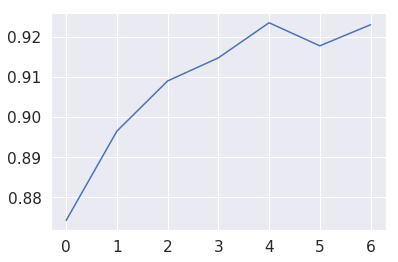

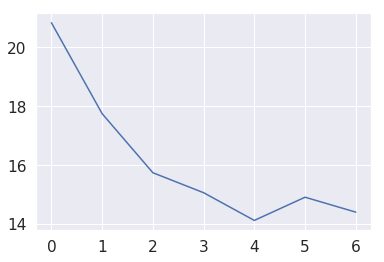

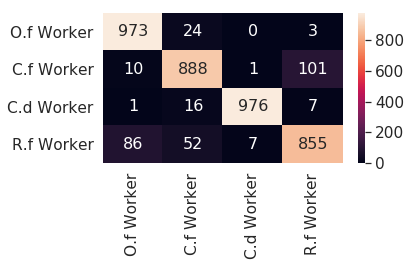

1 3
1 1
2 2
3 1
1 1
3 3
1 1
3 3
1 3
2 2
2 2
0 0
0 0
1 1
3 3
2 2
0 0
1 1
0 0
2 2
2 2
2 2
2 2
1 1
3 3
2 2
2 2
1 1
0 1
3 3
0 0
1 1
3 3
2 2
1 1
0 0
3 3
3 3
1 1
2 2
3 3
2 2
1 1
0 0
2 2
3 3
0 0
3 3
0 0
0 0
0 0
0 0
1 1
2 2
0 0
3 3
0 0
0 0
1 1
0 0
0 0
1 1
0 0
3 3
0 0
3 3
2 2
2 2
0 1
0 0
2 2
2 2
1 1
0 0
1 1
1 1
3 3
3 3
1 1
3 3
3 3
0 0
3 3
1 1
2 2
0 0
0 0
0 0
3 3
3 3
0 0
0 0
1 3
0 1
0 0
3 3
1 1
0 0
3 3
0 0
2 2
0 0
2 2
0 0
3 3
3 3
0 0
0 0
0 0
3 3
0 0
0 0
3 3
1 1
1 1
0 0
2 2
2 2
3 3
1 1
2 2
0 0
0 1
3 3
0 0
2 2
3 3
3 3
1 1
2 2
0 0
0 0
3 3
0 0
3 3
3 3
1 1
0 0
3 3
0 0
0 0
1 1
3 3
3 3
2 2
2 2
1 1
1 1
0 0
3 0
3 3
0 0
1 1
3 3
1 3
3 3
1 1
1 1
0 0
0 0
2 2
0 0
1 1
2 2
0 0
0 0
3 3
1 1
2 2
0 0
3 2
0 0
0 0
2 2
0 0
0 0
1 3
3 1
0 0
3 3
3 1
1 1
0 0
3 1
2 2
0 0
1 3
0 2
0 0
3 3
1 1
0 0
1 1
0 0
1 1
1 1
2 2
2 2
0 0
0 0
1 1
0 0
1 1
3 3
3 3
3 3
3 0
2 2
0 0
0 0
3 3
2 2
0 0
0 0
0 0
3 3
3 3
1 1
1 1
3 3
0 0
3 1
3 3
0 0
0 0
3 3
0 0
3 3
2 2
1 1
2 2
2 2
2 2
1 1
1 1
0 0
2 2
3 3
0 0
0 0
0 0
3 3
3 3
2 2
1 1
2 2
1 1
2 2
0 0
3 3


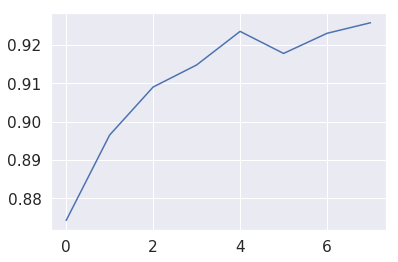

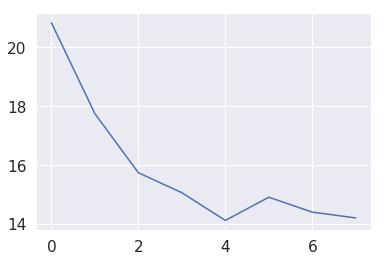

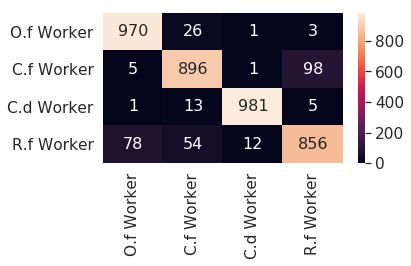

3 3
1 1
0 0
2 2
3 3
2 2
1 1
0 0
3 3
2 2
2 2
2 2
0 0
1 1
2 2
0 0
0 0
0 0
1 1
3 3
2 2
2 2
3 3
2 3
2 2
2 2
1 1
3 3
3 3
2 2
3 1
3 3
0 0
1 1
2 2
0 0
1 1
1 3
2 2
0 0
2 2
0 0
2 2
2 2
1 1
1 1
0 0
3 1
3 3
0 0
0 0
3 3
3 1
1 1
2 2
1 1
2 2
3 3
2 2
1 1
0 0
2 2
3 3
3 3
1 1
0 0
0 0
0 0
3 3
3 3
3 3
3 3
3 3
3 3
0 0
1 1
2 2
2 2
3 3
3 3
2 2
0 0
1 1
3 3
0 0
2 2
3 3
3 1
1 3
1 1
1 1
2 2
1 1
1 1
1 1
1 1
1 1
2 2
1 1
0 0
3 3
2 2
1 1
3 3
0 0
2 2
2 2
1 1
1 1
3 3
2 2
3 3
2 1
0 0
1 1
2 2
3 3
0 0
3 3
2 2
3 3
3 3
0 0
2 2
0 0
0 0
0 0
2 2
0 0
0 0
1 1
2 2
2 2
1 1
0 0
0 0
1 1
1 1
2 2
1 1
0 0
3 1
2 2
3 3
2 1
0 0
1 1
3 1
0 0
3 3
1 1
2 2
1 1
3 3
1 1
2 0
2 2
1 3
2 2
2 2
2 2
2 2
2 2
2 2
3 3
1 1
2 2
2 2
0 0
3 3
3 3
2 2
2 2
1 1
3 3
3 3
3 3
0 0
1 1
3 0
2 2
0 0
1 1
3 3
2 2
0 0
2 2
0 0
2 2
1 1
3 3
0 0
1 1
1 3
0 0
1 1
1 1
2 2
0 0
3 3
0 0
3 3
3 3
2 2
0 0
3 3
1 3
0 0
3 3
3 3
1 1
2 2
1 1
3 3
1 1
1 1
1 1
3 3
1 1
2 2
1 1
0 0
2 2
1 1
0 0
1 0
0 0
2 2
1 1
2 2
1 3
1 1
2 2
1 1
1 1
3 3
1 1
0 0
0 0
1 1
3 3
3 0
1 1
1 3
2 2
2 2
2 2
0 0
1 1
1 1


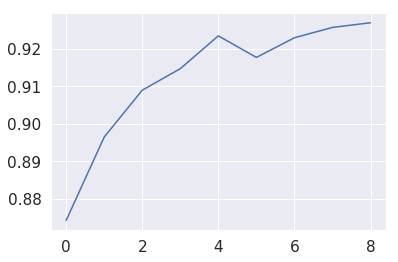

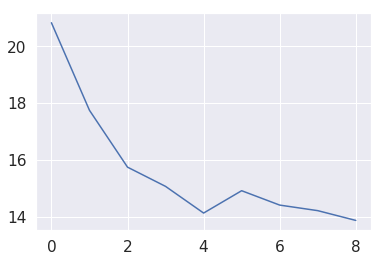

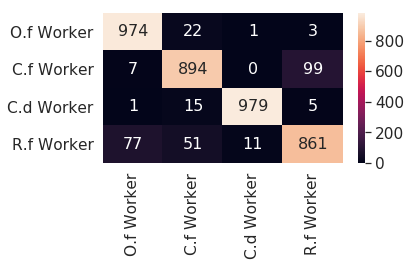

1 1
1 1
2 2
0 0
2 2
2 2
1 1
3 3
0 0
1 1
2 2
2 2
0 0
2 2
1 1
0 0
3 3
0 0
0 0
2 2
3 3
3 3
0 0
3 3
3 0
1 1
1 1
1 1
2 2
0 0
2 2
0 0
3 3
3 3
3 3
0 0
2 2
0 0
2 2
3 3
1 1
1 1
2 2
2 2
2 2
2 2
0 0
0 0
3 3
0 0
2 2
3 3
2 2
3 3
3 3
0 0
0 0
0 0
2 2
0 0
1 1
1 3
0 0
3 3
2 2
0 0
1 1
0 0
0 0
3 3
2 2
0 0
0 0
1 1
1 1
3 1
1 1
1 1
3 3
0 0
0 0
2 2
3 0
1 1
1 1
2 2
0 0
3 3
0 0
2 2
0 0
0 0
2 2
2 2
2 2
2 2
3 3
3 3
0 0
0 0
1 3
2 2
2 2
1 1
0 0
2 2
2 2
3 3
1 1
3 3
0 0
0 0
2 2
2 2
3 3
0 0
1 1
0 0
0 0
3 3
1 1
0 0
0 0
1 1
0 0
1 1
0 0
1 1
1 1
0 0
3 3
0 0
2 2
0 0
1 1
0 0
0 0
0 0
0 0
1 1
0 0
0 0
1 1
1 1
2 2
0 0
2 2
1 1
2 2
0 0
0 0
2 2
3 3
0 0
2 2
1 1
1 3
2 2
1 1
2 2
0 0
0 0
1 1
0 0
2 2
3 3
3 3
0 0
2 2
0 0
1 1
1 1
3 3
3 3
0 0
0 0
0 0
0 0
3 3
1 1
3 3
2 2
3 3
0 0
3 3
2 2
1 1
3 2
0 0
2 2
0 0
0 0
1 3
3 3
3 2
1 1
0 0
1 1
3 3
1 1
0 0
0 0
2 2
3 3
3 3
0 0
1 1
0 0
0 0
2 2
0 0
2 2
0 0
2 2
2 2
2 2
3 3
2 2
2 2
3 3
3 3
0 0
3 3
1 1
1 1
1 1
3 0
3 2
3 3
0 0
0 0
3 3
1 1
2 2
1 1
1 1
0 0
2 2
1 1
1 1
2 2
1 1
3 1
0 0
3 3
3 3
3 3
0 0
3 3
3 3


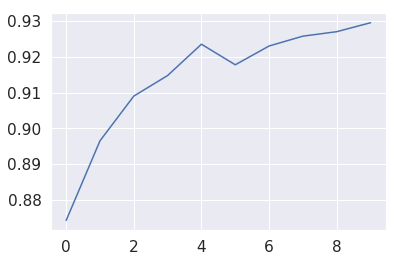

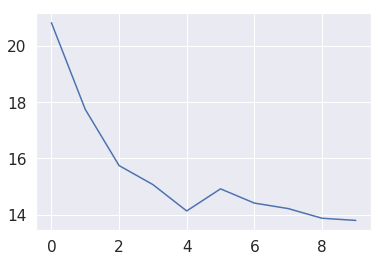

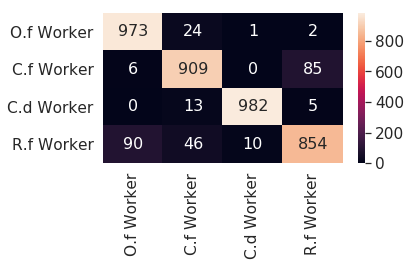

3 0
3 3
0 0
3 3
3 3
3 3
0 0
0 0
2 2
0 0
1 1
2 2
1 1
0 0
0 0
1 1
2 2
0 0
2 2
3 3
3 1
1 1
2 2
1 1
3 3
0 0
3 3
0 0
1 1
0 0
2 2
3 1
3 3
2 2
3 3
0 0
1 1
2 2
3 3
1 1
0 0
3 0
3 3
1 1
1 1
3 3
0 0
2 2
1 1
0 0
1 1
2 2
3 3
3 3
0 0
2 2
3 3
2 2
3 3
2 2
2 2
3 3
2 2
3 3
1 3
0 0
0 0
3 3
2 2
0 0
1 1
2 2
1 1
1 1
0 0
2 2
2 2
3 3
1 1
1 1
2 2
3 3
0 0
3 3
2 2
0 0
1 1
3 3
1 1
0 0
2 2
0 0
0 0
2 2
1 1
0 0
3 3
3 3
1 1
3 2
0 0
3 0
0 0
1 1
2 2
2 2
3 3
1 3
0 0
1 1
2 2
0 1
0 0
0 0
2 2
1 3
3 3
1 1
2 2
0 0
2 2
0 0
3 3
1 1
3 3
0 0
3 3
2 2
2 2
2 2
0 0
0 0
2 2
2 2
2 2
1 1
0 0
3 3
1 1
1 1
3 3
1 1
3 0
1 1
2 2
0 0
1 1
3 3
3 0
3 0
3 3
2 2
3 3
3 3
3 3
3 3
0 0
1 1
2 2
3 3
1 1
3 3
1 1
2 2
3 3
1 1
1 3
3 3
1 3
1 1
3 3
3 2
1 3
1 1
2 2
1 1
1 1
0 0
1 1
2 2
1 1
0 0
1 1
0 0
1 3
0 0
3 3
3 3
0 0
2 2
0 0
0 0
2 2
3 3
0 0
3 3
2 2
3 3
3 3
1 1
0 0
3 3
3 3
3 3
3 3
1 1
0 0
3 3
3 3
0 0
3 0
0 0
2 2
2 2
2 2
2 2
2 2
1 1
1 1
2 2
0 0
3 0
3 3
2 2
1 1
0 0
2 2
2 2
2 2
2 2
1 1
0 0
1 1
0 0
3 3
2 2
3 3
3 3
3 1
1 1
3 3
3 3
1 1
0 0
2 2
2 2
0 0
0 0
1 1
0 0


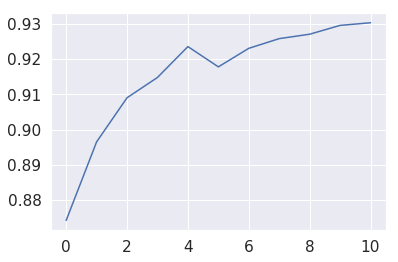

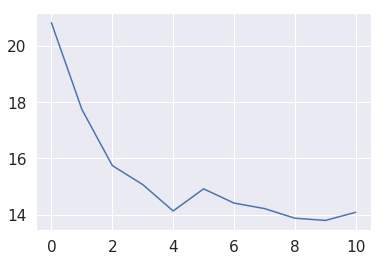

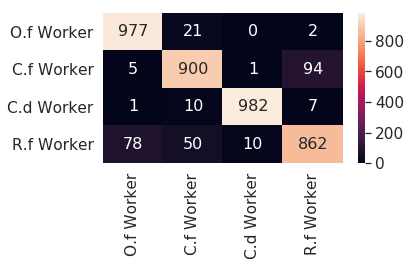

2 2
2 2
2 2
0 0
2 2
0 0
0 0
0 0
1 1
3 0
0 0
0 1
1 1
0 0
3 3
1 1
2 2
3 3
3 0
1 1
3 3
2 2
2 2
3 3
2 2
3 1
3 3
0 0
0 0
3 3
2 2
1 1
3 3
0 0
2 2
3 3
0 0
0 1
0 0
0 0
3 3
0 0
3 3
3 3
3 3
2 2
3 3
1 1
0 0
0 0
0 0
1 1
0 0
0 0
3 3
0 0
1 3
2 2
1 1
3 3
0 2
1 1
3 3
3 3
3 0
0 0
1 1
2 2
2 2
0 0
1 1
2 2
1 1
2 2
1 1
1 1
3 3
0 0
3 3
1 1
2 2
2 2
2 2
2 2
0 0
1 1
3 3
1 1
3 3
0 0
2 2
3 3
3 3
0 0
3 3
2 2
2 2
1 1
3 3
0 0
0 0
0 0
0 0
2 2
0 0
3 3
2 2
2 2
3 3
1 1
3 3
3 3
0 0
3 3
0 0
0 0
1 1
2 2
1 1
0 0
2 2
1 1
3 3
1 1
1 1
3 3
1 1
3 3
0 0
1 1
3 3
2 2
2 2
0 0
0 0
2 2
1 1
3 3
1 1
1 3
0 0
0 0
3 3
1 1
1 1
2 2
1 3
2 2
3 3
1 3
3 3
0 0
0 0
3 3
3 3
0 0
1 1
0 0
0 1
2 2
0 0
2 2
0 0
3 3
1 1
2 2
0 0
2 2
0 0
3 3
0 0
2 2
1 3
0 0
2 2
2 2
1 1
3 3
0 0
2 2
2 2
0 0
0 0
0 0
0 0
1 1
3 3
1 1
2 2
2 2
1 1
1 3
0 0
3 3
3 3
3 3
3 0
3 1
2 2
2 2
2 2
1 1
0 0
1 1
2 2
0 0
1 1
1 1
0 0
0 0
0 0
2 2
3 3
3 3
1 1
3 3
2 2
2 2
2 2
2 2
3 3
2 2
2 2
3 3
2 2
2 2
0 0
3 3
0 0
3 3
1 1
0 0
1 3
2 2
0 1
0 0
1 1
3 3
3 3
1 1
3 3
0 0
0 0
0 0
0 1
1 1
0 1
2 2
0 0
0 0


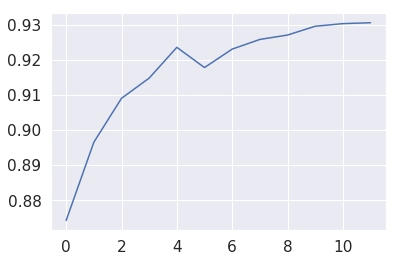

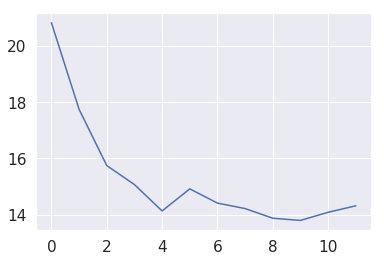

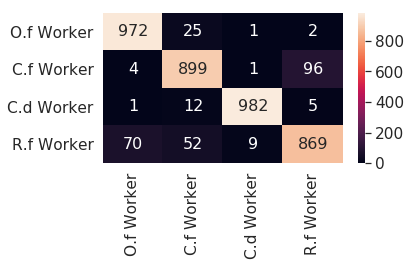

0 0
0 0
2 2
3 1
1 1
1 1
3 3
3 3
0 0
0 0
1 1
0 0
3 3
2 2
1 1
2 2
0 0
0 0
2 2
1 1
1 1
3 3
1 3
3 3
3 3
2 2
1 1
1 1
0 0
0 0
3 3
2 2
3 3
2 2
2 2
0 0
2 2
1 3
0 0
0 0
3 3
0 0
1 1
0 0
0 0
2 2
3 3
2 2
3 0
1 1
0 0
1 1
3 3
0 0
3 3
0 0
0 0
2 2
3 3
3 3
0 0
2 2
0 0
3 3
2 2
0 0
1 1
1 1
0 0
1 1
2 2
0 0
2 2
0 0
0 0
2 2
3 3
1 1
2 2
1 1
1 1
0 0
2 2
2 2
1 1
3 3
0 0
2 2
2 2
3 3
0 0
2 2
3 3
1 1
2 2
0 0
3 3
0 0
0 0
1 1
1 1
1 1
3 3
1 1
3 1
3 3
1 1
2 2
3 3
3 3
3 3
2 2
1 1
1 1
2 2
1 3
1 1
2 2
1 1
3 3
2 2
2 2
2 2
3 3
0 0
1 1
0 0
1 1
0 0
1 1
0 0
3 3
2 2
1 1
0 0
1 1
1 1
1 0
1 1
2 2
1 1
3 0
2 2
0 0
3 3
1 1
1 1
1 1
1 1
3 3
2 2
3 3
2 2
1 1
3 3
3 3
0 0
2 2
3 3
0 0
2 2
1 1
0 0
3 3
1 1
1 1
2 2
3 3
1 1
2 2
0 0
3 0
3 3
2 2
2 2
0 0
1 1
0 0
3 3
0 0
3 3
1 1
2 2
3 3
1 1
0 0
0 0
1 1
3 3
0 0
2 2
3 3
1 1
0 0
2 2
1 1
2 2
3 3
3 3
2 2
1 1
3 3
0 0
1 3
3 3
2 2
3 3
2 2
3 3
0 0
1 1
1 1
0 0
3 3
3 3
0 0
2 2
0 0
2 2
2 2
2 2
1 1
0 0
2 2
2 2
0 0
0 0
1 1
0 0
1 3
2 1
2 2
3 1
3 3
3 3
3 0
1 1
1 1
2 2
3 3
0 0
3 3
3 3
3 3
0 0
0 0
3 3
2 2
0 0
1 1


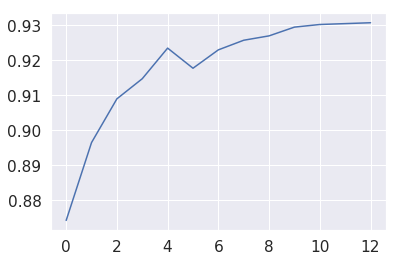

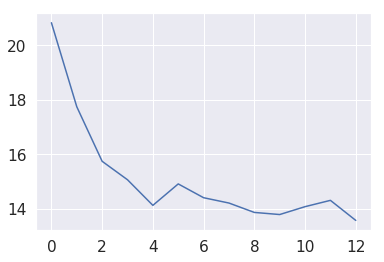

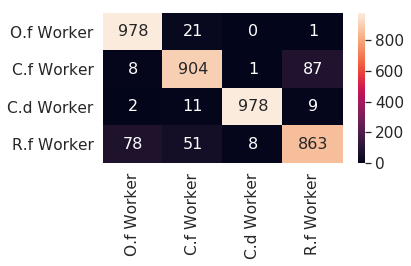

3 3
1 1
0 0
1 1
0 0
0 0
2 2
1 3
3 3
3 0
3 3
2 2
3 3
3 2
3 0
3 3
2 2
2 2
1 1
3 3
3 3
3 3
2 2
0 0
1 1
2 2
1 1
1 1
2 2
3 3
1 1
2 2
1 1
2 2
0 0
1 1
2 2
2 2
1 1
1 1
0 0
1 1
2 2
1 1
2 2
1 1
3 3
0 0
0 0
1 1
1 3
2 2
2 2
3 3
3 1
2 2
3 0
0 0
0 0
0 0
3 3
2 2
3 3
3 3
1 1
3 3
1 1
0 0
3 0
2 2
0 0
2 2
2 2
3 3
2 2
2 2
3 3
3 3
0 0
3 3
3 3
2 2
0 0
1 1
0 0
0 0
3 1
3 3
0 0
2 2
2 2
2 2
1 1
0 0
0 0
1 1
3 1
0 0
0 0
3 3
2 2
0 0
2 2
0 0
2 2
1 1
0 0
1 1
0 0
2 2
3 3
0 0
1 1
1 1
1 1
1 1
3 3
2 2
0 0
3 3
2 2
3 3
1 1
3 3
2 2
2 2
0 0
3 0
3 3
1 1
3 3
3 3
1 3
3 0
2 2
0 0
1 1
1 1
2 2
2 2
3 3
1 1
0 0
1 1
3 3
0 0
2 2
2 2
1 1
3 3
3 3
2 2
0 0
2 2
0 0
3 3
3 3
1 1
0 0
3 3
3 3
2 2
2 2
2 2
2 2
1 1
1 1
2 2
3 3
3 3
1 1
1 1
3 0
1 1
3 3
1 1
0 0
1 1
3 3
0 0
0 0
1 1
3 3
2 2
2 2
2 2
0 0
2 2
1 1
2 2
0 0
2 2
0 0
1 1
2 2
0 0
0 0
3 3
1 1
0 0
0 0
3 3
2 2
1 3
0 0
2 2
3 3
3 3
3 3
0 1
2 2
3 3
2 2
1 1
1 1
1 1
2 2
0 0
2 2
0 0
0 0
0 0
0 1
0 0
2 2
1 1
0 0
2 2
1 1
0 0
3 3
3 3
0 0
2 2
2 2
2 2
0 0
1 1
2 2
1 1
2 2
3 1
2 2
1 1
0 0
3 3
0 0
3 1
1 1
0 0


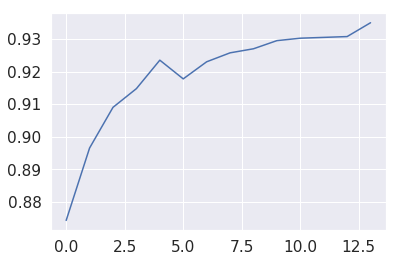

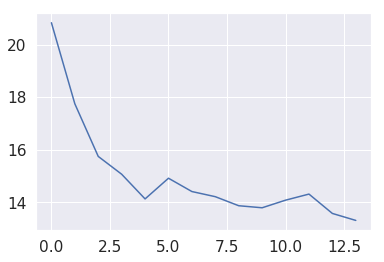

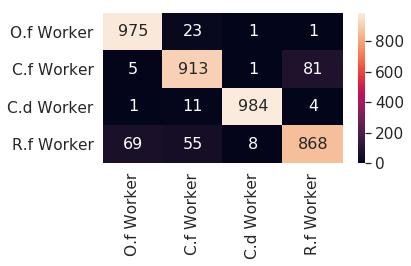

2 2
1 1
3 3
3 3
1 1
1 1
0 0
0 0
2 2
3 3
1 3
0 0
3 3
3 3
3 3
0 0
0 0
1 1
0 0
0 1
0 0
2 2
0 0
1 1
0 0
3 0
0 0
2 2
2 2
2 2
0 0
1 3
1 1
2 2
2 2
2 2
3 3
3 3
1 1
1 1
3 3
1 1
2 2
2 2
2 2
0 0
2 2
1 1
1 1
1 1
2 1
0 0
2 2
1 1
1 1
2 2
2 2
0 0
3 3
2 2
1 1
2 2
1 1
2 2
1 1
2 2
0 0
0 0
3 3
1 1
2 2
1 1
0 0
1 1
1 1
1 1
0 0
1 1
1 1
2 2
3 3
2 2
1 1
2 2
3 3
2 2
0 0
2 2
3 3
0 0
1 1
3 3
2 2
0 0
2 2
0 0
3 3
0 0
1 1
1 3
0 0
0 0
1 1
1 1
3 3
2 2
1 1
1 1
0 0
0 0
2 2
2 2
0 0
1 3
1 1
3 3
3 3
3 3
3 3
0 0
0 0
1 3
3 3
0 0
0 0
2 2
0 0
3 3
1 1
0 0
0 0
0 0
3 3
0 0
1 1
0 0
1 1
2 2
2 2
3 0
0 0
1 1
0 0
3 3
2 2
2 2
3 3
2 2
2 2
0 0
2 2
0 0
2 2
3 3
1 1
2 2
0 0
2 2
2 2
2 2
1 1
1 1
0 1
3 3
3 3
3 3
2 2
0 0
2 2
1 1
2 2
0 0
2 2
1 1
0 0
0 0
2 2
0 0
3 3
3 3
3 3
2 2
2 2
1 1
0 0
2 2
1 1
2 2
3 3
2 2
1 1
2 2
2 2
3 3
3 3
1 1
0 0
0 0
3 3
3 3
2 2
2 2
3 3
1 1
1 1
1 1
1 1
1 3
3 3
2 2
1 1
1 3
2 2
1 3
3 3
2 2
2 2
1 3
2 2
2 2
1 1
0 0
2 2
0 0
1 1
0 0
1 3
1 1
3 3
1 1
0 0
1 1
0 0
1 1
2 2
1 1
0 0
3 3
2 2
0 0
2 2
3 3
2 2
0 0
3 3
0 0
3 3
1 1
2 2
3 3


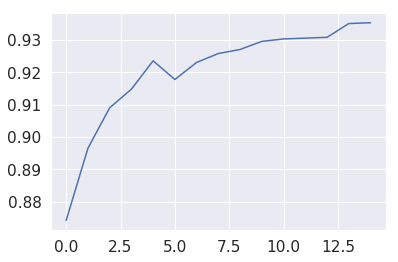

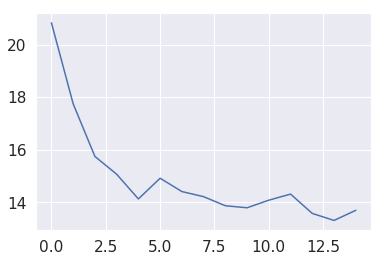

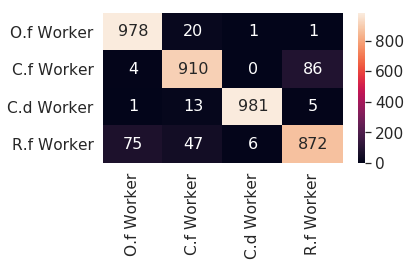

3 3
0 0
1 1
2 2
1 1
1 1
2 2
3 3
1 3
3 3
0 0
2 2
0 0
2 2
3 3
1 1
0 0
1 1
1 1
3 3
1 1
2 2
2 2
1 1
1 1
2 2
1 1
1 1
2 2
1 1
2 2
3 3
0 0
1 3
0 0
3 3
0 0
3 3
1 1
1 1
2 2
1 1
3 3
1 1
2 2
2 2
2 2
2 2
1 3
2 2
1 1
3 3
0 0
3 3
0 0
0 0
3 3
2 2
2 2
2 2
2 2
0 0
1 1
1 1
2 2
2 2
1 1
0 0
1 1
3 3
1 1
0 0
2 2
0 0
1 1
0 0
3 0
3 3
2 2
2 2
0 0
0 0
3 3
1 1
3 3
2 2
2 2
1 1
3 3
2 2
1 1
1 1
2 2
2 2
0 0
3 3
1 1
2 2
1 1
2 2
1 1
2 2
0 0
0 0
0 0
1 1
3 3
3 0
3 3
2 1
3 3
0 0
0 0
1 1
2 2
3 3
2 2
0 0
3 3
1 1
1 1
0 0
0 0
1 1
0 0
2 2
3 3
1 1
0 0
1 1
0 0
1 1
2 2
0 0
1 1
2 2
0 0
2 2
2 2
0 0
1 1
0 0
1 1
3 3
2 2
3 3
3 3
2 2
2 2
3 3
1 1
1 1
0 0
0 0
1 1
3 3
1 1
3 3
0 0
3 3
2 2
0 0
1 1
2 2
1 3
1 1
3 3
3 3
1 1
1 1
2 2
2 2
1 1
0 0
0 0
2 2
3 3
2 2
1 1
0 0
2 2
1 1
0 0
2 2
2 2
1 1
2 2
2 2
3 3
0 0
1 1
2 2
2 2
1 1
3 0
3 0
0 0
0 0
0 0
0 0
3 3
0 0
3 3
2 2
2 2
2 2
0 0
0 0
0 0
3 3
1 1
2 2
1 1
1 3
1 1
1 1
3 2
3 3
2 2
0 0
2 2
0 0
0 0
3 3
3 3
3 3
3 3
2 2
2 2
3 3
1 1
1 3
1 1
3 3
0 0
0 0
2 2
0 0
0 0
1 1
2 2
1 1
2 2
0 0
3 3
3 3
3 3
2 2
0 0
1 1


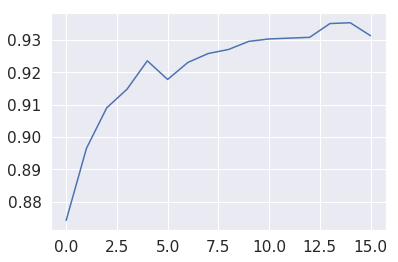

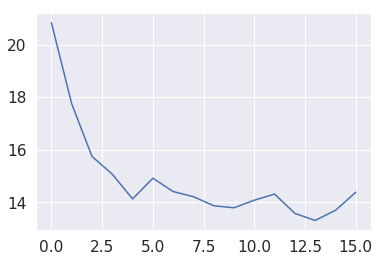

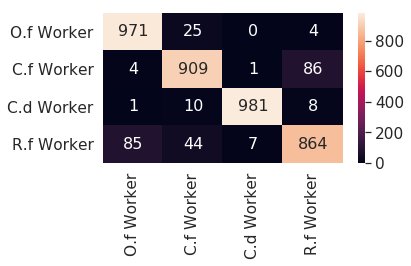

0 0
3 3
1 1
3 3
0 0
0 0
2 2
0 0
2 2
2 2
2 2
2 2
2 2
0 0
2 2
3 3
3 3
3 3
1 1
1 1
1 1
3 3
2 2
3 3
1 1
0 0
3 3
1 1
1 1
2 2
3 0
2 2
3 3
1 1
3 3
0 0
3 1
0 0
1 1
0 0
2 2
0 0
3 3
2 1
3 3
3 0
0 0
1 1
2 2
1 1
3 3
2 2
2 2
0 0
0 0
3 3
1 1
0 0
3 3
0 0
2 2
3 0
2 2
1 1
0 0
0 0
3 0
1 1
1 1
3 3
3 3
3 3
1 1
1 1
2 2
3 3
1 1
1 1
0 0
0 0
3 3
1 1
3 3
0 0
2 2
0 0
3 3
0 0
1 1
2 2
2 2
1 1
3 3
2 2
1 1
3 3
2 2
0 0
0 0
3 3
2 2
3 3
0 0
1 1
0 0
0 0
2 2
1 1
2 2
3 3
2 2
3 3
0 0
1 1
2 2
2 2
3 3
1 1
1 1
2 2
2 2
2 2
1 1
3 3
0 0
1 1
0 0
0 0
0 0
1 1
3 3
3 3
3 3
2 2
3 3
3 3
2 2
0 0
3 3
2 2
2 2
0 0
3 3
0 0
2 2
3 3
2 2
0 0
0 0
0 0
1 1
2 2
2 1
2 2
2 2
2 2
1 1
1 1
2 2
2 2
1 1
1 1
0 0
2 2
3 3
3 3
3 3
1 1
0 0
2 2
2 2
3 0
2 2
2 2
2 2
2 2
1 1
2 2
2 2
2 2
1 1
3 3
1 1
1 1
3 3
1 1
0 0
0 0
2 2
0 0
3 1
3 3
1 1
0 0
1 1
3 3
1 3
2 2
3 3
3 3
1 1
0 0
2 2
3 0
2 2
2 2
1 1
2 2
2 2
3 3
3 3
1 1
3 3
0 1
0 0
3 1
1 1
3 3
0 0
3 3
0 0
1 1
2 2
3 3
0 0
3 3
0 0
0 0
2 2
2 2
3 1
1 1
2 2
2 2
2 2
0 0
3 3
3 0
3 0
2 2
2 2
0 0
0 0
1 1
3 3
3 3
3 3
1 1
0 0
3 3


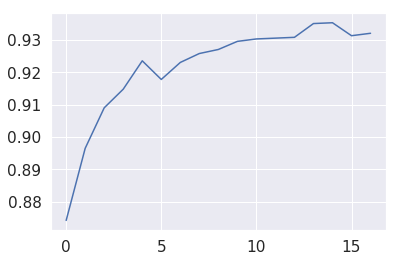

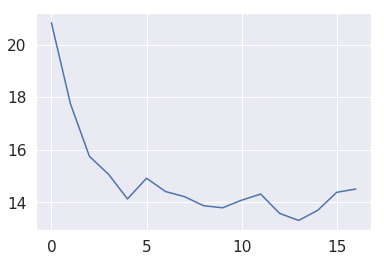

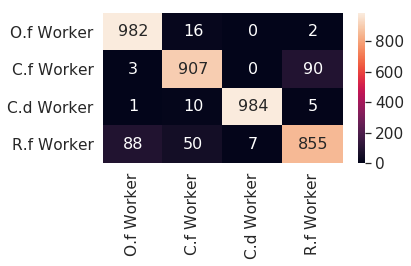

1 1
2 2
0 0
0 0
2 2
0 0
0 0
1 1
3 3
1 1
0 0
0 0
3 3
0 0
0 0
1 1
3 3
1 1
3 3
3 3
1 1
1 1
0 0
1 1
0 0
1 1
3 3
3 3
0 0
3 3
0 0
2 2
3 3
3 3
2 2
0 0
0 0
1 1
1 1
1 3
2 2
1 1
2 2
2 2
1 1
2 2
3 3
2 2
2 2
3 3
3 3
3 0
0 0
2 2
1 1
0 0
3 3
2 2
1 1
1 1
1 3
0 0
0 0
2 2
3 3
2 2
0 0
1 1
2 2
1 1
1 1
1 1
2 2
1 1
0 0
1 1
3 3
3 0
1 1
1 1
0 0
1 1
3 0
2 2
1 1
2 2
2 2
3 3
3 3
3 3
0 0
2 2
3 3
3 3
3 3
3 3
3 0
2 2
0 0
0 0
2 2
3 3
3 1
3 3
1 1
3 1
3 3
3 3
1 1
2 0
1 1
2 2
2 2
1 1
0 0
1 1
1 1
2 2
3 3
3 1
1 1
0 0
0 0
3 2
2 2
3 3
1 1
3 3
2 2
1 1
2 2
1 1
1 1
2 2
1 3
0 0
1 1
3 3
3 3
1 3
2 2
1 1
2 2
2 2
1 1
3 3
3 3
0 0
3 3
2 2
1 1
3 3
2 2
1 1
1 1
1 1
0 0
1 1
0 0
3 2
3 3
2 2
1 1
1 1
0 0
1 1
0 0
3 3
0 0
2 2
2 2
0 0
0 0
1 1
3 3
2 2
2 2
3 3
0 0
0 0
1 1
1 1
1 1
3 3
0 0
3 3
0 0
0 0
0 0
0 0
1 1
3 3
0 0
1 1
0 0
0 0
1 1
3 3
1 1
0 0
3 3
1 1
3 3
1 1
1 3
1 1
1 1
2 2
1 1
2 2
1 1
0 0
3 3
0 0
0 0
2 2
1 1
2 2
2 2
1 1
0 0
3 3
0 0
3 3
1 1
2 2
3 3
2 2
3 3
0 0
0 0
1 1
0 0
3 3
2 2
2 2
3 3
3 3
0 0
2 2
3 3
2 2
1 1
0 0
2 2
1 1
3 3
3 3
1 1
2 2


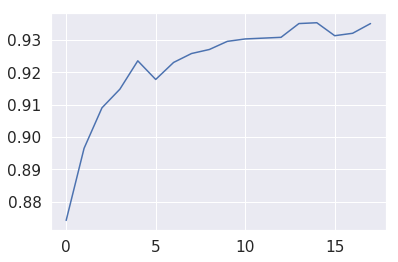

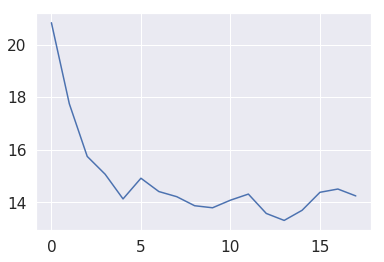

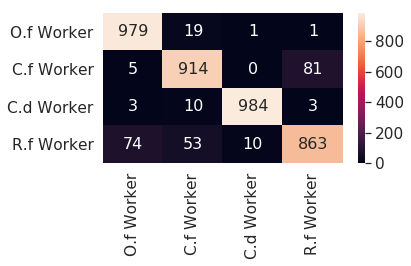

1 1
0 0
1 1
2 2
1 1
3 1
2 2
2 2
3 3
2 2
1 3
3 0
2 2
3 3
2 2
2 2
0 0
0 0
3 3
3 3
1 1
3 3
1 1
2 2
2 2
3 3
1 1
2 2
0 0
1 1
1 1
3 3
3 1
2 2
2 2
0 0
1 1
3 3
0 0
2 2
1 1
3 1
3 3
3 3
2 2
2 2
0 0
0 0
1 3
0 0
3 3
2 2
3 3
2 2
3 3
2 2
2 2
3 3
2 2
0 0
0 0
1 1
0 0
0 0
3 3
1 1
3 3
1 3
3 3
1 3
2 2
3 3
1 1
3 3
0 0
1 1
0 0
2 2
1 1
2 2
0 0
0 0
2 2
2 2
0 0
2 2
3 1
1 1
0 0
2 2
3 3
3 3
1 3
1 1
1 1
1 1
1 1
0 0
1 1
2 2
1 1
0 0
0 0
3 3
1 1
0 0
2 2
3 3
1 1
1 1
2 2
2 2
0 0
0 0
2 2
0 0
0 0
0 0
2 2
3 3
2 2
1 1
0 0
1 1
1 0
3 3
2 2
0 0
2 2
2 2
1 1
3 0
0 0
2 2
0 0
0 0
1 1
3 2
1 1
2 2
3 3
1 1
2 2
2 2
3 3
0 0
3 3
1 1
0 0
3 3
0 0
2 2
3 3
0 0
1 1
0 0
0 0
0 0
2 2
2 2
1 1
3 3
1 1
0 0
1 1
1 1
3 3
3 3
3 3
3 3
3 3
0 0
2 2
1 1
0 0
0 0
3 3
3 3
0 0
0 0
1 1
2 2
2 2
3 3
3 3
2 2
3 3
0 0
1 1
2 2
2 2
1 1
0 0
3 3
1 1
1 1
2 2
1 1
3 3
2 2
3 3
2 2
0 0
2 2
3 3
1 1
1 1
3 3
1 1
2 2
0 0
1 1
2 2
0 0
2 2
3 1
2 2
3 3
1 1
3 3
3 3
0 0
1 0
2 2
1 1
2 2
1 1
3 3
0 0
3 3
1 1
0 0
1 1
1 1
2 2
2 2
1 1
3 3
0 0
1 3
2 2
0 0
3 3
2 2
2 2
3 1
0 0
1 1
0 0
0 0


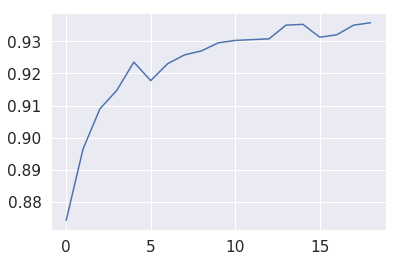

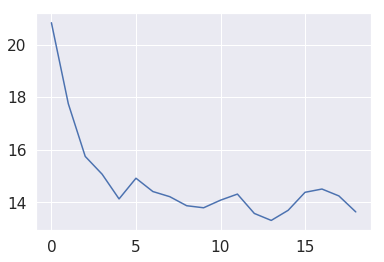

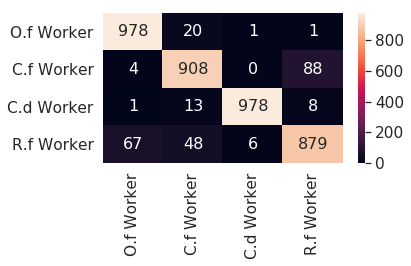

2 2
0 0
0 0
0 0
3 3
2 2
3 3
1 1
2 2
1 1
3 3
1 3
2 2
1 1
0 0
1 1
2 2
1 1
0 0
2 2
2 2
3 3
2 2
3 0
1 1
3 3
3 3
2 2
1 1
3 3
2 2
2 2
3 3
1 1
3 3
1 1
3 3
2 2
0 0
3 3
3 3
2 2
3 0
1 1
3 3
1 1
1 1
3 3
3 1
1 1
1 1
2 2
3 3
1 3
2 2
3 0
1 1
2 2
1 1
2 2
0 0
2 2
2 2
3 0
1 1
0 0
1 1
1 1
0 0
2 1
3 1
2 2
3 3
3 3
0 0
2 2
2 2
2 2
2 2
2 2
1 1
1 1
0 0
0 0
0 0
3 1
2 2
0 0
1 1
2 2
0 0
0 0
0 0
1 1
3 3
1 1
1 3
3 3
0 0
3 3
2 2
1 1
2 2
0 0
0 0
2 2
2 2
1 1
0 0
0 0
3 3
2 2
0 0
3 3
0 0
2 2
0 0
0 0
2 2
3 3
0 0
0 0
1 1
1 1
0 0
1 1
1 1
3 3
3 3
2 2
0 0
0 0
0 0
0 0
0 0
1 1
2 2
2 2
3 1
3 3
2 2
1 1
3 3
3 3
3 3
2 2
2 2
0 0
1 1
3 3
3 3
3 3
0 0
2 2
1 1
2 2
0 0
2 2
0 0
3 1
3 3
0 0
1 1
0 0
3 3
2 2
2 2
3 3
3 3
2 2
1 1
2 2
3 3
1 1
1 1
3 3
2 2
3 3
0 0
0 0
3 3
3 3
1 1
1 1
2 2
1 1
0 0
2 2
2 2
3 3
0 0
0 0
1 1
0 0
0 0
3 3
2 2
3 3
2 2
1 1
3 3
1 1
2 2
2 2
1 1
1 1
2 2
0 0
2 2
2 2
0 0
1 1
2 2
0 0
1 1
1 1
2 2
3 3
0 0
0 0
3 3
3 3
3 3
0 0
0 0
3 3
2 2
3 3
3 3
2 2
1 1
1 1
2 2
0 0
2 2
3 3
0 0
1 1
0 0
1 1
2 2
3 3
3 3
1 1
1 1
1 1
0 0
1 1
2 2
1 1


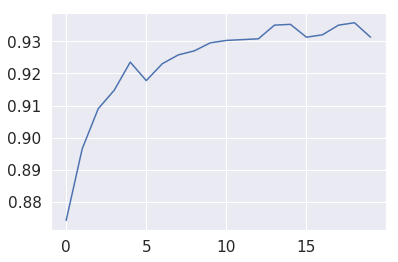

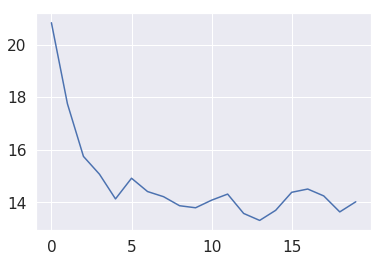

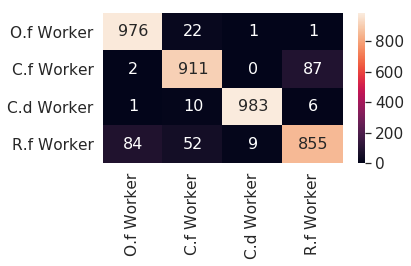

1 1
3 3
3 3
2 2
2 2
2 2
0 0
0 0
0 0
1 1
1 1
3 3
2 2
2 2
2 2
0 0
0 0
2 2
3 3
3 3
1 1
2 2
1 1
1 3
3 3
3 3
0 0
1 1
0 0
0 0
0 0
0 0
0 0
3 3
3 3
3 3
2 2
2 2
1 1
3 3
2 2
1 1
2 2
3 3
2 2
3 3
2 2
2 2
0 0
2 2
2 2
0 0
2 2
0 0
3 3
1 1
0 0
0 0
0 0
1 1
3 3
3 3
1 1
0 0
2 2
1 1
0 0
1 1
1 1
1 1
2 2
2 2
1 3
3 0
2 2
0 0
2 2
2 2
3 3
1 1
2 1
1 1
3 3
3 3
3 1
3 3
2 2
0 0
2 2
3 3
1 1
2 2
1 1
3 3
1 1
2 2
2 2
0 0
2 2
1 1
1 1
1 1
1 1
0 0
2 2
2 2
0 0
3 3
2 2
3 3
0 0
0 0
1 1
3 0
1 1
0 0
0 0
3 1
2 2
0 0
0 0
0 0
2 2
1 1
3 3
2 2
3 3
1 1
0 0
1 1
3 3
3 3
2 2
1 1
1 1
0 0
0 0
1 1
2 2
2 2
2 2
0 0
2 2
0 0
0 0
1 1
3 3
1 1
2 2
0 0
2 2
1 1
0 0
2 2
3 3
1 1
2 2
0 0
1 0
1 1
3 3
3 3
3 3
2 2
0 0
2 2
2 2
1 1
3 0
0 0
0 0
1 1
1 1
0 0
0 0
3 3
1 1
1 1
3 3
0 0
2 2
0 0
0 0
1 3
1 1
0 0
0 0
1 3
3 3
1 1
0 0
1 1
2 2
2 2
0 0
0 0
1 1
1 3
1 1
1 1
2 2
3 3
3 3
2 2
1 1
2 2
1 1
1 1
0 0
0 0
1 1
0 0
3 0
1 1
3 3
0 0
3 3
2 2
1 1
2 2
0 0
2 2
1 1
3 3
1 1
2 2
1 1
0 0
1 1
2 2
0 0
3 3
0 0
3 3
1 1
2 2
2 2
2 2
0 0
3 3
2 2
2 2
0 0
0 0
0 0
2 2
3 3
3 3
0 0
1 1


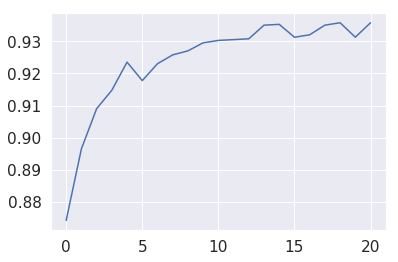

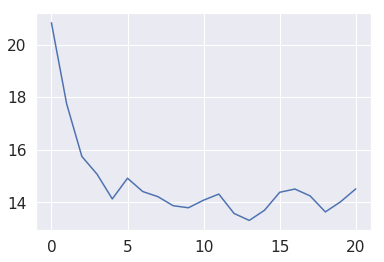

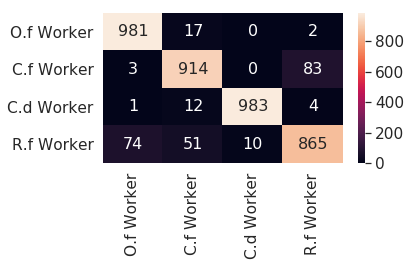

3 3
3 1
0 0
2 2
1 1
2 2
1 1
2 2
0 0
2 2
0 1
2 1
2 2
0 0
2 2
1 1
1 1
0 0
2 2
0 0
3 0
2 2
0 0
3 3
1 1
0 0
2 2
2 2
3 3
1 3
2 2
1 1
3 3
1 1
0 0
3 3
3 3
3 3
3 0
1 1
1 1
2 2
3 0
0 0
2 2
1 1
2 2
3 3
1 1
2 2
3 3
2 2
2 1
2 2
3 3
3 3
3 3
0 0
3 3
3 3
3 3
2 2
2 2
2 2
3 3
3 3
1 1
1 3
1 1
2 2
1 1
3 3
3 3
0 0
0 0
3 3
0 0
0 0
0 0
0 0
1 1
1 1
2 2
2 2
2 2
2 2
2 2
3 3
3 3
1 1
0 0
1 1
0 0
3 3
3 0
1 1
0 0
0 0
2 2
1 1
0 0
1 3
2 2
1 1
1 1
1 1
3 3
2 2
2 2
0 0
2 2
2 2
3 3
1 1
0 0
1 1
3 3
1 1
0 0
2 2
1 1
3 3
0 0
0 0
1 1
0 0
0 0
0 0
3 3
0 0
3 3
0 0
2 2
2 2
1 1
0 0
0 0
3 3
0 0
2 2
1 1
0 0
3 3
3 3
1 1
3 3
3 3
1 1
3 3
2 2
1 1
1 1
0 0
1 1
0 0
0 0
0 0
2 2
0 0
1 1
3 3
2 2
1 1
1 1
2 2
3 0
1 1
2 2
1 1
3 3
0 0
2 2
0 0
1 1
2 2
0 0
3 0
3 3
0 0
2 2
2 2
2 2
2 2
3 3
3 3
2 2
2 2
3 3
3 3
0 0
3 3
0 0
0 0
0 1
1 1
2 2
3 3
0 0
3 3
1 3
0 0
3 3
2 2
2 2
1 1
3 3
1 1
1 1
2 2
3 3
0 0
3 3
3 3
2 2
3 3
1 1
1 1
3 3
0 0
1 1
2 2
2 2
0 0
2 2
0 0
1 1
0 0
0 0
1 1
1 1
1 1
1 1
3 0
2 2
0 0
0 0
3 3
0 0
1 1
0 0
0 0
1 1
0 0
3 3
1 1
2 2
1 1
0 0
0 0
3 3


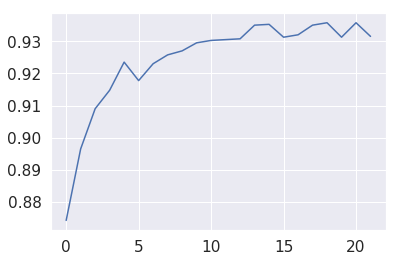

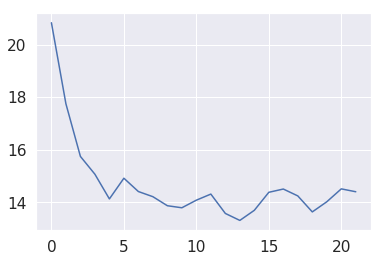

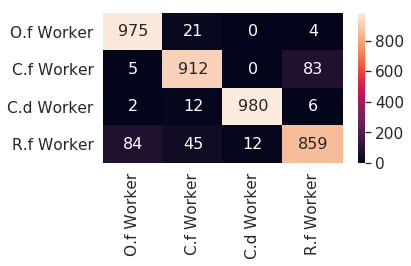

2 2
3 3
2 2
0 0
1 1
1 3
2 2
1 1
3 3
0 0
3 0
3 3
0 0
2 2
2 2
1 1
1 1
3 3
3 3
0 0
2 2
0 0
2 2
0 0
1 1
3 1
3 0
2 2
3 3
0 0
3 3
2 2
2 2
3 3
3 3
1 1
2 2
1 1
2 2
0 0
1 1
3 3
3 3
1 1
2 2
1 1
0 0
0 0
3 3
3 3
0 0
2 2
3 3
1 1
2 2
0 0
2 2
1 1
1 1
3 3
2 2
0 0
1 1
3 3
0 0
2 2
0 0
1 1
1 1
0 0
2 2
2 2
2 2
1 1
3 3
0 0
1 1
0 0
1 1
3 3
1 1
2 2
0 0
0 0
0 0
0 0
2 2
2 2
1 1
1 1
0 0
2 2
2 2
0 0
0 0
0 0
0 0
2 1
1 3
0 0
1 1
1 1
1 1
2 2
0 0
1 1
1 3
1 0
2 2
1 1
2 2
1 1
1 1
0 0
3 3
0 0
2 2
0 0
1 1
1 1
2 2
0 0
3 0
3 3
0 0
2 2
3 3
2 2
3 1
0 0
0 0
3 3
2 2
2 2
3 3
0 2
3 3
3 1
0 0
1 1
2 2
0 1
1 1
1 1
3 3
1 1
1 1
1 1
0 0
2 2
2 2
1 1
1 1
0 0
2 2
0 0
2 2
3 3
2 2
0 0
3 3
2 2
1 1
3 3
0 0
0 0
1 1
2 2
0 0
1 3
3 0
1 1
3 0
0 0
1 1
3 3
1 3
3 3
3 3
0 0
0 0
3 3
1 1
3 3
1 1
0 0
2 2
3 3
3 3
3 3
3 3
3 3
2 2
1 1
1 1
3 3
1 1
1 1
0 0
2 2
1 1
2 2
3 3
3 3
1 1
3 3
3 3
0 0
0 0
0 0
3 3
2 2
2 2
1 1
3 3
0 0
2 2
2 2
1 1
0 0
1 1
1 1
2 2
3 3
2 2
0 0
2 2
2 2
1 1
2 2
0 0
0 0
1 3
1 1
3 3
2 2
1 1
3 3
3 3
2 2
2 2
1 3
2 2
3 3
3 3
1 1
0 0
3 3
0 1
0 0


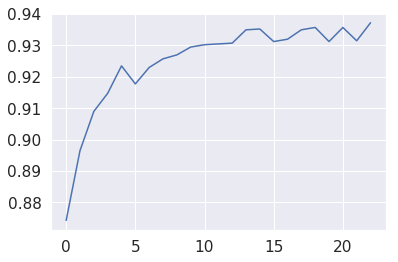

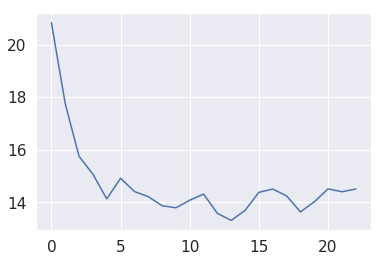

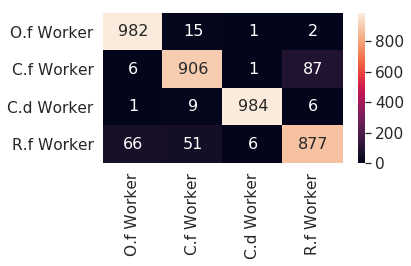

3 3
3 3
0 0
2 2
1 1
3 3
1 1
2 2
0 0
3 3
3 3
3 3
3 0
0 0
3 3
3 3
3 3
2 2
3 3
0 0
1 1
2 1
1 1
3 3
2 2
1 1
2 2
3 0
1 1
0 0
2 2
1 1
1 3
1 1
2 2
1 1
3 3
2 2
0 0
0 0
2 2
1 1
2 2
1 1
0 0
1 1
2 2
0 0
0 0
3 3
2 2
0 0
0 0
0 0
1 1
3 3
2 2
0 0
3 3
0 0
2 2
2 2
0 0
1 1
1 1
2 2
1 1
3 3
2 2
3 3
1 3
1 3
3 3
1 1
0 0
1 1
1 1
3 0
0 0
0 0
0 0
2 2
0 0
1 1
2 2
3 3
2 2
0 0
3 3
1 1
2 2
2 2
2 2
3 3
2 2
2 2
0 0
2 2
2 2
1 1
1 1
2 2
1 1
3 3
3 3
1 1
3 0
2 2
0 0
1 1
1 1
3 3
2 2
0 0
1 1
0 0
2 2
1 1
0 0
1 3
0 0
0 0
1 1
0 0
1 1
1 1
2 2
1 1
3 3
2 2
1 1
1 1
0 0
0 0
2 3
2 2
3 3
2 1
0 0
2 2
2 2
1 1
3 3
1 1
2 2
3 3
2 2
3 3
2 2
1 1
0 0
3 0
2 2
0 0
1 1
0 0
1 1
1 1
0 0
1 1
2 2
3 3
3 3
0 0
1 1
2 2
3 3
2 2
2 2
1 1
2 2
2 2
0 0
2 2
3 3
2 2
3 3
2 2
1 1
1 1
0 0
0 0
0 0
2 2
0 0
1 1
2 2
0 0
1 1
0 0
2 2
3 3
2 2
2 2
0 0
3 0
1 1
3 3
1 1
3 3
1 1
3 3
1 1
0 0
1 1
1 1
3 3
3 0
2 2
2 2
1 1
2 2
0 0
1 1
3 3
3 3
0 0
1 1
3 3
3 3
0 0
1 1
0 0
1 1
3 3
0 0
3 3
0 0
0 0
1 1
1 1
2 2
3 3
0 0
2 2
0 0
0 0
2 2
1 1
3 3
2 2
2 2
0 0
1 1
2 2
2 2
3 3
2 2
1 1
1 1


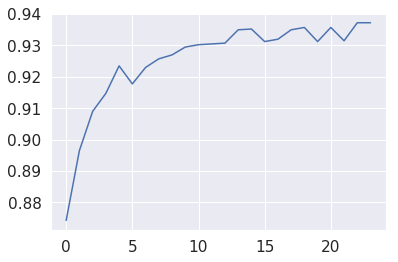

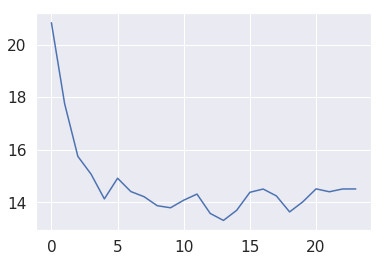

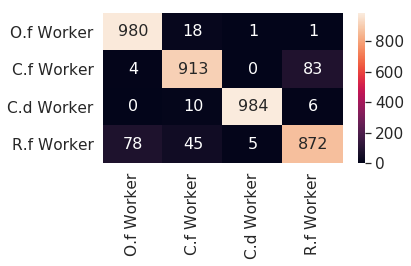

0 0
3 1
3 3
0 0
3 3
2 2
3 3
0 0
0 0
2 2
2 2
3 3
1 1
1 1
3 3
3 3
3 3
2 2
2 2
2 2
2 2
1 1
0 0
2 2
0 0
1 1
1 1
1 1
1 1
2 2
0 0
0 0
3 3
2 2
0 0
2 2
3 3
2 2
1 1
3 3
2 2
3 3
2 2
1 1
2 2
2 2
2 2
1 1
2 2
2 2
2 2
0 0
1 1
1 1
3 3
3 3
2 2
0 0
0 0
1 1
2 2
0 0
2 2
1 1
3 2
1 1
2 2
1 1
0 0
3 3
3 3
1 1
2 2
0 0
1 1
2 2
2 2
2 2
2 2
3 3
0 0
2 2
0 0
2 2
2 2
2 2
0 0
0 0
3 3
3 3
3 3
1 1
0 0
1 1
3 3
3 3
0 0
2 2
2 2
1 1
1 3
3 3
3 3
3 3
0 0
1 1
0 0
3 1
0 0
2 2
0 0
3 3
3 3
1 1
1 1
3 3
3 3
3 3
3 3
0 0
2 2
1 1
1 1
3 1
3 3
3 3
0 0
3 3
3 3
0 0
1 1
2 2
1 1
1 1
3 3
2 2
0 0
2 2
0 0
3 3
2 2
1 1
0 0
2 2
0 0
0 0
2 2
3 3
0 0
2 2
1 1
1 1
1 1
3 3
2 2
0 0
0 0
2 2
0 0
1 1
2 2
2 2
3 3
1 1
3 3
0 0
2 2
3 3
2 2
1 1
3 0
2 2
0 0
2 2
1 1
0 0
1 1
3 3
3 3
1 1
2 2
0 0
1 1
0 0
2 2
2 2
0 0
1 1
3 1
3 3
0 0
1 1
1 1
2 2
0 0
0 0
0 0
3 3
2 2
3 3
2 2
0 0
1 1
3 3
0 0
3 3
2 2
3 3
0 0
1 1
2 2
0 1
2 2
0 0
2 2
0 0
3 3
1 1
0 0
1 1
3 3
0 0
3 3
2 2
0 0
1 1
0 0
3 3
1 1
2 2
3 3
2 2
3 3
0 0
2 2
3 3
2 2
3 3
3 3
0 0
0 0
3 3
1 1
1 3
1 1
2 2
0 0
3 3
1 1
2 2


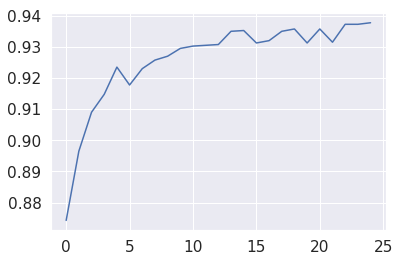

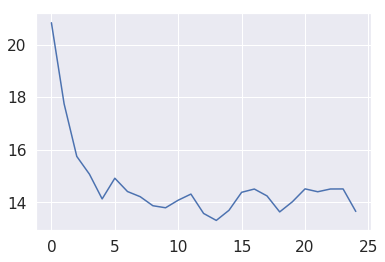

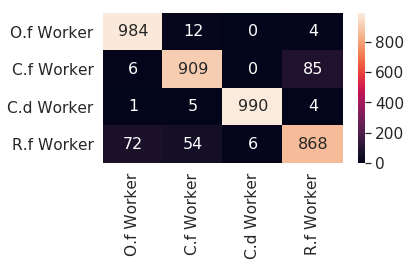

1 3
2 3
0 0
1 1
0 0
2 2
2 2
0 0
2 2
3 3
1 1
3 3
0 0
2 2
0 0
2 2
0 0
3 3
2 2
0 0
3 3
1 3
2 2
1 3
1 1
0 1
1 1
0 0
2 2
3 3
0 0
0 0
0 1
2 2
0 0
2 2
1 1
0 0
0 0
3 3
0 0
0 0
2 2
2 3
1 1
2 2
2 2
3 3
2 2
1 1
0 0
2 2
0 0
3 3
1 1
1 1
1 1
3 3
2 2
2 2
0 0
1 1
0 0
1 1
2 2
0 0
1 1
3 3
2 2
1 1
0 0
0 0
1 1
1 1
1 1
0 0
2 2
2 2
0 0
0 0
0 0
2 2
3 3
3 3
0 0
3 3
2 2
2 2
0 0
0 0
2 2
1 1
3 3
0 0
0 0
3 0
3 3
0 0
2 2
2 2
3 3
0 0
1 1
1 1
1 1
1 1
3 3
0 0
0 0
2 2
2 2
2 2
3 3
0 0
0 0
1 1
0 0
2 2
0 0
1 1
2 2
3 3
3 3
2 2
2 2
3 3
3 3
1 1
3 3
2 2
1 1
2 2
2 2
1 1
3 3
3 3
2 2
3 0
2 2
0 0
3 3
2 2
0 0
0 0
3 3
3 3
1 1
0 0
2 2
3 3
0 0
0 0
0 0
0 0
0 1
1 1
3 3
3 3
2 2
2 2
0 0
3 3
2 2
2 2
0 0
1 1
1 1
3 1
2 2
3 3
1 1
2 2
0 0
2 2
3 3
3 3
0 0
2 2
3 3
0 0
3 3
2 2
2 2
2 2
0 0
0 0
2 2
2 2
1 1
1 1
1 1
3 3
0 0
0 0
0 0
1 1
3 3
0 0
1 1
2 2
3 0
2 2
3 3
1 1
3 1
1 1
1 1
1 3
3 3
2 2
2 2
3 3
0 0
3 3
3 1
3 3
3 3
0 0
1 1
1 1
3 3
2 2
0 0
0 0
1 3
0 0
3 3
0 0
1 1
1 1
1 1
2 2
3 3
3 2
0 0
1 1
0 0
2 2
3 3
2 2
2 2
3 3
3 3
1 1
3 1
3 0
2 2
0 0
0 0
1 1


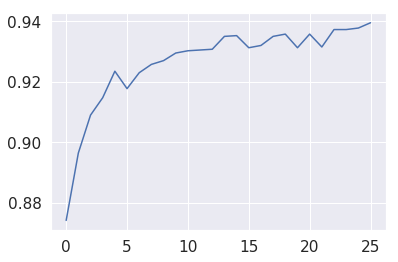

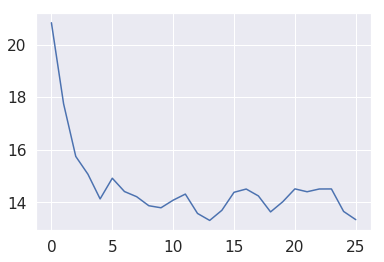

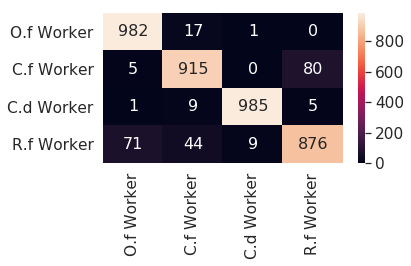

0 0
3 3
1 1
3 1
1 0
0 0
3 3
0 0
2 2
0 0
2 2
1 3
0 0
2 2
2 2
0 0
2 2
2 2
0 1
2 2
3 3
3 3
1 1
0 0
0 0
3 3
3 0
3 3
3 1
1 1
1 1
2 2
1 3
3 0
0 0
1 1
0 0
0 0
1 1
1 1
1 1
1 1
1 1
2 2
3 3
2 2
3 3
3 2
3 3
0 0
0 0
3 3
2 2
3 3
3 3
2 2
1 1
2 2
2 2
1 1
0 0
1 1
2 2
1 1
2 2
2 2
3 3
0 0
3 3
2 2
1 1
1 1
0 0
0 0
0 0
0 0
3 3
3 3
3 3
3 3
0 0
1 1
3 3
1 1
1 1
1 1
1 1
0 0
3 3
2 2
2 2
2 2
2 2
2 2
0 0
3 1
0 0
3 0
3 3
2 2
0 0
2 2
3 3
1 1
3 3
2 2
2 2
3 3
3 3
3 3
2 2
1 1
3 3
3 0
1 1
3 3
3 3
0 0
0 0
3 3
3 0
3 1
2 2
3 3
3 3
0 0
1 1
3 1
2 2
0 0
2 2
2 2
3 3
3 3
3 3
1 1
0 0
3 3
0 1
2 2
1 1
3 3
0 0
1 1
3 3
3 3
0 0
0 0
0 0
1 1
0 0
0 0
2 2
2 2
1 1
0 0
2 2
3 3
1 1
2 2
2 2
2 2
3 3
0 0
0 0
3 3
3 3
1 1
1 1
3 3
1 3
0 0
1 1
3 1
0 0
3 3
3 3
0 0
1 1
2 2
0 0
1 1
0 0
3 3
2 2
3 3
1 1
2 2
0 0
2 2
0 0
3 3
0 0
0 0
2 2
0 0
0 0
2 2
2 2
0 0
2 2
1 1
0 0
1 1
1 1
0 0
0 0
2 2
2 2
2 2
3 3
3 3
0 0
2 2
1 1
1 1
3 3
2 2
0 0
3 3
1 1
2 2
0 1
1 1
2 2
2 2
0 0
3 3
2 2
2 2
0 0
0 0
0 0
0 0
1 1
2 2
2 2
2 2
3 3
1 1
2 2
3 3
0 0
1 1
3 3
3 3
1 1
1 3
2 2
2 2


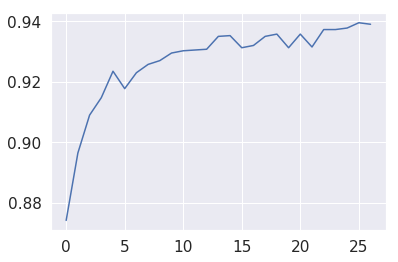

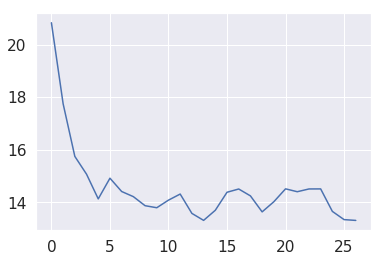

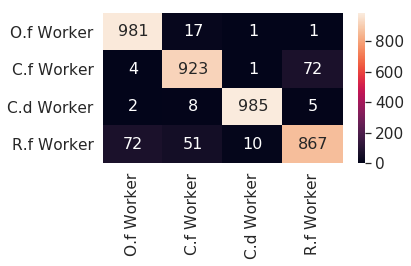

0 0
2 2
3 0
3 3
3 3
3 0
3 3
1 1
1 1
1 1
1 1
3 3
3 3
3 3
3 3
0 0
0 0
1 1
1 1
2 2
3 3
2 2
1 1
3 3
2 2
3 1
3 0
0 0
3 3
0 0
0 0
1 1
2 2
3 1
3 3
2 2
1 1
2 2
1 1
1 1
3 3
2 1
0 0
1 1
2 2
0 0
3 3
0 0
0 0
2 2
1 1
0 0
3 3
1 1
1 1
1 1
0 0
0 0
0 0
2 2
1 1
0 0
2 2
3 3
3 3
0 0
0 0
1 1
2 2
1 1
0 0
2 2
0 0
0 0
0 0
3 3
2 2
2 2
0 0
2 2
1 1
3 3
1 1
1 1
3 3
3 3
3 3
0 0
2 2
2 2
3 3
1 3
0 0
2 2
2 2
0 0
1 1
2 2
1 1
3 3
2 2
0 0
2 2
1 1
0 0
0 0
1 1
3 3
1 3
1 1
2 2
1 1
1 1
2 2
3 3
3 3
3 3
0 0
0 0
0 0
2 2
1 3
2 2
2 2
2 2
1 1
3 3
1 1
0 0
3 3
0 0
2 2
1 1
3 3
0 0
1 1
0 0
2 2
2 2
2 2
2 2
2 2
2 2
2 2
0 0
0 0
0 0
0 0
2 2
2 2
3 3
2 2
0 0
0 0
3 3
2 2
2 2
1 1
2 2
0 0
1 1
3 3
3 3
2 2
0 0
0 0
2 3
0 0
0 0
0 0
0 0
0 0
1 1
3 3
1 3
1 1
1 1
1 1
1 1
0 0
3 3
3 3
3 3
2 2
2 2
1 1
1 1
2 2
3 3
2 2
1 3
0 0
3 3
3 3
2 2
2 2
2 2
3 3
0 0
3 3
0 0
1 1
0 0
1 1
2 2
2 2
0 0
1 1
1 1
2 2
3 3
2 2
1 1
3 3
0 0
2 2
0 0
0 0
3 0
2 2
1 1
2 2
1 1
1 1
2 2
3 3
2 2
3 0
3 1
3 3
3 3
0 0
0 0
0 0
0 0
0 0
1 1
2 2
1 1
2 2
3 0
3 3
2 2
2 2
2 2
3 3
2 2
1 1
3 3
3 3


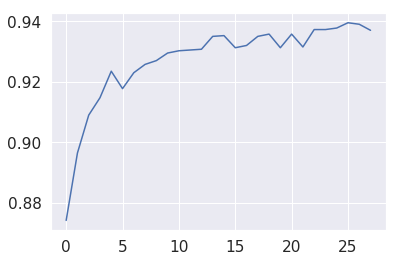

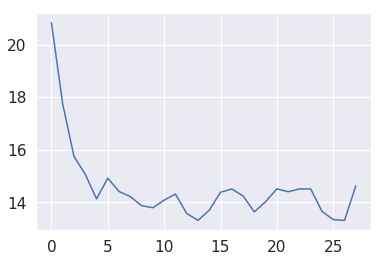

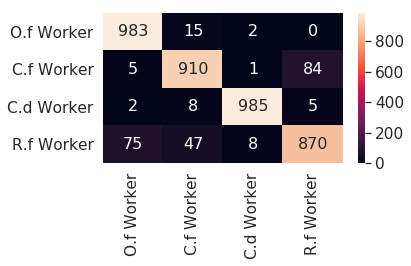

2 2
1 1
2 2
0 0
2 2
3 3
0 0
3 3
2 2
0 0
3 3
0 0
3 3
2 2
0 0
0 0
0 2
1 1
2 2
3 3
1 1
0 1
0 0
0 0
2 2
0 0
1 1
3 3
0 0
1 1
0 0
0 0
2 2
3 3
0 0
0 0
2 2
1 1
2 2
3 3
0 0
3 3
1 1
0 0
0 0
0 0
0 0
1 1
2 2
0 0
3 3
0 0
3 3
2 2
1 1
2 2
1 1
1 1
3 3
3 3
0 1
3 3
1 1
2 1
3 3
0 0
1 1
1 1
0 0
2 2
0 0
1 1
3 0
3 3
1 1
3 3
3 3
3 3
2 2
1 1
2 2
2 2
0 0
3 3
2 2
3 3
1 1
1 1
3 3
1 1
1 1
3 3
3 3
0 0
3 3
2 2
3 2
2 2
3 3
0 0
0 0
0 0
0 0
1 1
3 3
0 0
3 3
2 2
0 0
3 3
1 1
0 0
2 2
1 1
1 1
0 0
3 3
2 2
1 1
1 1
1 1
2 2
2 2
0 0
0 0
1 1
0 0
1 1
1 1
3 0
0 0
3 3
0 0
1 1
1 1
0 0
0 0
0 1
3 3
0 0
3 3
1 1
3 3
1 1
2 2
0 0
2 2
1 1
2 2
0 0
1 1
3 3
0 0
0 0
3 3
3 3
0 0
0 0
1 1
3 2
0 0
1 1
2 2
2 2
0 0
0 0
3 3
1 3
2 2
3 3
1 1
1 1
2 2
3 0
1 1
1 1
0 0
2 2
1 1
1 1
3 3
0 0
3 3
0 0
0 0
3 3
2 2
3 3
2 2
0 0
2 2
2 2
1 1
0 0
0 0
1 1
3 3
3 3
3 3
1 1
2 1
2 2
0 0
1 1
3 3
3 3
2 2
0 0
3 3
2 2
2 2
2 2
2 2
2 2
1 1
1 1
2 2
0 0
2 2
2 2
2 2
0 0
3 3
1 1
1 3
1 1
2 2
2 2
3 3
1 1
3 3
1 1
2 2
1 1
2 2
1 1
3 3
2 2
0 1
3 3
0 0
3 0
1 1
3 3
2 2
2 2
1 1
0 0
3 1
0 0


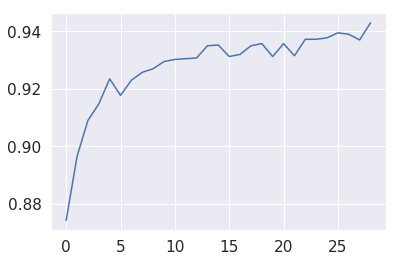

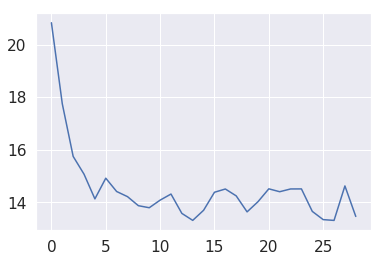

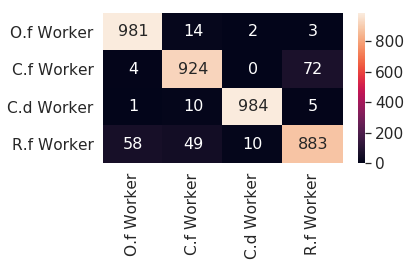

1 1
0 0
2 2
3 3
2 2
1 1
0 0
2 2
0 0
0 0
0 0
0 1
1 1
2 2
0 0
1 1
0 0
0 0
1 1
1 1
1 1
3 3
0 0
2 2
2 2
1 1
1 1
0 0
2 2
3 3
0 0
2 2
1 1
0 1
2 2
1 1
2 2
0 0
0 0
3 3
0 0
3 3
2 2
1 3
0 0
1 1
2 2
1 1
1 1
2 2
3 3
1 1
0 0
1 1
0 0
2 2
1 3
0 0
3 3
1 1
0 0
3 1
0 0
3 3
3 3
1 1
3 3
1 1
1 1
2 2
1 1
0 0
1 1
3 3
3 3
1 1
1 1
1 3
3 0
1 1
3 3
3 3
2 2
0 0
3 1
1 1
3 3
0 0
1 1
1 1
1 1
1 1
2 2
2 2
1 1
1 0
2 2
3 3
3 0
0 0
1 1
1 1
3 3
3 3
2 2
0 0
1 1
3 3
3 3
0 0
3 3
1 1
2 2
1 1
3 0
3 3
3 3
1 1
0 0
2 2
3 0
3 3
3 3
1 0
1 1
3 3
2 2
3 3
3 3
1 1
0 0
2 2
1 1
1 1
0 0
3 3
3 3
1 1
2 2
2 2
3 3
0 0
2 2
3 3
0 0
0 0
2 2
1 1
3 3
1 1
3 3
0 0
3 3
0 0
3 3
1 1
3 3
1 1
0 0
0 0
2 2
3 3
3 3
0 0
0 0
0 0
2 2
2 2
0 0
1 1
1 1
2 2
2 2
1 1
1 1
0 0
2 2
2 2
3 1
2 2
0 0
2 2
2 2
1 1
1 1
2 2
0 0
3 3
1 1
1 1
1 1
2 2
1 1
2 2
3 2
3 3
3 3
3 3
1 1
3 3
3 3
0 0
0 0
3 3
2 2
0 0
2 2
0 0
0 0
3 3
0 0
0 0
2 2
1 1
2 2
1 1
0 0
2 2
0 1
3 3
0 0
1 1
3 3
0 0
1 1
1 1
0 0
2 2
3 3
0 0
2 2
0 0
2 2
0 0
0 0
0 0
2 2
0 0
2 2
3 3
0 0
3 3
1 3
1 1
3 3
0 0
1 1
2 2
2 2
0 0


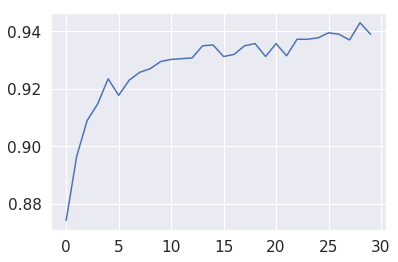

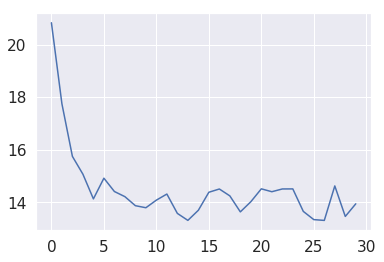

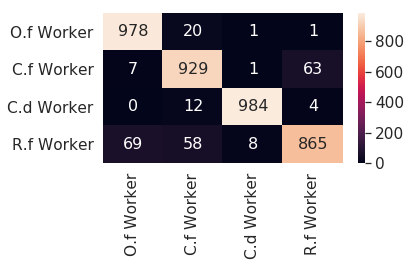

1 1
1 1
1 1
1 1
1 1
3 3
3 3
3 3
0 0
1 1
0 0
0 0
3 3
3 3
1 1
2 2
0 0
2 2
3 3
1 1
1 1
3 3
0 0
1 1
3 3
2 2
2 2
2 2
3 3
0 0
1 1
3 3
1 3
1 1
2 2
1 1
2 2
0 0
3 3
2 2
0 0
3 3
1 1
1 1
0 0
3 3
3 3
2 2
3 1
0 0
2 2
2 2
0 0
0 0
3 3
3 3
3 3
1 1
1 1
2 2
0 0
0 0
3 3
3 3
2 2
3 3
0 0
0 0
3 3
2 2
2 2
0 0
3 0
3 3
1 1
2 2
0 0
3 3
2 2
0 0
2 1
0 0
0 0
0 0
3 1
2 2
1 1
0 0
1 1
0 0
0 0
2 2
1 1
3 3
3 3
3 3
1 1
3 3
2 2
1 1
2 2
0 0
2 2
2 2
3 3
2 2
2 2
3 1
0 0
1 1
3 3
0 0
3 3
0 0
3 3
1 1
2 2
3 3
2 2
0 0
3 3
2 2
2 2
1 1
2 2
3 0
3 3
2 2
1 1
3 3
2 2
3 3
0 0
0 0
0 0
3 3
3 2
2 2
3 3
3 3
1 1
2 2
2 2
2 2
0 0
2 2
3 3
3 3
0 0
2 2
0 0
2 2
1 1
0 0
3 3
1 1
0 0
3 3
0 0
3 3
2 2
1 1
2 2
2 2
1 1
3 0
3 3
3 3
1 1
2 2
3 1
2 2
2 2
1 1
0 0
3 3
0 0
2 2
0 0
0 0
0 0
2 2
0 0
2 2
2 2
2 2
2 2
0 0
3 3
1 1
2 2
0 0
1 1
1 1
3 3
1 1
3 3
3 3
0 0
1 1
1 1
1 1
2 2
0 2
2 2
3 3
0 0
3 3
0 0
0 0
1 3
2 2
1 1
0 0
1 1
0 0
1 3
2 2
3 3
0 0
3 3
2 2
2 2
3 1
3 3
3 3
0 0
2 2
3 3
2 2
2 2
0 0
3 3
3 1
2 2
1 1
2 2
3 3
3 3
2 1
0 0
3 3
0 0
3 3
0 0
1 1
2 2
3 3
1 1
0 0


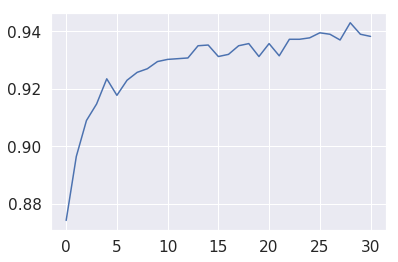

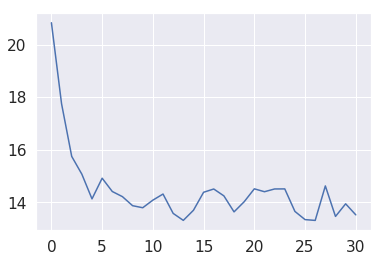

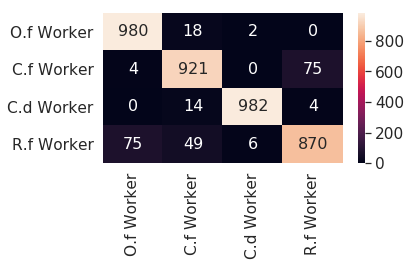

3 3
2 2
2 2
1 1
2 2
1 1
1 1
3 3
1 3
1 1
3 3
0 0
2 2
2 2
0 0
3 3
2 2
1 1
1 3
2 2
2 2
1 1
3 3
0 0
1 3
0 0
2 2
0 0
3 1
3 0
2 2
1 1
0 0
3 3
1 1
2 2
3 0
1 3
1 1
0 0
2 2
0 0
2 2
1 1
3 3
0 0
2 2
1 1
3 3
3 3
0 0
0 0
0 0
0 0
1 1
2 2
1 1
3 3
1 1
0 0
0 0
2 2
2 2
1 1
3 3
0 0
1 1
1 3
2 2
0 0
2 2
3 3
2 2
0 0
1 1
2 1
2 2
3 3
3 3
3 3
1 1
3 3
2 2
2 2
0 0
0 0
1 1
1 1
1 1
2 2
0 0
0 0
1 1
2 2
0 0
3 3
3 3
0 0
0 0
1 1
0 0
3 3
2 2
1 1
3 3
1 1
0 0
2 2
3 3
3 3
0 0
1 1
2 2
3 3
1 1
3 3
2 2
0 0
3 3
2 2
2 2
3 3
2 2
1 1
3 3
0 0
2 2
2 2
2 2
3 3
1 1
0 0
1 1
2 2
3 0
1 1
2 2
2 2
1 1
0 0
2 1
3 3
1 1
0 0
3 3
3 0
2 2
2 2
2 2
1 1
1 1
3 3
1 1
3 3
2 2
1 3
0 0
1 1
0 0
3 0
0 0
0 0
1 1
0 0
0 0
1 1
2 2
3 3
0 0
3 3
2 3
1 1
1 1
2 2
3 3
0 0
2 2
1 1
2 2
3 3
3 1
3 3
2 2
3 3
2 2
3 3
1 1
2 2
0 0
3 3
0 0
2 2
2 2
1 1
0 0
3 3
3 0
1 3
1 1
0 0
0 0
1 1
3 3
0 0
3 3
3 3
0 0
2 2
0 0
1 1
3 3
3 3
0 0
3 1
1 1
3 3
1 1
3 3
2 2
2 2
1 1
0 0
3 3
3 3
0 0
2 2
1 1
0 0
3 3
3 0
3 2
1 1
1 1
2 2
2 2
0 0
2 2
2 2
2 2
3 3
2 2
3 3
1 1
3 3
1 1
1 1
2 2
2 2
1 1
1 1


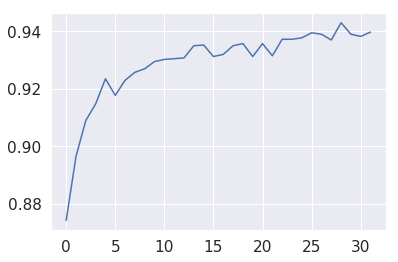

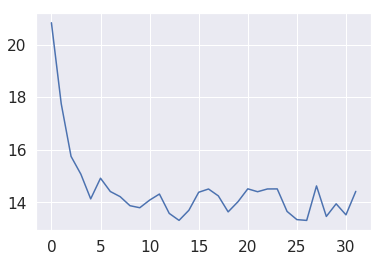

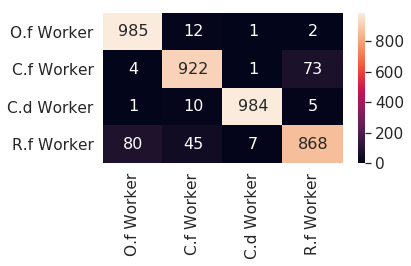

3 3
1 1
0 0
1 3
1 1
0 0
3 3
3 3
1 1
3 3
3 3
1 1
2 2
2 2
1 1
2 2
0 0
0 0
0 0
1 1
3 0
1 1
1 1
3 3
3 3
2 2
1 1
3 3
0 0
3 0
3 3
0 0
0 0
0 0
0 0
3 3
1 1
3 3
1 1
2 2
2 2
1 1
3 0
1 1
2 2
0 0
1 1
1 1
2 2
3 3
1 1
2 2
1 1
2 2
0 0
1 1
3 3
0 0
2 2
1 1
0 0
0 0
3 3
3 2
1 1
1 1
0 0
3 3
3 3
2 2
0 0
3 3
0 0
1 1
3 3
0 0
2 2
1 3
2 2
1 1
3 3
2 2
2 2
2 2
1 1
2 2
3 3
1 1
0 0
1 3
3 3
3 3
3 3
3 3
3 3
1 1
1 1
1 1
0 0
0 0
3 3
3 3
1 1
3 2
2 2
3 3
0 0
1 1
1 1
1 1
3 3
0 0
2 2
3 3
1 1
3 3
0 0
1 1
3 3
0 0
2 2
3 3
0 0
2 2
3 3
2 2
0 0
0 0
3 3
3 3
3 3
1 1
2 2
2 2
3 3
2 2
1 1
2 2
3 1
1 1
3 3
3 1
3 3
3 3
0 0
2 2
2 2
0 0
2 2
1 1
2 2
0 0
0 0
0 0
2 2
1 1
3 3
1 1
3 3
3 3
3 3
0 0
2 2
2 2
1 3
1 1
3 3
3 3
0 0
1 1
3 3
2 2
3 3
3 3
3 3
0 0
0 0
3 3
2 2
0 0
1 1
0 0
3 3
1 1
1 1
0 0
3 3
0 0
0 0
2 2
3 3
2 2
3 3
2 2
1 1
1 1
0 0
0 0
0 0
0 0
0 0
2 2
1 1
3 3
0 0
1 1
2 2
0 0
0 0
2 2
1 1
2 2
2 2
2 2
3 3
0 0
0 0
0 0
0 0
2 2
3 3
3 3
1 1
0 0
1 1
3 3
2 2
3 3
0 0
0 0
2 2
2 2
3 3
2 2
0 0
3 3
0 0
0 1
2 1
1 1
3 1
1 1
3 3
1 1
3 3
1 1
0 0
1 1
2 2
3 3


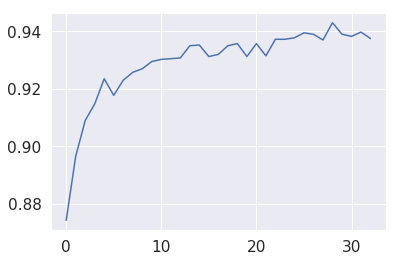

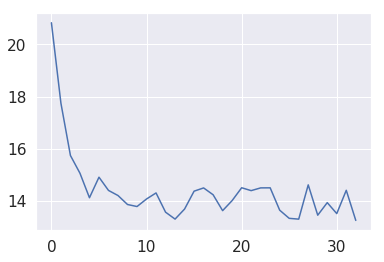

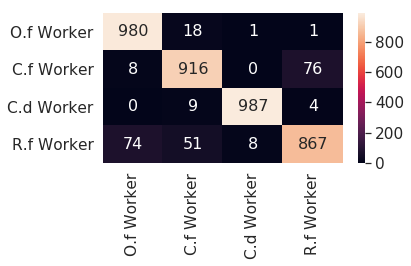

1 3
1 1
1 1
2 2
0 0
1 1
1 1
2 2
1 1
2 2
2 2
0 0
0 0
2 2
2 2
2 2
3 3
2 2
2 2
1 1
2 2
0 0
2 2
2 2
3 3
0 0
2 2
0 0
1 1
2 2
1 1
3 3
2 2
1 1
3 3
1 1
0 0
1 1
0 0
3 3
3 3
1 3
0 0
0 0
3 3
1 1
3 3
0 0
2 2
1 1
0 0
1 3
3 3
1 1
1 1
2 2
2 2
3 3
2 2
3 3
3 3
2 2
1 1
3 3
0 0
3 3
3 3
0 0
1 1
2 2
3 3
1 1
0 0
1 1
3 3
2 2
3 3
0 0
2 2
3 0
3 3
0 0
3 3
2 2
2 2
3 3
2 2
3 0
1 1
1 1
2 2
1 1
1 1
1 1
3 3
3 3
1 1
0 0
0 0
0 0
3 3
0 0
0 0
2 2
1 1
2 2
3 3
2 2
3 3
0 0
0 0
0 0
1 1
3 3
1 1
2 2
2 2
3 3
2 2
2 2
0 0
3 3
3 3
2 2
0 0
1 1
0 0
0 1
2 2
0 0
2 2
1 1
0 0
1 1
1 1
1 1
2 2
2 2
1 1
2 2
2 2
3 3
0 0
3 3
1 1
1 1
1 1
1 1
2 2
1 1
1 1
2 2
3 3
1 1
0 0
2 2
1 1
2 2
2 2
0 0
1 1
0 0
3 3
3 3
1 1
2 2
1 1
3 0
3 3
0 0
1 1
0 0
0 0
1 1
1 1
3 3
3 3
1 1
3 3
2 2
2 2
0 0
1 1
0 0
0 0
0 0
1 1
3 3
0 0
1 1
1 1
1 1
0 0
0 0
2 2
2 2
0 0
2 2
1 1
2 2
0 0
1 1
3 3
1 1
0 0
1 1
1 1
1 1
0 0
3 0
2 2
3 3
2 2
1 1
0 0
0 0
0 0
0 0
2 2
3 3
1 1
3 3
1 1
3 3
2 2
2 2
0 0
0 0
3 3
0 0
3 3
1 3
1 1
3 3
0 0
2 2
1 1
2 2
0 0
0 0
1 1
2 2
1 1
1 1
1 1
0 0
3 3
3 3
1 1
2 2


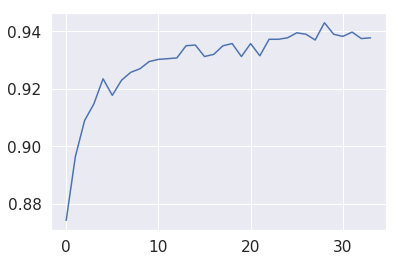

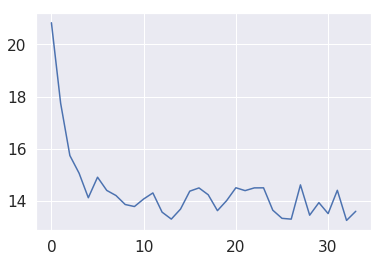

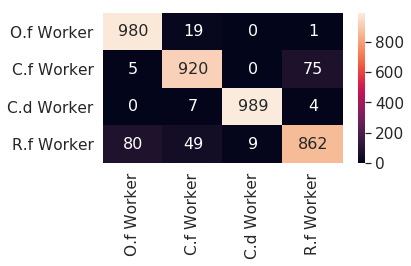

3 3
3 3
2 2
0 0
2 2
3 3
0 0
3 3
3 3
0 0
1 1
0 0
1 1
3 1
1 1
2 2
0 0
0 0
1 3
2 2
1 1
3 3
1 0
3 1
0 0
3 3
1 1
1 1
0 0
0 0
3 1
1 1
3 3
3 3
0 0
1 1
0 0
2 2
0 0
2 2
1 1
3 3
1 1
0 0
3 3
1 1
2 2
2 2
0 0
2 2
3 3
2 2
0 0
3 3
3 3
3 3
1 1
2 2
3 3
0 0
0 0
0 0
1 1
3 3
1 1
2 2
2 2
1 1
2 2
0 0
0 0
0 0
3 3
2 2
1 1
1 1
2 2
2 2
2 2
0 0
2 2
1 1
1 1
0 0
3 3
2 2
2 2
3 3
1 1
2 2
3 3
0 0
1 1
1 1
0 0
0 0
0 0
0 0
3 3
1 1
0 0
3 3
2 2
3 3
2 2
1 1
0 0
2 2
3 3
1 1
1 3
2 2
1 1
0 0
1 1
1 1
0 0
2 2
0 0
0 0
0 0
3 3
3 3
3 3
0 0
0 0
3 3
1 1
0 0
0 0
1 1
2 2
3 3
1 1
2 2
2 2
3 3
2 2
1 1
2 2
2 2
3 3
0 0
2 2
0 0
0 0
0 0
0 0
0 0
3 0
1 1
2 2
2 2
1 1
2 2
3 3
0 0
1 1
3 3
2 2
2 2
0 0
0 0
2 2
1 1
3 3
2 2
3 3
2 2
1 3
3 3
0 0
2 2
1 1
2 2
2 2
3 3
1 1
0 0
0 0
3 3
2 2
3 3
3 3
1 1
1 1
0 0
3 3
0 0
1 1
3 3
3 3
1 3
0 0
3 3
0 0
2 2
2 2
1 1
3 3
3 3
0 0
1 1
1 1
2 2
2 2
0 0
0 0
2 2
3 3
1 1
1 1
3 3
3 3
3 3
1 1
1 1
3 3
2 2
0 0
3 3
2 2
0 0
2 2
3 3
2 2
0 0
0 0
3 3
2 2
0 0
1 1
0 0
2 2
1 1
0 0
0 0
2 2
1 3
1 1
3 3
1 1
2 2
2 2
0 0
2 2
2 2
2 2
1 1
3 3


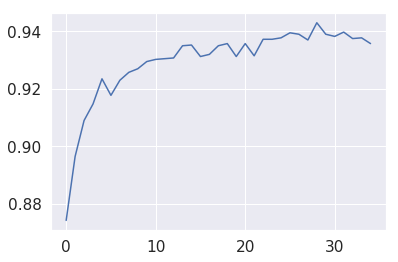

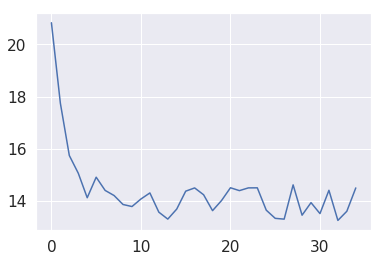

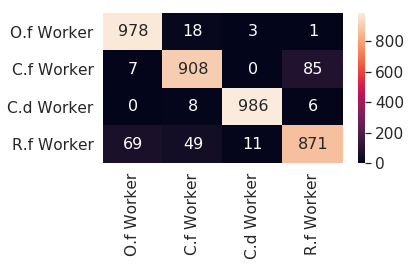

1 1
3 3
1 1
1 1
3 0
3 3
3 3
0 0
3 3
3 3
0 0
1 1
1 1
0 0
2 2
3 0
3 3
0 0
1 1
3 3
3 2
3 3
1 1
0 0
1 1
3 0
2 2
3 3
1 1
2 2
2 2
0 0
2 2
3 3
1 3
1 1
2 2
3 3
1 1
3 3
3 3
0 0
2 2
0 0
2 2
2 2
1 1
0 0
1 3
3 3
1 1
3 3
3 1
0 0
2 2
3 3
1 1
2 2
0 0
0 0
0 0
1 3
3 3
2 2
2 2
3 3
1 1
2 2
0 0
1 1
1 1
0 0
1 1
3 3
2 2
2 2
0 0
2 2
2 2
0 0
1 1
1 1
2 2
1 1
0 0
2 2
3 3
0 0
2 2
0 0
2 2
3 3
2 2
2 2
3 3
1 1
3 1
1 1
2 2
1 1
2 2
1 1
3 3
1 1
1 3
0 0
2 2
0 0
2 2
1 1
2 2
1 1
3 0
3 3
3 3
2 2
3 3
2 2
2 2
3 3
0 0
2 2
3 3
0 0
2 2
1 1
1 1
3 3
3 3
3 3
0 0
0 0
0 1
3 3
1 1
2 2
0 0
3 3
0 0
0 0
3 3
0 1
0 0
0 0
3 3
2 2
3 3
3 3
1 1
2 2
1 1
3 3
1 1
0 0
1 1
0 0
2 2
2 2
2 2
0 0
0 0
2 2
3 3
3 3
1 1
0 0
2 2
3 3
1 3
3 3
1 1
2 2
3 3
1 1
2 2
0 0
0 0
2 2
2 2
2 2
1 1
3 0
3 3
3 3
0 0
2 1
3 3
1 1
3 3
1 1
2 2
2 2
0 0
0 0
3 3
1 3
1 1
0 0
2 2
1 3
1 1
0 0
0 0
2 2
1 1
1 1
3 3
2 2
1 0
2 2
1 3
2 2
1 1
1 1
2 2
1 3
2 2
2 2
1 1
1 1
3 3
2 2
2 2
2 2
3 3
0 0
2 2
2 2
3 3
2 2
0 0
0 0
3 3
2 2
0 0
1 1
2 2
3 3
1 1
3 1
3 3
2 2
2 2
0 0
2 2
2 2
0 0
2 2
1 1
2 2


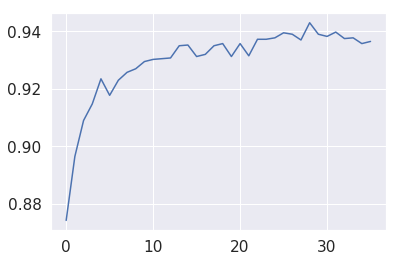

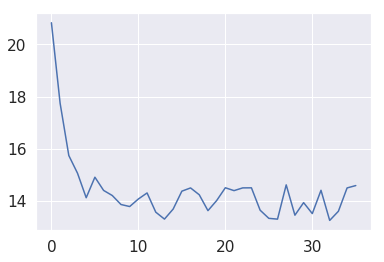

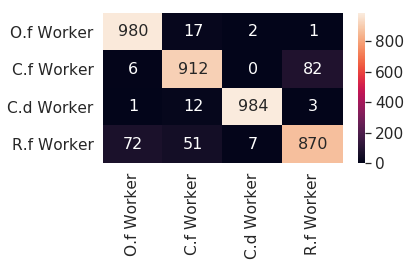

0 0
1 1
2 2
1 1
2 2
0 0
3 3
1 1
2 2
0 0
2 2
0 0
0 0
0 0
2 2
2 2
2 2
2 2
3 3
2 2
0 0
3 3
3 0
3 3
3 3
2 2
3 3
0 0
2 2
0 0
1 1
2 2
0 0
3 3
3 3
0 0
1 1
2 2
1 1
3 1
2 2
2 2
0 0
1 1
2 2
0 0
3 3
2 2
1 3
1 1
0 0
1 1
3 3
1 1
0 0
3 3
2 2
2 2
0 1
3 0
1 1
0 0
3 3
3 3
2 2
0 0
1 1
0 0
1 1
2 2
2 2
0 0
2 2
2 2
2 2
1 1
3 3
2 2
1 1
0 0
3 3
2 2
3 3
3 3
2 2
2 2
1 1
3 3
3 3
1 1
3 3
3 3
1 1
1 1
0 0
1 1
2 2
2 2
3 3
2 2
1 1
1 1
1 1
0 0
3 3
0 0
1 1
0 0
1 1
0 0
1 1
3 3
2 2
2 2
0 0
1 1
1 1
2 2
0 0
0 0
0 0
3 3
3 3
2 2
2 2
0 0
2 2
3 3
3 1
1 1
1 1
3 0
0 0
3 3
3 3
1 1
2 2
1 1
3 0
3 3
3 3
2 2
3 3
2 2
0 0
3 3
0 0
0 0
2 2
3 0
0 0
3 3
3 0
3 3
1 1
3 3
1 3
3 3
2 2
1 1
1 1
3 3
2 2
3 3
3 0
1 1
2 2
2 2
3 3
1 1
1 1
2 2
1 1
3 3
3 3
1 1
1 1
3 3
0 0
3 3
1 1
2 2
3 3
2 2
0 0
3 3
1 1
3 3
1 1
1 1
1 1
2 2
0 0
0 0
2 2
1 1
0 0
3 3
1 1
2 2
1 1
2 2
1 1
1 1
2 2
0 0
0 0
0 0
2 2
2 2
1 1
3 3
2 2
2 2
1 1
1 1
1 1
0 0
1 1
2 2
1 1
2 2
3 3
2 2
0 0
1 1
3 3
1 1
1 1
1 1
1 1
0 0
1 1
1 1
2 2
0 0
1 1
0 0
3 3
3 3
2 2
3 3
1 1
1 1
3 3
0 0
0 0
0 0
0 0
1 3


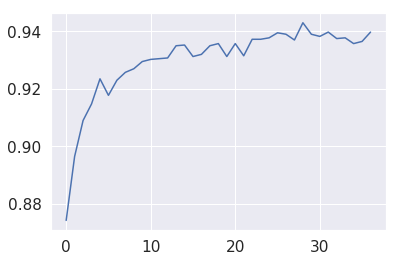

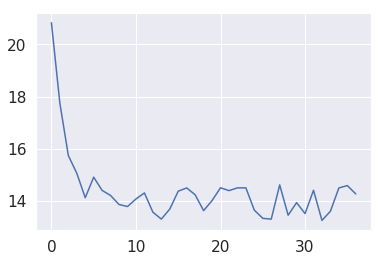

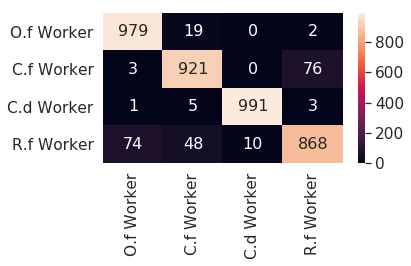

3 3
1 1
2 2
2 2
3 3
0 0
2 2
0 0
3 3
0 0
2 2
0 0
0 0
1 1
2 2
3 3
3 0
2 2
0 0
3 0
0 0
1 1
2 2
2 2
2 2
2 2
2 2
1 1
2 2
3 3
1 1
0 0
0 0
3 3
3 3
1 1
1 1
1 1
3 3
0 0
0 0
3 3
0 0
2 2
0 0
1 1
0 0
0 0
0 0
3 3
3 3
3 3
1 1
0 0
2 2
1 3
1 1
1 1
3 3
1 1
3 3
2 2
2 2
1 1
0 0
2 2
0 0
2 2
2 2
3 3
3 3
2 2
1 1
1 1
0 0
2 2
1 1
2 2
0 0
3 3
3 3
1 1
0 0
1 1
0 0
3 3
0 0
3 3
2 2
2 2
0 1
1 1
0 0
2 2
3 3
1 1
2 2
3 3
1 1
0 0
2 2
2 2
2 2
2 2
2 2
2 2
1 3
0 0
2 2
0 0
2 2
3 3
3 0
3 0
0 0
2 2
0 1
1 1
3 3
3 3
3 3
2 2
0 0
1 1
0 0
3 3
0 0
0 0
3 3
3 3
0 0
1 1
3 3
3 3
2 2
1 3
2 2
2 2
2 2
0 0
1 3
0 0
1 1
0 0
1 1
3 3
1 1
0 0
2 2
3 0
0 0
1 1
0 0
2 2
3 3
1 3
2 2
0 0
1 1
2 2
0 0
0 0
0 0
2 2
3 3
3 3
3 3
2 2
0 0
1 1
1 1
0 0
1 1
1 1
2 2
3 3
1 1
2 2
0 0
3 3
1 1
1 1
3 3
2 2
1 1
1 1
3 3
1 1
2 2
2 2
0 0
2 2
0 0
1 1
0 0
0 0
3 3
0 0
1 1
0 0
1 1
3 3
3 3
3 3
1 1
2 2
0 0
1 1
1 1
3 3
0 0
2 2
0 0
1 1
2 2
3 3
2 2
1 3
3 3
1 1
1 3
2 2
2 2
1 1
2 2
1 1
1 1
3 3
0 0
3 3
2 2
3 3
2 2
1 1
2 2
0 0
2 2
3 3
1 1
2 2
2 2
2 2
0 0
2 2
0 0
0 0
2 2
1 3
1 1
3 3


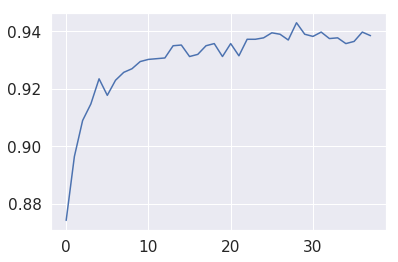

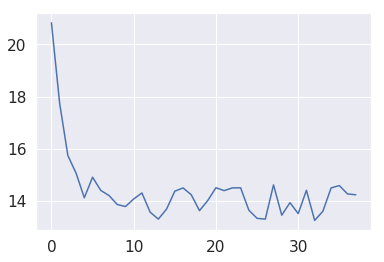

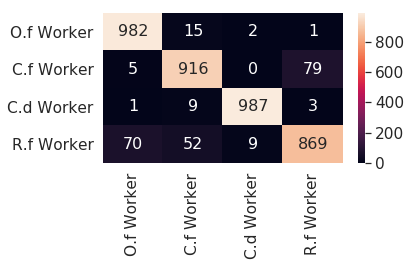

0 0
0 0
0 0
3 3
1 1
2 2
0 0
0 0
0 0
3 0
2 2
0 0
3 3
1 1
2 2
1 3
0 0
3 3
2 2
3 3
0 0
3 3
1 1
2 2
0 0
0 0
3 3
0 0
2 2
1 1
0 0
2 2
2 2
0 0
2 2
1 1
3 3
0 0
1 1
1 1
0 0
3 3
2 2
1 1
3 3
0 0
1 1
2 2
2 2
3 3
2 2
0 0
0 0
0 0
0 1
0 0
1 1
1 1
1 1
3 3
3 3
1 1
2 2
1 1
0 0
3 3
1 1
3 3
1 1
1 1
1 1
2 2
1 3
1 1
0 0
1 1
0 0
3 3
2 2
1 1
3 3
0 0
0 0
0 0
0 0
1 1
0 0
0 0
3 3
3 0
3 3
1 3
2 2
1 1
2 2
2 2
3 3
2 2
0 0
3 3
2 2
3 3
2 2
3 0
1 3
1 1
2 2
2 2
0 0
1 1
0 0
2 2
1 1
1 1
1 1
3 3
1 3
0 0
1 1
2 2
1 1
2 2
1 1
2 2
3 3
3 3
3 3
1 1
3 3
0 0
0 0
1 1
3 3
3 0
2 2
1 1
2 2
0 0
3 1
3 3
3 3
0 0
1 1
0 0
1 1
0 0
0 0
3 3
3 3
2 2
1 1
0 0
2 2
0 0
3 3
1 1
3 3
2 2
3 3
1 1
0 0
3 3
2 2
3 3
3 3
2 2
1 1
0 0
3 3
3 3
3 3
2 2
0 0
3 3
0 0
2 2
2 2
2 2
1 1
2 2
2 2
2 2
3 3
0 0
0 0
0 0
3 3
3 1
1 1
3 3
2 2
3 3
1 1
3 1
1 1
1 1
0 0
0 0
0 0
0 0
3 3
0 0
1 1
1 1
3 3
2 2
0 0
3 3
2 2
2 2
2 2
3 3
0 0
3 3
1 1
2 2
2 2
0 0
1 1
0 0
3 3
1 1
0 0
1 3
1 1
3 3
0 0
3 1
2 2
2 2
2 2
1 1
0 0
3 3
3 3
1 1
0 0
2 2
3 3
2 2
2 2
1 1
1 1
2 2
3 3
2 2
2 2
1 1
0 0
2 2


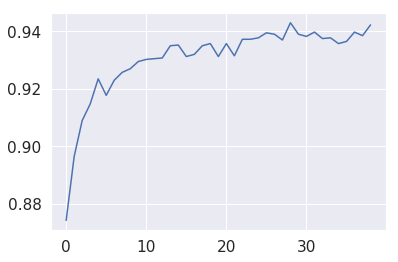

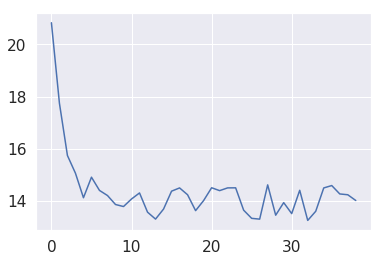

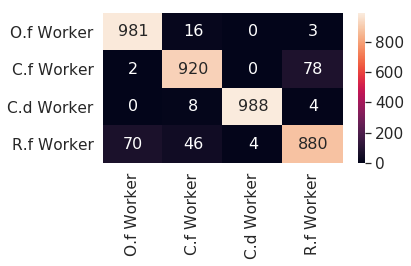

0 0
2 2
0 0
2 2
0 0
2 2
3 3
1 1
3 3
0 0
3 3
0 0
3 3
1 1
3 3
2 2
1 1
3 3
1 1
2 2
2 1
2 2
0 0
0 0
3 3
1 1
2 2
2 2
1 1
3 3
2 2
2 2
1 1
1 1
3 3
3 3
0 0
0 0
2 2
3 3
3 3
1 1
2 2
1 1
2 2
2 2
3 3
2 2
1 1
0 0
2 2
2 2
1 1
2 2
3 3
0 0
1 1
3 3
1 1
1 1
0 0
2 2
2 2
0 0
1 1
0 0
0 0
0 0
3 3
2 2
0 0
0 0
3 3
3 3
0 0
2 2
1 1
2 2
1 1
1 1
0 0
2 2
1 1
3 3
2 2
3 3
3 0
2 2
1 1
3 3
3 3
0 0
0 0
1 1
0 0
0 0
1 1
3 3
1 1
0 0
2 2
1 1
2 2
2 2
1 1
1 1
2 2
0 0
3 3
1 1
1 1
0 0
2 2
3 3
2 2
0 0
0 0
0 0
2 2
0 0
3 3
0 0
2 2
0 0
2 2
1 1
0 1
3 3
1 1
1 1
2 2
0 0
1 1
0 0
0 0
3 3
3 3
0 0
0 0
0 0
3 3
0 0
1 1
1 1
3 3
3 3
2 2
0 0
2 2
1 1
2 2
1 1
2 2
2 2
3 3
3 3
1 1
2 2
1 1
2 2
0 0
1 1
3 3
2 2
2 2
3 3
3 3
3 3
1 1
2 2
1 3
3 3
1 1
1 1
1 1
1 1
1 1
3 0
2 2
3 3
1 3
1 1
1 1
1 1
0 0
3 0
3 3
0 0
1 1
2 2
3 3
0 0
0 0
2 2
0 0
3 3
2 2
0 0
1 3
3 3
1 1
2 2
1 1
2 2
0 0
0 0
0 0
2 2
3 3
3 3
0 0
1 1
1 3
3 3
2 2
1 1
0 0
2 2
1 1
2 2
2 2
3 3
2 2
1 1
2 2
2 2
3 3
2 2
0 0
1 1
2 2
0 0
3 3
0 0
0 1
0 0
3 3
3 3
1 1
2 2
3 3
1 1
3 1
0 0
2 2
2 2
2 2
2 2
3 3
1 3


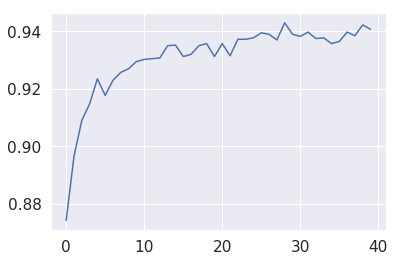

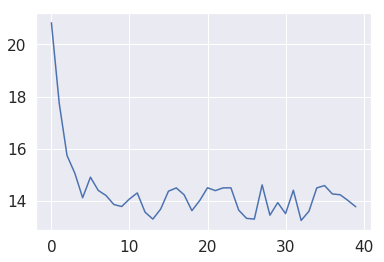

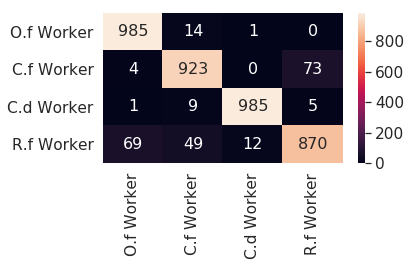

3 3
2 2
3 3
3 3
2 2
1 1
1 1
1 1
1 1
3 0
0 0
1 1
2 2
0 0
3 3
2 2
2 2
2 2
0 0
1 1
0 0
0 0
1 1
2 2
1 1
3 3
3 3
1 1
2 2
2 2
2 2
1 1
2 2
2 2
0 0
2 2
0 0
2 2
3 3
0 0
0 0
3 3
2 2
2 2
2 2
0 0
1 1
2 2
3 1
1 1
3 3
1 1
1 1
1 1
3 3
1 1
3 3
2 2
3 3
2 2
1 1
3 0
2 2
0 0
0 0
0 0
2 1
2 2
0 0
1 1
1 3
3 3
1 1
3 3
1 1
0 0
1 3
3 3
0 0
1 1
3 1
0 0
0 0
3 3
1 3
1 1
1 1
2 2
0 0
3 3
2 2
1 3
0 0
3 0
3 3
1 1
0 0
1 1
3 3
2 2
1 1
1 1
1 1
1 1
3 3
0 0
0 0
1 1
0 0
0 0
0 0
2 2
1 1
2 2
1 1
2 2
0 0
3 3
0 0
0 0
0 0
3 3
0 0
0 0
2 2
3 3
2 2
2 2
0 0
2 2
2 2
2 2
2 2
2 2
1 1
0 1
3 3
1 1
1 1
1 1
3 3
2 2
2 2
0 0
0 0
0 0
2 2
1 3
0 0
3 3
0 0
3 3
2 2
3 3
2 2
2 2
2 2
0 0
2 2
3 3
3 3
0 0
2 2
1 1
1 1
1 1
1 1
1 1
0 0
1 1
0 0
3 3
3 3
1 1
0 0
3 3
2 2
3 3
2 2
1 1
0 0
0 0
1 1
2 2
1 1
3 1
0 0
0 0
0 0
0 0
1 1
1 1
2 2
2 2
1 1
1 1
3 3
3 3
0 0
2 2
1 1
1 1
2 2
3 3
0 0
0 0
3 3
1 1
3 3
0 0
1 1
1 1
1 1
0 0
3 3
2 2
2 2
2 2
0 0
3 3
2 2
1 1
2 2
2 2
3 3
1 1
3 3
0 0
0 0
0 0
1 1
2 2
3 3
1 1
3 3
3 3
3 3
0 0
3 3
3 3
0 0
3 3
0 0
1 1
2 2
0 0
0 0
3 3
1 1
0 0


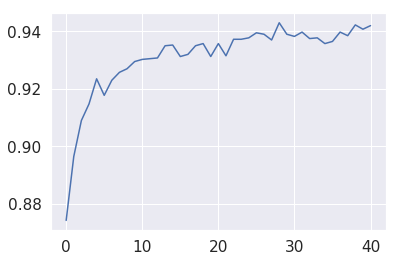

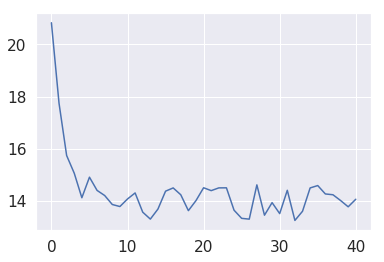

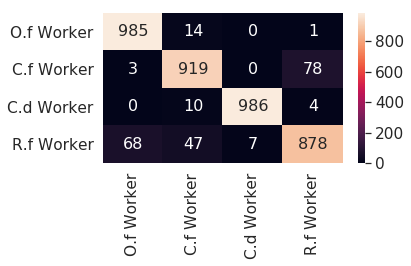

2 2
0 0
3 3
3 3
0 0
1 3
3 3
3 3
2 2
2 2
2 2
1 1
0 0
1 1
2 2
0 0
2 2
3 3
3 3
0 0
2 2
1 1
2 2
2 1
1 1
2 2
3 0
2 2
1 1
3 3
3 3
2 2
2 2
0 0
3 3
2 2
1 1
0 0
1 1
2 2
2 1
2 2
0 0
2 2
2 2
0 0
2 2
0 0
0 0
0 0
2 2
1 1
2 2
2 2
1 1
2 2
0 0
0 0
1 1
3 3
2 2
1 1
3 3
2 2
2 2
2 2
0 0
3 3
3 3
3 3
3 3
2 2
3 3
3 3
2 2
1 1
0 0
1 1
2 2
1 1
0 0
3 3
0 0
3 3
0 0
0 0
1 1
2 2
2 2
0 0
3 3
0 0
3 3
1 1
1 1
2 2
3 3
3 3
0 0
0 0
0 0
3 3
3 3
0 0
0 0
0 0
2 2
2 2
3 3
1 1
0 0
1 3
2 2
2 2
2 2
2 2
3 1
1 1
1 1
0 0
2 2
0 0
1 1
2 2
3 3
2 2
1 1
2 2
1 1
2 2
2 2
1 1
3 3
1 1
3 3
3 3
1 1
2 2
2 2
3 0
0 0
0 0
2 2
3 0
2 2
0 0
1 1
1 1
1 1
3 3
3 3
3 3
0 0
3 3
1 1
3 3
0 0
1 1
2 2
2 2
3 3
1 1
2 2
2 2
0 0
0 0
2 2
3 3
2 2
1 1
2 2
3 3
1 1
1 1
2 2
1 1
1 1
1 3
0 0
2 2
3 3
2 2
3 3
3 3
2 2
0 0
2 2
1 1
3 3
3 3
1 1
3 3
0 0
0 0
2 2
0 0
2 2
3 3
1 1
2 2
0 0
1 3
0 0
3 3
1 1
0 0
2 2
0 0
1 1
1 3
1 1
1 3
2 2
0 0
3 3
1 1
3 3
1 1
2 2
2 2
0 0
2 2
0 0
1 1
0 0
1 1
2 2
3 3
3 3
2 2
2 2
2 2
2 2
0 0
0 0
3 0
3 3
2 2
1 1
3 3
2 2
0 0
3 3
3 3
0 0
3 1
2 2
1 1
0 0
2 2


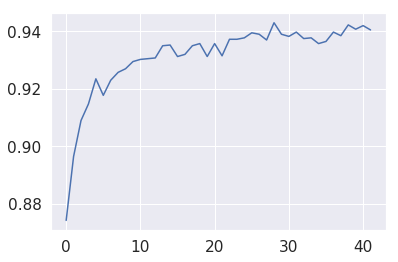

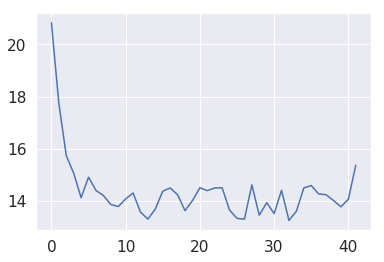

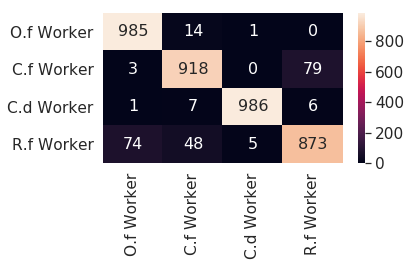

3 3
1 1
3 3
0 0
2 2
2 2
1 1
0 0
3 3
3 0
0 0
0 0
1 1
1 1
0 0
1 1
1 1
1 1
2 2
1 1
0 0
2 2
1 1
1 1
0 0
2 2
2 2
1 1
3 3
1 1
3 3
0 0
1 1
0 0
0 0
3 3
3 3
1 1
2 2
3 0
2 2
2 2
1 1
3 3
3 3
1 1
0 0
3 3
0 0
2 2
1 1
1 1
1 3
3 3
1 1
0 0
1 1
1 1
3 3
2 2
2 2
0 0
1 1
1 1
1 1
2 2
1 1
1 1
3 3
0 0
3 3
2 2
1 1
3 3
1 1
2 2
3 3
0 0
2 2
0 0
2 2
2 2
1 0
1 1
3 3
2 2
0 0
3 3
2 2
2 2
2 2
1 1
3 3
2 2
2 2
3 3
3 3
0 0
2 2
0 0
2 2
2 2
0 0
0 0
3 3
2 2
2 2
1 1
2 2
1 1
2 2
3 3
1 1
0 0
3 3
3 3
1 1
3 0
3 3
0 0
1 1
1 1
0 0
0 0
3 3
1 1
1 1
1 1
2 2
0 0
3 3
1 1
2 2
3 3
1 1
1 1
2 2
1 1
1 1
2 2
1 1
2 2
1 1
0 0
3 3
3 3
2 2
1 1
0 0
2 2
0 0
3 3
0 0
3 3
3 0
3 3
0 0
3 3
0 0
2 2
0 0
2 2
0 0
0 0
0 0
3 3
0 0
3 3
1 1
0 0
1 1
0 0
0 0
2 2
1 1
1 1
1 1
0 0
3 3
2 2
1 1
3 3
0 0
3 3
0 0
2 2
2 2
2 2
2 2
0 0
2 2
2 2
2 2
2 2
1 1
2 2
1 1
3 3
0 0
1 1
0 0
2 2
0 0
3 3
0 0
1 1
3 0
0 0
3 3
0 0
3 3
1 1
3 3
1 1
3 3
3 3
0 0
1 1
1 3
2 2
2 2
1 1
2 2
3 3
0 0
3 3
2 2
2 2
3 3
1 1
3 1
3 3
0 0
2 2
1 1
0 0
2 2
2 2
1 3
0 0
3 3
0 0
0 0
3 3
1 1
2 2
0 0
1 1
1 1
3 3


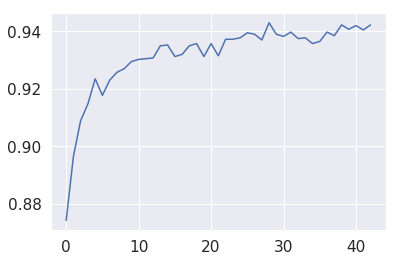

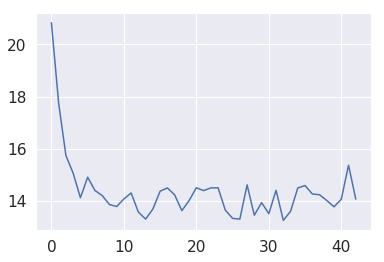

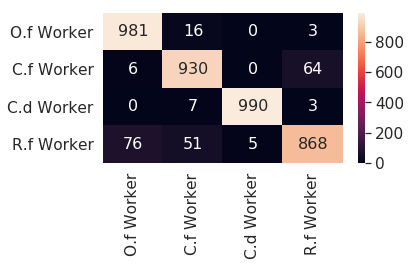

1 3
3 3
0 0
3 1
1 1
3 3
0 0
0 0
2 2
0 0
2 2
2 2
0 0
3 3
2 2
1 1
3 3
1 1
0 0
3 0
3 3
1 1
2 2
3 3
3 3
2 2
2 2
2 2
3 3
3 3
3 3
1 1
2 2
3 3
2 2
0 0
1 1
2 2
3 3
1 1
3 3
3 3
2 2
3 3
0 0
0 0
1 1
2 2
2 2
2 2
3 3
0 0
0 0
3 3
3 3
2 2
1 1
0 0
1 1
1 1
0 0
0 0
1 1
2 2
0 0
1 1
2 2
0 0
1 1
2 2
3 3
3 3
1 1
0 0
2 2
2 2
0 0
2 2
3 3
0 1
3 2
1 1
2 2
0 0
3 3
3 3
0 0
3 3
2 2
1 1
3 3
1 3
0 0
3 3
0 0
1 1
3 3
1 1
3 3
2 2
0 0
0 0
0 0
0 0
0 0
1 1
1 1
3 3
0 0
3 3
0 0
2 2
0 0
3 3
0 0
1 1
3 3
0 0
0 0
0 0
0 0
2 2
2 2
0 0
0 0
1 3
2 2
2 2
2 2
2 2
2 2
3 3
2 2
3 3
3 3
0 0
0 0
0 0
2 2
1 1
0 0
2 2
1 1
0 0
3 3
2 2
2 2
3 3
0 0
1 1
1 1
0 0
2 2
3 3
3 3
2 2
3 3
2 2
3 3
0 0
0 0
2 2
0 0
3 3
0 0
0 0
0 0
2 2
0 0
3 3
2 2
3 3
3 3
3 3
0 0
0 0
1 1
2 2
1 1
1 1
3 3
2 2
0 0
2 2
0 0
2 2
3 3
3 1
3 3
3 3
2 2
2 2
0 0
0 0
3 3
1 1
3 3
2 2
3 0
1 3
1 1
3 3
1 1
2 2
2 2
2 2
1 1
3 1
3 3
1 1
2 2
0 0
2 2
3 3
1 1
2 2
2 2
1 1
0 0
3 3
0 0
1 1
2 2
2 2
0 0
1 1
3 3
1 1
2 2
1 1
3 3
0 0
2 2
1 1
3 3
1 1
0 0
1 1
2 2
0 0
0 0
1 1
0 0
3 3
3 3
2 2
0 0
3 3
1 1
3 3


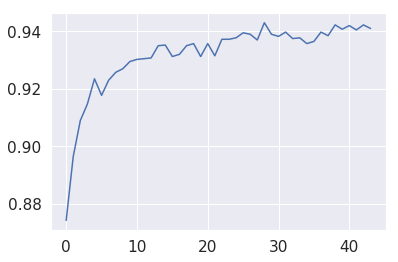

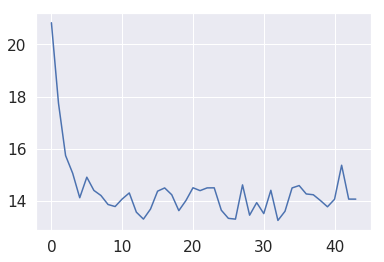

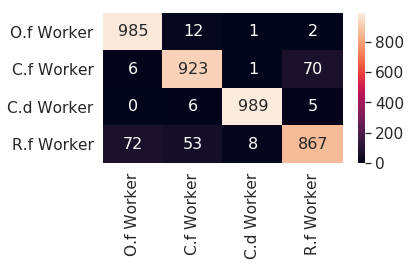

3 3
1 1
2 2
0 0
1 1
0 0
1 1
3 3
1 1
0 0
2 2
1 1
3 3
3 1
0 0
2 2
0 0
2 2
2 2
1 1
1 1
3 3
2 2
3 3
2 2
1 1
2 2
1 1
2 2
2 2
2 2
2 2
0 0
0 0
2 2
2 2
1 1
2 2
0 0
3 0
3 3
0 0
0 0
1 1
3 3
2 2
0 0
2 2
3 3
0 0
1 1
1 1
1 1
1 1
0 0
3 3
0 0
2 2
2 2
3 3
2 2
1 1
3 3
1 1
2 2
2 2
3 1
0 0
0 0
3 3
2 2
1 1
0 0
3 3
2 2
2 2
2 2
2 2
1 1
0 0
3 3
3 3
1 1
2 2
3 3
0 0
3 3
1 1
0 0
3 3
3 3
3 3
3 3
0 0
2 2
3 3
0 0
1 1
0 0
0 0
1 1
3 3
1 1
2 2
2 2
0 0
1 1
3 3
3 3
0 0
0 0
2 2
1 1
1 1
0 0
2 2
2 3
0 0
0 0
1 1
2 2
3 3
0 0
1 1
0 0
2 2
0 0
3 3
1 1
3 3
3 3
1 1
0 0
3 3
1 3
2 2
3 3
2 2
0 0
1 1
3 3
3 3
1 1
1 1
2 2
2 2
2 2
2 2
3 3
2 2
2 2
0 0
0 0
2 2
1 3
3 3
2 2
3 3
2 2
1 1
3 3
1 1
3 3
3 3
3 3
0 0
1 1
3 3
0 0
2 2
0 0
2 2
0 0
1 1
1 1
1 1
0 0
3 3
1 1
1 1
0 0
0 0
1 1
2 2
3 3
2 2
0 0
2 2
2 2
0 0
1 1
1 3
1 1
1 1
2 2
1 1
2 2
2 2
2 2
3 3
1 1
2 2
0 0
2 2
0 0
3 3
1 1
0 0
3 3
2 2
1 1
0 0
1 1
3 3
1 1
1 1
1 3
3 3
2 2
0 0
2 2
3 3
0 0
1 0
0 0
1 1
3 3
0 0
3 3
3 3
2 2
3 3
3 3
0 0
2 2
2 2
1 1
1 1
3 3
3 3
3 3
2 2
0 0
0 0
1 1
1 1
3 3
3 3
3 3
0 0


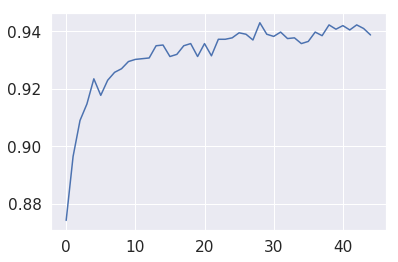

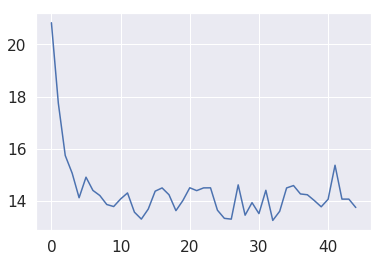

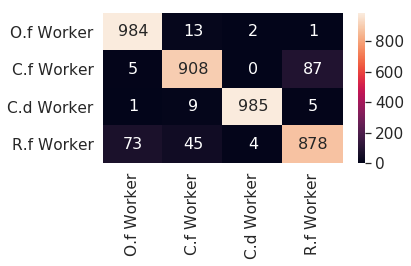

1 3
2 2
2 2
2 1
3 3
2 2
3 3
0 0
2 2
2 2
3 3
0 0
0 0
2 2
1 1
3 3
1 3
2 2
0 0
0 0
3 3
3 3
0 0
1 1
3 3
2 2
3 3
3 1
1 1
2 2
2 2
0 0
2 2
0 0
1 1
0 0
0 0
0 1
2 2
1 1
2 2
3 3
0 0
1 1
2 2
0 0
1 1
1 3
2 1
3 3
3 3
2 2
1 1
2 2
3 3
3 3
0 0
2 2
2 2
0 0
3 3
3 3
0 0
1 1
2 2
2 2
0 0
3 3
2 2
1 1
3 3
0 0
3 3
1 3
1 1
1 1
3 3
1 1
3 3
0 0
3 3
3 3
1 1
0 0
3 3
0 1
3 3
2 2
3 3
3 3
1 1
0 0
2 2
0 0
0 0
0 0
1 1
3 3
0 0
2 2
2 2
3 3
1 1
2 2
0 0
1 1
1 1
1 1
2 2
3 3
1 1
3 3
0 0
3 3
2 2
2 2
2 2
0 0
2 2
2 2
0 0
1 1
0 0
3 3
3 3
3 3
3 3
1 1
2 2
2 2
2 2
2 2
0 0
1 1
0 0
3 3
1 1
3 3
1 1
0 0
1 1
3 3
3 3
0 0
3 3
2 2
1 1
3 3
3 3
2 2
2 2
1 1
0 0
0 0
3 3
3 1
3 3
0 0
1 1
1 1
1 1
2 2
0 0
0 0
3 3
2 2
0 0
1 1
2 2
0 0
0 0
2 2
3 3
3 3
2 2
3 0
0 0
2 2
3 3
0 0
3 3
0 0
3 3
0 0
3 3
3 3
3 3
0 0
0 0
3 3
0 0
1 1
1 1
0 0
1 3
1 1
2 2
2 2
2 2
0 0
3 3
3 0
0 0
2 2
1 1
3 3
0 0
0 0
1 1
1 1
2 2
1 1
1 1
1 1
2 2
2 2
2 2
2 2
2 2
3 3
3 3
1 1
2 2
1 1
3 3
2 2
3 3
0 0
2 2
0 0
0 0
2 2
3 3
0 0
0 0
3 3
0 0
3 1
1 1
3 3
1 1
3 3
0 0
3 3
1 1
3 3
1 1
2 2
3 3
3 3


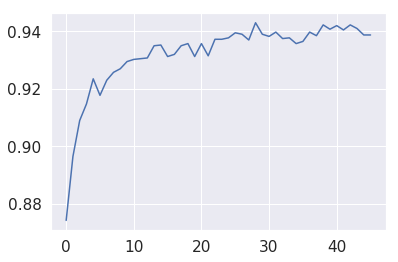

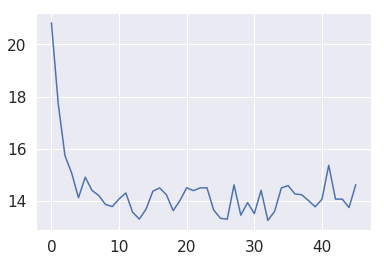

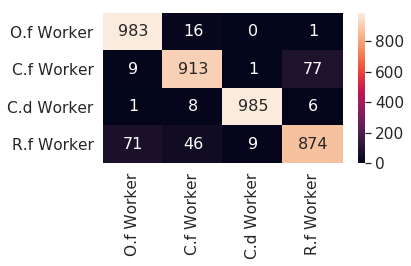

2 2
1 1
0 0
3 3
2 2
1 1
1 1
2 2
2 2
3 3
3 3
3 3
0 0
1 1
3 3
2 2
0 0
0 0
2 2
0 0
1 1
1 1
3 3
3 3
0 0
1 1
3 3
3 3
0 0
1 1
3 3
0 0
0 0
2 2
2 2
2 2
0 0
2 2
3 3
0 0
1 1
1 1
3 3
2 2
1 1
2 2
1 1
2 2
2 2
3 3
1 1
2 2
2 2
0 0
1 1
1 1
2 2
2 2
0 0
0 0
1 1
1 1
0 0
3 3
0 0
1 1
3 2
1 1
0 0
3 0
0 0
1 1
3 3
1 1
0 0
2 2
1 1
2 2
2 2
3 3
2 2
3 3
1 1
2 2
3 3
0 0
3 3
0 0
1 1
2 2
1 1
1 1
3 3
0 0
1 1
3 3
1 1
2 2
3 3
0 0
3 3
3 3
2 2
3 3
2 2
1 1
2 2
3 3
3 3
3 3
3 3
1 1
2 2
1 1
0 0
3 3
1 1
3 3
3 3
3 3
0 0
3 1
1 1
0 0
0 0
0 0
1 1
2 2
0 0
1 3
2 2
3 0
3 3
1 1
1 3
0 0
2 2
0 0
0 0
0 0
3 3
0 0
1 1
3 3
1 1
3 3
0 0
1 1
1 1
2 2
1 1
3 3
1 1
1 1
2 2
2 2
2 2
3 3
0 0
3 3
3 3
2 2
2 2
3 3
2 2
2 2
1 1
3 3
0 0
1 1
3 0
0 0
0 0
2 2
2 2
3 3
1 1
0 0
3 3
3 3
1 1
1 1
3 3
1 1
0 0
1 1
1 1
3 3
3 1
1 1
2 2
0 0
0 0
0 0
1 1
3 3
1 3
2 2
1 3
2 2
0 0
1 1
1 3
1 1
1 3
2 2
0 0
2 2
2 2
2 2
1 1
3 0
0 0
2 2
2 2
3 3
3 3
1 3
0 0
3 3
2 2
1 3
0 0
0 0
0 0
1 1
1 1
0 0
3 3
1 1
2 2
0 0
2 2
0 0
2 2
0 0
3 3
1 1
3 1
1 1
1 1
0 0
1 3
1 1
3 3
0 0
1 1
3 3
1 1
3 2


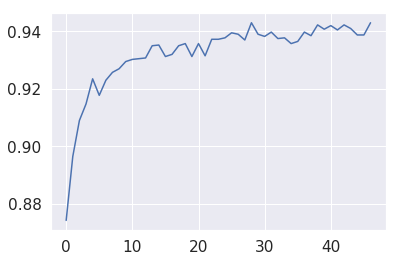

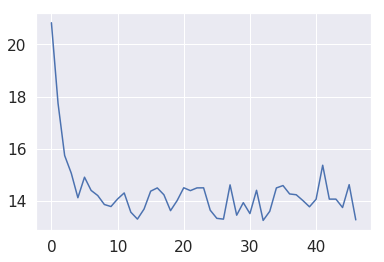

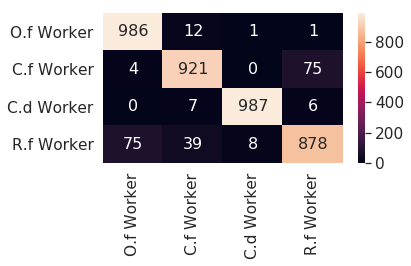

3 3
1 1
1 1
0 0
1 1
3 3
1 1
1 1
3 3
0 0
1 1
1 3
3 3
0 0
1 1
1 1
0 0
0 0
0 0
1 1
2 2
0 0
0 0
2 2
3 3
1 1
1 1
3 3
3 0
0 0
3 3
2 2
2 2
2 2
0 0
1 1
2 2
0 0
3 3
0 0
0 0
2 2
1 1
3 3
2 2
1 3
1 1
0 0
1 1
0 0
1 1
3 3
1 1
3 3
3 3
1 1
1 1
0 0
0 0
2 2
2 2
2 2
3 3
3 3
0 0
0 0
1 1
3 3
0 0
1 1
1 1
1 1
0 0
0 0
2 2
0 0
2 2
1 3
1 1
1 1
2 2
3 0
0 0
2 2
2 2
1 1
1 1
2 2
1 1
3 3
0 0
2 2
0 0
2 2
1 1
0 0
1 1
2 2
3 3
2 2
2 2
3 1
2 1
0 0
1 1
3 3
2 2
1 3
3 3
0 0
3 3
1 1
1 1
0 0
3 3
0 0
3 3
1 1
2 2
0 0
2 2
0 0
0 0
1 3
0 0
1 1
1 1
2 2
0 0
0 0
3 3
2 2
3 3
3 3
1 1
3 3
3 3
0 0
3 3
1 3
0 0
0 0
0 0
1 1
1 1
0 0
3 3
1 1
1 1
2 2
2 2
3 3
0 0
3 3
0 0
3 0
0 0
3 3
3 3
1 3
3 3
2 2
0 0
2 2
1 1
2 2
2 2
3 3
0 0
1 1
1 1
2 2
2 2
2 2
0 2
0 0
0 0
3 3
0 0
1 1
1 1
2 2
2 2
2 2
3 3
2 2
2 2
3 3
3 3
3 3
3 3
0 0
2 2
3 3
3 3
3 3
0 0
0 0
0 0
1 1
1 1
1 1
3 3
0 0
1 1
0 0
1 1
2 2
3 1
3 3
2 2
3 1
2 2
2 2
3 3
2 2
0 0
2 2
3 3
0 0
0 0
0 0
3 3
1 1
3 3
2 2
3 3
0 0
3 0
2 2
3 3
1 1
0 0
0 0
3 3
1 1
3 3
0 0
2 2
3 3
2 2
2 2
2 2
3 3
3 3
3 3
2 2
3 3
0 0
2 2


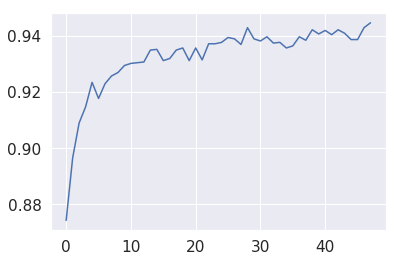

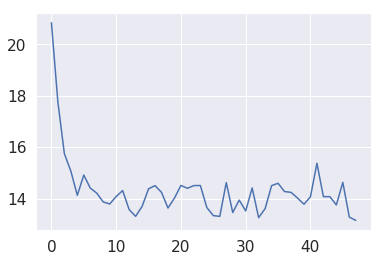

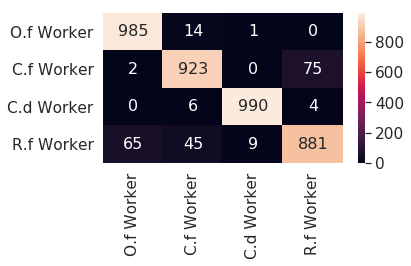

3 3
2 2
2 2
2 2
2 2
2 2
0 0
2 2
2 2
0 0
0 0
0 0
1 1
2 2
3 3
1 1
3 3
3 3
1 1
3 3
2 2
3 3
2 2
0 0
3 3
1 1
3 3
0 0
0 0
1 1
3 3
1 1
3 3
0 0
2 2
3 3
0 1
2 2
2 2
2 2
0 0
3 3
1 1
0 0
0 0
1 1
1 1
2 2
3 3
0 0
0 0
1 1
0 0
2 2
3 3
0 0
0 0
0 0
2 2
2 2
3 3
1 1
1 1
0 0
2 2
3 3
2 2
0 0
0 0
1 1
0 0
0 1
0 0
3 3
0 0
1 1
1 1
0 0
2 2
0 0
2 2
3 3
1 1
0 0
0 0
0 0
0 2
3 1
3 3
0 0
0 0
1 1
3 3
3 3
3 3
1 1
2 2
0 0
0 0
3 3
0 0
3 3
2 2
2 2
0 0
0 0
1 1
1 1
2 2
0 0
3 3
3 3
3 3
0 0
3 3
1 1
1 1
0 0
3 3
3 3
0 0
1 1
2 1
1 1
1 1
2 2
2 2
0 0
3 3
2 2
0 0
0 0
2 2
1 1
0 0
3 3
3 3
2 2
2 2
1 1
3 3
1 1
0 0
0 0
3 3
1 1
3 3
3 3
1 1
1 1
1 3
1 1
0 0
3 3
0 0
2 2
2 2
1 1
2 2
3 3
0 0
0 0
3 1
1 1
0 0
0 0
1 1
3 1
3 3
2 2
2 2
3 3
0 0
0 0
2 2
3 3
1 1
3 3
2 2
1 1
3 3
3 3
1 1
1 1
3 3
1 1
2 2
2 2
1 1
2 2
2 2
2 2
3 3
1 1
1 1
3 3
1 1
1 1
3 3
0 0
0 0
3 3
0 0
1 1
3 3
3 3
1 1
2 2
0 0
3 3
1 1
2 2
0 0
0 0
0 0
3 3
0 0
2 2
3 3
3 3
1 1
1 1
0 1
2 2
2 2
3 3
2 2
2 2
0 0
0 0
0 0
1 1
1 1
2 2
2 2
3 3
3 3
2 2
2 2
2 2
0 0
3 3
0 0
3 3
0 0
0 0
1 1
0 0
3 3
1 1


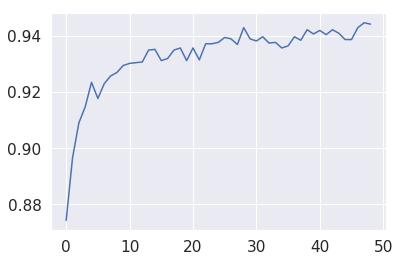

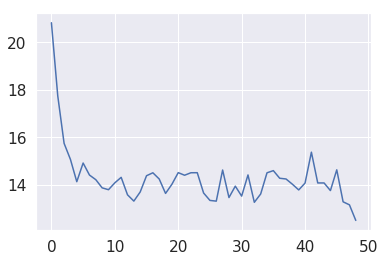

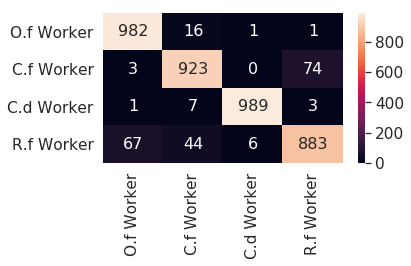

3 3
1 1
2 2
0 0
0 0
1 1
0 0
2 2
0 0
3 3
3 3
0 0
1 1
2 2
2 2
1 1
0 0
3 3
1 3
3 0
3 3
0 0
1 1
1 3
1 1
0 0
1 1
3 3
1 3
0 0
3 3
2 2
1 3
0 0
2 2
0 0
3 3
0 0
3 0
1 1
3 3
1 1
2 2
3 3
0 0
0 0
1 1
3 3
0 0
3 3
0 0
3 3
1 1
2 2
2 2
2 2
3 3
0 0
2 2
1 1
0 0
3 3
1 1
0 0
0 0
2 2
1 1
1 1
0 0
3 3
1 1
3 3
1 1
3 3
3 3
0 0
1 1
1 1
3 3
0 0
3 3
0 0
2 2
1 1
1 1
1 1
1 1
2 2
2 2
2 2
1 3
3 3
1 1
1 1
2 2
3 1
1 1
2 2
0 0
2 2
2 2
0 0
3 3
1 0
3 1
3 3
2 2
1 1
0 0
2 2
2 2
3 3
1 1
1 1
1 1
1 3
3 3
0 0
1 1
3 2
3 3
2 2
2 2
3 3
0 0
1 1
2 2
1 1
2 2
0 0
2 2
0 0
0 0
2 2
3 3
3 3
3 2
0 0
0 0
3 0
3 3
1 1
3 3
1 1
1 1
0 0
0 0
0 0
0 0
0 0
2 2
3 3
1 3
0 0
2 2
2 2
0 0
1 1
3 3
3 3
0 0
2 2
3 3
1 1
0 0
1 1
1 1
1 1
2 2
1 1
1 1
2 2
2 2
1 1
0 0
0 0
2 2
3 0
3 3
0 0
1 3
2 2
1 1
3 3
2 2
2 2
1 1
2 2
3 3
0 0
3 1
3 3
3 3
2 2
3 3
0 0
0 0
2 2
2 2
3 1
3 3
2 1
3 3
3 3
1 1
0 0
1 3
2 2
2 2
0 0
2 2
2 2
0 0
1 1
2 2
2 2
3 3
3 3
3 3
3 3
1 1
3 3
0 1
1 1
0 0
0 0
0 0
0 0
0 0
0 0
2 2
0 0
0 0
2 2
2 2
0 0
0 0
1 1
1 3
1 1
1 1
0 0
3 3
2 2
2 2
3 3
2 2
0 0
1 1
2 2


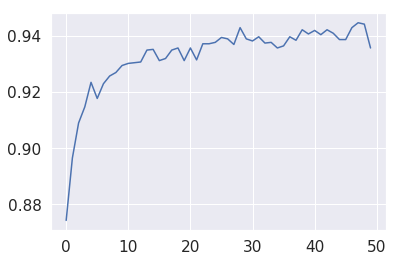

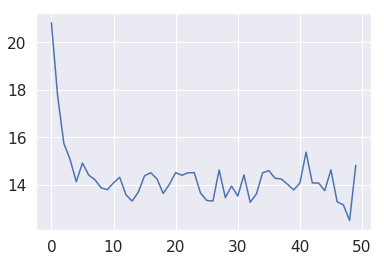

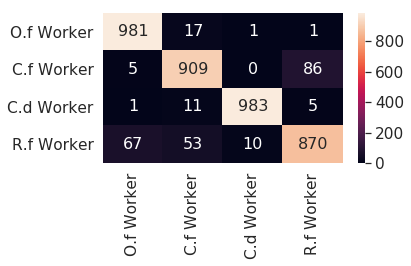

3 0
0 2
2 2
1 1
2 2
0 0
3 3
2 2
0 0
2 2
2 2
1 1
0 0
2 2
1 1
3 3
0 0
1 1
1 1
2 2
1 1
1 1
0 0
3 3
1 1
3 3
2 2
0 0
2 2
1 1
3 3
2 2
1 1
3 3
0 0
1 1
3 3
1 1
0 0
2 2
3 3
3 3
3 3
0 0
0 0
3 3
2 2
1 1
0 0
1 1
0 0
0 0
2 2
0 0
2 2
1 1
1 1
2 2
3 3
1 1
0 0
3 3
1 1
2 2
1 1
0 0
0 0
1 1
1 1
3 3
1 1
3 3
3 3
0 0
3 3
0 0
2 2
1 1
3 1
2 2
1 1
3 3
3 3
2 2
2 2
3 3
1 1
2 2
1 1
1 1
2 2
1 1
1 1
3 3
3 3
3 3
2 2
2 2
1 1
3 0
2 2
1 1
1 1
0 0
3 3
3 0
0 0
2 2
0 0
2 2
2 2
3 3
2 2
3 3
2 2
2 2
3 3
0 0
3 3
1 1
2 2
1 1
1 1
2 2
1 1
0 0
3 3
2 2
0 0
0 0
0 0
1 1
1 1
1 1
3 3
0 0
3 3
0 0
1 1
1 1
2 2
0 0
1 1
1 1
0 1
2 2
3 3
3 3
0 0
1 1
3 3
2 2
3 3
3 3
2 2
0 0
3 3
2 2
0 2
1 1
0 0
1 1
0 0
2 2
1 3
2 2
2 2
2 2
0 0
3 3
0 0
3 3
1 3
3 0
0 0
3 1
3 3
1 1
3 3
2 2
0 0
0 0
2 2
3 3
2 2
1 1
0 0
1 1
1 1
2 2
0 0
1 1
2 2
3 3
2 2
3 3
2 2
2 2
2 2
0 0
1 1
0 0
2 2
3 3
1 1
0 0
0 0
0 0
2 2
3 3
0 0
0 0
1 1
2 2
2 2
2 2
0 0
1 1
0 0
3 3
1 3
3 3
3 3
1 3
1 1
2 2
0 0
2 2
0 0
3 3
0 0
1 3
1 1
0 0
2 2
1 1
2 2
1 1
2 2
0 0
2 2
0 0
0 0
1 1
1 1
1 1
3 3
1 1
2 2
0 0


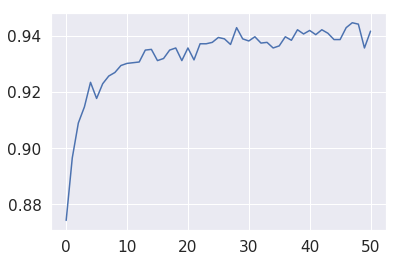

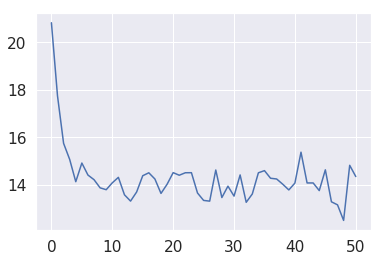

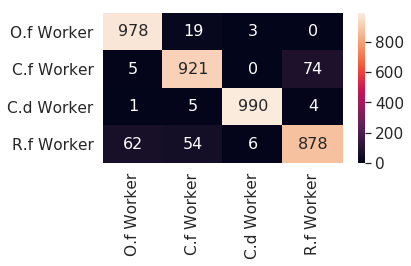

0 0
3 3
2 2
1 1
2 2
1 1
1 1
2 2
3 3
0 0
2 2
0 0
2 2
0 0
2 2
1 1
0 0
1 1
0 0
0 0
1 1
2 2
3 3
1 1
0 0
0 0
3 3
3 3
1 1
1 3
2 2
2 2
1 1
3 3
1 1
2 2
1 1
2 2
1 1
2 2
0 0
3 1
1 3
1 1
2 2
3 3
1 1
0 0
1 1
1 3
2 2
0 0
0 0
0 0
2 2
1 1
2 2
3 3
2 2
2 2
2 2
1 1
2 2
1 3
1 1
3 3
3 3
3 3
0 0
1 1
2 2
2 2
0 0
1 1
2 2
1 1
1 1
3 3
2 2
0 0
0 0
0 0
0 0
3 3
2 2
2 2
1 1
2 2
0 0
1 1
3 0
3 0
2 2
0 0
3 3
2 2
3 3
3 3
3 3
0 0
2 2
1 3
3 3
2 2
2 2
1 1
2 2
0 0
3 3
1 1
1 1
0 0
2 2
2 2
1 1
1 1
3 3
3 3
2 2
2 2
0 0
0 0
3 3
3 3
1 1
2 2
1 1
2 2
2 2
2 2
0 0
3 3
1 1
3 3
0 0
1 1
1 1
1 1
2 2
2 2
1 1
3 3
3 1
0 0
2 2
3 3
3 3
2 2
0 0
0 0
3 3
3 3
2 2
2 2
2 2
3 3
0 0
3 3
3 3
1 1
3 3
3 3
1 1
0 0
1 1
2 2
2 2
2 2
0 0
0 0
3 0
0 0
3 3
1 1
1 1
3 3
0 0
0 0
3 1
3 3
0 0
0 0
0 0
0 0
2 2
0 0
3 3
0 0
0 0
1 1
3 3
2 2
0 0
1 1
0 0
1 1
1 1
3 3
0 0
0 0
3 3
2 2
0 0
3 0
2 2
2 2
0 0
3 3
1 2
0 0
3 3
0 0
2 2
1 1
0 0
1 3
2 2
2 2
3 3
1 1
1 1
0 0
0 0
2 2
1 1
2 2
3 3
0 0
2 2
3 3
1 1
0 0
3 3
3 3
0 0
0 0
1 1
0 0
1 1
3 3
0 0
0 0
1 1
1 1
1 1
1 1
1 1
2 2
0 0
2 2


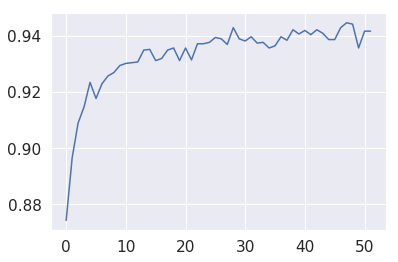

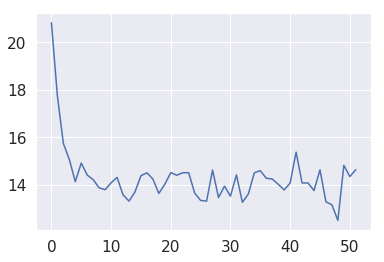

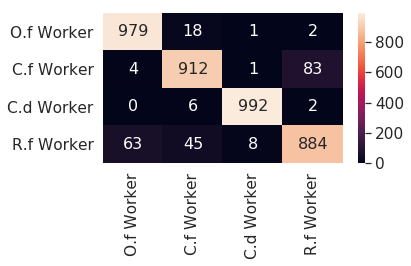

1 1
0 0
2 2
0 0
3 3
1 1
0 1
3 3
2 2
3 3
3 3
1 1
1 1
2 2
1 1
2 2
1 3
1 1
1 1
1 1
3 3
0 0
3 3
0 0
1 1
1 1
1 1
3 3
3 3
2 2
0 1
3 3
3 3
3 3
2 2
2 2
3 3
1 1
0 0
3 3
2 2
3 2
0 0
3 3
1 1
1 1
0 0
2 2
2 2
2 2
2 2
0 0
0 0
0 0
0 0
0 0
2 2
3 3
1 1
0 0
1 1
2 2
3 3
2 2
3 3
3 3
1 1
2 2
3 3
3 3
2 2
2 2
0 0
3 3
2 2
3 3
2 2
3 3
1 1
0 0
0 0
0 0
1 1
1 1
0 0
0 0
1 1
3 3
3 3
0 0
0 0
0 0
3 3
2 2
0 0
1 1
1 1
3 3
2 2
0 0
1 1
2 2
3 3
3 3
3 3
2 2
3 3
3 3
2 2
1 1
2 2
3 3
1 3
1 1
3 3
1 1
2 1
3 3
2 2
2 2
1 1
1 1
1 1
2 2
2 2
2 2
0 0
3 0
1 1
2 2
0 0
3 3
1 1
1 1
1 1
1 1
0 0
0 0
1 1
1 1
3 3
2 2
2 2
2 2
2 2
1 1
3 3
2 2
2 2
0 0
0 0
3 3
2 2
0 0
0 0
3 3
3 3
2 2
3 3
3 3
1 3
0 0
0 0
1 1
1 1
2 2
0 0
1 1
0 0
3 0
2 2
2 2
2 1
3 3
0 0
0 0
0 0
3 0
1 1
0 0
3 3
2 2
2 2
2 2
3 0
3 3
1 1
3 3
2 2
3 3
3 3
0 0
3 0
1 1
3 3
0 0
1 1
0 0
0 0
3 3
0 0
1 1
0 0
2 2
1 1
3 1
1 1
2 2
2 2
3 1
3 1
3 3
0 0
1 1
3 3
0 0
2 2
1 1
2 2
1 1
3 3
2 2
1 3
2 2
1 1
2 2
2 2
1 1
0 0
0 0
1 1
3 3
0 0
1 1
3 3
3 0
2 2
0 0
3 3
1 1
0 0
3 3
1 1
3 3
2 2
3 3
3 3
3 3
2 2
3 3


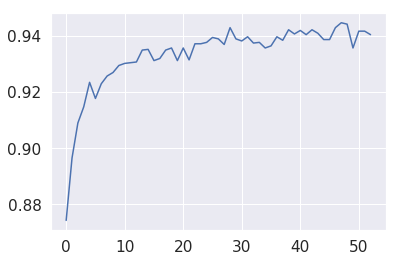

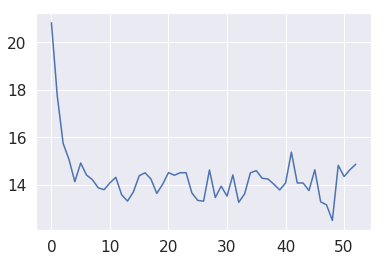

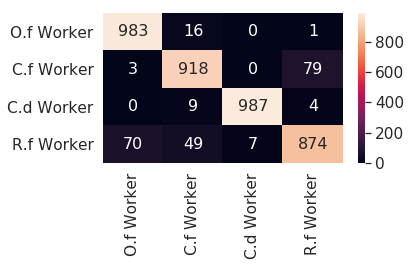

1 1
1 1
0 0
1 1
0 0
0 0
2 2
1 1
3 3
2 2
3 3
3 3
0 0
3 3
2 2
2 2
3 3
1 1
0 0
3 3
1 1
2 2
2 2
2 2
0 0
3 3
3 3
0 0
2 2
1 1
2 2
0 0
2 2
1 1
0 0
3 3
2 2
0 0
0 0
2 2
1 1
0 0
3 3
1 1
3 3
3 3
1 1
3 3
0 0
2 2
0 0
0 0
3 3
2 2
2 2
0 0
0 0
2 2
1 1
3 3
3 0
2 2
2 2
2 2
1 1
0 0
2 2
3 0
3 3
0 0
2 2
2 2
2 2
2 2
3 3
3 3
0 0
1 1
0 0
1 1
1 1
3 3
1 1
3 3
1 1
1 1
1 1
0 0
3 3
0 0
2 2
3 3
3 3
2 2
1 1
3 3
0 0
3 3
2 2
0 0
1 1
0 0
0 0
2 2
1 1
1 1
2 2
1 1
2 2
2 2
2 2
2 2
0 0
3 0
0 0
0 0
0 0
1 3
3 3
2 2
0 0
0 0
0 0
3 3
2 2
2 2
2 2
3 3
3 3
0 0
0 0
3 3
1 1
3 0
2 2
2 2
1 3
0 0
3 3
1 1
3 0
2 2
1 1
2 2
1 3
3 3
2 2
1 1
3 3
0 0
1 1
2 2
3 3
3 3
1 1
3 3
0 0
1 1
2 2
2 2
1 1
3 3
2 2
0 0
2 2
3 3
3 1
2 2
2 2
3 3
1 1
1 1
3 3
2 2
1 0
0 0
0 0
3 1
1 1
3 0
3 3
0 0
0 0
1 1
3 3
1 3
0 0
3 3
1 1
0 0
2 2
2 2
0 0
0 0
2 2
0 0
2 2
0 0
2 2
1 1
0 0
3 3
1 3
0 0
3 3
0 0
0 0
0 0
1 1
3 1
1 1
3 3
1 3
0 0
3 3
0 0
2 2
0 0
3 3
0 0
1 1
1 1
3 3
1 1
0 0
2 2
1 1
3 2
2 2
3 2
1 1
1 1
2 2
3 3
1 1
3 3
1 1
3 3
3 3
1 3
1 1
3 3
2 2
0 0
1 1
0 0
2 2
1 1
1 1
0 0


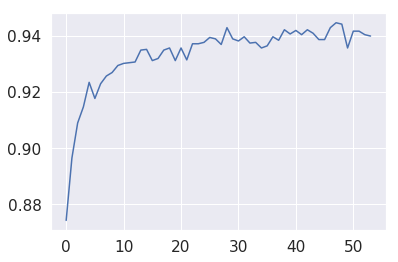

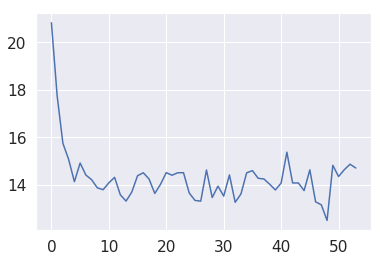

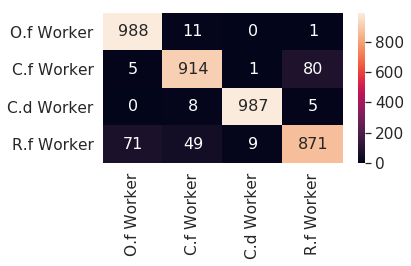

0 0
2 2
2 2
0 0
2 2
0 0
3 1
2 2
3 1
1 1
0 0
3 3
3 3
3 3
1 1
3 3
0 0
2 2
2 2
3 3
0 0
2 2
1 1
1 1
0 0
3 3
3 3
2 2
1 1
2 2
2 2
3 3
0 0
3 3
3 3
3 3
0 0
1 1
0 0
1 1
1 1
3 3
0 0
0 0
3 1
0 0
3 3
3 3
0 0
3 0
0 0
1 1
2 2
2 2
2 2
1 1
2 2
2 2
2 2
2 2
3 3
3 3
2 2
0 0
2 2
0 0
0 0
3 3
0 0
0 0
1 1
3 3
1 1
3 1
3 1
3 3
1 1
0 0
0 0
1 1
3 3
0 1
1 1
0 0
3 3
2 2
0 0
0 0
0 0
3 3
2 2
2 2
1 1
3 3
0 0
2 2
0 0
2 2
2 2
0 0
2 2
0 0
3 3
2 2
1 1
1 1
2 2
1 1
0 0
3 3
1 1
0 0
0 0
1 1
2 2
0 0
1 1
3 3
2 2
1 1
3 3
0 0
2 2
0 0
2 2
2 2
3 3
1 1
3 3
0 0
1 1
3 3
2 2
3 3
2 2
1 1
1 1
1 1
0 0
1 1
0 0
2 2
2 2
0 0
0 0
0 0
2 2
2 2
0 1
1 1
1 3
3 3
1 1
3 3
1 1
0 1
2 2
0 0
0 0
3 3
3 3
0 0
0 0
1 1
2 2
1 1
2 2
0 0
3 3
3 3
1 1
3 3
2 2
0 0
3 3
1 1
1 1
2 2
0 0
0 0
1 1
0 0
3 3
1 1
3 3
1 1
1 3
1 1
3 3
2 2
0 0
2 2
3 1
1 1
3 3
2 2
1 1
1 1
3 0
0 0
2 2
3 3
2 2
1 1
3 3
3 1
3 3
0 0
3 3
1 1
1 1
1 1
2 2
3 3
0 0
3 3
3 0
0 0
3 0
1 1
0 0
1 1
1 1
3 3
0 0
0 0
2 2
3 3
0 0
0 0
1 1
2 2
2 2
2 2
1 1
0 0
2 2
2 2
2 2
1 1
2 2
0 0
1 1
0 0
0 0
0 0
3 3
2 2
3 3
2 2


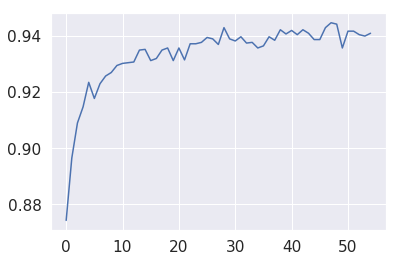

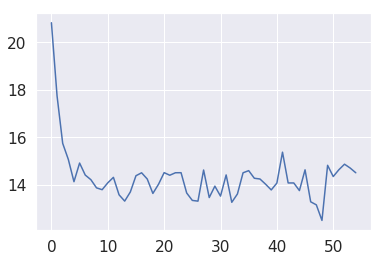

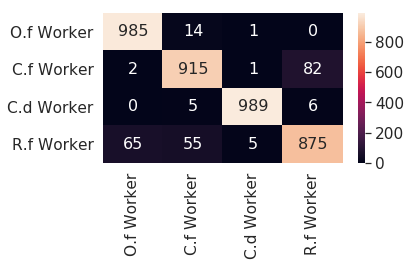

0 0
3 3
1 3
0 0
2 2
0 0
3 3
2 2
2 2
1 1
0 0
0 0
1 1
3 3
0 0
3 3
2 2
3 1
1 1
1 1
0 0
0 0
1 1
0 0
0 0
2 2
0 0
0 0
1 1
2 2
3 3
0 0
2 2
0 0
3 3
0 0
0 0
0 0
3 3
0 0
1 1
2 2
3 3
3 3
1 3
1 1
3 3
2 2
3 3
0 0
2 2
2 2
0 0
3 3
2 2
0 0
2 2
2 2
3 3
2 2
2 2
2 2
1 1
1 1
1 1
3 3
0 0
0 0
2 2
1 1
1 1
1 1
1 1
2 2
0 0
3 3
0 0
0 0
1 1
3 3
2 2
2 2
3 3
0 0
3 3
3 3
2 2
2 2
0 0
2 2
0 0
0 0
2 2
0 0
1 1
2 2
3 3
2 2
0 0
1 1
1 1
2 2
0 0
1 1
2 2
1 1
2 2
1 1
1 1
3 3
3 3
0 0
0 0
3 3
0 0
0 0
2 2
0 0
0 0
1 1
3 3
1 1
2 2
1 1
1 1
2 2
0 0
1 1
0 0
3 3
1 1
0 0
2 2
0 0
2 2
3 3
1 1
0 0
3 1
3 3
1 1
3 3
2 2
3 3
0 0
1 1
2 2
1 1
2 2
2 2
0 0
0 0
3 3
2 2
2 2
3 3
1 1
0 0
2 2
1 3
0 0
3 3
1 1
0 0
3 3
3 3
1 1
0 0
1 1
0 0
1 1
3 3
0 0
2 2
1 1
1 1
0 0
3 3
3 3
1 1
1 1
0 0
0 0
2 1
1 1
2 2
3 3
0 0
1 1
2 2
2 2
0 0
0 0
1 1
0 0
1 1
3 3
2 2
0 0
1 1
0 0
1 1
3 3
3 3
0 0
2 2
2 2
1 1
2 2
2 2
2 2
2 2
1 1
1 1
3 3
0 0
1 1
1 1
1 1
3 3
3 3
0 0
3 3
0 0
0 0
0 0
1 1
3 3
1 1
1 1
1 1
2 2
2 2
3 3
2 2
1 1
0 0
0 0
1 1
3 3
1 3
3 3
2 2
3 3
1 1
0 0
1 1
0 0
2 2
3 3


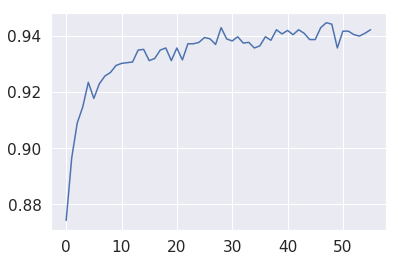

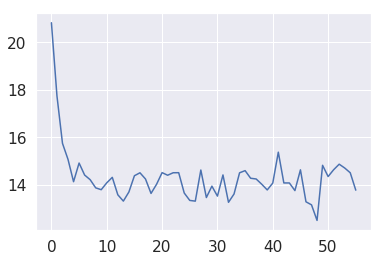

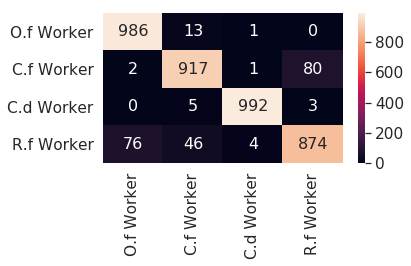

1 1
0 0
1 3
1 1
3 3
3 3
0 0
3 3
2 2
3 3
2 2
2 2
1 1
2 2
3 3
0 0
0 0
3 3
1 3
2 2
1 1
2 2
1 1
0 1
0 0
0 0
2 2
2 2
0 0
0 0
0 0
0 0
0 0
2 2
0 3
0 0
2 2
3 3
3 3
1 1
0 0
2 2
0 0
0 0
2 2
3 3
2 2
2 2
1 1
0 0
1 1
2 2
0 0
2 2
0 1
1 1
0 0
2 2
2 2
3 3
0 0
2 2
1 1
3 3
3 3
1 1
3 3
2 2
0 0
3 3
0 0
2 2
0 0
0 0
0 0
2 2
0 0
0 0
2 2
0 0
2 2
0 0
1 1
1 1
2 2
1 1
1 1
1 1
3 3
0 0
3 3
3 1
2 2
2 2
2 2
2 2
2 2
1 1
2 2
1 1
2 2
0 0
3 3
0 0
3 3
3 3
3 3
3 3
0 0
2 2
3 3
3 3
1 1
0 0
3 3
2 2
0 0
2 2
2 2
3 3
0 0
1 1
3 3
0 0
3 3
2 2
2 2
2 2
1 1
0 0
0 0
0 0
1 1
0 0
1 1
3 3
1 1
1 1
3 3
3 3
3 3
0 0
2 2
1 1
1 1
3 3
0 0
0 0
3 2
2 2
2 2
3 3
2 2
3 3
1 3
2 2
1 1
3 3
3 3
1 1
3 3
0 0
3 3
0 0
1 1
0 0
3 3
0 0
2 2
0 0
3 3
1 1
2 2
2 2
0 0
1 1
0 0
0 0
0 0
3 3
3 3
0 0
0 0
3 3
0 0
2 2
1 1
3 3
0 0
1 1
1 3
2 2
0 0
3 0
2 2
1 1
0 0
0 0
2 2
3 3
1 1
1 1
1 1
3 3
0 0
3 3
1 1
3 3
0 0
0 0
0 0
0 0
0 0
0 0
0 0
3 3
1 3
3 3
2 2
3 3
2 2
3 0
2 2
1 1
2 2
0 0
3 3
0 0
2 2
1 1
0 0
3 3
2 2
3 3
0 0
1 1
2 2
2 2
1 1
2 2
0 0
3 3
2 2
2 2
3 3
0 0
1 1
2 2
1 1
1 1


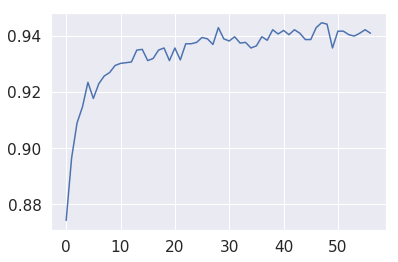

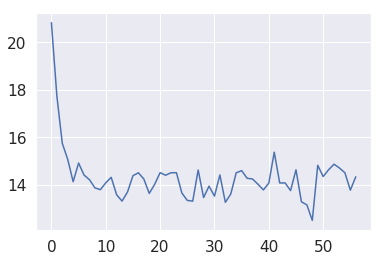

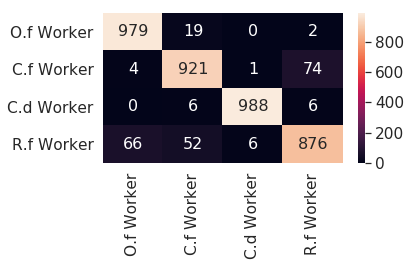

0 0
1 1
3 3
1 1
3 3
2 2
2 2
0 0
1 1
0 0
3 0
2 2
3 3
3 3
0 0
2 2
1 3
0 0
2 2
1 1
3 3
1 1
2 2
2 2
3 3
1 1
0 0
1 1
0 0
2 2
0 0
1 1
3 1
0 0
1 1
0 0
2 2
1 1
0 0
2 2
1 1
1 1
1 1
1 1
0 0
1 1
3 3
0 0
3 2
3 3
3 3
0 0
1 1
3 3
0 0
3 3
0 0
0 0
2 2
1 1
3 3
2 2
3 3
0 0
3 3
1 1
0 0
2 2
2 2
1 1
0 0
0 0
1 1
3 0
1 1
2 2
1 1
1 1
1 1
0 0
2 2
2 2
0 0
0 0
2 2
2 2
0 0
2 2
1 1
0 0
1 1
0 0
2 2
2 2
1 1
3 3
1 1
1 1
3 3
0 0
3 3
3 3
2 2
1 1
1 1
2 2
3 3
1 1
3 3
1 1
0 0
3 3
3 3
3 0
0 0
0 0
3 3
0 0
0 0
3 3
3 3
1 1
2 2
3 3
3 3
3 3
0 0
2 2
1 1
1 1
0 0
1 1
3 3
1 1
3 3
0 0
0 0
0 0
3 3
3 3
3 3
2 2
1 1
1 1
0 0
0 0
1 1
3 3
3 3
2 2
0 0
1 1
3 3
3 3
0 0
2 2
1 0
2 2
3 0
0 0
1 1
2 2
1 1
0 0
3 3
1 1
1 1
1 1
3 3
1 1
3 3
3 3
2 2
1 1
1 1
1 1
3 3
0 0
3 3
0 0
1 1
1 1
1 1
2 2
1 1
3 0
1 1
1 1
0 0
0 0
1 1
2 2
1 1
0 0
2 2
0 0
3 3
1 3
3 0
3 3
3 3
1 1
1 1
1 1
0 0
2 2
0 0
3 3
3 3
1 1
0 0
2 2
2 2
1 1
2 2
0 0
0 0
3 3
0 0
3 3
1 1
3 3
0 0
3 3
2 2
0 0
3 3
2 2
0 0
2 2
2 2
2 2
3 3
1 1
1 1
2 2
2 2
3 3
0 0
0 0
3 3
0 0
0 0
0 0
1 1
2 2
0 0
0 0
3 3
0 0


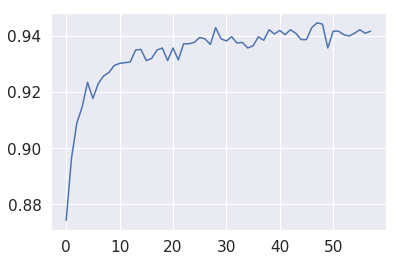

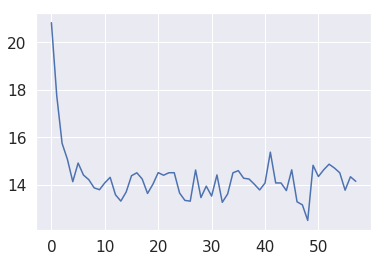

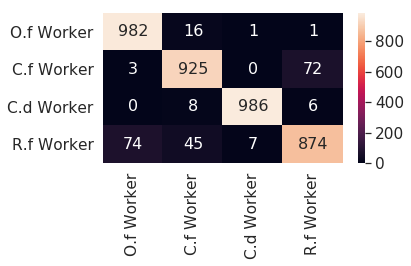

3 3
0 0
0 0
1 1
2 2
0 0
1 3
1 1
2 2
2 2
2 2
2 2
0 1
2 1
0 0
2 2
0 0
2 2
1 1
3 3
3 3
3 3
0 0
1 1
3 0
1 1
0 1
0 0
1 1
0 0
0 0
3 3
0 0
0 0
3 3
0 0
1 1
0 0
0 0
2 2
2 2
3 3
1 1
2 2
3 3
0 0
2 2
1 1
1 1
3 3
0 0
1 1
2 2
1 1
1 1
2 2
1 1
1 1
2 2
2 2
3 3
0 0
1 1
3 3
3 3
1 1
2 2
1 3
1 1
2 2
1 1
3 3
3 3
0 0
3 3
1 1
3 3
2 2
3 3
3 3
1 1
0 0
0 0
2 2
3 3
2 2
2 2
2 2
0 0
1 1
1 1
1 1
0 0
1 1
3 3
0 0
1 1
1 1
2 2
0 0
3 3
0 0
3 1
0 0
0 0
0 0
1 1
3 3
3 3
2 2
2 2
2 2
2 2
2 2
0 0
3 3
2 2
2 2
1 1
1 1
1 1
1 1
1 1
3 3
1 1
0 0
0 0
2 2
2 2
1 3
1 1
2 2
1 1
0 0
2 2
0 0
3 3
1 1
3 3
3 3
1 1
0 0
3 0
0 0
0 0
0 0
0 1
0 0
3 1
3 3
2 2
1 1
3 3
2 2
3 3
3 3
1 1
0 0
3 3
1 3
0 0
3 3
1 1
0 0
0 0
1 1
1 3
2 2
2 2
1 1
2 2
0 0
2 2
0 0
0 0
0 0
0 0
2 2
0 0
3 3
1 1
2 2
3 3
1 1
2 2
3 3
3 3
1 1
1 1
1 1
0 0
1 1
2 2
1 1
3 3
0 3
0 0
0 0
1 1
0 0
2 2
0 0
2 2
2 2
3 1
1 1
0 0
3 3
0 0
2 2
1 3
0 0
0 0
0 0
3 3
1 1
1 1
1 1
1 3
3 3
0 0
1 1
1 1
3 3
3 3
2 2
3 3
0 0
0 0
0 0
2 2
2 2
1 1
3 3
0 0
1 1
2 2
1 1
1 1
0 0
1 1
0 0
1 3
0 0
0 0
3 3
3 3
2 2
3 3
3 3


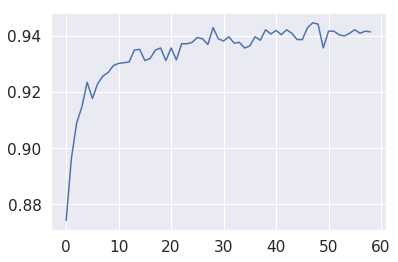

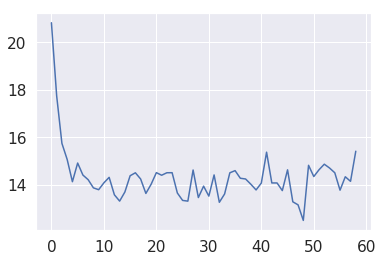

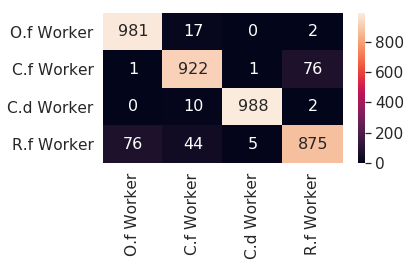

0 0
2 2
2 2
2 2
1 1
1 1
2 2
3 3
3 3
2 2
3 3
3 3
2 2
0 0
1 1
2 2
2 2
1 1
0 0
3 3
0 0
3 3
0 0
0 0
0 0
0 0
3 1
3 1
0 0
2 2
3 2
3 3
3 3
0 0
3 3
0 0
1 1
3 3
0 0
1 1
1 1
1 1
0 0
3 1
3 3
3 3
3 3
2 2
0 0
2 2
2 1
0 0
1 1
3 3
1 1
3 3
3 3
1 1
2 2
2 2
3 3
1 3
1 1
2 2
3 3
0 0
0 0
3 3
3 3
2 2
1 1
2 2
0 0
0 0
0 0
2 2
0 0
1 1
3 3
2 3
1 1
0 0
2 2
2 2
0 0
2 2
0 0
1 1
1 1
3 3
0 0
0 0
2 2
3 3
2 2
2 2
2 2
3 3
0 0
0 0
1 1
1 1
1 1
0 0
2 2
1 1
0 0
3 1
3 3
1 1
2 2
3 3
0 0
1 1
1 1
2 2
2 2
3 3
1 3
1 1
1 1
3 3
1 1
2 2
2 2
2 2
2 2
1 1
0 0
2 2
2 2
1 1
2 2
0 0
3 3
2 2
1 1
2 2
1 1
3 3
2 2
0 0
2 2
2 2
0 0
0 0
3 3
3 3
2 2
0 0
1 1
3 3
3 3
3 1
0 0
1 1
3 1
2 2
0 0
2 2
0 0
3 3
0 0
3 3
3 1
0 0
2 2
0 0
0 0
1 1
2 2
1 1
3 3
3 0
3 3
1 1
3 3
3 3
3 3
2 2
3 1
0 0
1 1
3 3
0 0
2 2
3 3
3 0
2 2
3 0
2 2
0 3
0 0
2 2
2 2
1 1
3 3
0 0
1 1
1 1
0 0
1 1
0 0
0 0
1 3
1 1
3 3
1 1
1 1
2 2
0 0
0 0
0 0
0 0
1 1
3 3
2 2
0 0
0 0
3 3
3 3
0 0
3 1
1 1
0 0
1 1
3 3
3 3
3 3
1 1
3 3
2 2
3 3
0 0
0 0
2 2
0 0
3 3
0 0
2 2
2 2
3 3
0 1
3 3
3 3
3 3
1 1
0 0
2 2
0 0


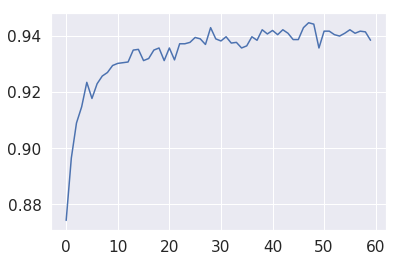

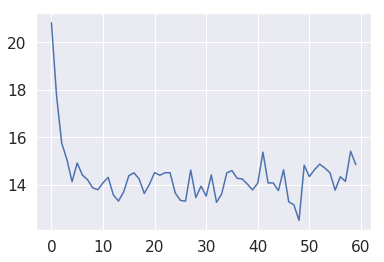

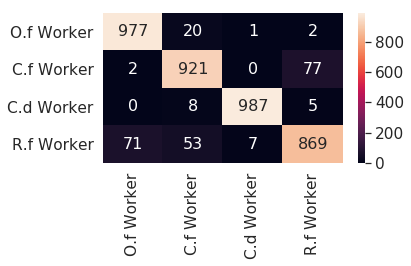

0 0
0 0
3 3
1 1
3 3
2 2
0 0
1 1
0 0
2 2
0 0
0 0
3 3
2 2
3 3
0 0
0 0
1 1
1 1
0 0
0 0
1 1
3 3
2 3
3 3
0 1
0 0
0 0
2 2
1 1
2 2
2 2
1 1
3 3
1 1
3 3
2 2
2 2
1 1
3 3
2 2
2 2
0 0
2 2
3 3
0 0
0 0
1 1
3 3
2 2
3 3
3 3
3 3
2 2
1 1
1 1
1 1
1 1
3 3
1 1
1 1
3 3
2 2
2 2
1 1
2 2
2 2
1 3
0 0
1 1
3 3
1 1
0 0
3 3
1 1
2 2
1 1
1 1
3 3
0 0
1 1
2 2
1 1
1 1
3 3
1 1
2 2
1 3
0 0
2 2
2 2
2 2
1 1
1 1
2 2
0 0
2 2
2 2
0 0
1 1
2 2
1 1
1 1
3 3
1 1
3 3
2 2
0 0
1 1
0 0
2 2
1 1
0 0
0 0
3 3
3 3
1 1
3 3
0 0
0 0
3 3
3 3
0 0
3 0
1 1
1 1
0 0
3 3
0 0
2 2
1 1
1 1
3 3
1 1
1 1
3 3
1 1
0 0
2 2
2 2
1 1
2 2
0 0
2 2
0 0
3 3
0 0
3 0
1 1
0 0
1 1
0 0
3 3
2 2
1 1
1 1
3 3
1 1
3 3
2 2
3 3
0 0
1 1
2 2
1 1
1 1
3 0
3 3
3 3
3 3
3 3
3 3
3 3
3 3
3 1
0 0
0 0
2 2
0 0
0 0
3 3
3 2
1 1
1 1
1 3
3 0
1 1
3 3
0 0
2 2
2 2
0 0
1 1
0 0
3 3
0 0
0 0
3 3
2 2
2 2
1 1
1 1
2 2
2 2
0 0
2 2
2 2
2 2
1 1
2 2
1 1
1 1
3 3
2 2
2 2
3 3
3 0
2 2
2 2
0 0
1 1
3 3
0 0
0 0
0 0
0 0
2 2
1 1
0 0
0 0
0 0
3 3
2 2
0 0
1 1
3 3
2 2
2 2
3 3
0 0
3 3
0 0
2 2
3 3
0 0
1 3
3 3
3 3
3 3
3 3


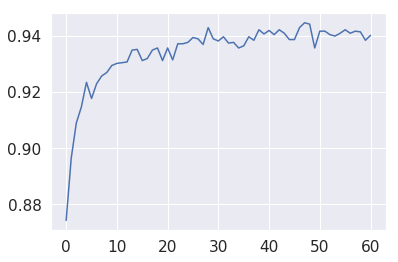

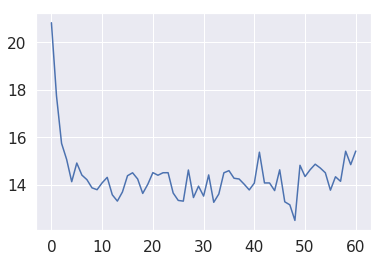

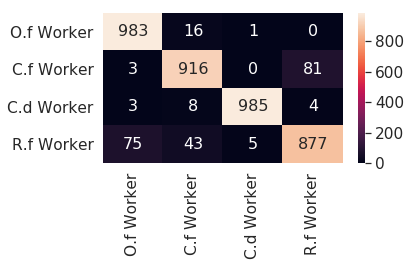

3 3
3 3
3 3
1 1
0 0
3 3
1 1
2 2
0 0
3 3
2 2
0 0
3 3
3 3
1 1
3 1
2 2
1 1
0 0
3 3
2 2
1 1
1 1
2 2
0 0
0 0
2 2
0 0
0 0
3 3
0 0
0 0
1 1
0 0
1 1
3 3
3 3
0 0
0 0
2 2
3 1
3 3
3 3
1 1
2 2
2 2
0 0
1 1
2 2
1 3
1 3
2 2
3 3
2 2
0 0
1 1
0 0
2 2
1 1
0 0
1 1
0 0
2 2
1 1
0 0
3 3
3 3
2 2
2 2
1 1
3 3
1 1
0 0
1 1
0 0
1 1
2 2
3 3
2 2
1 1
3 3
2 2
3 3
1 1
3 3
3 3
0 0
0 0
1 1
3 1
2 2
2 2
2 2
0 0
0 0
1 1
0 0
0 0
0 0
2 2
0 0
0 0
3 3
2 2
0 0
3 3
3 3
3 3
2 2
3 3
2 2
2 2
0 0
2 2
1 1
1 1
0 0
1 1
2 2
2 2
1 1
2 2
3 3
3 3
1 1
3 3
0 0
2 2
0 0
1 1
2 2
0 0
0 0
1 1
2 2
1 3
1 1
1 1
1 1
3 3
2 2
0 0
3 3
0 0
2 2
1 1
1 1
0 0
3 3
3 3
3 3
3 3
3 3
2 2
2 2
0 0
2 2
0 0
0 0
3 3
3 3
3 3
1 1
1 1
2 2
2 2
0 0
2 2
1 1
2 2
3 0
1 1
3 3
2 2
0 1
0 0
0 0
2 2
1 1
2 2
0 0
0 0
3 3
1 1
3 3
3 1
2 2
2 2
3 3
2 2
1 1
3 3
1 1
3 0
2 2
2 2
2 2
0 0
3 0
2 2
2 2
1 1
3 3
2 2
0 0
3 3
1 3
0 0
3 3
1 1
3 3
1 1
2 2
2 2
2 2
1 1
2 2
2 2
0 0
1 1
2 2
3 3
2 2
1 1
0 0
2 2
1 3
0 0
0 0
1 1
3 3
2 2
2 2
0 0
0 0
2 2
1 1
2 2
3 3
1 1
3 3
0 0
1 1
3 3
3 3
1 1
3 3
2 2
1 1
3 3


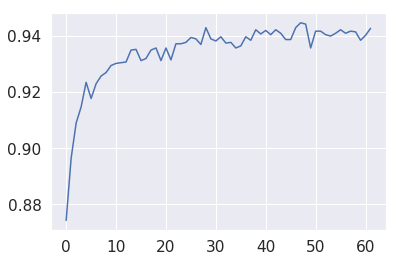

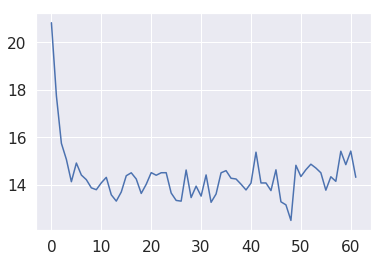

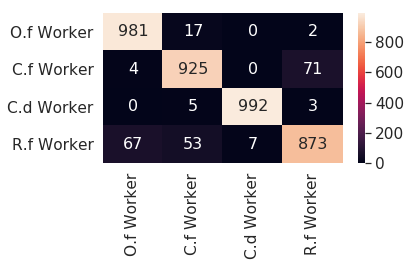

2 2
3 3
3 3
2 2
1 1
1 1
0 0
1 1
1 1
2 2
1 1
0 0
1 1
2 2
0 0
3 3
3 3
1 3
2 2
2 2
1 1
2 2
2 2
2 2
3 3
2 2
1 1
3 3
1 1
1 1
3 3
3 3
3 3
1 1
1 1
2 2
1 1
0 0
0 0
3 0
3 0
3 0
3 0
3 0
1 1
1 1
3 3
3 3
3 2
2 2
1 1
3 3
2 2
2 2
0 0
3 3
1 1
0 0
1 1
3 3
0 0
0 0
0 0
1 1
0 0
2 2
0 0
0 0
1 1
1 3
0 0
2 2
1 1
1 1
3 3
3 1
1 1
3 3
3 3
0 0
2 2
3 3
0 0
0 0
1 1
1 1
0 0
2 2
3 3
3 3
0 0
1 1
1 1
0 0
0 0
2 2
0 0
1 0
1 1
1 1
1 1
2 2
3 3
0 0
2 2
0 3
3 3
0 0
3 3
2 2
1 1
0 0
2 2
0 0
0 0
3 3
2 2
3 3
1 1
2 2
0 0
3 3
3 3
2 2
3 3
1 1
3 3
1 1
3 3
3 3
0 0
0 0
3 3
2 2
0 0
1 1
3 0
2 2
0 0
1 1
0 0
3 3
3 3
0 0
3 3
1 1
3 3
1 1
2 2
1 1
3 3
0 0
2 2
1 1
3 3
1 1
0 0
1 1
1 1
1 1
2 2
2 2
2 2
3 3
1 1
0 0
0 0
3 3
0 0
1 1
2 3
1 1
1 1
0 0
2 2
0 0
1 1
3 3
1 3
1 1
3 0
0 0
2 2
2 2
1 1
3 3
0 0
0 0
1 1
0 0
2 2
0 0
3 3
1 1
0 0
1 1
3 3
0 0
1 1
3 3
0 0
0 0
2 2
0 0
2 2
2 2
2 2
0 0
2 2
3 3
1 1
1 1
3 3
0 0
1 1
1 1
2 2
1 1
3 3
1 1
0 0
1 1
2 2
0 0
1 1
0 0
1 1
3 3
3 3
2 2
3 3
0 0
3 3
3 3
3 3
0 0
1 1
1 1
2 2
0 0
2 2
1 1
2 2
0 0
0 0
1 1
1 1
0 0
3 3
1 1


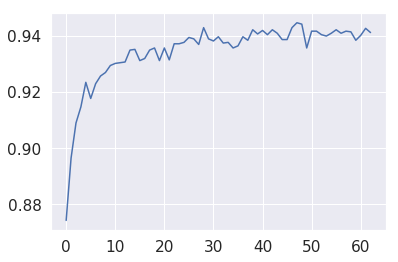

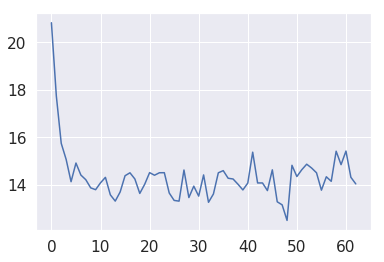

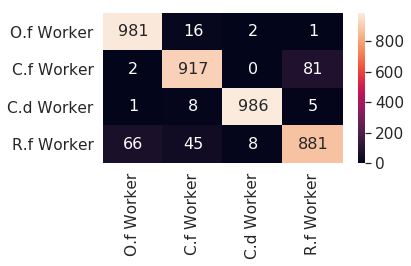

1 1
2 2
0 0
2 2
2 2
2 2
3 3
0 0
3 3
1 1
1 1
2 0
3 3
1 1
0 0
3 3
2 2
3 0
0 0
0 0
3 3
2 2
2 2
3 3
1 1
0 0
0 0
2 2
0 0
1 1
1 1
2 2
2 2
1 1
1 1
0 0
3 3
2 2
0 0
1 1
3 3
2 2
1 3
0 0
2 2
1 1
2 2
2 2
0 0
0 0
1 1
3 3
2 2
1 1
3 3
1 1
2 2
2 2
1 1
0 0
2 2
3 1
1 1
1 1
2 2
1 1
0 0
3 3
3 3
0 0
3 1
2 2
3 3
1 1
0 0
2 2
0 0
2 2
0 0
2 2
3 1
2 2
3 3
3 3
3 3
3 3
0 0
0 0
3 3
3 3
3 0
0 0
1 1
3 0
3 1
2 2
3 3
2 2
1 1
3 3
0 0
1 1
3 3
3 3
3 3
0 0
2 2
3 3
2 2
2 2
3 0
3 3
3 3
3 3
3 3
2 2
3 1
1 1
3 1
0 0
3 3
3 0
3 3
3 2
0 0
1 1
3 3
2 2
0 0
1 1
0 0
0 0
1 1
1 1
3 3
1 1
1 1
2 2
2 2
0 0
3 3
1 1
0 0
3 0
2 2
0 0
0 0
3 3
3 3
3 3
0 0
1 1
0 0
0 0
2 2
1 3
2 2
3 3
2 2
1 1
0 0
2 2
2 2
1 1
1 1
0 0
0 0
3 3
3 3
0 0
0 0
3 3
2 2
0 0
1 1
1 1
2 2
1 1
0 0
0 1
3 3
3 3
0 0
2 2
1 1
3 3
1 3
1 3
0 0
2 2
2 2
3 3
3 3
1 1
0 0
3 1
2 2
1 1
0 0
2 2
0 0
3 3
1 1
1 1
2 2
1 1
3 3
2 2
2 2
3 3
3 3
2 2
0 0
3 3
1 1
2 2
0 0
1 1
0 0
0 0
0 0
1 1
1 1
3 3
3 3
1 1
0 0
0 0
3 1
0 0
3 3
3 3
1 1
0 0
2 2
2 2
3 3
0 0
2 2
2 2
0 0
1 3
2 2
1 1
0 0
1 1
0 0
3 3
3 3
0 0


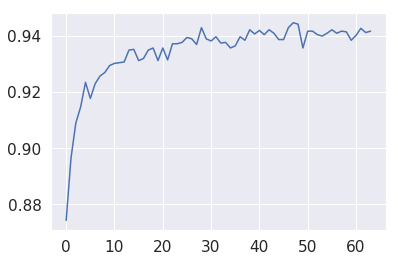

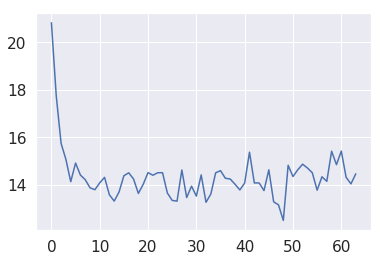

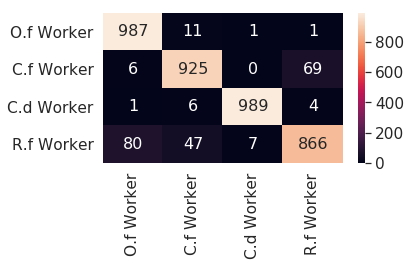

0 0
3 3
3 3
3 3
2 2
1 1
0 0
2 2
3 3
0 0
0 0
0 1
1 1
0 0
0 0
3 3
0 0
3 3
2 2
2 2
2 2
2 2
1 1
1 1
3 3
1 1
1 1
1 1
2 2
3 3
3 3
3 3
2 2
3 3
0 0
1 1
2 2
3 3
0 0
0 0
1 3
3 3
1 1
1 3
1 1
3 3
0 0
3 3
1 1
0 0
0 0
0 0
0 0
0 0
0 0
1 1
3 0
1 1
2 2
0 0
1 1
3 3
2 2
0 0
0 0
0 0
1 1
0 0
1 1
1 3
3 1
1 1
3 3
2 2
0 0
0 0
2 2
2 2
2 2
3 3
2 2
1 1
3 3
1 1
1 1
0 0
2 2
3 3
2 2
2 2
1 1
3 3
1 1
2 2
2 2
3 3
0 0
2 2
3 3
3 3
2 2
3 3
3 1
2 2
3 3
0 0
3 3
1 1
2 2
3 3
2 2
2 2
1 3
2 2
2 2
2 2
3 3
3 3
0 0
2 2
1 1
2 2
2 2
1 1
2 2
1 1
0 0
0 0
1 3
2 2
1 1
3 3
0 0
2 2
3 3
2 2
1 1
2 2
1 1
3 0
0 0
2 2
1 1
2 2
1 1
3 3
2 2
0 0
0 0
3 3
1 1
2 2
0 0
3 3
0 0
2 2
0 0
2 2
1 1
1 1
1 1
1 3
0 0
2 2
3 3
2 2
1 1
0 0
0 0
1 1
2 2
0 0
3 3
0 0
3 3
2 2
3 3
1 1
2 2
0 0
0 0
2 2
3 3
2 2
3 3
1 1
3 3
1 1
0 0
2 2
1 1
3 3
1 1
1 1
2 2
0 0
1 3
0 0
0 0
1 1
0 0
3 3
1 1
3 3
3 3
1 1
2 2
0 0
1 1
2 2
3 1
2 2
0 0
2 2
3 3
3 3
3 3
0 0
2 2
1 1
3 3
2 2
3 3
3 3
0 0
1 1
3 3
1 1
1 1
1 1
0 0
0 0
3 3
2 2
0 0
0 0
3 3
0 0
1 1
1 1
2 2
0 0
1 1
0 0
0 0
0 0
2 2
1 1
3 3
3 3


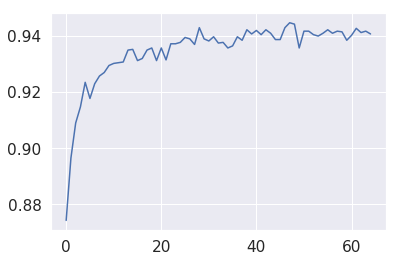

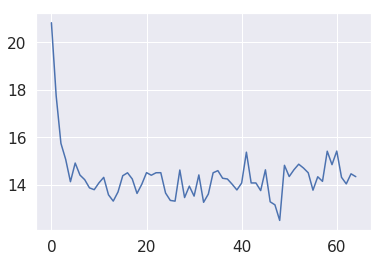

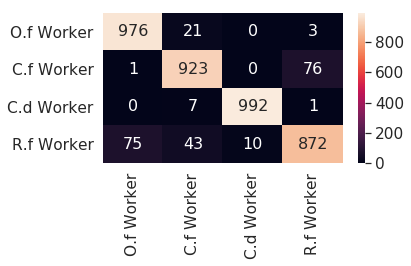

2 2
1 1
3 0
2 2
3 3
1 1
2 2
3 3
1 1
3 3
3 3
1 1
1 1
1 1
2 2
3 3
0 0
3 0
2 2
3 3
2 2
3 3
0 0
0 0
3 3
1 1
2 2
1 1
3 3
0 0
1 1
2 2
2 2
1 1
2 2
2 2
1 1
1 1
2 2
2 2
2 2
3 3
2 2
2 2
1 1
3 3
1 0
2 2
3 3
2 2
0 0
0 0
0 0
2 2
3 3
0 0
1 1
1 1
2 2
0 0
3 3
3 3
2 2
1 1
0 0
3 3
1 1
2 2
2 0
2 2
2 2
3 3
2 2
1 1
2 2
1 1
2 2
1 3
3 0
2 2
3 3
2 2
1 1
3 3
1 1
2 2
1 1
0 0
1 1
2 2
1 1
1 1
0 0
2 2
3 3
2 2
2 2
0 0
3 3
2 2
0 0
1 1
1 3
1 1
3 3
3 3
0 0
1 1
1 1
0 0
0 0
2 2
0 0
2 2
3 3
3 3
2 2
2 2
0 0
1 1
3 3
3 0
2 2
1 3
3 1
3 1
1 1
0 0
3 3
2 2
0 0
1 1
2 2
0 0
2 2
2 2
2 2
0 0
0 0
2 2
2 2
2 2
1 1
2 3
0 0
2 2
1 1
0 0
3 3
2 2
2 2
0 0
0 0
2 2
0 0
1 1
0 0
0 0
1 1
2 2
2 2
2 2
1 1
3 3
2 2
2 2
0 0
0 0
0 0
1 1
1 1
3 3
0 0
1 3
1 1
0 0
2 2
2 2
3 3
1 1
0 0
3 3
0 0
3 3
3 3
0 0
2 2
1 1
2 2
1 1
2 2
2 2
0 0
2 2
2 2
3 3
2 2
1 1
1 1
2 2
3 3
2 2
1 3
2 2
0 0
0 0
2 2
2 2
1 1
0 0
1 1
1 1
2 2
0 0
2 2
1 1
3 3
3 3
3 3
2 2
3 3
0 0
0 0
3 0
1 1
0 0
3 3
1 1
0 0
0 0
1 1
3 3
3 3
0 0
3 3
3 3
2 2
3 1
1 1
3 3
2 2
0 0
0 0
0 0
1 1
0 0
3 3
2 2
2 2
3 3


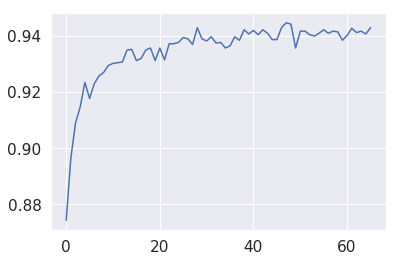

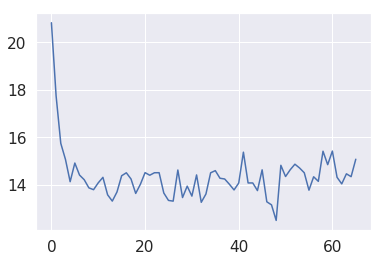

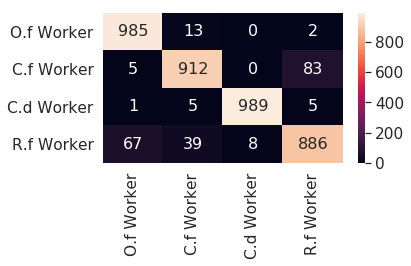

1 1
0 0
0 0
3 0
2 2
3 3
1 3
2 2
3 3
3 3
0 0
2 2
3 3
0 0
1 1
3 3
0 0
2 2
3 3
0 0
1 1
1 3
1 1
1 1
0 0
0 0
0 0
3 3
3 3
1 1
3 3
0 0
3 1
0 0
2 2
1 3
1 1
2 2
2 2
0 0
0 0
1 1
1 1
2 2
2 2
3 2
2 2
0 0
0 1
2 2
1 1
2 2
2 2
0 0
0 0
1 1
3 3
3 3
2 2
2 2
0 0
1 1
2 2
2 2
2 2
1 1
0 0
0 0
1 1
3 1
2 2
2 2
0 0
3 3
2 2
3 3
2 2
0 0
0 0
0 0
0 0
3 3
1 1
2 2
2 2
2 2
1 1
0 0
3 3
1 1
0 0
3 3
2 2
3 3
3 3
1 1
0 0
2 2
0 0
1 1
3 3
2 2
1 1
2 2
2 2
3 3
1 1
3 3
1 1
1 1
2 2
2 2
0 0
1 1
3 3
3 3
3 3
3 3
3 3
3 1
2 2
0 0
2 2
1 1
1 1
2 2
0 0
0 0
0 0
1 1
2 2
1 1
3 3
2 2
2 2
1 1
1 1
2 2
2 2
2 2
0 0
3 3
2 2
2 2
1 1
0 0
0 0
0 0
1 1
3 3
3 0
1 3
0 0
1 3
3 3
0 1
2 2
1 1
3 0
1 1
1 1
2 2
2 2
1 1
1 1
1 1
0 0
0 0
0 0
1 1
0 0
1 1
1 1
0 0
3 3
3 3
2 2
1 3
3 0
1 1
0 0
2 2
0 0
0 0
2 2
1 1
2 2
3 3
0 0
2 2
3 3
1 1
1 1
2 2
2 2
2 2
1 1
1 1
2 2
2 2
0 0
3 3
0 0
1 1
1 1
2 2
0 0
2 2
0 0
3 3
0 0
3 3
3 3
2 2
1 1
2 2
1 1
0 0
0 0
1 1
0 0
1 1
0 0
3 3
3 3
1 1
3 3
0 0
1 1
0 0
2 2
0 0
1 1
1 1
1 1
3 3
1 1
2 2
3 3
1 1
3 1
1 1
2 2
0 0
0 0
1 3
2 2
0 0
3 3
3 3


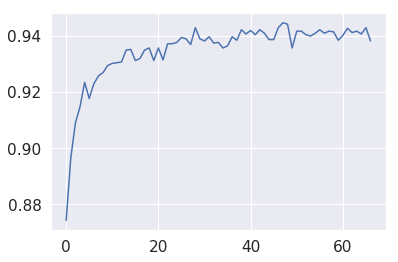

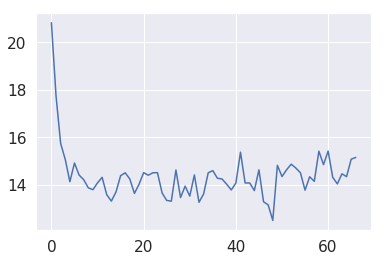

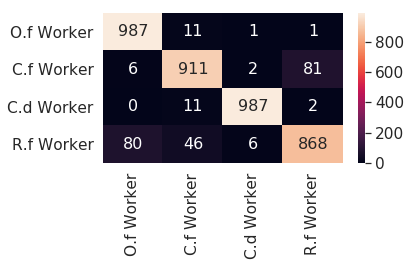

3 3
3 3
1 1
1 1
3 3
3 3
1 1
0 0
0 0
2 2
1 1
0 0
0 0
0 0
2 2
2 2
1 1
2 2
1 3
0 0
1 1
3 3
2 2
1 1
3 3
3 3
1 1
1 1
0 0
2 2
3 0
0 0
3 3
1 1
1 1
3 3
3 3
0 0
3 3
3 3
1 1
3 0
1 1
3 3
3 3
0 0
0 0
2 2
0 0
1 1
1 1
0 0
3 0
2 2
0 0
2 2
3 3
0 0
1 1
0 0
2 2
0 0
2 2
0 0
3 3
0 0
3 3
1 1
1 1
2 2
2 2
0 0
1 1
1 3
3 3
0 0
3 3
1 1
0 0
1 1
3 3
0 0
3 3
3 3
2 2
2 2
2 2
2 2
0 0
1 1
1 1
2 2
0 0
1 1
2 2
0 0
0 0
3 3
3 2
3 0
2 2
3 3
3 3
0 2
1 1
1 1
3 3
3 3
0 0
3 3
2 2
2 2
1 1
2 2
1 1
2 2
2 2
0 0
0 0
1 1
2 2
1 1
1 1
0 0
3 3
3 3
3 3
3 3
2 2
2 2
1 3
1 3
3 3
3 3
2 2
0 0
3 3
2 2
3 0
1 1
3 0
3 3
0 0
1 1
1 3
3 3
1 1
0 0
1 1
2 2
3 3
3 3
3 3
0 0
0 0
0 0
0 0
1 3
0 0
2 2
0 0
1 1
1 1
1 1
1 1
1 1
2 2
0 0
3 3
1 1
0 0
2 2
0 0
1 1
1 3
1 1
2 2
3 3
0 0
1 1
1 1
0 0
0 0
1 1
2 2
0 0
2 2
0 0
1 1
1 1
0 0
1 1
1 1
0 0
0 0
3 3
3 3
3 3
2 2
2 2
1 1
3 3
1 1
2 2
1 1
1 1
3 3
1 1
0 0
2 2
3 3
1 1
1 1
2 2
1 1
1 1
0 0
2 2
0 0
1 1
3 3
1 1
2 2
0 0
0 0
2 2
0 0
1 1
3 0
3 3
1 1
3 3
3 3
3 3
1 1
2 2
0 0
0 0
3 3
2 2
1 1
1 1
3 3
0 0
2 2
3 3
1 1
3 3
2 2
1 1


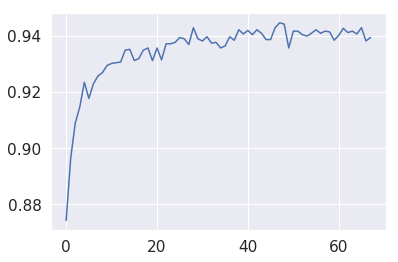

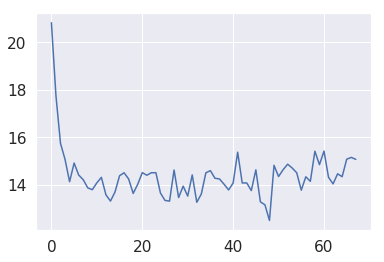

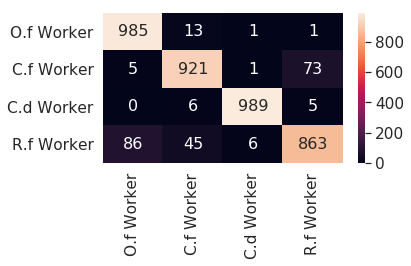

0 0
0 0
3 3
1 1
3 3
0 0
2 2
3 3
2 2
3 3
1 1
3 3
0 0
3 3
3 3
2 2
3 3
1 1
0 0
2 2
3 3
3 3
3 3
1 1
0 0
0 0
2 2
1 1
2 2
2 2
0 1
2 2
0 0
1 1
2 2
2 2
3 3
1 1
0 0
3 0
1 1
0 0
2 2
0 0
3 3
3 3
2 1
1 1
2 2
0 0
2 2
3 3
2 2
0 0
3 3
1 1
2 2
2 2
3 0
2 2
2 2
0 0
2 2
2 2
1 1
2 2
2 2
0 0
0 0
2 2
0 0
0 0
2 2
0 0
0 0
1 1
0 0
3 3
0 0
2 2
3 1
2 2
0 0
3 3
1 3
2 2
2 2
1 1
3 3
0 0
1 1
0 0
3 3
3 3
1 1
3 3
3 3
0 0
1 1
1 1
3 3
0 0
3 3
3 3
0 0
1 1
0 0
2 2
3 3
0 1
0 0
0 0
0 0
2 2
3 3
3 3
0 0
3 3
0 0
3 3
3 3
1 1
1 1
0 0
2 2
3 3
1 1
0 0
3 3
3 3
1 1
2 2
0 0
0 1
1 1
1 3
3 3
0 0
3 3
3 3
1 1
1 1
1 1
0 0
2 2
0 0
2 2
2 2
0 0
0 0
2 2
2 2
2 2
1 1
2 2
3 3
3 3
2 2
1 1
3 3
3 3
0 0
0 0
2 2
1 1
1 1
1 3
0 0
1 1
2 2
0 0
1 1
3 3
0 0
2 2
1 1
3 0
0 0
2 2
1 1
2 2
0 0
0 0
0 0
2 2
2 2
0 0
1 1
2 2
0 0
1 1
1 3
0 0
0 0
2 2
3 3
2 2
2 2
2 2
2 2
2 2
3 3
2 2
3 3
2 2
2 2
1 1
2 2
2 2
0 0
0 0
3 3
3 3
0 0
0 0
2 2
0 0
3 3
3 1
3 0
1 1
0 0
1 1
2 2
0 0
3 3
1 1
0 0
3 3
1 1
1 1
1 1
0 0
3 3
2 2
1 3
1 1
3 3
3 3
1 1
3 3
2 2
2 2
1 1
2 2
0 0
0 0
2 2
3 3
1 1


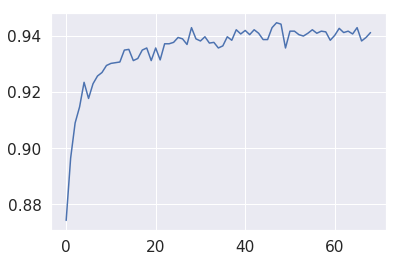

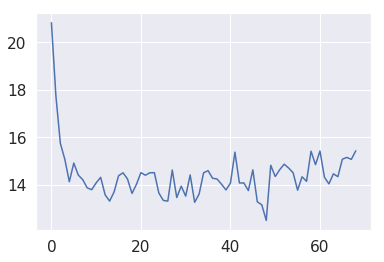

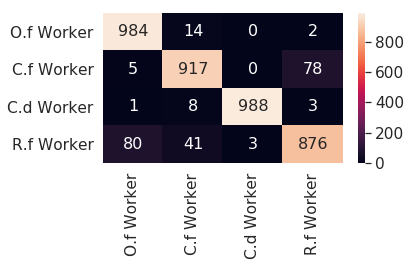

2 2
1 1
3 3
2 2
2 2
0 0
1 1
1 1
0 0
2 2
1 1
2 2
1 1
0 0
2 2
0 0
2 2
3 3
2 2
2 2
2 2
2 2
3 1
1 1
2 2
3 3
2 2
1 1
3 3
3 3
1 1
3 3
3 3
2 2
0 0
3 3
2 2
1 1
2 2
0 0
0 0
0 0
0 1
1 3
3 3
3 3
1 1
0 0
1 1
2 2
3 3
3 3
3 3
0 0
3 3
1 1
2 2
0 0
2 2
2 2
0 0
2 2
2 2
3 0
3 3
0 0
0 0
3 3
2 2
1 1
3 3
0 0
2 2
1 1
1 3
0 0
3 3
1 1
0 0
1 1
1 1
1 1
3 3
0 0
0 0
3 3
2 2
1 1
0 0
2 2
1 1
0 0
2 2
0 0
0 0
1 1
2 2
1 1
3 3
2 2
0 0
2 2
1 1
1 1
2 2
0 0
0 0
1 1
0 0
2 2
3 3
1 1
0 0
3 3
0 0
0 0
2 2
2 2
3 1
0 0
3 3
2 2
1 1
2 2
0 0
0 0
2 2
3 3
0 0
0 0
3 3
1 1
2 2
0 0
2 2
3 3
0 0
0 0
3 3
2 2
3 3
2 2
2 2
3 3
2 2
2 2
2 2
3 3
3 3
2 2
2 2
2 2
2 2
1 1
1 1
0 0
1 1
2 2
3 1
2 2
3 3
0 0
3 3
1 1
1 1
3 3
1 1
1 1
0 0
2 2
1 1
1 3
1 1
2 2
0 0
1 1
2 2
3 0
3 3
0 0
3 3
1 1
2 2
0 0
0 0
1 1
3 3
3 3
1 1
0 0
3 1
1 3
2 2
1 1
0 0
2 2
3 3
1 3
2 2
1 1
1 1
1 1
3 3
3 3
0 0
1 1
1 1
0 0
2 2
0 0
2 2
2 2
3 3
0 0
1 1
0 0
3 3
3 1
1 0
3 3
3 3
3 3
2 2
0 0
1 1
2 2
1 1
1 1
3 3
0 0
0 0
3 3
1 1
1 1
0 0
2 2
2 2
1 1
1 1
1 3
2 2
0 0
1 1
0 0
3 3
1 1
3 3
3 0
2 2
3 3


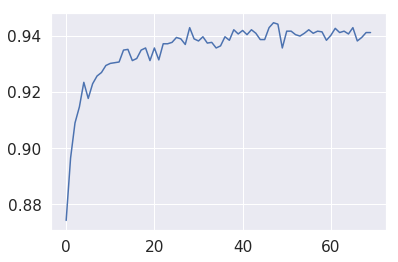

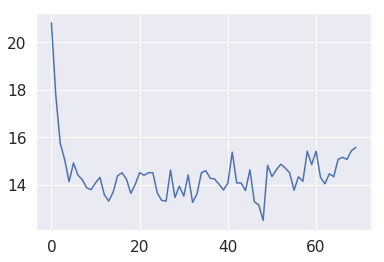

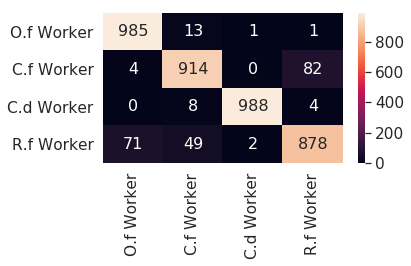

1 1
3 3
1 1
1 1
2 2
2 2
3 3
2 2
2 2
2 2
3 3
0 0
3 3
0 0
0 0
1 1
2 2
0 0
2 2
0 0
2 2
1 1
3 3
1 1
3 1
0 0
1 1
3 0
2 2
0 0
1 1
0 0
2 2
2 2
0 0
1 1
0 0
3 3
2 2
0 0
2 2
1 1
0 0
3 3
1 1
2 2
3 3
2 2
2 2
3 3
0 0
3 3
0 0
0 0
1 1
3 3
2 2
1 1
0 0
2 2
3 3
0 0
3 3
1 1
0 0
0 0
1 1
3 3
0 0
1 1
2 2
0 0
1 1
3 3
1 1
3 3
1 1
0 0
3 3
0 0
1 1
2 2
0 0
0 0
0 0
2 2
0 0
0 0
3 0
1 1
0 0
1 1
3 3
2 2
1 1
0 0
2 2
2 2
1 1
0 0
3 3
1 1
2 2
3 3
3 3
0 0
1 3
3 3
2 2
3 3
1 1
3 0
2 2
1 1
1 1
1 3
1 1
2 2
1 1
0 0
3 3
3 3
1 1
2 2
3 3
1 1
1 1
2 2
1 1
1 1
3 0
2 2
0 0
1 1
2 2
0 0
3 1
3 3
0 1
1 1
0 0
3 3
1 1
0 0
0 0
3 3
2 2
3 3
0 0
2 3
0 0
1 1
3 3
0 0
3 0
2 2
2 2
3 3
1 1
2 2
0 0
3 3
2 2
2 2
3 3
3 3
2 2
1 1
1 1
0 0
0 0
2 2
2 2
0 0
1 1
3 3
0 0
1 1
2 2
2 2
3 3
3 3
3 3
3 1
3 3
3 3
0 0
3 3
0 0
2 2
2 2
3 3
1 1
2 2
0 0
1 1
3 3
1 1
2 2
2 2
2 1
0 0
2 2
2 2
2 2
2 2
3 3
2 2
2 2
0 0
3 3
3 3
1 1
2 2
1 1
1 1
0 0
3 3
1 1
0 0
0 0
1 1
2 2
0 0
2 2
3 3
3 3
3 0
1 1
0 0
2 2
3 3
3 3
0 0
1 1
3 1
0 0
0 0
1 1
2 2
3 3
2 2
0 0
3 3
2 2
0 0
2 2
3 3
0 0
0 0


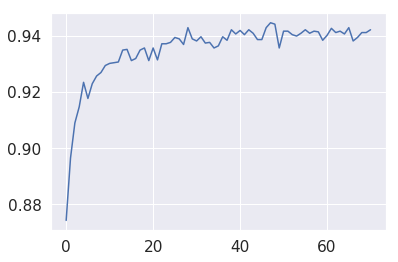

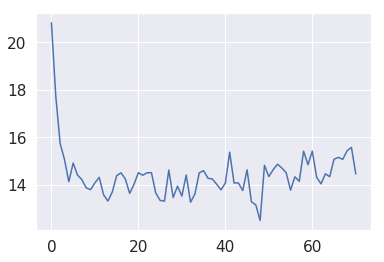

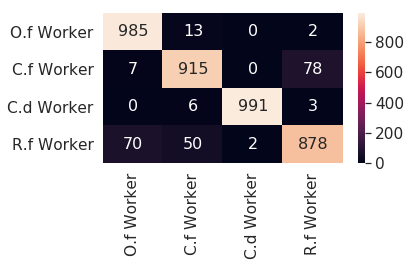

2 2
2 2
0 0
2 2
2 2
3 3
1 1
1 1
3 3
2 2
1 1
1 1
2 2
2 2
0 0
1 3
0 0
1 1
0 0
1 1
3 1
1 1
3 3
3 3
1 1
2 2
1 3
0 0
0 0
1 1
2 2
0 0
0 0
3 3
0 0
3 3
3 3
0 0
1 3
1 1
1 1
0 0
2 2
0 0
2 2
2 1
2 2
2 2
0 0
2 2
3 3
0 0
1 1
3 3
0 0
0 0
1 1
3 3
2 2
3 3
3 3
3 3
2 2
0 0
1 1
2 2
3 3
2 2
3 3
2 2
2 2
0 0
1 1
3 3
2 2
2 2
3 3
0 0
2 2
2 2
0 0
0 0
1 1
0 0
2 2
0 0
2 2
2 2
2 2
3 3
3 2
1 3
2 2
3 3
2 2
0 0
1 1
1 1
3 0
3 3
0 0
0 0
3 0
1 1
2 2
1 1
3 3
0 0
1 1
2 2
1 1
3 3
2 2
0 0
0 0
0 0
3 3
0 0
1 1
3 3
1 1
1 3
0 0
3 3
1 1
1 1
1 1
0 0
1 1
2 2
2 2
3 3
0 0
2 2
2 2
2 2
2 2
0 0
2 2
1 1
2 2
2 3
2 2
2 2
3 3
1 1
1 1
2 2
1 1
2 2
2 2
2 2
3 3
3 3
3 3
3 0
0 0
0 0
3 3
1 1
3 3
0 0
3 3
1 1
0 0
1 1
2 2
3 3
0 0
0 0
0 0
3 3
2 2
1 1
3 3
3 1
1 1
3 3
1 1
2 2
2 2
2 2
2 2
3 3
1 1
0 0
3 3
2 2
1 1
0 0
0 0
0 0
0 0
0 0
3 3
3 3
0 0
3 3
0 0
1 1
1 1
2 2
1 1
0 0
1 1
0 0
2 2
3 3
2 2
1 1
0 0
2 2
2 2
3 3
1 1
3 3
3 3
0 0
1 1
2 2
0 0
0 0
2 2
3 3
2 2
3 3
3 3
0 0
0 0
0 0
1 1
0 0
0 0
1 1
3 3
3 3
2 2
2 2
2 2
3 3
1 1
1 1
0 0
0 0
3 3
2 2
0 0
3 3
1 1
3 3


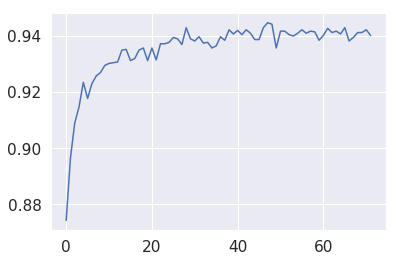

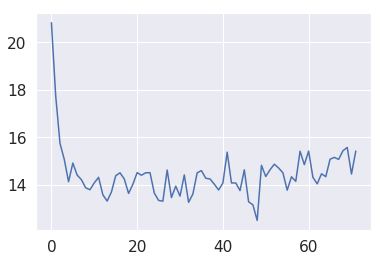

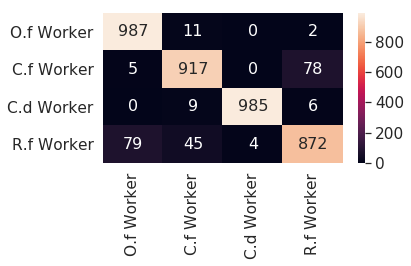

3 3
2 3
2 2
1 1
1 1
3 3
3 3
3 3
0 0
0 0
0 0
0 0
2 2
3 3
0 0
0 0
2 1
0 0
3 3
1 1
3 3
0 0
3 3
2 2
3 3
2 2
1 3
1 1
0 0
3 3
3 3
1 1
1 1
2 2
2 2
0 0
2 2
2 2
0 0
3 3
1 1
3 3
0 0
0 0
0 0
1 1
3 3
1 1
0 0
0 0
2 2
2 2
0 0
3 3
3 3
1 1
1 1
0 0
2 2
2 2
0 0
0 0
1 1
1 1
1 1
1 1
1 1
3 3
1 1
0 0
0 0
2 2
3 3
2 2
3 3
2 2
0 0
1 1
0 0
1 1
0 0
1 1
1 1
2 2
0 0
3 3
2 2
2 2
0 0
0 0
1 1
2 2
2 2
0 0
2 2
0 0
2 2
3 3
0 0
1 1
0 0
3 0
0 0
0 0
1 1
3 3
1 1
0 0
1 1
2 2
0 0
3 3
3 3
0 0
2 2
1 1
1 1
2 2
3 3
2 2
1 1
2 2
1 1
0 0
3 3
3 3
2 2
0 0
3 3
3 3
0 0
2 2
0 0
2 2
2 2
2 2
2 2
1 1
3 3
0 0
1 1
1 1
3 3
0 0
1 1
0 0
0 0
2 2
1 1
0 0
3 3
3 3
3 3
0 0
3 3
0 0
0 0
0 0
2 2
0 0
3 3
3 3
2 2
2 2
2 2
1 1
3 3
0 0
1 1
1 1
3 3
2 2
0 0
3 3
2 2
0 0
2 2
3 3
3 3
2 2
3 3
1 1
0 0
0 0
0 0
1 1
0 0
3 3
3 3
2 2
3 3
0 0
3 3
2 2
0 0
3 3
0 0
3 3
3 3
3 3
0 0
3 3
0 0
1 1
3 0
1 1
0 0
3 3
2 1
2 2
2 2
0 0
1 1
2 2
1 1
3 1
0 0
0 0
1 1
2 2
3 3
0 0
3 3
2 2
0 0
3 3
2 2
2 2
3 3
2 2
1 1
3 3
0 0
2 2
2 2
1 1
2 2
0 0
3 3
1 1
1 1
2 2
1 1
2 2
3 3
3 3
1 1
0 0
3 3
2 2


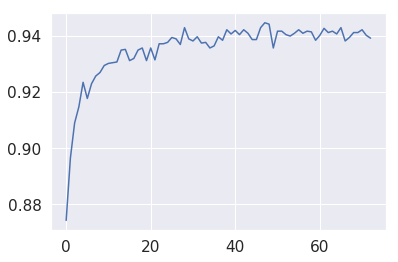

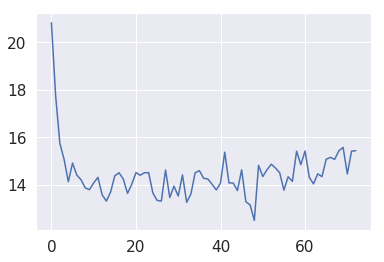

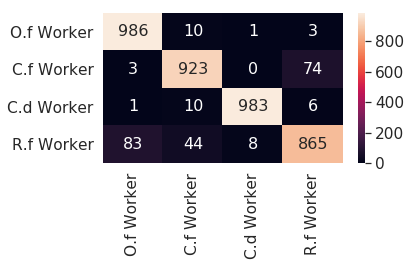

2 2
3 3
3 3
1 1
3 3
0 0
1 1
1 1
3 3
2 2
2 2
0 0
1 1
3 3
2 2
0 0
1 1
2 2
0 0
1 0
2 2
3 3
1 1
1 1
1 1
2 2
1 1
3 3
0 0
0 0
2 2
3 3
1 1
0 0
3 3
3 1
1 1
3 3
0 0
3 3
2 2
1 1
3 0
0 0
1 1
0 0
3 3
1 1
2 2
1 3
0 0
3 3
2 2
3 0
3 3
2 2
2 2
1 3
2 2
3 3
3 3
0 0
2 2
1 1
1 1
3 3
3 3
2 2
2 2
2 2
0 0
2 2
2 2
2 2
2 2
1 1
2 2
3 0
1 1
0 0
2 2
0 0
0 0
1 1
0 0
2 2
3 3
0 0
1 1
1 1
1 1
1 3
1 1
1 1
3 3
2 2
0 0
0 0
0 0
0 0
2 2
2 2
1 1
1 1
3 3
1 1
2 2
1 1
2 2
3 3
3 3
1 1
1 1
1 1
1 1
0 0
0 0
1 1
2 2
3 3
3 3
0 0
2 2
3 3
1 1
0 0
2 2
0 0
0 0
1 1
3 1
0 0
0 0
1 1
0 0
1 1
1 3
3 3
1 1
3 1
3 0
2 2
1 1
3 3
0 0
3 3
0 0
2 2
0 0
2 2
2 2
2 2
3 3
2 2
2 2
1 1
3 3
2 2
2 2
0 0
1 3
1 1
2 2
0 0
3 3
0 0
0 0
2 2
2 2
2 2
2 2
1 1
3 3
1 1
1 1
1 1
2 2
3 3
3 3
2 2
1 1
1 1
3 3
1 1
0 0
2 2
1 1
2 2
1 1
1 1
3 3
1 1
0 0
0 0
2 2
3 3
2 2
3 3
3 3
2 2
1 1
0 0
1 0
1 1
2 2
2 2
1 1
0 0
2 2
1 1
0 0
2 2
1 1
2 2
3 3
0 0
2 2
2 2
1 1
1 1
0 0
3 3
0 0
2 2
2 2
3 3
3 3
1 1
1 1
3 1
2 2
1 3
2 2
0 0
3 3
1 1
3 3
2 2
2 2
1 1
0 0
3 3
0 0
3 3
0 0
1 1
0 0
3 3
1 1
1 1


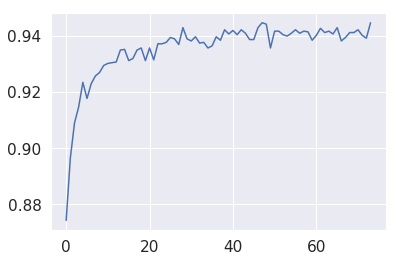

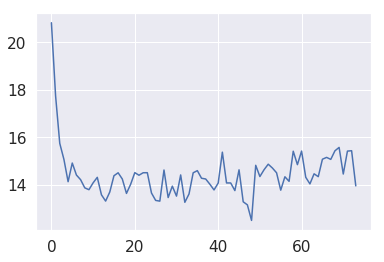

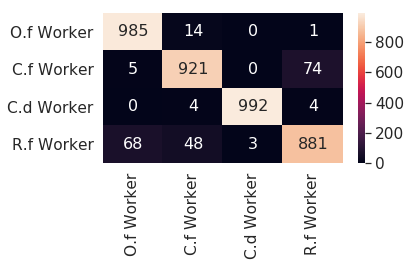

0 0
0 0
2 2
0 0
1 1
0 0
0 0
2 2
3 3
0 0
0 0
3 3
1 1
0 0
2 2
0 1
3 3
2 2
1 1
0 0
1 1
3 0
2 2
2 2
0 0
1 1
3 3
0 0
3 3
0 0
2 2
3 1
1 1
3 3
2 2
1 1
2 2
0 0
2 2
1 1
1 1
3 3
0 0
1 1
1 1
1 1
1 3
0 0
3 3
0 0
1 1
3 3
3 3
0 0
3 3
2 2
3 3
3 3
0 0
2 2
3 3
2 2
1 1
2 2
3 3
0 0
3 3
3 3
3 3
2 2
0 0
0 0
0 0
3 1
0 1
0 0
3 3
2 2
3 3
0 0
2 2
0 0
0 0
0 0
3 3
3 3
0 0
0 0
3 3
3 3
2 2
3 3
0 0
1 1
2 2
0 0
0 0
1 3
2 2
0 0
2 2
2 2
1 1
2 2
3 3
2 2
1 1
3 3
0 0
2 2
2 2
0 0
0 0
2 2
1 1
0 0
0 0
3 3
3 3
0 0
1 1
2 2
2 2
0 0
0 0
1 1
2 2
3 0
1 1
0 0
2 2
0 0
3 3
2 2
0 0
2 2
2 2
1 1
2 2
1 1
1 1
2 2
3 3
0 0
3 3
3 3
2 2
1 1
1 1
1 1
1 1
2 2
0 0
3 3
0 0
2 2
2 2
0 0
2 2
0 0
0 0
3 3
2 2
0 0
1 1
1 1
2 2
3 3
3 3
2 2
2 2
1 1
1 1
0 0
0 0
3 3
3 3
2 2
2 2
0 0
0 0
1 1
3 3
1 1
0 0
1 1
1 1
2 2
3 1
0 0
2 2
1 1
2 2
3 3
3 3
0 0
1 1
1 1
3 3
2 2
2 2
3 3
0 0
0 0
0 0
0 0
1 1
1 1
2 2
1 1
0 0
2 2
3 3
2 2
3 3
0 0
3 3
3 3
0 0
2 2
0 0
1 1
3 3
3 3
3 3
0 0
1 1
1 1
1 1
0 0
1 1
0 0
3 3
1 1
3 3
2 2
2 2
0 1
1 1
2 2
3 3
0 0
2 2
1 1
3 3
2 2
0 0
0 0
0 0
0 0


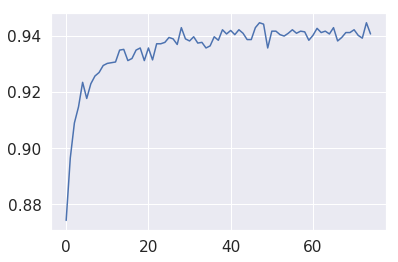

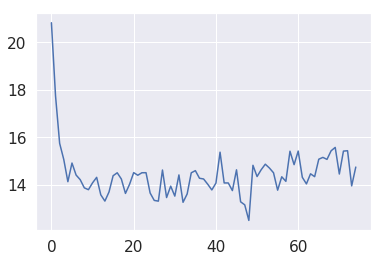

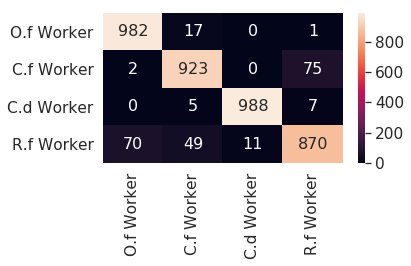

1 3
1 1
2 2
2 2
3 3
2 2
3 3
2 2
2 2
1 1
0 0
0 0
1 1
2 2
0 0
0 0
3 3
0 0
2 2
3 3
2 1
2 2
3 3
0 0
2 2
3 3
2 2
3 3
2 2
2 2
1 1
0 0
2 2
3 3
2 2
1 1
2 2
2 2
3 3
3 3
1 1
1 1
0 0
2 2
3 3
2 2
3 3
2 2
2 3
2 2
2 2
2 2
3 3
3 3
3 3
3 3
0 0
0 0
2 2
2 2
3 3
0 0
1 1
1 3
0 0
1 1
0 0
2 2
1 1
3 3
1 1
3 3
2 2
1 1
2 2
2 2
3 1
3 3
1 1
3 3
0 0
3 3
2 2
0 0
2 2
1 1
3 3
0 0
1 1
3 3
2 2
1 1
1 1
2 2
0 0
2 2
2 2
0 0
2 2
0 0
0 0
0 0
0 0
3 3
1 1
2 2
3 1
1 1
3 1
1 1
1 1
0 0
0 0
2 2
0 0
0 0
1 3
0 0
3 3
1 3
3 3
0 0
2 2
2 2
3 3
2 2
2 2
3 3
1 1
2 2
1 1
1 1
3 3
2 2
0 0
2 2
1 1
1 1
1 1
2 2
2 2
0 0
0 0
3 3
1 1
2 2
3 1
0 0
1 1
0 1
0 0
3 0
1 1
3 3
0 0
3 3
2 2
2 2
0 0
1 1
3 3
3 3
0 0
3 3
1 1
0 0
1 1
1 0
3 3
2 2
2 2
3 3
0 0
1 1
2 2
1 1
1 1
2 2
3 3
2 2
1 1
2 2
0 0
3 3
1 3
0 0
2 2
0 0
2 2
1 1
3 3
0 0
1 1
3 0
1 1
0 0
0 0
0 0
3 3
2 2
2 2
1 1
3 3
0 0
2 2
2 2
3 3
3 3
0 0
3 3
2 2
1 1
0 0
1 1
2 2
2 2
0 0
0 0
2 2
1 1
1 1
1 1
3 3
1 1
0 0
2 2
1 1
0 0
1 1
1 1
0 0
0 0
3 3
3 3
1 1
1 1
0 0
2 2
1 1
3 3
1 1
0 0
1 1
1 1
1 1
3 3
3 3
2 2
0 0
3 3


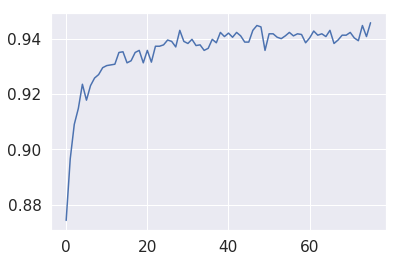

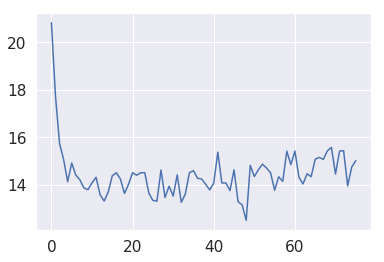

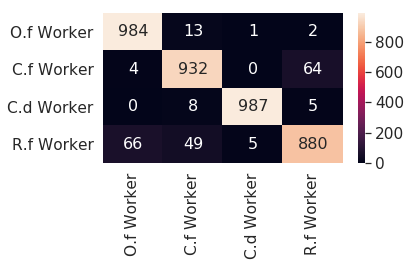

0 0
3 3
1 3
2 2
0 0
3 3
1 1
0 0
1 1
0 0
3 3
0 0
3 3
2 2
0 0
2 2
2 2
1 1
2 2
0 0
2 2
3 3
3 3
1 1
2 2
2 2
1 1
0 0
2 2
1 1
1 1
3 3
1 1
3 3
3 1
0 0
0 0
2 2
2 2
3 3
0 0
0 0
1 1
1 1
2 2
3 3
1 1
0 0
0 0
2 2
1 1
3 3
1 1
2 2
1 1
1 3
0 0
3 3
2 2
0 0
3 3
2 2
1 1
2 2
0 0
0 0
0 0
0 0
2 2
1 1
2 2
1 1
0 0
1 1
1 1
2 2
3 3
2 2
1 1
1 1
0 0
3 3
2 2
1 3
3 3
2 2
0 0
1 1
3 3
0 0
3 3
1 1
2 2
1 1
1 1
3 3
1 1
1 1
1 1
3 3
0 0
2 2
2 2
3 3
2 2
0 0
3 3
1 3
1 1
3 3
3 3
0 0
1 1
2 2
1 1
1 1
3 3
0 0
0 0
2 2
0 0
1 1
1 1
1 3
3 3
1 1
1 1
3 3
0 0
2 2
2 2
0 0
0 0
0 1
0 0
3 3
1 1
2 2
0 0
1 1
3 3
0 0
2 2
0 0
0 0
2 2
3 3
2 2
1 1
0 0
3 3
2 2
1 3
0 0
0 0
2 2
1 1
1 1
1 1
2 2
0 0
3 3
2 2
3 3
0 0
2 2
1 1
0 0
3 3
2 2
0 0
0 0
2 2
1 1
0 0
0 0
0 0
2 2
1 3
2 2
2 2
1 1
3 3
0 0
3 3
3 3
0 0
1 1
0 0
2 2
2 2
2 2
3 3
2 2
2 2
0 0
3 3
3 3
3 3
1 1
2 2
3 3
2 2
1 1
2 1
1 1
0 0
1 1
2 2
0 0
2 2
2 2
2 2
2 2
0 0
1 1
3 3
0 0
0 0
1 1
1 1
2 2
0 0
0 0
3 0
3 3
1 1
0 0
3 3
0 0
3 3
0 0
2 2
3 3
3 1
3 3
1 1
2 2
2 2
3 3
0 0
2 2
1 1
2 2
2 2
3 3
1 1
0 0
1 1
2 2


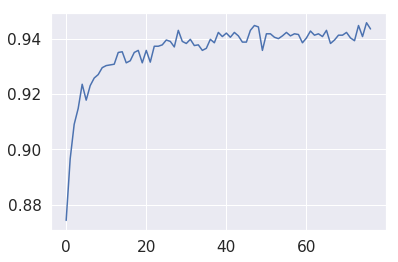

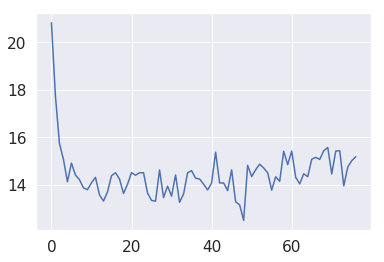

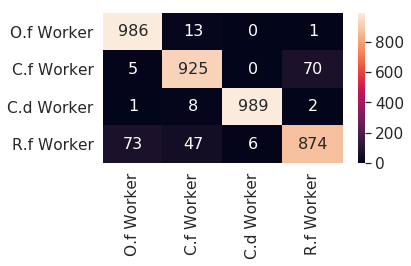

0 0
3 3
3 3
3 3
1 1
1 1
1 1
3 3
3 3
0 0
1 1
3 3
1 1
2 2
0 0
1 1
2 2
0 0
2 2
1 1
1 1
2 2
0 0
1 1
2 2
1 1
0 0
3 3
2 2
1 1
0 0
0 0
2 2
0 0
2 2
1 1
2 2
1 1
3 3
1 1
3 0
0 0
1 1
3 3
3 3
3 3
0 0
3 3
3 3
0 0
2 2
3 3
0 0
1 1
0 0
3 0
1 1
2 2
3 3
3 3
2 2
3 3
0 0
1 1
1 1
1 1
1 1
2 2
0 0
3 3
2 2
2 2
2 2
2 2
1 1
3 3
1 1
2 2
2 2
0 0
2 2
1 3
1 1
0 0
2 2
0 0
3 3
0 0
3 3
1 1
0 0
2 2
0 0
1 3
2 2
2 2
2 2
3 3
3 3
3 3
3 3
1 1
0 0
1 1
1 1
1 1
1 1
3 3
0 0
0 0
2 2
3 3
0 0
1 1
3 3
0 0
2 2
0 0
3 3
3 3
2 2
1 1
0 0
0 0
2 2
3 3
0 0
1 1
1 1
0 0
0 0
3 3
2 2
0 0
0 0
2 2
2 2
3 3
0 0
3 3
0 0
3 3
2 2
1 1
1 1
2 2
2 2
0 0
2 2
2 2
0 0
1 3
0 0
3 3
1 1
0 0
0 0
3 3
0 0
0 0
3 3
1 1
0 0
1 1
2 2
2 2
1 1
2 2
1 1
2 2
3 3
1 1
3 3
0 0
0 0
2 2
2 2
3 3
0 0
2 2
0 0
1 1
1 1
1 3
0 0
2 2
1 1
2 2
2 2
3 3
3 3
2 2
1 1
2 2
2 2
3 3
2 2
0 0
0 0
1 1
2 2
3 3
0 0
2 2
1 1
3 3
3 3
3 3
3 3
0 0
0 0
3 3
0 0
1 1
2 2
3 3
3 3
0 0
0 0
3 3
1 1
2 2
2 2
1 1
0 0
2 2
3 3
1 1
0 0
2 2
3 3
1 1
0 0
1 1
0 0
3 3
2 2
3 3
3 2
0 0
2 2
2 2
0 0
0 0
3 3
2 2
2 2
0 0
3 3
1 1


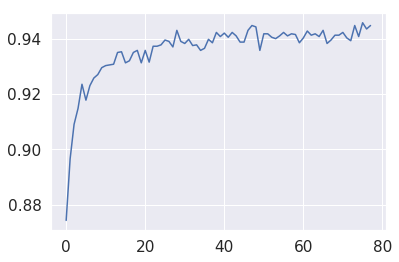

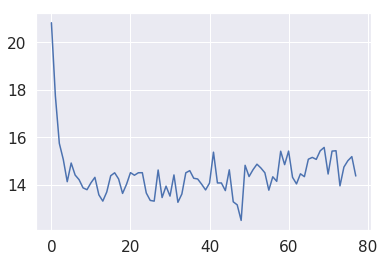

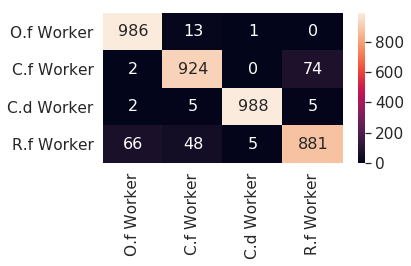

1 1
2 2
2 2
1 1
0 1
2 2
0 0
3 3
1 1
0 0
0 0
1 1
0 0
1 1
0 0
1 1
2 2
2 2
3 3
3 3
0 0
1 1
2 2
0 0
0 0
0 0
1 1
1 3
3 3
0 0
0 0
2 2
2 2
3 3
0 0
3 3
0 0
2 2
2 2
0 0
0 0
0 0
1 1
1 1
0 0
2 2
2 2
1 1
1 3
2 2
0 0
1 1
1 1
0 0
2 2
0 0
3 3
2 2
2 2
3 3
2 2
1 3
3 3
0 0
2 2
0 0
2 2
2 2
1 1
2 2
1 1
2 2
0 0
0 0
2 2
1 3
3 3
1 1
1 1
3 3
3 3
3 3
0 0
3 3
1 1
2 2
0 0
1 1
1 1
2 3
3 3
0 0
0 0
2 2
2 2
2 2
3 3
2 2
1 1
1 1
2 2
2 2
0 0
2 2
2 2
2 1
2 2
0 0
1 1
1 1
0 0
2 2
0 0
2 2
0 0
0 0
2 2
1 1
0 0
2 2
2 2
1 1
0 0
3 3
3 3
3 3
1 1
1 1
2 2
3 3
3 3
0 0
1 1
2 2
2 2
3 3
2 2
2 2
0 0
0 0
1 3
1 1
0 0
2 2
2 2
0 0
1 1
1 1
3 3
1 1
0 0
1 1
1 1
1 1
2 2
3 3
1 1
1 1
0 0
1 1
2 2
0 0
3 3
0 0
0 0
1 1
3 3
0 0
0 0
0 0
3 3
2 2
3 3
2 2
2 2
3 3
0 0
3 3
1 1
3 3
1 1
2 2
1 1
1 1
2 2
3 1
2 2
3 3
3 3
2 2
0 0
2 2
1 1
0 0
2 2
3 3
0 0
2 2
3 3
3 3
3 3
3 1
3 3
0 0
1 1
0 0
2 1
3 3
1 3
1 1
0 0
0 0
3 1
0 0
0 0
1 1
1 1
1 1
0 0
1 1
1 1
1 1
1 1
2 2
1 1
3 3
0 0
3 3
0 0
3 3
3 3
2 2
3 3
3 3
2 2
2 2
2 2
1 1
1 1
0 0
2 2
1 3
3 3
2 2
1 1
2 2
0 0
2 2
0 0
1 1


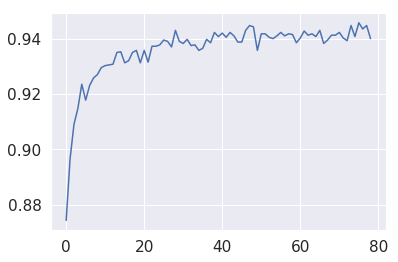

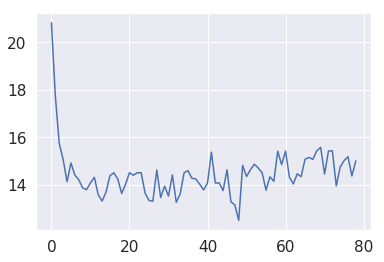

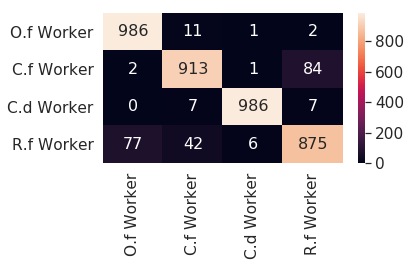

3 3
0 0
3 3
0 0
1 1
1 1
3 3
3 3
1 1
2 2
3 3
1 1
1 1
1 1
0 0
3 3
0 0
0 0
2 2
0 0
0 0
0 0
3 3
1 1
3 3
0 0
0 0
2 2
0 0
1 3
1 1
3 3
2 2
2 2
2 2
3 3
1 1
0 0
1 1
1 1
1 1
0 0
0 0
0 0
0 0
0 0
1 1
2 2
0 0
1 1
0 0
2 2
2 2
1 3
2 2
0 1
3 3
2 2
3 3
3 0
2 2
0 0
1 1
2 2
1 1
0 0
0 0
0 0
3 3
1 1
0 0
2 2
3 3
3 3
0 0
3 3
2 2
1 1
2 2
1 1
0 0
1 1
1 1
1 1
2 2
1 1
3 1
1 1
1 1
0 0
3 3
1 1
0 0
2 2
2 2
3 3
0 0
0 0
1 1
3 3
0 0
2 2
0 0
0 0
2 2
0 0
1 1
3 3
2 2
2 2
3 3
2 2
0 0
3 3
2 2
3 3
2 2
3 3
1 1
1 1
2 2
0 0
3 3
3 3
1 1
3 3
0 0
1 3
2 2
3 3
1 1
2 2
3 3
3 3
3 3
1 3
1 1
1 1
3 3
0 0
1 1
2 2
3 3
3 3
2 2
3 3
1 1
0 0
0 0
3 3
1 1
1 1
2 2
1 1
2 2
3 3
0 0
2 2
2 2
1 1
1 1
1 3
0 0
1 3
1 1
1 1
1 1
2 2
3 3
0 0
1 1
1 1
3 3
0 0
3 3
1 1
0 0
2 2
0 0
0 0
3 3
2 2
1 1
1 1
3 3
2 2
3 0
3 0
0 0
0 0
0 0
0 0
1 1
0 0
0 0
1 1
3 3
2 2
1 1
2 2
2 2
2 2
2 2
0 0
1 1
0 0
0 0
1 1
2 2
2 2
2 2
2 2
3 1
1 1
0 0
1 1
1 3
1 1
2 2
0 0
2 2
1 1
0 0
2 2
1 3
2 2
3 3
2 2
0 0
3 3
1 1
0 0
1 1
3 3
3 3
0 0
0 0
0 0
1 1
1 1
0 0
3 3
0 0
1 1
0 0
3 3
1 1
1 1
0 0
2 2


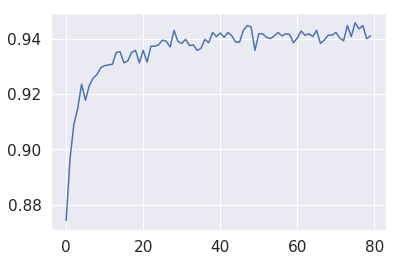

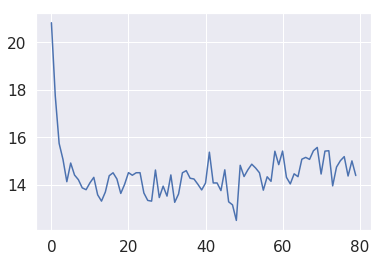

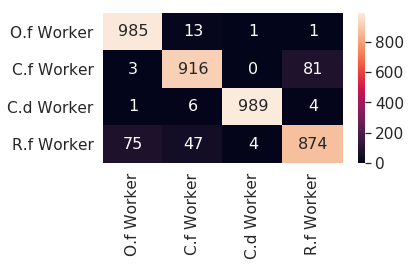

1 1
1 1
0 0
2 2
1 3
2 2
1 1
3 3
0 0
0 0
0 0
2 2
2 2
3 3
0 0
2 2
1 1
2 2
0 0
0 0
0 0
0 0
0 0
2 2
1 1
1 1
0 0
1 1
0 0
0 0
2 2
3 3
0 0
0 0
2 2
0 0
3 3
0 0
3 3
0 0
2 2
2 2
0 0
2 2
0 0
3 1
2 2
3 3
3 3
3 3
3 3
0 0
3 3
2 2
0 0
2 2
3 3
1 1
3 3
1 1
3 3
3 3
1 1
3 3
3 3
2 2
3 3
1 1
1 1
3 3
1 1
1 1
1 1
1 0
0 0
0 0
2 2
2 2
1 1
1 1
2 2
3 3
3 3
0 0
2 2
3 3
3 3
2 2
0 0
2 2
2 3
1 1
2 2
3 3
2 2
1 1
2 2
0 0
0 0
3 3
2 3
0 0
2 2
1 1
1 1
0 0
1 1
0 0
2 2
2 2
2 2
2 2
1 1
0 0
2 2
3 3
1 1
0 0
2 2
2 2
1 1
3 3
1 1
2 2
2 2
0 0
2 1
2 2
0 0
0 0
2 2
2 2
1 1
3 3
1 1
0 0
2 2
3 3
1 1
3 3
1 1
1 1
1 1
2 2
2 2
0 0
3 0
2 2
0 0
0 0
0 0
2 2
1 3
3 3
0 0
3 3
1 1
0 0
0 0
0 0
0 0
2 2
2 2
0 0
0 0
3 3
0 0
0 0
3 3
3 3
2 2
3 3
3 3
3 3
3 3
0 0
3 3
0 0
2 2
1 1
0 0
2 2
2 2
1 1
0 0
2 2
3 0
1 1
3 3
0 0
2 2
2 2
0 0
3 3
3 3
2 2
3 3
1 1
1 1
3 3
0 0
0 0
0 0
0 0
0 0
3 3
2 2
2 2
1 1
3 3
1 1
1 1
1 1
3 3
3 3
0 1
1 1
1 1
0 0
2 2
2 2
2 2
1 1
3 3
2 2
3 3
3 1
3 3
0 0
3 3
2 2
1 1
1 1
3 3
1 1
1 1
3 3
1 3
0 0
3 3
2 2
0 0
2 2
0 0
2 2
1 1
0 0
2 2
3 0
2 2


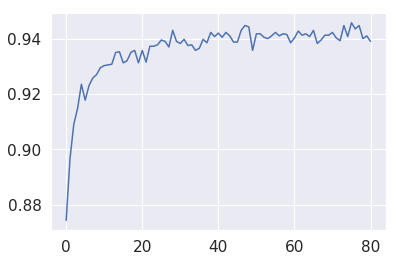

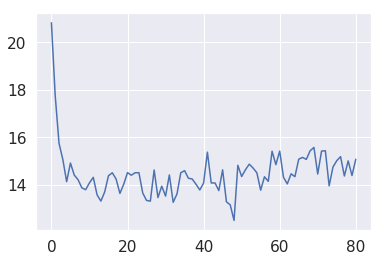

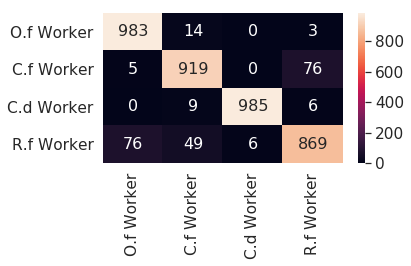

2 2
2 2
2 2
2 2
0 0
0 0
1 1
1 1
3 3
3 3
2 2
2 2
1 1
2 2
2 2
1 1
0 0
1 1
2 2
1 1
1 1
3 3
1 3
0 0
0 0
3 3
0 0
3 3
2 2
3 3
0 0
3 3
0 0
1 1
3 3
3 3
3 3
3 3
1 1
1 1
2 2
1 1
1 1
0 0
3 3
3 3
3 3
2 2
2 2
1 1
3 3
2 2
1 1
1 1
0 0
3 3
0 0
2 2
0 0
3 3
2 2
1 1
3 3
3 3
2 2
0 0
0 0
3 3
0 0
1 1
3 3
2 2
0 0
0 0
1 1
3 3
3 3
3 3
2 3
2 2
3 3
0 0
1 1
3 0
1 1
3 3
0 0
1 1
2 2
1 1
3 3
1 1
0 0
2 2
2 2
1 1
3 3
0 0
2 2
0 0
2 2
2 2
0 0
3 3
3 3
2 2
1 1
1 1
3 3
3 3
1 1
2 2
1 1
3 3
2 2
0 0
3 0
2 2
3 3
2 2
0 0
3 3
2 2
2 2
1 1
0 0
2 2
3 0
3 3
0 0
3 3
0 0
1 1
2 2
0 0
0 0
0 0
0 0
1 1
3 3
1 1
0 0
2 2
1 1
2 2
2 2
1 1
1 1
0 0
1 3
1 1
2 2
0 0
3 3
2 2
1 1
2 2
0 0
1 1
1 1
3 3
1 1
3 3
3 3
3 3
2 2
1 1
3 3
2 2
2 2
0 0
1 1
2 2
0 0
2 2
2 2
0 0
0 0
2 2
3 0
2 2
0 0
1 1
3 3
1 1
1 1
2 2
0 0
1 1
3 3
1 1
2 2
2 2
0 0
3 1
0 0
2 2
1 1
0 0
2 2
1 1
2 2
2 2
2 2
0 0
2 2
3 3
3 3
2 2
1 1
3 3
1 3
3 3
2 2
3 0
3 3
1 1
2 2
2 2
3 3
1 1
1 1
3 3
3 3
0 0
1 1
0 0
3 3
0 0
0 0
2 2
1 1
1 1
0 0
0 0
2 2
2 2
1 1
0 0
0 0
2 2
0 0
0 0
2 2
3 3
0 0
3 3
1 1
3 3
2 2


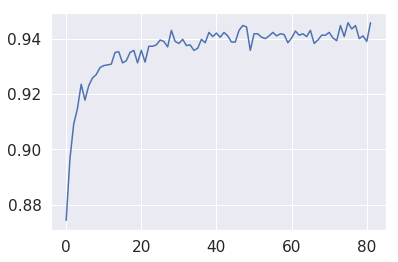

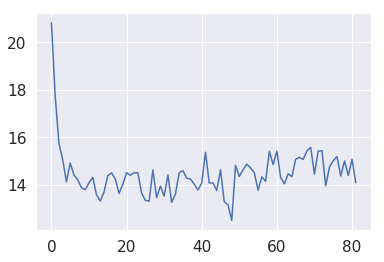

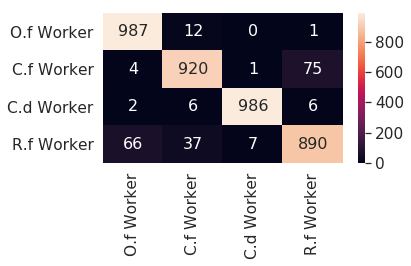

0 0
3 3
0 0
2 2
2 2
2 2
1 1
0 0
1 1
0 0
0 0
0 0
1 1
3 0
2 2
2 2
3 3
0 0
2 2
1 1
1 1
3 3
1 1
2 2
0 0
2 2
3 3
0 0
0 0
2 2
2 2
3 3
3 3
3 3
1 1
0 0
2 2
0 0
0 0
0 0
1 1
3 3
1 1
0 0
1 1
1 1
3 3
2 2
3 3
1 1
1 1
1 1
3 3
0 0
0 0
3 3
0 0
2 2
0 0
2 2
3 3
3 3
3 3
0 0
1 1
0 0
2 2
2 2
2 2
1 1
3 3
1 3
2 2
0 0
2 2
0 0
1 1
3 3
1 1
0 0
3 3
3 1
2 2
0 0
2 2
1 1
2 2
1 1
2 2
2 2
1 1
3 3
3 3
3 3
3 1
3 3
1 1
1 1
1 1
0 0
0 0
3 0
1 1
2 2
0 0
0 0
3 3
3 3
3 3
2 2
0 0
1 1
2 2
3 3
1 1
0 0
3 3
3 3
0 0
0 0
1 1
1 1
2 2
0 0
2 2
3 3
3 3
2 2
3 3
2 2
0 0
3 3
2 2
0 0
3 3
1 1
3 3
2 2
0 0
0 0
2 2
0 0
1 1
3 3
0 0
3 3
3 3
2 2
2 2
0 0
3 3
1 1
3 3
3 3
3 3
0 0
0 0
3 3
1 1
2 2
1 1
3 0
2 2
3 0
2 2
3 3
2 2
2 2
0 0
0 0
0 0
3 3
1 1
1 1
2 2
2 2
0 0
3 3
2 2
1 1
1 1
3 3
2 2
0 0
3 3
1 1
2 2
1 1
3 3
2 1
2 2
0 0
2 2
0 0
1 1
0 0
3 3
3 3
2 2
2 2
1 1
3 3
0 0
3 3
0 0
3 3
1 1
3 3
2 2
0 0
1 1
0 0
3 3
1 1
2 2
0 0
0 0
0 0
3 3
3 3
3 3
1 1
3 3
0 0
3 3
0 0
0 1
2 2
2 2
3 3
0 0
1 1
0 0
2 2
0 0
2 2
1 1
3 3
1 1
2 2
0 0
3 3
1 1
1 1
0 0
1 1
3 3
3 3
0 0
1 1


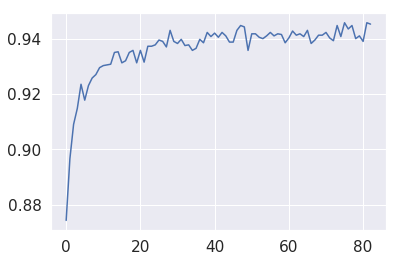

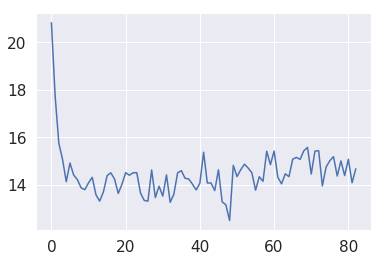

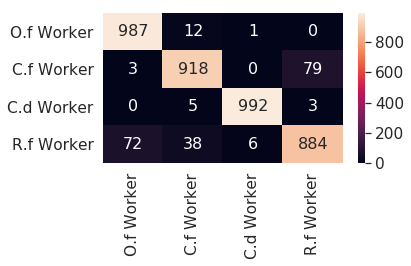

1 3
2 2
2 2
0 0
2 2
3 3
0 0
1 1
3 3
3 1
1 1
1 1
0 0
1 1
2 2
3 1
1 1
1 1
3 3
0 0
2 2
3 3
3 3
2 2
0 0
0 0
3 3
0 1
0 0
3 3
1 1
2 2
0 0
0 0
3 3
0 0
3 3
3 3
3 3
0 0
3 3
0 0
2 2
3 3
3 3
2 2
0 0
2 2
1 1
1 1
2 2
2 2
1 1
2 2
3 3
1 1
2 2
3 3
2 2
0 0
2 2
2 2
0 0
2 2
3 3
0 0
2 2
3 3
2 2
3 3
0 0
2 2
3 3
0 0
0 0
3 3
0 0
1 1
0 0
0 0
1 1
3 3
1 1
3 3
2 2
1 1
3 3
0 0
0 0
0 0
1 1
3 3
2 2
0 0
3 3
3 3
1 1
1 1
1 1
3 3
2 2
2 2
0 0
3 3
1 1
3 3
2 2
0 0
0 0
2 2
0 0
0 0
2 2
0 0
3 3
1 1
0 0
1 1
3 3
3 3
1 1
1 1
0 0
0 0
2 2
2 2
2 2
1 1
1 1
3 3
2 2
0 0
1 1
1 1
3 3
1 1
2 2
2 2
3 1
3 3
1 1
3 3
2 2
3 3
0 0
1 1
2 2
0 0
2 2
2 2
3 3
0 0
0 0
3 3
0 0
3 0
3 3
1 3
3 3
3 3
3 3
1 1
2 2
2 2
1 1
2 2
3 3
3 3
3 3
3 1
1 1
0 0
0 0
2 2
2 2
3 1
1 1
3 3
3 0
2 2
0 0
1 1
3 1
2 2
1 1
0 0
3 3
1 1
0 0
0 0
1 1
2 2
3 3
2 2
1 1
0 0
1 1
2 2
1 1
1 1
3 3
0 0
0 0
1 3
2 2
0 0
0 0
1 1
3 3
1 1
1 1
1 1
0 0
1 1
3 1
3 3
0 0
2 2
3 3
2 2
0 0
0 0
1 1
0 0
1 1
2 2
0 0
3 3
3 3
0 0
3 3
0 0
0 0
2 2
2 2
3 3
0 0
3 3
3 0
1 1
3 3
1 1
0 0
2 2
3 3
2 2
2 2
1 0
2 2
1 1


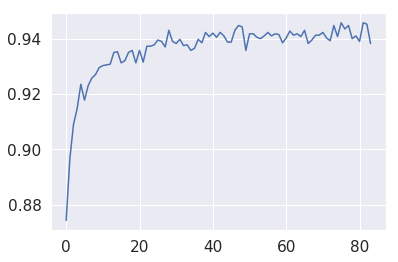

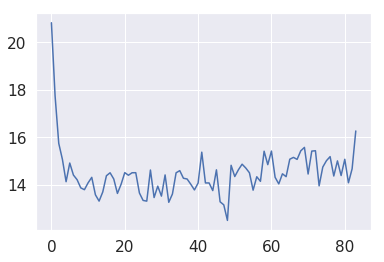

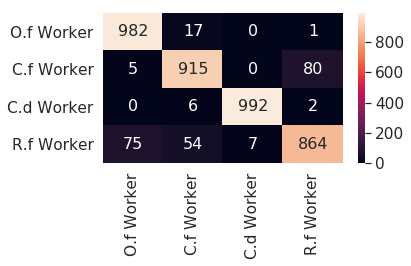

0 0
1 1
3 1
3 3
0 0
1 1
1 1
0 0
0 0
1 1
2 2
1 1
3 3
0 0
2 2
2 2
2 2
3 3
2 2
1 1
0 0
2 2
0 0
3 3
0 0
3 3
1 1
1 1
1 3
2 2
2 2
3 0
1 1
0 0
1 1
3 3
2 2
1 1
1 1
3 3
3 3
2 2
1 1
1 1
2 2
0 0
3 3
0 0
3 3
2 2
3 1
0 0
2 2
2 2
2 2
0 0
0 0
2 2
2 2
2 2
3 3
1 1
0 0
1 1
1 1
0 0
3 0
1 1
1 1
2 2
0 0
3 3
0 0
2 2
1 1
3 3
2 2
0 0
0 0
2 2
1 1
2 2
1 1
0 0
3 1
1 1
0 0
3 3
1 1
3 3
1 1
0 0
2 2
0 0
1 1
2 2
3 1
0 0
3 3
3 3
2 2
1 3
3 3
1 1
3 3
1 1
3 3
2 2
1 0
1 1
3 3
3 3
2 2
1 1
1 3
2 2
1 1
1 1
1 1
2 2
0 0
3 1
3 3
1 1
2 2
0 0
2 2
2 2
3 3
1 1
2 2
0 0
1 1
1 3
0 0
1 3
1 1
3 3
1 1
2 2
3 3
3 3
1 1
3 3
2 2
3 3
1 3
1 1
0 0
2 2
0 0
2 2
2 2
1 1
1 3
0 0
3 3
3 3
1 3
1 1
1 1
2 2
0 0
3 3
3 0
1 1
2 2
0 0
1 3
1 1
2 2
0 0
2 2
1 1
0 0
1 1
0 0
1 1
0 0
1 1
0 0
1 1
2 2
0 0
0 0
1 1
0 0
1 1
0 0
3 3
1 1
0 0
2 2
3 0
2 2
0 0
0 0
2 2
3 3
3 1
1 1
1 1
3 1
1 1
2 2
3 3
1 1
0 0
1 1
0 0
3 3
2 2
2 2
2 3
1 1
3 3
0 0
0 0
2 2
2 2
3 3
3 3
2 2
2 2
2 2
1 1
3 3
3 3
1 1
0 0
1 1
1 1
2 2
3 3
2 2
2 2
1 1
3 0
1 1
1 1
2 2
0 0
0 0
1 1
3 3
2 2
2 2
0 0
1 1
2 2


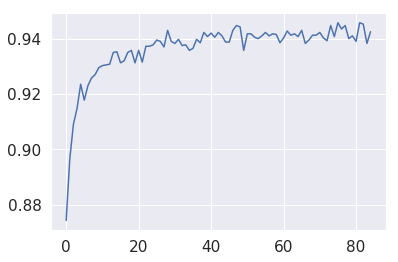

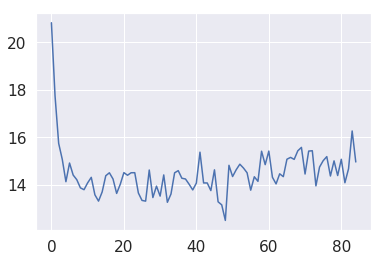

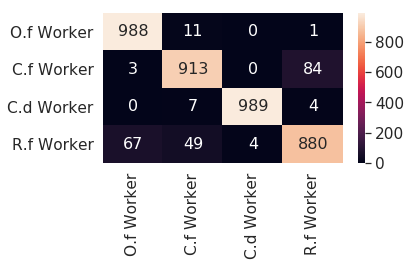

0 0
2 2
3 3
2 2
3 3
2 2
1 1
2 2
2 2
2 2
0 0
2 2
3 1
2 2
2 2
1 1
2 2
2 2
3 3
2 2
3 3
1 1
0 0
1 1
1 1
0 0
2 2
2 2
0 0
0 0
1 1
3 3
2 2
1 1
2 2
0 0
3 3
2 2
2 2
1 1
0 0
3 3
0 0
3 3
2 2
3 3
1 1
0 0
1 1
0 0
2 2
2 2
0 0
2 2
0 0
3 3
3 3
2 2
1 1
3 3
3 1
0 0
3 3
0 0
0 1
0 0
2 2
0 0
3 3
2 2
0 0
2 2
0 0
0 0
1 1
3 3
2 2
3 0
0 0
0 0
3 1
2 2
2 2
0 0
1 1
3 3
3 3
1 3
1 1
2 2
2 2
2 2
0 0
2 2
2 2
3 3
0 0
2 2
2 2
2 2
0 0
1 1
1 1
2 2
0 0
1 1
0 0
1 3
1 1
1 3
1 1
1 1
1 1
2 2
0 0
3 3
2 2
1 1
2 1
3 3
3 3
3 3
2 2
2 2
0 0
1 1
1 1
3 3
1 1
3 3
0 0
3 3
0 0
3 3
2 2
0 0
0 0
3 3
1 1
2 2
3 3
2 2
0 0
2 2
3 3
0 0
0 0
1 1
3 3
1 1
2 2
1 1
3 3
2 2
0 0
0 0
0 1
0 0
1 1
0 0
2 2
1 1
3 3
0 0
3 3
1 1
0 0
2 2
3 3
1 1
0 0
3 3
2 2
1 1
2 2
1 1
1 1
3 3
1 1
1 1
2 2
0 0
1 1
1 1
0 0
0 0
3 3
3 3
0 0
1 1
3 3
0 0
3 3
3 3
3 3
3 3
1 1
0 0
2 2
2 2
3 3
1 1
1 1
3 3
2 2
1 1
2 2
3 0
0 0
0 0
0 0
0 0
3 3
1 1
3 3
2 2
1 1
1 1
2 2
3 1
0 0
1 1
1 1
1 1
0 0
3 3
3 3
3 3
3 3
3 3
1 1
2 2
3 3
3 3
3 3
1 1
1 1
1 1
1 1
3 3
1 1
1 1
0 0
3 3
3 3
0 0
1 1
1 1
3 0
3 3


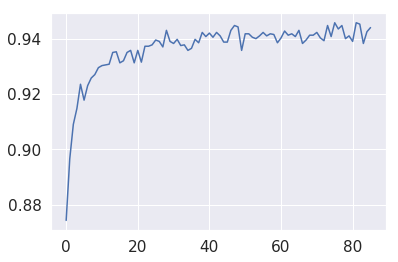

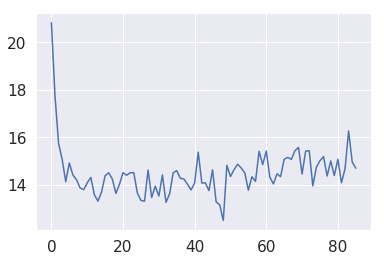

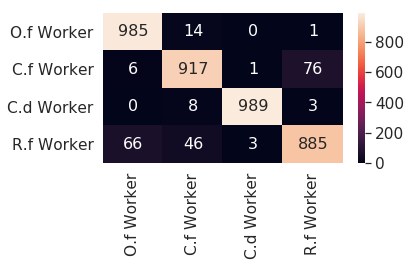

1 1
3 3
0 0
2 2
0 0
3 3
3 3
1 1
0 0
1 1
3 3
3 3
1 1
1 1
0 0
0 0
3 3
0 0
1 1
1 1
1 1
2 2
2 2
3 3
0 0
3 3
3 3
1 1
2 2
3 3
1 1
2 2
3 3
2 2
1 3
1 1
0 0
0 0
1 3
1 1
2 2
0 0
1 1
1 1
1 1
3 3
0 0
1 1
0 0
3 3
1 1
0 0
2 2
1 1
2 2
1 3
0 0
3 3
2 2
3 1
1 3
0 0
0 0
1 1
3 3
2 2
2 2
2 2
3 3
0 0
2 2
3 3
3 3
2 2
3 0
1 1
1 1
0 0
0 0
3 3
0 0
1 1
0 0
3 3
3 3
1 1
1 1
2 2
3 3
1 1
2 2
1 1
3 3
0 0
0 0
2 2
1 1
0 0
3 3
1 1
0 0
2 2
0 0
2 2
0 0
0 0
2 2
3 0
3 0
3 3
3 3
0 0
2 2
1 1
3 3
2 2
2 2
3 0
0 0
0 0
2 2
1 1
3 3
0 0
2 2
3 3
3 3
3 3
1 1
2 2
2 2
1 1
0 0
0 0
0 0
3 3
2 2
2 2
2 2
0 0
0 0
2 2
0 0
3 3
3 3
3 3
2 2
1 1
0 0
1 1
0 0
2 2
3 3
3 3
3 0
3 3
2 2
3 3
3 3
0 0
0 0
1 1
3 3
1 1
0 0
2 2
0 0
0 0
3 3
2 2
1 1
1 1
3 3
2 2
1 1
1 1
1 1
0 0
1 1
0 0
1 1
0 0
1 1
2 2
2 2
3 3
0 0
3 3
1 1
3 3
0 0
0 0
3 1
3 3
2 2
2 2
0 0
2 2
3 3
2 2
3 3
2 2
1 3
0 0
1 3
3 3
3 0
3 3
2 2
1 1
2 2
3 0
2 2
1 1
1 1
1 1
3 3
0 0
1 1
3 3
0 0
1 1
1 1
2 2
3 3
0 0
3 3
1 1
1 1
0 0
2 2
0 0
1 1
1 1
3 3
0 0
1 3
0 0
3 3
1 1
3 3
3 3
1 1
0 0
3 3
1 1
3 3
3 3
2 2
0 0


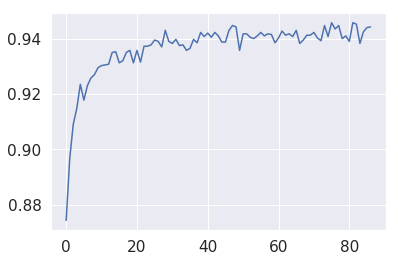

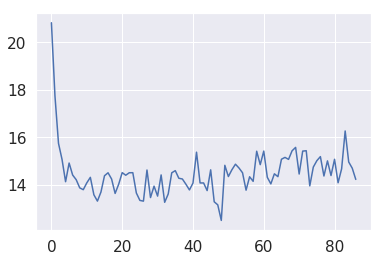

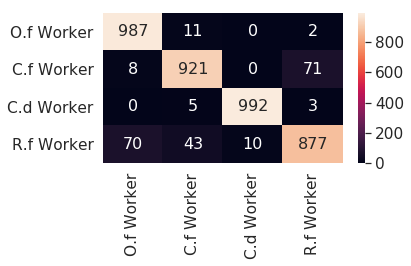

1 1
0 0
2 2
1 1
2 2
3 3
2 2
0 0
0 0
1 1
2 2
1 1
1 1
0 0
0 0
0 0
0 0
0 0
3 3
1 1
0 0
1 3
0 0
1 1
2 2
2 2
3 3
3 3
0 0
1 1
2 2
2 2
0 0
3 3
2 2
2 2
3 3
0 0
1 1
3 3
2 2
2 2
2 2
2 2
1 1
2 2
1 1
3 1
2 2
3 3
3 3
3 3
3 3
1 1
3 3
3 3
2 2
0 0
1 1
0 0
0 0
1 3
2 2
0 0
0 1
2 2
0 0
2 2
0 0
2 2
0 1
3 3
2 2
0 1
0 0
3 3
2 2
0 0
2 2
0 0
0 0
2 2
0 0
3 3
1 3
2 2
1 1
2 2
3 3
2 2
0 0
3 0
1 1
0 0
3 3
0 0
3 3
3 3
1 1
1 1
1 1
2 2
1 1
1 1
3 3
1 1
3 1
0 0
2 2
0 0
3 3
3 3
2 2
2 2
0 0
2 2
1 1
3 3
0 0
3 3
3 3
3 3
3 3
2 2
0 0
1 1
0 0
0 0
2 2
2 2
3 3
0 0
3 3
3 3
3 3
1 1
2 2
0 0
1 1
2 2
0 0
0 0
2 2
1 3
2 2
3 3
1 1
3 3
2 2
1 1
1 1
0 0
2 2
3 3
1 1
2 2
1 1
0 0
2 2
0 0
2 2
2 2
2 2
2 2
2 2
3 3
1 1
3 3
2 2
0 0
1 1
2 2
1 1
0 0
1 1
1 1
3 3
3 3
2 2
0 0
0 0
1 1
1 1
2 2
0 0
0 0
3 3
2 2
1 1
1 1
3 3
0 0
3 3
0 0
3 3
3 3
3 3
0 0
0 0
3 0
3 3
3 3
1 3
2 2
2 2
3 3
1 1
3 3
0 0
3 3
0 0
0 0
2 2
0 0
2 2
0 0
3 3
2 2
1 1
1 1
2 2
2 2
2 2
3 3
3 1
0 0
1 1
3 3
2 2
0 0
0 0
3 3
2 2
1 1
2 2
0 0
2 2
2 2
3 3
2 2
3 2
3 3
1 1
0 0
0 0
0 0
3 3
2 2
3 1
0 0


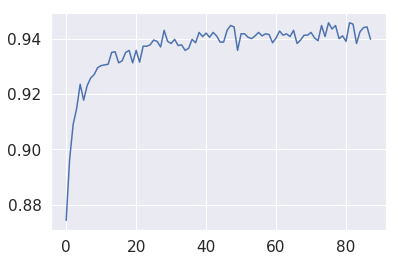

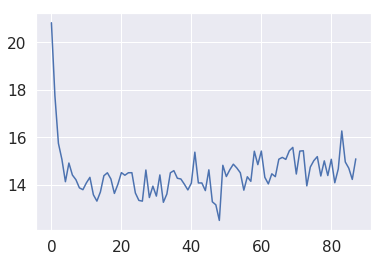

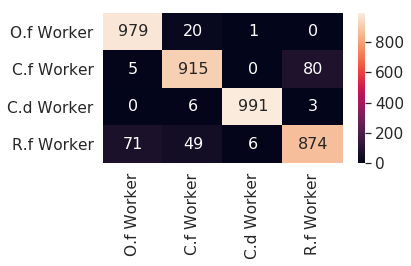

1 1
2 2
3 3
3 3
2 2
0 0
2 2
0 0
3 3
1 1
2 2
1 1
1 1
1 3
1 1
1 1
1 1
0 0
2 2
2 2
3 3
0 0
2 2
3 3
1 1
1 0
2 2
2 2
1 1
3 0
1 1
2 2
1 3
2 2
1 1
1 1
1 1
0 0
2 2
3 3
0 0
2 2
1 1
2 2
1 3
1 1
1 1
3 3
2 2
2 2
3 3
1 1
1 1
3 1
2 2
1 1
3 0
1 1
3 3
3 3
3 3
1 1
2 2
0 0
0 0
1 1
3 3
0 0
2 2
3 3
1 1
0 0
2 2
2 2
2 2
2 2
3 3
0 0
3 3
3 3
0 0
2 2
0 0
3 3
0 0
3 3
3 3
1 1
0 0
3 3
2 2
1 1
1 1
3 3
1 1
2 2
2 2
2 2
2 3
3 3
3 3
2 2
1 1
2 2
3 3
0 0
3 3
0 0
2 2
1 1
0 0
1 1
2 2
3 3
1 1
0 0
0 0
0 0
0 0
2 2
3 3
1 1
0 0
0 0
0 0
0 0
2 2
0 0
0 0
1 1
0 0
2 2
3 3
1 1
0 0
2 2
0 0
1 3
0 0
1 1
0 0
2 2
1 1
2 2
3 3
0 0
1 1
1 1
1 3
0 0
1 3
1 1
1 1
0 0
0 0
2 2
0 0
3 3
0 0
0 0
0 1
0 0
3 3
0 0
0 0
1 1
2 2
1 1
2 2
0 0
0 0
1 1
1 1
3 3
2 2
3 3
1 1
2 2
3 3
3 2
2 2
1 3
0 0
1 1
1 1
3 3
1 1
0 0
3 3
3 3
1 1
3 3
2 2
3 3
1 1
0 0
2 2
2 2
3 3
3 3
3 3
1 1
3 3
0 0
3 3
3 3
1 1
0 0
0 0
0 0
2 2
1 1
2 2
2 2
2 2
3 3
3 3
0 0
2 2
3 3
0 0
0 0
0 0
3 3
1 1
2 2
3 3
2 2
0 0
1 1
2 2
3 3
0 0
2 2
3 3
3 3
1 1
2 2
0 0
3 3
3 3
1 1
3 3
1 1
0 0
2 2
0 0
2 2
0 1
2 2


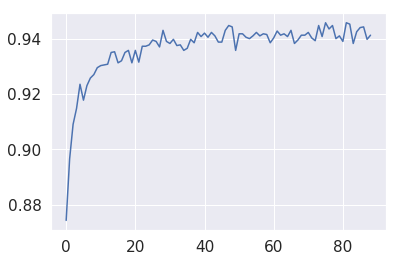

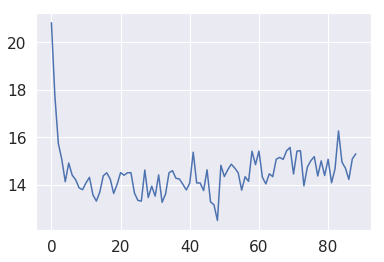

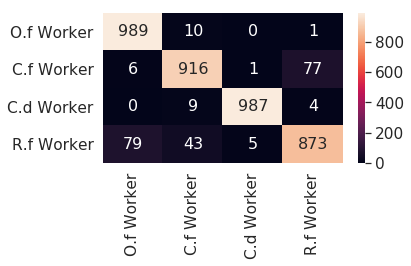

1 1
3 3
2 2
0 0
2 2
1 1
3 3
3 3
2 2
0 0
2 2
3 3
2 2
2 2
2 2
3 3
2 2
3 0
0 0
1 1
2 2
1 1
2 2
3 3
0 0
3 3
0 0
2 1
1 1
1 1
0 0
0 0
0 0
1 3
1 1
0 0
0 1
3 3
3 3
0 0
2 2
0 0
3 3
2 2
3 3
1 1
2 2
2 2
2 2
3 3
1 1
0 0
0 0
0 0
0 0
2 2
0 0
3 3
1 1
0 0
0 0
2 2
1 1
1 1
3 3
0 0
2 2
3 0
0 0
0 0
2 2
2 2
1 1
2 2
2 2
0 0
3 1
0 0
1 1
1 1
1 1
2 2
3 3
2 2
2 2
2 2
3 3
1 1
3 3
2 2
0 0
0 0
3 3
1 1
3 3
3 0
3 1
1 1
3 3
3 3
0 0
2 2
0 0
2 2
2 2
1 1
0 0
3 0
2 2
1 1
0 0
1 1
1 1
2 2
0 0
2 2
3 3
2 2
3 3
2 2
2 2
2 2
2 2
3 3
0 0
2 2
2 2
0 0
1 1
2 2
1 1
3 3
0 0
2 2
3 3
2 2
0 0
1 1
1 1
2 2
0 0
1 1
3 3
3 3
2 2
2 2
3 3
2 2
2 2
2 2
0 0
3 3
0 0
3 3
2 2
1 1
0 0
0 0
1 1
0 0
3 3
3 3
2 2
3 3
1 1
0 0
2 2
1 1
3 3
1 1
1 1
2 2
1 1
2 2
2 2
3 3
2 2
2 2
3 3
0 0
2 2
0 0
0 0
0 0
1 1
1 1
0 0
0 0
2 2
2 2
1 1
2 2
1 1
1 3
2 2
1 1
3 3
0 0
3 3
0 0
1 1
3 3
1 1
0 0
3 3
1 1
1 1
3 3
2 2
3 3
2 2
0 0
3 0
0 0
2 2
2 2
1 1
1 1
2 2
3 3
0 0
0 0
2 2
3 1
2 2
1 1
0 0
0 0
3 3
0 0
2 2
3 3
1 1
2 2
1 1
3 3
3 3
2 2
1 1
3 3
2 2
3 3
0 0
1 1
3 3
0 0
2 2
1 1
0 0
1 1


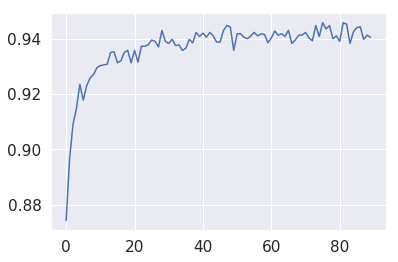

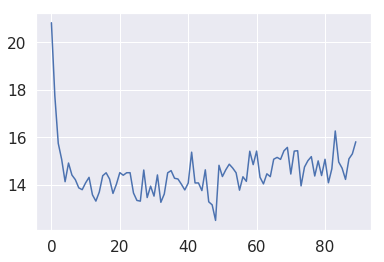

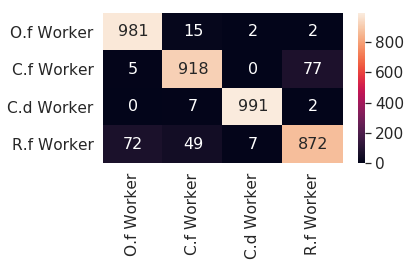

2 2
2 2
3 3
1 1
2 2
2 2
1 1
1 3
0 0
2 2
0 0
2 2
0 0
1 1
1 1
3 3
3 0
1 1
2 2
0 0
2 2
2 2
0 0
0 0
3 3
0 0
3 3
3 0
2 2
0 0
2 2
2 2
3 3
2 2
2 2
3 3
3 3
1 1
2 2
2 2
2 2
0 0
2 2
1 1
3 3
2 2
1 1
1 1
1 1
0 0
3 3
0 0
0 0
3 3
3 3
2 1
0 0
3 3
2 2
1 1
2 2
0 0
0 0
3 3
0 0
2 2
0 0
1 1
1 1
1 1
1 1
0 0
3 3
0 0
2 2
3 3
2 2
1 1
1 1
0 1
2 2
3 3
0 0
1 1
2 2
3 3
2 2
3 0
0 0
0 0
0 0
2 2
2 2
3 3
1 1
0 0
2 2
2 2
2 2
3 3
2 2
3 3
0 0
2 2
0 0
2 2
2 2
0 0
2 2
3 3
2 2
0 0
0 0
2 2
1 3
1 1
2 2
3 3
2 2
0 0
0 0
3 3
2 2
3 3
3 1
1 1
2 2
2 2
3 3
1 1
2 2
3 1
3 3
2 2
0 0
3 3
1 1
2 2
3 3
3 3
3 0
1 1
1 1
1 1
2 2
3 0
1 1
1 1
3 3
3 1
0 0
3 3
1 1
3 0
1 1
0 0
1 1
0 0
2 2
3 3
2 2
1 1
3 3
1 1
0 0
3 3
0 0
0 0
2 2
1 1
3 3
3 0
1 1
1 1
0 0
1 1
1 1
0 0
1 1
1 3
2 2
1 1
1 1
2 2
2 2
2 2
3 3
0 0
1 1
3 3
2 2
3 3
0 0
1 1
1 1
3 3
0 0
2 2
1 1
0 0
3 3
2 2
0 0
0 0
2 2
2 2
1 1
1 1
2 2
3 3
3 3
0 0
3 3
1 1
2 2
3 3
0 0
2 2
2 2
1 1
1 1
3 3
2 2
3 0
0 0
3 3
1 3
0 0
1 1
1 1
1 3
0 0
0 0
2 2
1 3
2 2
2 2
2 2
3 0
2 2
3 3
1 1
2 2
0 0
1 1
1 1
3 3
0 0
1 3
3 3


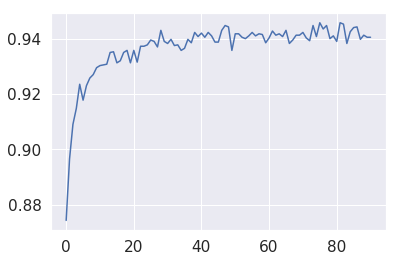

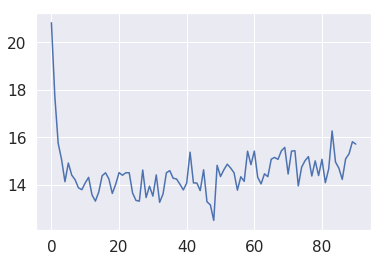

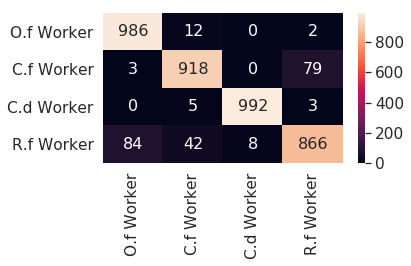

0 0
2 2
1 1
3 3
3 3
3 3
1 1
3 3
2 2
0 0
2 2
1 1
0 0
3 3
3 3
0 0
1 1
0 0
2 2
1 3
2 2
1 1
1 1
3 3
2 2
0 0
0 0
3 3
2 2
0 0
0 0
3 3
2 2
1 1
1 1
0 0
3 3
2 2
0 0
0 0
3 3
2 2
1 1
0 0
2 2
1 3
0 0
0 0
3 0
1 1
3 3
1 1
2 2
2 2
1 1
0 0
1 1
1 1
1 1
1 1
1 1
1 1
0 0
2 2
0 0
2 2
2 2
1 1
3 3
2 2
1 1
0 0
0 0
1 1
2 2
0 0
0 0
0 0
2 2
2 2
1 1
2 2
1 1
0 0
0 0
0 0
0 1
1 1
3 3
2 2
3 3
0 0
0 0
2 2
2 2
0 0
2 2
3 3
2 2
2 2
1 1
3 1
1 1
0 0
1 1
3 3
0 0
1 1
2 2
3 3
0 0
1 1
1 1
3 3
1 1
1 1
2 2
3 1
0 0
0 0
3 3
0 0
0 0
0 0
2 2
0 0
3 0
2 2
1 1
0 0
3 3
1 3
1 1
0 0
3 3
3 3
2 2
3 3
0 0
3 3
1 1
1 1
3 0
2 2
0 0
0 0
1 1
3 3
0 0
2 2
0 0
2 2
0 0
0 0
0 0
1 1
1 1
2 2
0 0
2 2
0 0
3 3
0 0
2 2
0 0
0 0
2 2
2 2
1 1
3 3
0 0
0 0
1 1
2 2
1 1
1 1
1 1
2 2
2 2
0 0
0 0
3 3
3 3
2 2
1 1
1 1
1 1
3 3
2 2
3 3
3 3
3 3
2 2
1 1
2 2
1 1
0 0
1 1
1 1
1 1
3 3
3 3
1 1
1 1
3 3
3 3
1 1
0 0
2 2
2 2
3 3
0 0
0 0
0 0
0 0
1 1
1 1
2 2
3 3
0 0
0 0
1 1
3 3
1 1
1 1
1 1
2 2
3 3
2 2
0 0
0 0
3 3
1 1
2 2
0 0
2 2
0 0
3 3
2 2
2 2
2 2
0 0
1 1
2 2
1 1
2 2
0 0
0 0
1 1
0 0


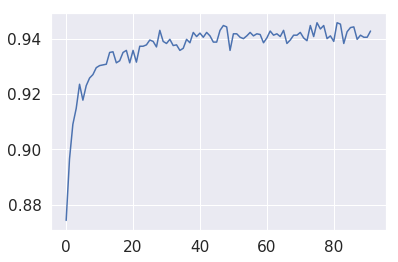

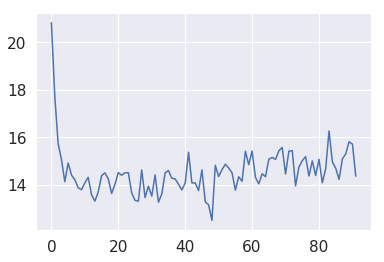

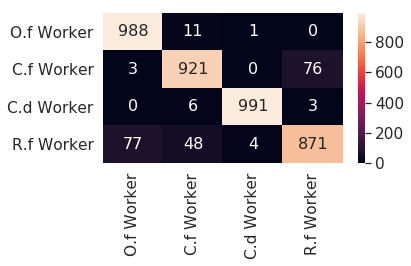

3 3
3 0
0 0
1 1
2 2
3 3
0 0
2 2
3 3
3 0
0 0
3 3
3 3
1 1
0 1
2 2
1 1
0 0
2 2
0 0
1 1
3 3
1 1
0 0
2 2
0 0
3 3
3 3
3 3
2 2
3 3
3 0
0 0
2 2
1 1
2 1
1 1
1 1
0 0
3 3
3 3
2 2
3 3
2 2
2 2
1 1
3 0
1 1
2 2
0 0
2 2
1 1
0 0
2 2
1 3
2 2
3 3
1 1
0 0
3 3
1 1
1 1
0 0
1 1
2 2
0 0
1 1
2 2
3 3
1 1
0 0
1 3
2 2
1 1
0 0
3 3
0 0
2 2
3 3
2 2
2 2
0 0
2 2
1 1
3 3
1 1
1 1
0 0
2 2
1 1
0 0
2 2
3 3
3 3
3 3
2 2
2 2
0 0
1 3
0 0
0 0
3 0
2 2
2 2
1 1
1 1
1 1
0 0
2 2
0 0
0 0
3 3
3 3
2 2
1 1
1 1
2 2
1 1
0 0
2 2
0 0
1 1
0 0
2 2
2 2
2 2
3 3
2 2
2 2
3 0
3 3
2 2
1 1
3 3
2 2
3 3
2 2
0 0
3 3
0 0
0 0
1 1
1 1
0 0
1 1
3 3
3 3
0 0
3 3
3 3
2 2
1 1
2 2
0 0
2 2
1 1
0 0
3 3
0 0
1 3
0 0
2 2
0 0
2 2
3 3
2 2
1 1
3 3
3 3
2 3
3 3
0 0
1 3
2 2
2 2
1 1
1 1
1 1
1 1
1 1
3 3
0 0
2 2
3 3
1 1
0 0
2 2
1 1
3 3
2 2
2 2
3 3
1 1
0 0
2 2
1 1
2 2
3 3
3 3
2 2
1 1
0 0
3 3
1 1
3 3
0 0
0 0
0 1
1 1
1 1
3 3
0 0
0 0
1 1
2 2
2 2
2 2
1 1
3 3
3 3
3 0
0 0
1 1
0 0
2 2
3 3
3 3
1 1
2 2
0 0
1 1
1 1
0 0
3 3
0 0
2 2
2 2
1 1
0 0
1 1
2 2
2 2
0 0
3 3
3 3
0 0
0 0
2 2
1 1
3 3


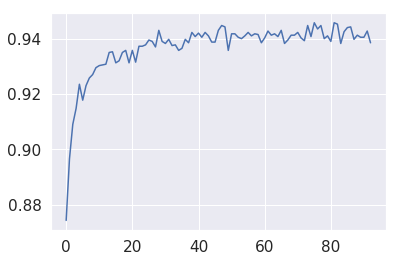

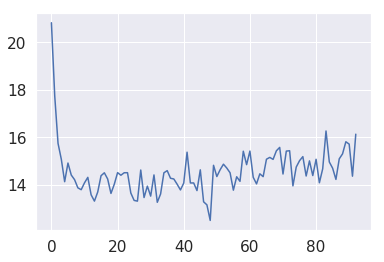

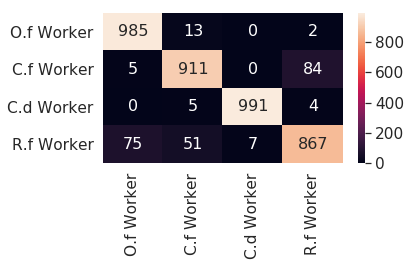

3 3
3 3
1 1
2 2
0 0
0 0
0 0
1 1
3 3
2 2
2 2
1 1
3 3
1 1
1 1
1 1
2 2
3 3
2 2
2 2
3 3
0 0
3 3
1 1
2 2
1 1
2 2
2 2
0 0
2 2
2 2
0 0
0 0
3 0
2 2
1 1
1 1
3 3
2 2
3 3
2 2
0 0
3 3
1 1
1 1
3 3
2 2
0 0
1 1
0 0
1 1
1 1
3 0
0 0
1 1
2 2
1 1
0 0
1 1
2 2
2 2
2 2
2 2
1 1
2 2
3 3
2 2
3 1
1 3
2 2
1 1
2 2
0 0
1 1
2 2
3 3
1 1
1 1
0 0
3 3
3 3
0 0
3 0
0 0
2 2
0 0
2 2
2 2
2 2
3 3
2 2
1 1
2 2
1 1
2 2
0 0
0 0
3 3
3 3
1 1
1 1
1 1
2 2
0 0
1 1
2 2
1 1
2 2
1 1
1 1
3 3
1 3
0 0
0 0
3 3
1 0
1 1
2 2
3 0
2 2
1 1
2 2
3 3
1 1
2 2
2 2
3 3
0 0
0 0
1 1
0 0
2 1
1 1
2 2
3 3
2 2
0 0
3 3
3 3
1 1
2 2
1 1
2 2
0 0
2 2
2 2
2 2
3 3
2 2
0 0
2 2
0 0
1 1
3 3
0 0
1 1
0 0
3 3
3 3
3 3
0 0
0 0
1 1
2 2
0 0
3 3
1 1
0 0
0 0
3 3
2 2
2 2
2 2
3 1
2 2
0 0
3 3
2 2
2 2
2 2
3 0
1 1
2 2
2 2
2 2
2 2
0 0
2 2
1 1
3 3
3 3
2 2
0 0
2 2
1 1
2 2
2 2
0 0
3 3
3 3
0 0
3 3
1 1
2 2
2 2
0 0
0 0
1 1
2 2
1 3
0 0
3 3
0 0
1 1
0 0
3 3
2 2
1 1
1 1
0 0
3 3
3 3
0 0
1 1
1 1
1 1
0 0
0 0
0 0
0 0
1 1
2 2
1 1
0 0
0 0
2 2
3 3
3 3
0 0
0 0
1 1
3 3
3 3
2 2
1 1
3 3
3 3
2 2
1 1
2 2


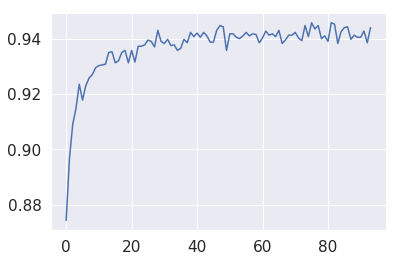

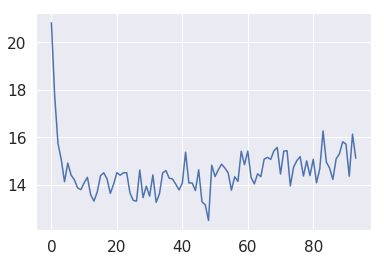

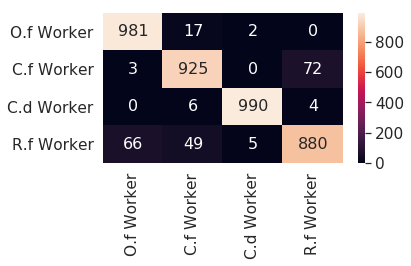

0 0
0 0
3 3
0 0
1 1
1 1
1 1
0 0
3 3
1 1
3 3
1 1
3 3
3 3
0 0
0 0
2 2
0 0
3 3
0 0
0 0
3 3
1 1
1 1
1 1
2 2
0 0
3 3
1 1
0 0
1 1
3 3
3 2
0 0
1 1
2 2
0 0
0 0
2 2
3 3
1 1
1 1
3 3
2 2
0 0
3 0
0 0
2 2
0 0
2 2
3 3
3 3
1 1
1 1
0 0
0 0
0 0
0 0
3 3
2 2
3 3
2 2
0 0
1 1
2 2
3 3
0 0
1 3
3 3
0 0
2 2
0 0
3 1
0 0
0 0
3 3
1 1
2 2
1 1
3 3
3 0
3 3
3 3
1 1
0 0
3 3
3 3
3 3
3 3
1 1
2 2
2 2
1 1
2 2
3 3
0 0
2 2
1 1
3 3
3 3
3 1
2 2
3 3
1 1
0 0
2 2
2 2
2 2
1 1
0 0
1 1
2 2
0 0
2 2
0 0
0 0
2 2
2 2
2 2
2 2
1 1
3 3
3 3
3 3
0 0
1 1
2 2
2 2
1 1
3 3
1 1
3 1
0 0
2 2
1 1
1 1
3 3
3 3
0 0
2 2
2 2
2 2
1 1
3 3
0 0
1 1
1 1
3 3
1 3
1 1
0 0
2 2
1 1
2 2
3 3
2 2
1 1
1 1
1 1
1 1
3 3
0 0
1 1
0 0
2 2
1 1
0 0
3 0
1 1
2 2
2 2
0 0
0 0
0 0
0 0
0 0
2 2
3 3
2 2
2 2
0 0
0 0
3 2
3 3
0 0
0 0
3 3
3 3
2 2
3 3
3 3
0 0
2 2
3 3
3 3
3 0
0 0
0 0
3 3
1 3
1 1
3 0
1 1
3 3
0 0
1 1
1 1
1 1
1 1
2 2
1 1
1 1
0 0
0 0
2 2
2 2
3 3
1 1
2 2
0 0
0 0
3 3
2 2
0 0
0 0
1 1
2 2
1 1
3 3
0 0
3 3
1 1
0 0
1 1
2 2
0 0
1 1
0 0
3 3
1 3
0 0
0 0
3 3
1 1
1 1
2 2
3 3
2 2
1 1
0 0


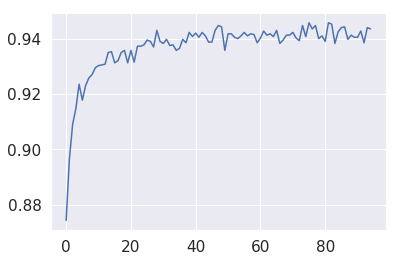

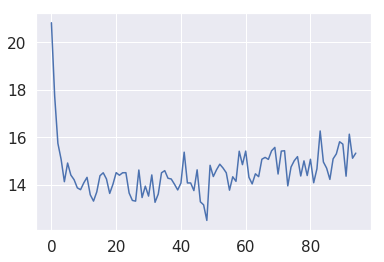

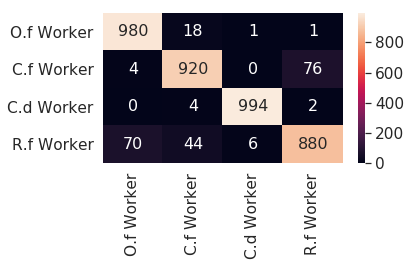

1 1
2 2
0 0
1 1
3 3
0 0
3 3
3 3
3 3
2 2
1 1
2 2
1 1
2 2
1 1
1 1
0 0
3 0
2 2
1 1
1 1
2 2
0 0
2 2
2 2
3 3
3 3
2 2
3 3
2 2
1 3
1 1
0 0
0 0
1 1
1 1
0 0
1 3
0 0
1 1
1 1
3 3
0 0
0 0
0 0
1 3
1 1
1 1
1 1
1 1
1 1
0 0
3 3
3 3
1 1
3 3
1 1
3 3
3 3
0 0
1 1
1 1
1 1
0 0
3 3
0 0
3 3
0 0
3 3
3 3
2 2
0 0
2 2
0 0
2 2
1 1
1 1
0 0
3 3
0 0
3 3
1 1
1 1
2 2
2 2
2 2
3 3
3 3
0 0
1 1
0 0
0 0
2 2
2 2
2 2
3 3
1 1
0 0
0 0
3 1
1 1
3 3
2 2
0 0
2 2
1 1
0 1
1 1
0 0
3 3
3 3
2 2
1 1
3 3
0 0
2 2
2 2
3 0
0 0
3 3
0 0
0 0
1 1
2 2
3 3
2 2
1 3
0 0
3 3
1 1
1 1
2 2
1 1
2 2
2 2
3 1
0 0
0 0
3 3
0 0
1 1
2 2
2 2
2 2
3 3
2 2
3 0
2 2
3 3
1 1
1 1
3 3
2 2
1 1
3 3
2 2
0 0
2 2
1 1
3 3
1 3
0 0
1 1
0 0
3 3
2 2
2 2
2 2
0 0
0 0
3 3
2 2
3 3
3 3
2 2
2 2
3 3
3 3
1 1
0 0
3 3
1 3
0 0
0 0
3 3
0 0
3 3
1 1
0 0
1 1
0 0
1 1
1 1
0 0
2 2
3 3
3 3
3 3
0 0
0 0
1 1
2 2
3 3
2 2
1 1
0 0
2 2
0 0
3 3
1 1
3 3
2 2
0 0
3 0
2 2
1 1
3 3
2 2
2 2
3 3
3 3
1 1
1 1
3 3
2 2
2 2
3 3
0 0
3 3
2 2
2 2
1 1
1 1
1 1
1 1
2 2
2 2
0 0
3 3
1 1
2 2
3 3
0 0
0 0
3 3
0 0
2 2
0 0
2 2
1 1


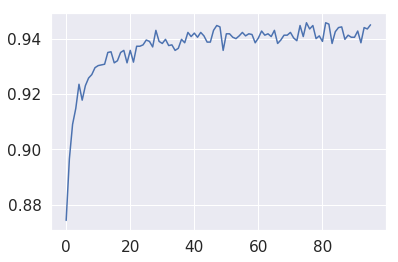

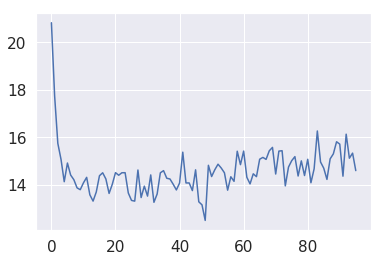

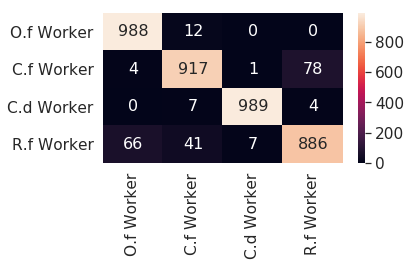

1 1
0 0
3 3
1 1
3 3
2 2
0 0
1 1
0 0
0 0
0 0
0 0
1 1
3 3
1 1
1 1
1 1
3 3
0 0
2 2
2 2
0 0
0 0
1 1
2 2
2 2
3 3
0 0
1 1
2 2
3 3
0 0
1 1
1 3
2 2
2 2
1 1
3 0
1 1
3 3
2 2
0 0
3 3
0 0
3 3
0 0
3 3
3 3
2 2
1 1
3 3
2 2
2 2
0 0
0 0
2 2
1 1
1 1
3 3
0 0
1 1
2 2
3 3
1 1
3 3
3 3
0 0
1 1
0 0
2 2
1 1
1 1
0 0
0 0
3 3
1 2
0 0
2 2
0 0
1 1
0 0
2 2
2 2
3 3
2 2
0 0
1 1
0 1
1 1
0 0
1 1
1 3
2 2
3 3
1 1
2 2
2 2
1 1
0 0
0 0
0 0
0 0
0 0
3 3
0 0
1 1
0 0
3 3
0 0
0 0
1 1
2 2
0 0
1 1
2 2
3 3
1 1
0 0
1 1
3 3
0 0
3 3
1 3
1 3
0 0
3 3
3 3
0 0
2 2
0 0
0 0
1 1
0 0
3 3
2 2
3 3
2 2
3 0
0 0
1 1
3 3
0 0
2 2
2 2
2 2
0 0
1 1
2 2
3 3
0 0
3 3
3 3
3 3
3 3
2 2
2 2
0 0
1 1
1 1
3 3
1 1
2 2
1 1
1 1
2 2
1 1
2 2
1 3
1 1
0 0
3 3
2 2
2 2
3 3
0 0
1 1
1 1
0 0
0 0
0 0
2 2
3 3
3 3
3 3
1 1
2 2
2 2
2 2
1 1
3 3
3 3
0 0
1 1
1 3
3 0
1 1
3 3
1 1
2 2
1 1
2 2
1 1
1 3
1 1
3 3
2 2
0 0
0 0
2 2
1 1
1 1
3 3
1 1
3 3
3 3
0 0
1 1
3 3
1 1
2 2
3 3
3 3
0 0
0 0
1 1
1 1
1 1
3 3
0 0
0 0
2 2
3 0
0 0
0 0
1 1
2 2
1 1
0 0
2 2
3 3
1 1
2 2
0 0
1 1
2 2
1 1
0 0
0 0
3 3
1 1


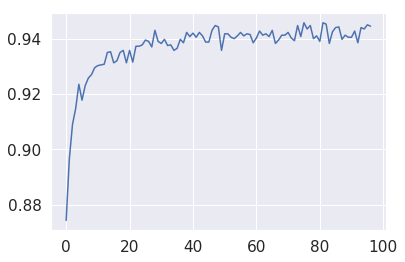

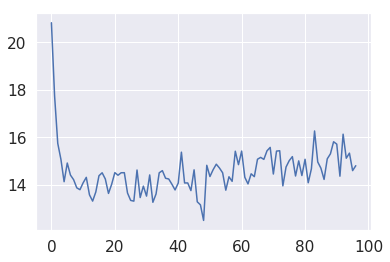

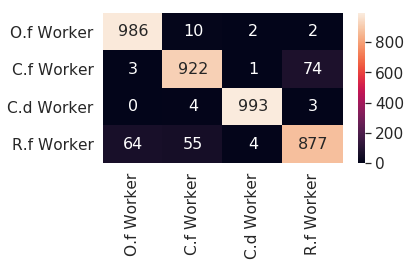

3 3
0 0
2 2
3 1
2 2
3 3
1 1
1 1
3 3
2 2
0 0
1 1
3 3
1 1
3 0
3 3
3 0
0 0
2 2
1 3
3 3
2 2
3 2
3 0
3 3
3 3
2 2
2 2
3 3
1 1
2 2
1 1
0 0
3 0
2 2
0 0
1 1
0 0
2 2
2 2
2 2
2 2
1 1
2 2
1 1
0 0
1 1
1 1
3 1
0 0
1 1
1 3
1 1
2 2
0 0
3 3
1 1
0 0
0 0
3 3
2 2
0 0
3 0
2 2
3 3
0 0
1 1
2 2
2 2
1 1
1 3
3 3
1 3
1 1
0 0
0 0
1 1
1 1
0 0
1 1
1 1
2 2
2 2
1 1
3 3
1 1
3 3
0 0
3 0
1 3
1 3
1 1
2 2
1 1
2 2
2 2
0 0
1 1
3 3
1 1
0 0
1 1
1 1
1 1
3 3
2 2
2 2
2 2
3 3
2 2
0 0
3 3
3 3
0 0
2 2
2 2
3 0
1 1
3 3
0 0
1 1
3 3
0 0
1 1
0 0
1 1
1 1
3 3
2 2
2 2
0 0
2 2
0 0
2 2
3 1
2 2
3 3
0 0
0 0
1 1
3 0
1 1
1 1
2 2
2 2
3 1
3 3
0 0
3 3
2 2
3 3
0 0
3 3
2 2
2 2
0 0
3 1
2 2
1 1
1 1
3 3
1 1
2 2
3 3
0 0
0 0
0 0
3 3
2 2
2 2
1 1
0 0
2 2
1 1
2 2
0 0
1 1
0 0
3 3
1 1
0 0
3 3
3 0
2 2
3 3
0 0
2 2
3 3
2 2
0 0
0 0
2 2
3 3
1 1
0 0
2 2
2 2
3 0
3 3
1 1
3 3
1 1
3 3
1 1
0 0
2 2
3 3
0 0
2 2
2 2
1 1
2 2
0 0
3 3
0 0
0 0
2 2
0 0
1 3
3 3
0 0
2 2
3 3
3 3
1 1
2 2
3 3
2 2
1 1
0 0
3 3
1 1
3 3
2 2
1 1
1 1
0 0
1 1
0 0
0 0
1 1
3 3
2 2
2 2
2 2
1 1
3 3
3 3
2 2
1 1


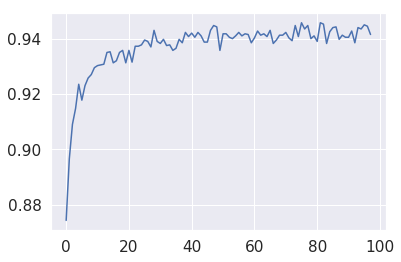

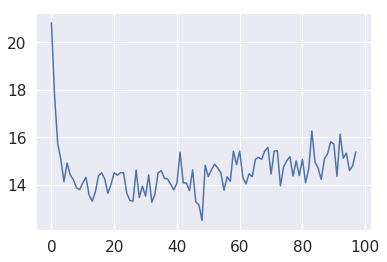

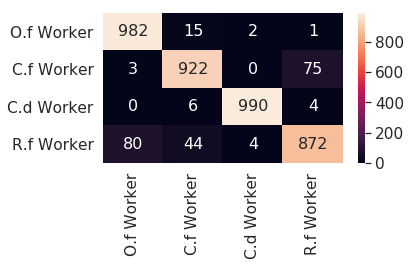

1 1
0 0
0 0
0 0
3 3
1 1
3 3
3 3
2 2
0 0
0 0
1 1
3 3
1 1
1 1
1 1
2 2
2 2
3 3
2 2
2 2
2 2
1 1
0 0
0 0
1 1
1 1
2 2
0 0
0 0
0 0
3 3
2 2
3 3
1 1
2 2
3 3
3 3
2 2
2 2
0 0
3 3
2 2
0 0
3 3
0 0
2 2
2 2
0 0
0 0
0 0
1 1
1 3
3 3
1 1
0 0
1 3
1 3
1 1
3 0
0 0
2 2
1 1
3 3
1 1
0 0
3 3
3 3
3 3
3 0
1 1
2 2
3 0
0 0
3 3
2 2
2 2
3 3
1 1
3 3
3 3
3 3
1 1
1 1
1 1
3 3
2 2
1 1
3 3
0 0
0 0
1 1
1 1
2 2
0 0
1 1
3 0
0 0
2 2
1 1
3 3
1 1
0 0
1 3
2 2
2 2
2 2
1 1
2 2
1 1
3 0
3 1
1 1
3 3
3 3
1 1
3 3
3 3
2 2
1 1
2 2
0 0
3 3
3 3
2 2
3 0
0 0
2 2
0 0
2 2
3 3
2 2
3 3
0 0
2 2
0 0
2 2
1 1
0 0
2 2
3 3
2 2
1 1
0 0
0 0
0 0
2 2
0 0
3 3
1 1
0 0
0 0
2 2
2 2
1 1
3 3
0 0
3 3
1 1
3 0
3 3
1 1
0 0
1 1
3 3
1 1
0 0
2 2
3 3
1 1
2 2
2 2
3 3
1 1
3 1
3 3
3 3
3 3
1 1
0 0
3 3
2 2
0 0
3 3
0 0
2 2
2 2
1 1
2 2
3 3
3 3
1 1
3 3
3 3
1 1
0 0
1 1
1 1
3 3
0 0
1 1
1 1
2 2
1 1
2 2
3 3
3 3
0 0
1 1
1 1
2 2
3 3
2 2
3 3
0 0
0 0
2 2
3 3
0 0
1 1
3 3
3 0
0 0
2 2
0 0
1 1
2 2
1 1
2 2
3 3
1 1
2 2
3 0
1 1
2 2
0 0
0 0
2 2
0 0
3 3
1 1
3 3
3 2
0 0
0 0
1 1
0 0
3 3
3 3
2 2


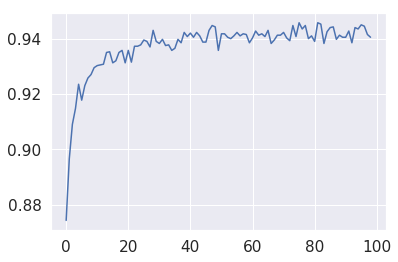

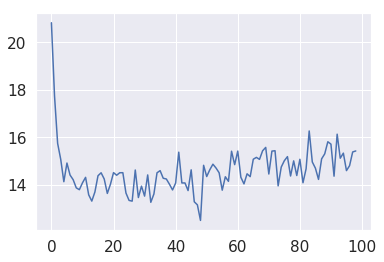

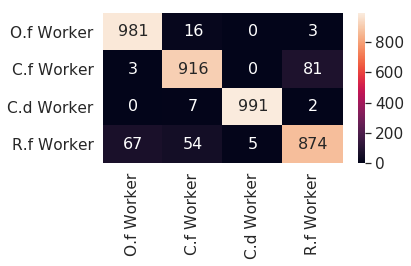

3 3
3 3
2 2
0 0
3 3
2 2
1 1
1 1
1 1
0 0
0 0
3 3
0 0
3 3
3 3
3 3
1 1
3 3
2 2
1 1
3 3
3 3
0 0
3 3
0 0
0 0
3 3
3 3
3 3
1 1
0 0
0 1
3 3
0 0
0 0
0 0
2 2
0 0
2 2
3 0
1 1
2 2
0 0
1 3
3 3
2 2
1 1
1 1
2 2
0 0
3 3
2 2
2 2
3 3
0 0
2 2
3 3
0 0
0 0
1 1
0 0
0 0
3 3
0 0
0 0
1 1
2 2
1 1
3 3
1 1
0 0
3 3
1 1
0 0
3 3
2 2
3 3
3 3
3 3
1 1
1 1
0 0
0 0
2 2
3 3
2 2
0 1
0 0
0 0
1 1
2 2
1 1
2 2
2 2
0 0
0 0
3 3
3 3
0 0
2 2
1 1
3 3
1 1
1 1
3 3
3 3
2 2
0 0
1 1
2 2
0 0
1 3
2 2
0 0
2 2
2 2
0 0
0 0
0 0
1 1
1 1
1 1
1 1
0 0
0 0
3 3
0 0
3 3
3 3
1 1
3 3
0 0
1 1
0 0
3 3
2 2
0 0
1 1
3 3
2 2
1 1
1 1
0 0
0 0
3 3
1 1
1 1
1 1
2 2
0 0
1 1
2 2
3 3
0 0
2 2
2 2
0 0
1 1
0 0
1 1
3 0
2 2
2 2
0 0
0 0
2 2
1 1
0 0
0 0
2 2
1 1
2 2
1 1
0 0
2 2
2 2
0 0
1 1
2 2
3 3
3 3
2 2
3 3
3 3
2 2
3 3
2 2
0 0
0 0
1 1
3 3
1 1
1 1
2 2
1 1
3 3
2 2
0 0
0 0
2 2
2 2
2 3
3 3
3 0
1 1
2 2
1 3
2 2
3 3
2 2
1 1
2 2
0 0
0 0
1 1
1 1
2 2
0 0
1 1
3 3
2 2
1 1
1 3
2 2
0 0
0 0
0 0
0 0
3 3
0 0
0 0
3 3
1 1
2 2
2 2
3 3
3 3
2 3
1 1
3 1
1 1
2 2
3 3
3 3
1 1
0 0
1 1
2 2
2 2
1 1


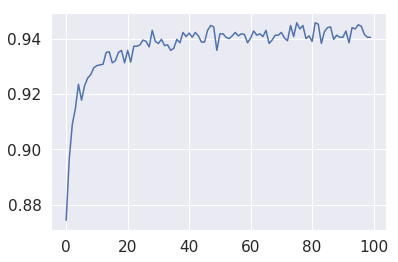

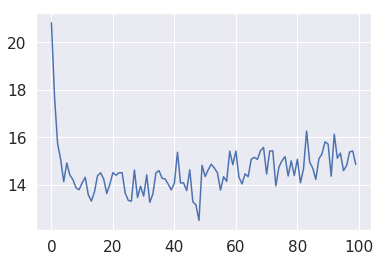

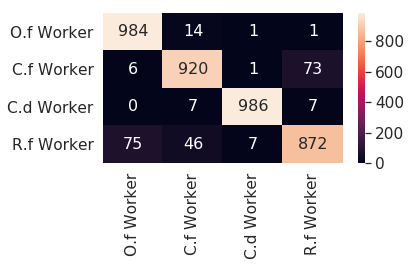

2 2
1 1
2 2
3 3
1 1
1 1
0 0
0 0
2 2
2 2
1 1
3 3
3 3
3 0
3 3
3 3
0 0
1 1
2 2
2 2
2 2
0 0
2 2
0 0
1 1
2 2
1 1
1 1
2 2
1 1
3 3
1 1
1 1
0 0
1 1
1 1
3 3
1 1
3 3
1 1
3 3
2 2
0 0
0 0
0 0
1 1
1 1
1 1
3 3
3 3
1 1
1 1
1 1
3 3
3 3
3 3
3 3
1 1
0 0
1 3
0 0
2 2
1 3
1 1
3 3
1 1
3 3
0 0
1 1
1 1
1 1
2 2
0 0
1 1
1 1
0 0
0 0
1 1
1 1
0 0
2 2
2 2
1 1
2 2
1 1
1 1
3 3
2 2
2 2
3 3
2 2
0 0
0 0
2 2
1 1
1 1
1 1
3 3
2 2
1 1
3 3
3 3
0 0
0 0
3 3
1 1
2 2
1 1
0 0
0 0
1 1
0 0
3 3
1 1
1 3
3 3
0 0
1 1
1 1
0 0
2 2
1 1
0 0
0 0
0 0
2 2
2 2
2 2
2 2
1 1
3 3
1 1
2 2
3 3
1 1
1 1
2 2
3 1
0 0
3 3
1 1
0 0
3 3
2 2
1 1
2 2
2 2
3 3
0 0
3 3
2 2
2 2
2 2
0 0
1 1
2 2
0 0
2 2
0 0
0 0
3 3
2 2
1 1
0 0
0 0
2 2
2 2
3 3
3 3
2 2
2 2
0 0
1 1
1 1
2 2
2 2
3 3
0 0
2 2
2 2
1 1
3 3
3 3
0 0
0 0
2 2
1 1
0 0
3 3
1 1
1 1
3 3
1 1
3 3
3 0
0 0
0 0
2 2
2 2
1 1
2 2
1 1
1 1
3 3
1 1
1 1
0 0
1 1
0 0
2 2
2 2
1 1
3 3
3 3
3 3
2 2
1 1
3 3
2 2
3 3
3 3
0 0
1 1
1 1
2 2
1 1
3 3
2 2
3 3
0 0
0 0
1 1
1 1
2 2
0 0
1 1
1 1
1 1
2 2
0 0
0 0
1 1
3 3
3 3
0 0
3 3
3 3
3 3
3 3
0 0


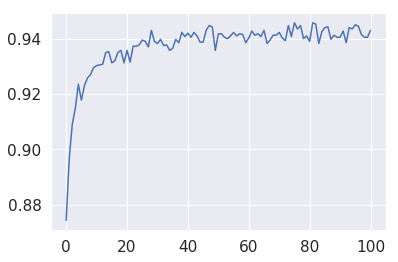

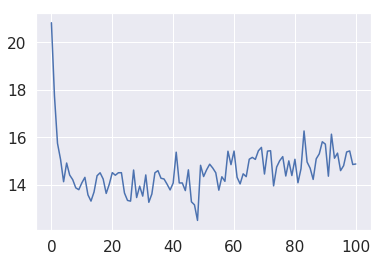

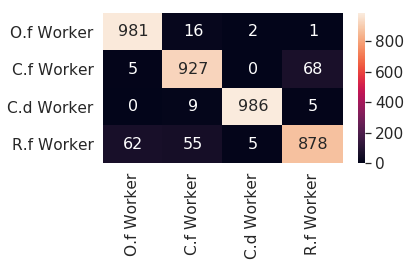

3 3
0 0
2 2
2 2
2 2
1 1
0 0
2 2
0 0
3 3
1 1
2 2
0 0
0 0
2 2
0 0
2 2
3 3
1 1
3 3
0 0
0 0
0 0
2 2
1 1
0 0
1 1
2 2
0 0
3 3
1 1
2 2
3 1
1 3
0 0
0 0
2 2
1 1
2 2
1 1
1 1
1 1
3 3
3 3
1 1
2 2
3 3
3 3
0 0
1 1
0 0
3 3
2 2
0 0
2 2
3 3
2 2
3 3
0 0
3 3
2 2
1 1
3 3
2 2
0 0
3 0
0 0
2 2
0 0
2 2
0 0
3 3
0 0
1 1
1 1
1 1
2 2
1 1
1 1
1 1
2 2
0 0
2 2
2 2
0 0
2 2
1 1
2 2
3 3
1 1
3 3
1 1
1 1
2 2
0 0
1 1
3 3
3 3
0 0
3 3
2 2
3 3
1 1
2 2
0 0
1 1
3 3
1 1
2 2
1 1
3 3
2 2
2 2
3 3
3 3
2 2
1 1
1 1
0 0
0 0
3 3
2 2
0 0
1 1
0 0
3 3
3 3
2 2
1 1
3 3
1 1
2 2
3 3
1 1
0 0
3 3
3 1
3 3
3 3
2 2
3 3
3 3
3 3
1 1
1 1
1 1
0 0
0 0
3 3
0 0
3 3
0 0
3 3
1 1
3 3
1 1
0 0
3 3
2 2
1 1
3 3
1 1
0 0
3 3
1 1
3 3
3 3
2 2
2 2
1 1
1 1
0 0
3 3
3 2
1 1
3 3
3 0
2 2
1 1
3 3
3 3
0 0
0 0
0 0
1 1
3 3
3 1
0 0
3 3
2 2
2 2
0 0
1 1
3 0
0 0
3 3
3 3
3 3
0 0
3 3
3 3
2 2
0 0
3 3
0 0
1 1
3 3
3 3
2 2
1 1
1 1
3 3
2 2
1 1
2 2
0 0
0 1
2 2
2 2
0 0
0 0
2 2
3 3
1 1
2 2
0 0
0 0
1 3
0 0
2 2
2 2
1 1
2 2
3 0
1 1
1 3
3 2
0 0
1 1
1 1
2 2
3 3
0 0
3 3
2 2
0 0
2 2
1 1
0 0
1 1


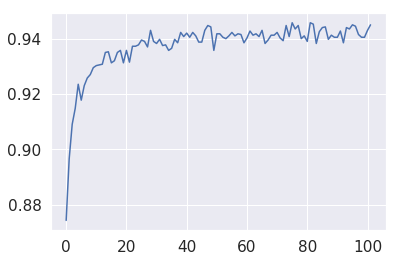

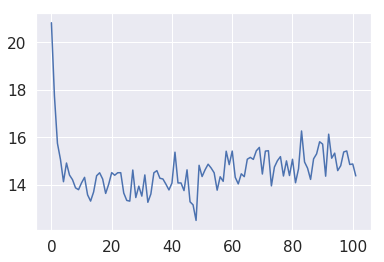

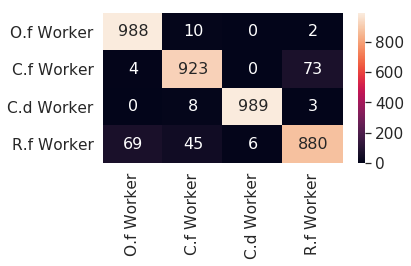

2 2
3 3
2 2
3 3
2 2
2 2
2 2
3 1
3 3
1 1
0 0
1 1
3 3
2 2
3 3
1 1
2 2
2 2
2 2
3 3
0 0
2 2
1 1
2 2
0 0
2 2
1 1
0 0
3 0
3 3
0 0
2 2
3 0
3 3
1 1
2 2
2 2
1 3
0 0
1 1
2 2
1 1
3 1
2 2
0 0
0 0
3 3
2 2
0 0
0 0
2 2
3 3
3 3
2 2
1 1
3 3
1 1
0 0
0 0
2 2
2 2
0 0
0 0
3 3
3 3
0 0
1 1
2 2
3 3
0 0
0 0
2 2
1 1
3 3
1 1
2 2
0 0
0 0
2 2
0 0
1 1
3 3
1 1
2 2
0 0
3 3
3 3
3 3
1 1
3 3
1 1
3 3
2 2
0 0
0 0
3 3
2 2
0 0
3 3
3 3
1 1
1 1
0 0
3 1
3 3
3 3
0 0
1 1
3 3
0 0
1 1
0 0
0 0
2 2
1 1
2 2
0 0
0 0
1 1
2 2
3 0
0 0
1 1
2 2
0 0
2 2
3 3
2 2
2 2
0 0
0 0
1 1
1 1
1 1
3 2
0 0
1 1
1 1
2 2
3 3
3 3
0 0
2 2
1 1
3 3
1 1
0 0
2 2
2 2
2 2
3 3
2 2
3 3
3 3
0 0
3 3
3 3
2 2
0 0
0 0
3 3
1 1
2 2
3 3
3 3
3 2
0 0
1 1
1 3
0 0
3 3
1 1
1 1
0 0
1 1
2 2
1 1
1 1
3 3
1 1
2 2
3 0
0 0
2 2
2 2
2 2
2 2
0 0
1 1
3 3
0 0
0 0
2 2
0 0
0 0
2 2
3 3
0 0
3 3
2 2
1 1
0 0
0 0
0 0
2 2
1 3
3 3
2 2
1 1
1 1
0 0
0 0
1 1
3 3
2 2
2 2
2 2
2 2
3 3
1 1
1 1
0 1
1 3
2 2
1 1
1 1
1 1
0 0
2 2
3 3
2 2
1 1
3 3
2 2
2 2
2 2
0 0
2 2
2 2
3 3
0 0
2 2
1 1
0 0
3 0
1 1
1 1
0 0
1 1
2 2


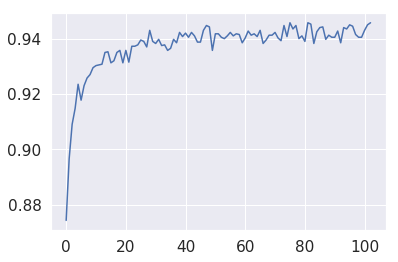

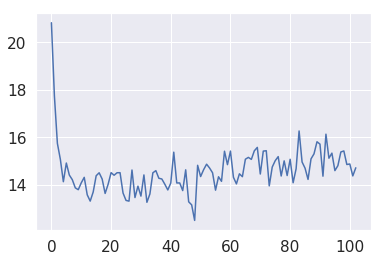

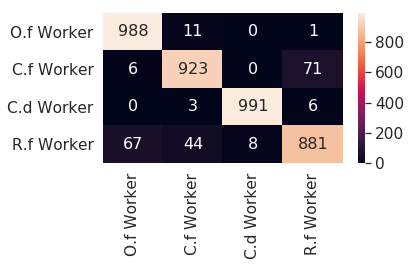

3 3
2 2
3 3
1 1
1 1
2 2
3 3
1 1
3 3
1 1
1 1
3 3
0 0
1 1
0 0
3 3
3 3
1 1
0 0
1 1
1 1
1 1
0 0
3 0
2 2
0 0
3 0
2 2
3 3
2 2
3 3
1 1
2 2
3 3
1 1
3 3
3 3
3 3
0 0
2 2
0 0
0 0
0 0
0 0
2 2
2 2
0 0
1 1
0 0
3 3
2 2
3 3
0 0
3 3
3 3
1 3
1 1
3 3
3 3
1 1
3 3
1 1
1 1
0 0
2 2
0 0
2 2
3 3
1 1
2 2
3 3
3 0
2 2
0 0
1 1
3 3
2 2
2 2
2 2
2 2
0 0
1 1
2 2
3 3
0 0
1 1
2 2
2 2
3 3
3 3
3 1
3 3
1 1
3 3
3 3
1 3
0 0
1 1
1 1
1 1
0 0
3 3
2 2
3 2
0 0
1 1
3 3
2 2
3 3
0 0
1 1
0 0
2 2
3 0
3 3
0 0
1 3
3 3
1 1
0 0
0 0
3 3
3 3
2 2
0 0
1 1
1 1
1 1
3 0
2 2
1 1
3 3
2 2
0 0
1 1
1 1
3 3
3 3
0 0
2 2
0 0
2 2
0 0
1 1
1 1
3 3
2 2
3 3
0 0
1 1
0 0
2 2
1 1
3 3
1 1
3 3
0 0
1 1
2 2
0 0
0 0
1 1
3 3
2 2
1 1
3 3
0 0
2 2
1 1
1 1
2 2
1 3
0 0
2 2
2 2
0 0
1 1
0 0
2 2
1 1
2 2
0 0
3 3
0 0
3 3
3 3
0 0
2 2
3 3
3 3
1 1
1 1
0 0
2 2
1 1
3 3
1 1
1 1
2 2
2 2
3 3
1 1
0 0
2 2
2 2
0 0
0 0
3 3
2 2
1 1
3 3
3 3
3 3
3 3
2 2
2 2
2 2
3 3
1 1
1 1
3 3
3 3
0 0
1 1
2 2
1 1
0 0
3 3
1 1
2 2
2 2
3 3
0 0
3 3
0 0
0 0
3 0
0 0
0 0
3 3
1 1
3 3
1 1
3 3
0 0
2 2
1 1
3 3
3 3
3 0


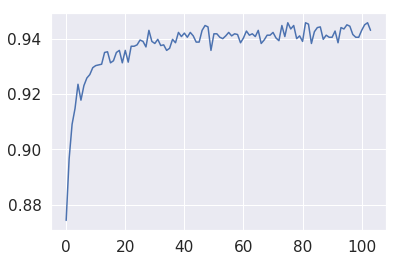

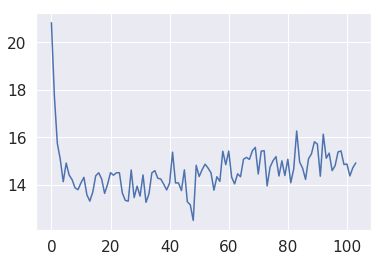

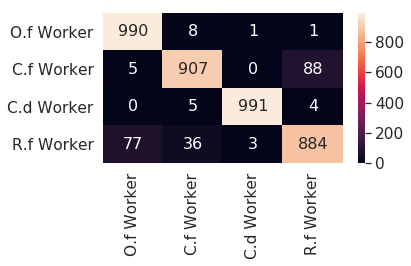

0 0
3 3
1 1
0 0
1 1
2 2
1 1
1 1
1 1
2 2
1 1
1 1
1 1
2 2
2 2
0 0
3 3
3 3
3 3
0 0
1 1
0 0
3 3
1 1
1 3
3 3
1 1
1 1
2 2
1 1
2 2
1 1
0 0
3 0
1 1
3 3
3 3
3 3
0 0
2 2
1 1
0 0
2 2
0 0
2 2
0 0
2 2
0 0
1 0
3 3
3 3
1 1
0 0
3 3
2 2
3 3
0 0
0 0
1 1
2 2
2 2
0 0
0 0
0 0
1 1
3 3
1 1
2 2
3 3
1 1
2 2
0 0
3 0
2 2
1 1
2 2
0 0
1 1
0 0
2 2
3 3
2 2
2 2
1 1
0 0
2 2
3 3
2 2
2 2
1 1
2 2
0 0
3 3
2 2
3 3
3 3
0 0
1 1
0 0
0 0
2 2
1 3
3 3
1 1
0 0
0 0
1 1
3 3
2 2
3 3
1 1
1 1
3 3
0 0
3 3
3 3
1 1
1 1
0 0
2 2
0 0
1 0
1 1
0 0
2 2
3 3
1 1
2 2
1 1
0 0
2 2
3 3
0 0
0 0
1 1
0 0
3 3
1 1
0 0
0 0
3 3
2 2
1 1
3 3
2 2
2 2
0 0
1 1
0 0
3 3
3 3
0 0
0 0
3 3
2 2
1 1
2 2
2 2
3 3
2 2
2 2
0 0
1 1
2 2
3 3
2 2
0 0
3 3
2 2
3 3
2 2
2 2
0 0
2 2
2 2
0 0
0 0
0 0
2 2
3 3
1 1
3 3
3 3
1 1
2 2
2 2
0 0
1 1
2 2
3 3
3 3
0 0
3 0
1 1
0 0
0 0
3 3
0 0
1 1
1 1
1 3
2 2
0 0
1 3
2 2
0 0
3 3
3 3
2 2
3 3
2 2
1 1
1 1
2 2
0 0
1 1
0 0
0 0
0 0
1 1
3 3
3 3
0 0
3 3
1 1
1 1
1 1
2 2
1 1
0 0
0 0
2 2
1 1
3 3
1 1
3 3
3 1
3 3
1 1
2 2
3 3
1 3
0 0
1 1
0 0
3 3
1 1
2 2
2 2
0 0


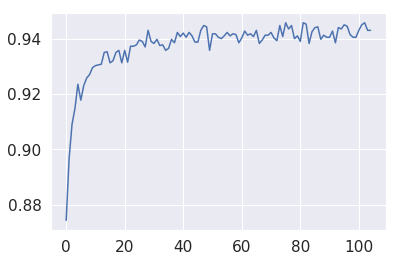

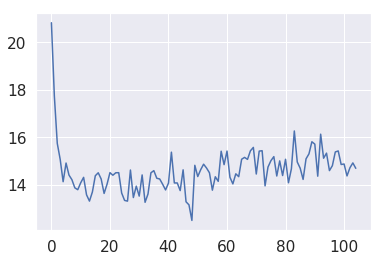

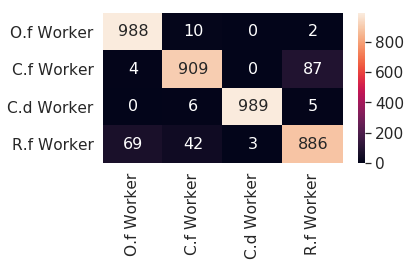

2 2
0 0
0 0
1 1
0 0
2 2
0 0
1 1
1 1
3 3
3 3
3 3
0 2
1 1
2 2
3 0
0 0
0 0
2 2
0 0
3 3
2 2
2 2
2 2
3 3
1 1
3 0
3 0
2 2
1 1
3 3
2 2
0 0
2 1
3 3
3 1
2 2
2 2
3 3
3 3
0 0
2 2
3 3
0 0
0 0
2 2
2 2
3 3
3 0
1 1
1 1
3 3
2 2
2 2
1 3
1 1
0 0
2 2
2 2
3 3
3 3
0 0
0 0
2 2
1 1
0 0
3 3
1 1
3 3
2 2
2 2
0 0
3 3
0 0
3 0
3 0
1 1
3 3
1 1
3 3
3 3
2 2
2 2
2 2
1 1
3 3
0 0
1 1
1 1
3 3
3 3
2 2
1 1
0 0
0 0
1 3
2 2
2 2
2 2
2 2
3 3
3 3
0 0
1 1
3 3
2 2
2 2
1 1
3 3
1 3
1 1
3 3
1 1
2 2
2 2
1 1
2 2
2 2
2 2
3 3
1 1
3 3
1 1
3 3
0 0
1 3
2 2
2 2
0 0
1 1
2 2
2 2
1 1
3 3
0 0
0 0
0 0
1 1
1 1
1 1
0 0
2 2
2 2
0 0
1 1
3 3
3 3
0 0
0 0
3 3
3 3
1 1
0 0
0 0
3 3
0 0
3 3
3 3
1 1
0 0
0 0
0 0
2 2
0 0
3 1
1 1
3 3
3 3
3 3
1 3
2 2
1 1
3 1
3 3
0 0
2 2
3 3
3 3
0 0
0 0
3 3
3 3
1 1
1 1
3 2
1 1
3 1
3 3
3 0
1 1
0 0
0 0
3 3
3 3
2 2
3 0
0 0
0 0
3 3
0 0
2 2
0 1
1 1
1 1
3 3
3 3
3 3
2 2
2 2
3 3
2 2
0 0
2 2
1 1
1 1
2 2
3 3
2 2
0 0
1 1
1 1
1 3
3 3
2 2
0 0
3 3
2 2
3 3
1 1
2 2
1 1
0 0
2 2
2 2
3 3
0 0
1 3
0 0
2 2
0 0
0 0
0 0
2 2
2 2
0 0
1 1
3 3
0 0
0 0
1 1


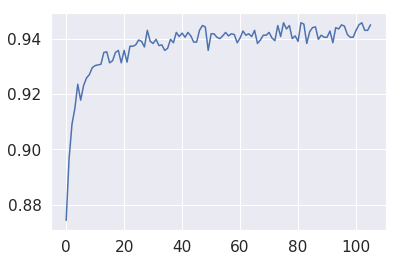

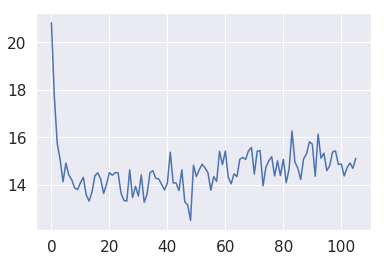

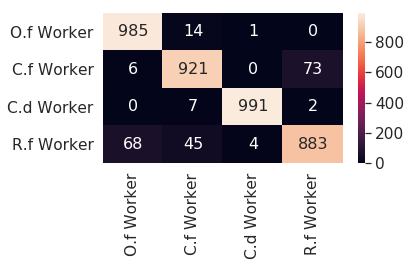

3 3
1 1
0 0
3 3
0 0
1 1
2 2
2 2
0 0
0 0
3 3
3 3
3 3
3 3
0 0
1 1
3 3
2 2
0 0
2 2
0 0
1 1
1 1
0 0
3 3
0 0
2 2
2 2
0 0
2 2
3 3
3 3
3 3
2 2
3 3
0 0
1 1
0 0
3 3
2 2
0 0
0 0
2 2
3 3
3 3
0 0
0 0
0 0
1 1
3 3
3 3
1 1
3 3
1 1
1 1
1 1
0 0
3 3
1 1
1 1
3 3
0 0
0 0
2 2
0 0
1 1
1 1
1 3
0 0
2 2
0 0
1 1
2 2
3 3
0 0
0 0
0 0
0 0
3 3
2 2
3 3
1 1
3 3
0 0
1 3
2 2
2 2
0 0
2 2
2 2
3 3
2 2
1 1
3 3
3 3
0 0
1 1
1 1
0 0
3 3
1 1
0 0
2 2
1 1
0 0
2 2
3 3
2 2
0 0
3 3
1 1
1 1
1 1
3 3
1 1
2 2
1 1
1 1
0 0
1 1
2 2
1 1
2 2
2 2
2 2
0 0
2 2
2 2
3 3
0 0
2 2
2 2
3 3
0 0
2 2
3 3
2 2
0 0
3 3
3 3
0 0
2 2
1 1
2 2
1 1
2 2
3 3
0 1
3 3
2 2
0 0
2 2
1 3
0 0
2 2
1 1
2 2
1 1
3 3
1 1
3 3
0 0
1 1
3 3
2 2
2 2
2 2
3 3
2 2
1 1
1 0
1 1
3 3
1 1
0 0
0 0
1 1
1 1
2 2
0 0
3 3
2 2
3 0
3 3
1 1
2 2
2 2
2 2
3 3
0 0
0 0
1 1
3 3
1 1
0 0
3 3
1 1
3 0
3 3
1 1
2 2
0 0
2 2
3 3
2 2
3 3
1 1
2 2
3 3
2 2
1 1
2 2
3 3
3 0
1 3
2 2
3 3
2 2
2 2
2 2
3 3
0 0
0 0
2 2
2 2
2 2
1 1
3 3
0 0
0 0
2 2
2 2
3 3
0 0
0 0
3 3
1 1
3 3
0 0
3 3
1 3
1 1
1 1
1 1
2 2
1 1
2 2
2 2
1 1
0 0


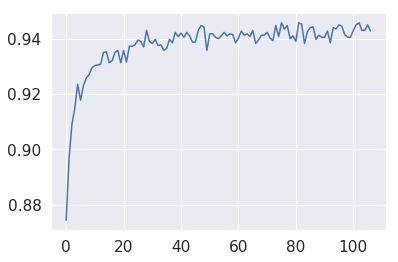

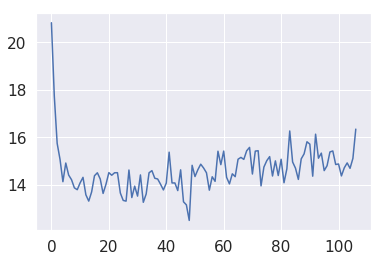

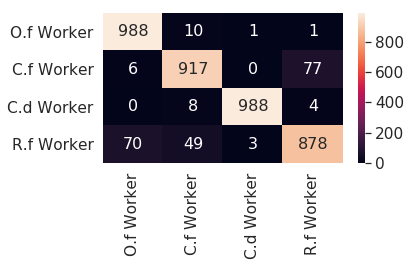

1 1
2 2
0 0
2 2
3 0
3 3
1 1
0 0
1 1
0 0
3 3
2 2
1 1
3 3
1 3
2 2
2 2
3 0
2 2
0 0
3 3
2 2
1 1
2 2
1 1
3 0
2 2
3 3
2 2
3 3
3 3
0 0
3 3
3 3
2 2
1 1
3 1
3 3
2 2
3 3
2 2
0 0
1 1
2 2
3 3
2 2
0 0
1 1
0 0
2 2
2 2
0 0
2 2
2 2
2 2
3 0
3 0
1 1
3 3
3 3
1 1
1 1
3 3
0 0
3 0
3 3
0 0
1 1
1 1
2 2
2 2
1 1
2 2
3 3
3 3
3 3
0 0
2 2
1 1
2 2
2 2
2 2
0 0
0 0
3 3
2 2
3 0
3 3
0 0
1 1
0 0
2 2
2 2
2 2
1 1
1 1
1 1
3 1
1 1
1 1
2 2
0 0
1 1
2 2
2 2
0 0
3 1
3 3
1 1
3 3
0 0
0 0
2 2
3 3
0 0
3 3
3 3
1 1
1 1
0 0
0 0
1 3
2 2
0 0
3 3
2 2
1 1
3 3
3 3
1 3
3 3
3 3
0 0
0 0
0 0
2 2
1 3
3 0
0 0
1 1
2 2
1 1
3 0
1 1
2 2
2 2
2 2
2 2
1 1
0 0
0 0
0 0
0 0
3 3
3 3
1 1
1 1
3 3
1 1
0 0
1 1
3 3
0 0
1 1
1 1
1 1
1 3
0 0
1 1
1 1
3 3
3 1
3 3
3 0
2 2
1 1
1 1
2 2
2 2
3 3
3 3
1 1
0 0
3 3
0 0
3 3
3 3
3 3
1 1
0 0
1 1
3 3
2 2
2 2
0 0
3 3
1 1
2 2
1 1
2 2
0 0
0 0
1 1
0 0
0 0
1 1
1 1
0 0
3 3
2 2
0 0
1 1
3 3
0 0
2 2
1 1
3 3
1 1
1 1
1 1
2 2
2 2
0 0
0 0
1 1
3 3
0 0
0 0
1 1
2 2
2 2
2 2
3 3
2 2
2 2
2 2
2 2
0 0
2 2
2 2
2 2
3 3
3 3
2 2
1 1
0 0
0 0
2 2
3 3
3 3


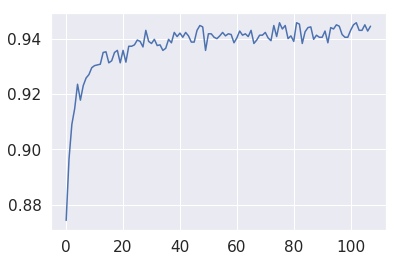

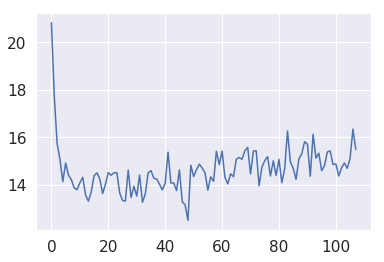

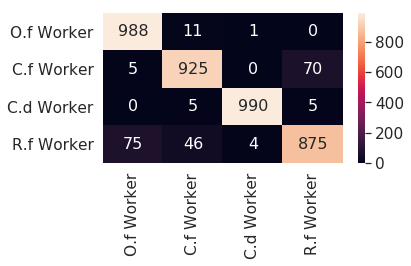

3 3
2 2
3 0
1 1
0 0
3 3
0 0
1 1
1 1
3 3
1 1
0 0
1 1
0 0
2 2
1 1
3 3
3 0
1 1
3 3
1 1
0 0
0 0
1 1
2 2
2 2
2 2
3 3
3 3
0 0
1 1
1 1
3 3
2 2
1 1
3 3
1 1
3 3
2 2
0 0
0 0
1 1
0 0
3 3
1 1
1 1
0 0
2 2
2 2
1 1
3 2
0 0
3 3
3 1
1 1
3 0
0 0
3 3
1 3
2 2
1 1
3 3
3 3
3 3
3 3
0 0
2 2
2 2
0 0
2 2
3 0
3 3
1 1
2 1
0 0
2 2
2 2
3 0
3 3
2 2
0 0
0 0
2 2
2 2
3 3
0 0
1 1
1 1
2 2
1 1
2 2
3 3
2 2
1 1
1 1
1 1
1 1
1 1
2 2
1 1
2 2
3 3
0 0
3 3
3 3
3 3
2 2
1 1
2 2
2 2
1 1
2 2
3 3
1 0
2 2
3 0
1 1
0 0
2 2
3 3
1 1
1 1
3 3
3 3
0 0
1 1
3 3
0 0
2 2
2 2
1 1
0 0
3 3
1 1
3 0
0 0
0 0
0 0
3 3
1 1
3 3
1 1
1 1
0 0
3 3
3 3
2 2
0 0
1 1
0 0
3 3
1 1
1 1
3 3
1 1
0 0
0 0
0 0
2 2
3 3
0 0
1 3
1 1
1 1
3 1
2 2
2 2
2 2
0 1
2 2
2 2
1 1
1 1
1 1
1 3
2 2
1 1
0 0
2 2
2 2
3 3
0 0
1 1
0 0
0 0
1 1
2 2
1 1
2 2
2 2
2 2
2 2
2 2
0 0
2 2
1 1
2 2
3 3
2 2
1 1
3 3
2 2
0 0
1 1
2 2
2 2
2 2
2 2
3 3
2 2
1 1
1 1
2 2
0 0
0 0
0 0
0 0
0 0
3 0
0 0
2 2
2 2
3 1
2 2
2 2
1 1
1 1
3 1
3 1
0 0
3 3
0 0
1 1
2 2
2 2
2 2
2 2
2 2
3 3
3 3
0 0
3 3
1 1
3 3
3 3
0 0
0 0
1 1
1 1
0 0


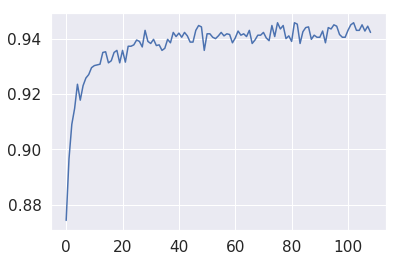

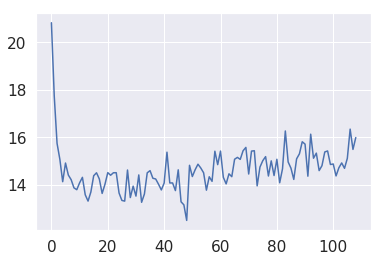

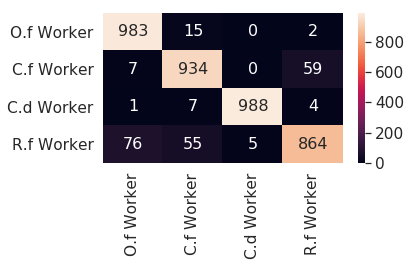

0 0
1 1
0 0
2 2
2 2
1 1
2 2
0 0
1 1
1 1
0 0
0 0
1 1
0 0
1 1
2 2
3 3
3 3
3 3
1 1
3 3
3 3
1 3
1 1
3 0
3 3
0 0
3 3
1 1
2 2
2 2
2 2
3 3
2 2
1 1
0 0
3 3
1 1
1 1
3 1
3 3
2 2
3 3
1 1
0 0
0 0
2 2
1 1
2 2
2 2
1 1
2 2
0 0
0 0
3 1
1 1
2 2
0 0
2 2
0 0
3 3
3 3
1 1
0 0
1 1
3 3
3 3
3 3
1 1
0 0
1 1
1 3
3 3
0 0
3 3
3 3
0 0
0 0
2 2
1 1
2 2
1 1
1 1
3 3
3 3
2 2
0 0
1 1
2 2
3 3
3 3
3 3
2 2
3 3
3 3
0 0
1 1
0 0
3 3
1 1
0 0
3 3
2 2
2 2
1 1
2 2
2 2
2 2
1 1
0 0
2 2
3 3
0 0
2 2
1 1
0 0
2 2
2 2
1 1
3 3
0 0
1 1
2 2
0 0
0 0
2 2
1 1
1 1
1 1
3 3
1 1
2 2
3 3
2 2
1 1
3 3
2 2
3 3
2 2
0 0
1 0
1 1
2 2
1 1
3 3
2 2
0 0
1 1
3 3
0 0
0 0
0 0
3 3
2 2
0 0
1 1
2 2
1 1
0 0
3 3
2 2
0 0
3 2
3 3
2 2
0 0
2 2
2 2
2 2
3 3
1 1
3 3
0 0
3 3
0 0
2 2
3 3
2 2
2 2
0 0
3 3
1 1
3 3
0 0
0 0
1 1
2 2
3 3
2 2
0 0
3 3
3 3
3 3
3 3
0 1
0 0
1 1
3 3
0 0
0 0
0 0
0 0
3 1
2 2
3 0
0 0
0 0
1 1
0 0
1 3
3 3
3 3
3 3
0 0
0 0
2 2
0 0
2 2
1 1
2 2
1 1
3 1
2 2
2 2
0 0
1 1
3 3
0 0
3 3
1 1
0 0
1 1
3 1
3 3
1 1
1 1
0 0
3 3
3 3
2 2
2 2
2 2
0 0
0 0
2 2
1 1
3 3
0 0
1 1
2 2


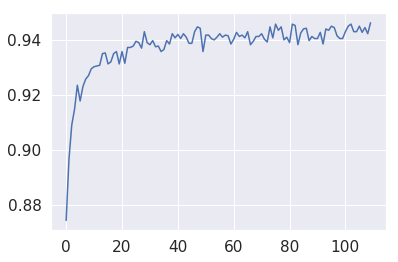

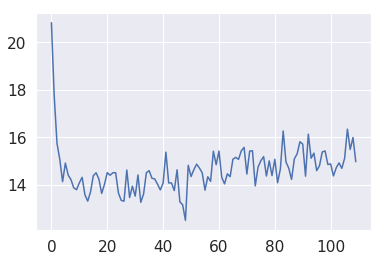

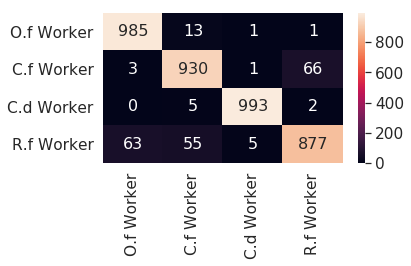

3 3
0 0
3 3
0 0
1 1
3 0
1 1
3 3
2 2
1 1
1 1
1 1
3 3
0 0
3 3
2 2
3 3
0 0
2 2
1 1
3 3
3 3
0 0
2 2
3 3
0 0
3 3
2 2
2 2
3 3
2 2
1 1
1 3
1 1
0 0
2 2
3 3
1 1
0 0
3 0
3 3
2 2
0 0
1 1
1 1
3 3
0 0
2 2
2 2
0 0
0 0
3 3
1 1
1 1
1 1
0 0
3 3
0 0
1 1
0 0
2 2
0 0
1 1
1 1
3 0
2 2
1 1
3 3
1 1
0 0
0 0
2 2
0 0
0 0
1 1
1 1
0 0
2 2
2 2
2 2
1 1
1 1
3 3
2 2
2 2
3 3
2 0
0 0
1 1
2 2
2 2
3 3
0 0
0 0
0 0
1 1
2 2
2 2
3 3
2 2
3 3
3 0
1 1
0 0
2 2
0 0
1 1
1 1
2 2
3 3
1 1
2 2
1 1
2 2
0 0
1 3
0 0
3 3
2 2
1 1
3 2
2 2
2 2
3 3
1 1
2 2
2 2
3 3
3 3
2 2
0 0
2 2
1 1
1 1
0 0
0 0
1 1
0 0
2 2
0 0
2 2
1 1
0 0
1 1
0 0
0 0
0 0
3 3
1 1
2 2
0 0
0 0
3 3
0 0
0 0
0 0
1 1
3 3
2 2
2 2
0 0
0 0
2 2
3 3
1 1
3 3
3 3
3 3
0 0
3 3
1 1
0 0
0 0
1 1
0 0
3 3
3 1
2 2
1 1
1 1
2 2
2 2
0 0
2 2
1 1
0 0
2 2
0 0
1 1
2 2
1 1
0 0
2 2
2 2
3 3
2 2
2 2
1 1
0 0
3 3
0 0
0 0
2 2
2 2
3 3
1 1
3 3
1 1
0 0
3 3
0 0
2 2
3 3
1 1
0 0
2 2
1 1
1 1
2 2
0 0
2 2
0 0
3 3
2 2
3 0
1 1
1 1
0 0
3 3
3 3
1 1
0 0
1 1
3 3
1 1
1 1
3 3
3 3
2 2
3 3
2 2
1 1
1 1
1 1
2 2
0 0
3 3
3 3
1 1
0 0


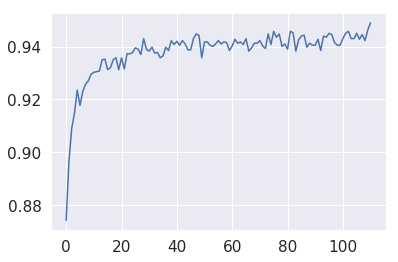

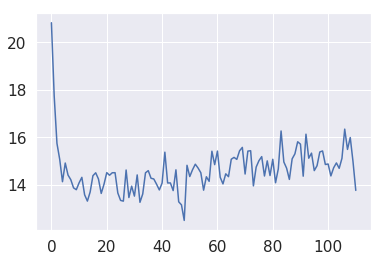

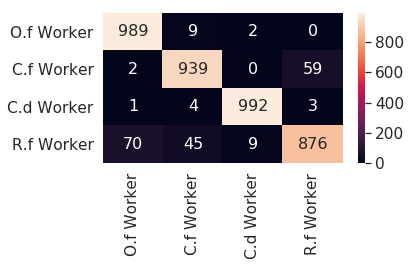

1 1
0 0
1 1
2 2
0 0
1 1
1 1
1 1
2 2
1 1
1 1
0 0
2 2
1 1
0 0
0 0
2 2
0 0
1 1
0 0
0 0
1 1
1 1
1 1
0 0
2 2
2 2
1 1
3 3
2 2
1 1
1 1
3 3
2 2
1 1
3 3
2 2
2 2
0 0
3 3
3 3
3 3
1 1
2 2
3 3
2 2
2 2
2 2
0 0
2 2
3 3
1 1
0 0
1 1
0 0
2 2
2 2
2 2
1 1
3 3
0 0
2 2
0 0
3 3
0 0
1 1
1 1
3 3
2 2
3 3
2 2
3 3
3 3
3 3
1 1
0 0
2 2
0 0
2 2
0 0
0 0
0 0
2 2
3 3
1 1
0 0
3 3
1 1
2 2
0 0
1 1
3 1
1 1
1 1
1 1
1 1
3 3
3 0
3 3
1 1
1 1
0 0
0 0
2 2
1 1
3 3
2 2
0 0
0 0
2 2
2 2
1 1
0 0
0 0
3 3
2 2
3 3
0 0
3 3
1 1
0 0
2 2
3 3
0 0
3 3
0 0
0 0
3 3
3 1
1 1
3 3
3 3
0 0
3 1
0 0
2 2
2 2
3 3
3 1
3 3
0 0
2 2
3 3
1 1
3 3
3 3
0 0
3 3
2 2
3 0
1 1
3 3
3 0
3 0
1 1
2 2
2 2
3 3
3 3
0 0
1 1
2 2
0 0
1 1
1 1
0 0
1 1
0 0
2 2
2 2
2 2
1 1
0 0
2 2
3 3
2 2
2 2
1 1
2 2
1 1
1 1
2 2
1 1
1 1
1 1
2 2
0 0
0 0
3 3
3 3
0 0
3 1
1 1
2 2
1 1
0 0
3 3
3 3
3 1
3 3
1 1
3 3
1 1
3 3
1 1
2 2
3 0
0 0
3 3
1 1
2 2
1 1
0 0
0 0
1 1
2 2
1 1
3 3
2 2
1 3
1 1
3 3
0 0
3 3
0 0
0 0
0 0
3 3
3 3
3 1
2 2
1 1
0 0
3 3
0 2
1 1
2 2
0 0
0 0
1 1
0 0
1 1
1 1
1 1
1 1
0 0
2 2
2 2
2 2
0 0


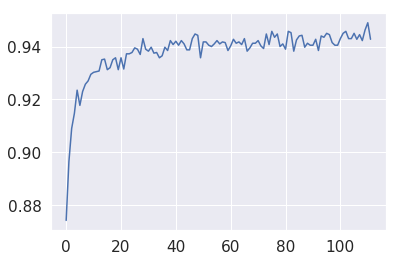

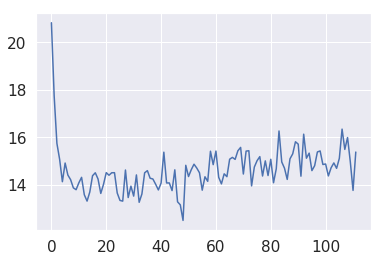

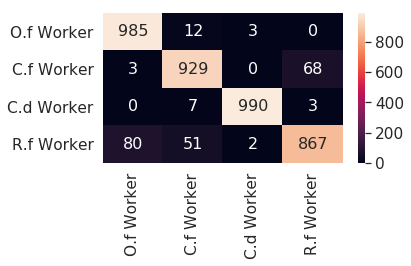

3 3
1 1
3 3
0 0
2 2
2 2
0 0
1 1
3 3
0 0
1 1
1 1
1 1
1 1
1 1
3 3
2 2
2 2
0 0
3 2
2 2
3 3
1 1
3 3
0 0
1 1
1 1
3 3
2 2
1 1
0 0
0 0
1 1
0 0
3 3
2 2
1 1
3 3
2 2
1 3
3 3
1 1
1 1
1 1
0 0
1 3
1 1
2 2
2 2
0 0
1 1
0 0
0 1
3 3
3 3
0 0
3 3
0 0
3 0
3 3
2 2
0 0
0 0
3 3
3 3
1 1
0 0
0 0
1 1
2 2
3 2
0 0
0 0
3 3
3 3
1 1
2 2
1 1
2 2
1 1
0 0
3 3
1 1
3 3
2 2
3 0
3 3
3 3
2 2
1 1
2 2
1 1
0 0
1 1
1 1
1 1
0 0
1 1
2 2
3 3
1 1
0 0
2 2
0 0
2 2
3 3
1 1
0 0
3 3
3 3
0 0
2 2
0 0
1 1
1 1
1 1
3 1
1 3
0 0
3 0
1 1
1 1
1 1
2 2
1 1
3 3
1 1
2 2
1 1
0 0
1 3
3 3
2 2
0 0
0 0
2 2
3 3
0 0
3 3
2 2
2 2
1 1
2 2
2 2
0 0
0 0
1 1
2 2
3 3
1 1
0 0
3 3
2 2
0 0
1 1
2 2
1 1
1 1
1 1
0 0
2 2
1 1
2 2
0 0
0 0
2 2
1 1
0 0
3 3
0 0
1 3
2 2
3 3
3 3
0 0
2 2
0 0
3 1
3 3
1 1
1 3
1 1
0 0
1 1
0 0
3 3
2 2
3 1
0 0
3 3
0 0
2 2
0 0
3 0
2 2
2 2
0 0
1 1
0 0
1 1
2 2
3 3
3 3
3 3
1 1
3 3
1 1
3 3
0 0
3 3
2 2
3 3
2 2
2 3
0 0
0 0
0 0
1 1
2 2
3 3
1 1
1 1
3 0
1 1
1 1
2 2
1 1
2 2
1 1
2 2
2 2
0 0
2 2
1 1
2 2
1 1
3 3
3 3
1 1
3 3
0 0
0 0
1 1
3 3
3 3
2 2
3 3
1 1
1 1
3 3


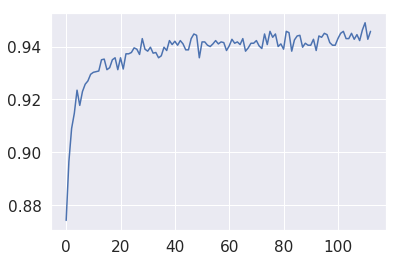

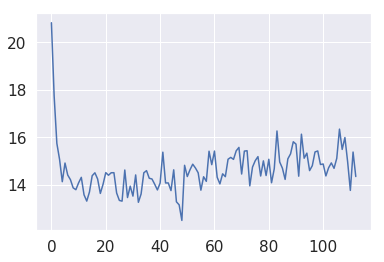

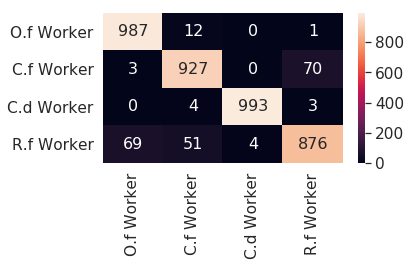

0 0
0 0
0 0
0 0
0 0
1 1
1 1
1 1
2 2
0 0
0 0
2 2
0 0
1 1
1 1
0 0
2 2
3 3
2 2
0 0
1 1
1 1
2 2
1 1
0 0
3 3
1 1
0 0
3 3
1 1
2 2
2 2
3 3
2 2
0 0
1 1
1 1
2 2
3 3
2 2
2 3
0 0
1 1
0 0
1 1
3 3
2 2
3 3
2 2
3 3
1 1
2 2
2 2
3 3
0 0
2 2
2 2
0 0
0 0
3 3
0 0
0 0
1 1
1 1
3 3
1 1
3 3
0 0
0 0
2 2
2 2
1 1
2 2
2 2
1 1
3 3
1 1
1 1
2 2
3 3
2 2
1 3
0 0
3 3
2 2
0 0
3 1
0 0
0 0
2 2
1 1
3 0
1 3
1 1
0 0
0 0
2 2
0 0
3 3
0 0
3 3
1 1
2 2
3 3
3 3
0 0
0 0
1 1
2 2
2 2
0 0
2 2
2 2
0 0
1 1
1 1
0 0
2 2
0 0
1 1
2 2
1 1
3 3
1 1
3 2
1 1
1 1
0 0
0 0
2 2
0 0
1 1
3 3
2 2
0 0
1 1
1 1
0 0
0 0
0 0
3 3
2 2
3 3
2 2
0 0
1 1
1 1
2 2
1 1
0 0
0 0
3 3
2 2
2 2
0 0
1 1
2 2
1 1
3 3
3 0
3 3
2 2
2 2
3 3
3 3
3 3
0 0
2 2
0 0
2 2
2 2
0 0
3 0
2 2
3 3
0 0
0 0
3 0
3 3
0 0
2 2
3 3
3 3
2 2
2 2
1 1
3 3
2 2
3 3
0 0
1 1
1 1
0 0
1 1
2 2
2 2
1 1
1 1
0 0
1 1
1 3
0 0
1 1
3 3
2 2
3 3
2 2
2 2
3 3
0 0
2 2
2 2
2 2
1 1
3 3
2 2
3 3
3 3
2 2
3 3
1 1
3 3
1 1
0 0
0 0
1 1
1 3
3 3
1 1
3 3
1 1
1 1
1 1
0 0
2 2
3 3
2 2
3 1
3 3
1 1
2 2
3 3
2 2
0 0
2 2
0 0
2 2
2 2
3 3
1 1


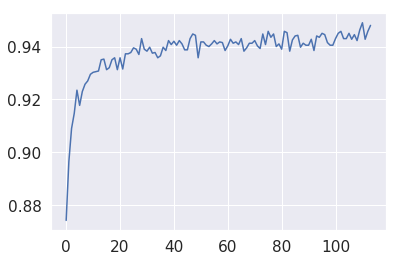

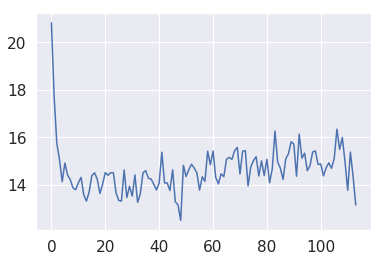

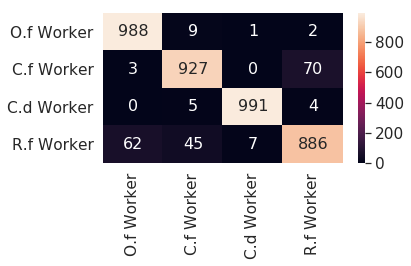

0 0
1 1
1 1
3 3
1 1
2 2
2 2
3 3
3 3
2 2
0 0
1 1
2 3
0 0
0 0
2 2
2 2
3 0
2 2
2 2
3 3
2 2
1 1
3 3
0 0
2 2
3 3
1 1
2 2
0 0
0 0
3 0
3 3
2 2
0 0
1 1
1 1
1 1
0 0
3 3
2 2
1 1
1 1
1 1
0 0
3 3
2 2
2 2
2 2
2 2
0 0
3 3
1 1
0 0
2 2
2 2
1 1
3 3
3 3
0 0
1 1
3 3
0 0
2 2
2 2
0 0
3 1
2 2
1 1
0 0
0 0
2 2
1 3
0 0
1 1
2 2
1 3
2 2
2 2
2 2
3 3
2 2
2 2
0 0
3 3
3 1
2 2
0 0
0 0
0 0
1 1
0 0
2 2
2 2
3 0
0 0
0 0
0 0
1 3
0 0
2 2
2 3
2 2
3 0
1 1
1 1
0 0
1 1
1 1
1 1
0 0
2 2
1 1
1 1
2 2
2 2
2 2
2 2
2 2
0 0
2 2
2 3
2 2
3 3
1 1
1 1
1 1
0 0
2 2
1 1
0 0
1 1
0 0
1 1
0 0
3 3
0 0
3 3
0 0
0 0
2 2
3 3
3 3
0 0
1 1
0 0
3 3
0 0
2 2
0 0
1 1
3 3
2 2
2 2
1 1
3 3
1 1
1 1
3 3
1 1
2 2
0 0
1 1
3 3
1 1
3 1
2 2
0 0
1 1
1 1
1 1
1 1
1 1
2 2
1 1
2 2
2 2
0 0
0 0
1 1
3 3
1 1
1 1
0 0
0 0
2 2
3 3
2 2
2 2
1 3
3 3
3 3
0 0
3 3
0 0
2 2
0 0
2 2
0 0
1 3
3 3
3 3
1 1
2 2
3 3
1 1
3 3
3 3
1 1
3 3
2 2
1 1
1 1
2 2
2 2
2 2
1 1
0 0
3 3
3 3
2 2
3 3
2 2
0 0
2 2
0 0
0 0
0 0
3 3
1 1
3 1
3 1
3 3
2 2
1 3
1 1
2 2
3 3
0 0
3 1
3 3
2 2
1 1
2 2
1 1
2 2
2 2
3 3
0 0
3 3


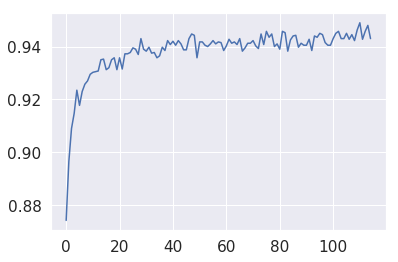

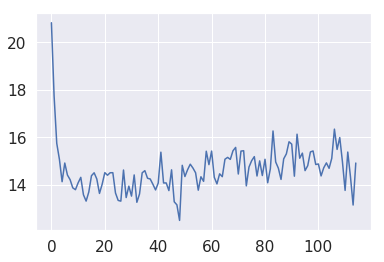

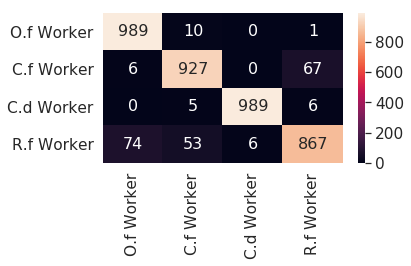

0 0
0 0
3 3
0 0
1 1
1 1
1 1
2 2
2 2
3 1
1 1
2 2
2 2
0 0
0 0
1 1
2 2
2 2
3 3
0 1
1 1
0 0
3 0
2 2
1 1
2 2
0 0
3 3
0 0
0 0
2 2
2 2
3 3
3 3
3 3
0 0
0 0
0 0
2 2
2 2
1 1
2 2
2 2
0 0
2 2
0 0
0 0
2 2
1 1
0 0
0 0
2 2
2 2
1 1
0 0
2 2
0 0
0 0
3 3
0 0
2 2
1 1
3 3
2 2
2 3
3 3
1 1
1 1
1 1
2 2
0 0
3 3
1 1
2 2
2 2
0 0
3 3
3 3
3 0
1 1
1 1
3 3
2 2
1 1
2 3
2 2
0 0
2 2
2 2
3 0
0 0
0 0
3 3
1 1
0 0
0 0
2 2
1 1
3 3
3 3
3 1
0 0
3 3
0 0
2 2
3 3
1 1
0 0
3 3
0 0
2 2
3 0
1 1
1 1
2 2
2 2
1 1
3 3
0 0
1 1
3 3
0 0
2 2
2 2
2 2
3 3
1 1
3 3
3 3
0 0
1 1
3 1
2 2
1 1
0 0
0 0
1 1
1 1
0 0
1 1
2 2
1 1
0 0
1 1
1 1
0 0
2 2
2 2
0 0
1 1
3 3
1 3
3 3
3 3
2 2
1 3
3 3
3 3
1 1
2 2
2 2
3 3
3 3
3 3
0 0
2 2
0 0
2 2
3 1
3 3
0 0
2 2
2 2
1 1
1 1
2 2
0 0
3 3
1 1
2 2
1 1
2 2
1 1
0 0
3 3
1 1
2 2
2 2
1 1
2 2
1 1
1 1
3 3
1 1
2 2
3 3
1 1
1 3
2 2
1 1
0 0
2 2
1 1
0 0
2 2
0 0
2 2
1 1
1 1
1 1
0 0
3 3
1 1
1 1
2 2
0 0
2 2
2 2
0 0
3 3
0 0
3 3
3 3
1 3
0 0
2 1
0 0
1 1
0 0
2 2
2 2
0 0
0 0
1 1
1 1
2 2
2 2
1 3
3 3
3 3
1 1
3 1
1 1
0 0
0 0
1 1
2 2
2 2
0 0
1 1


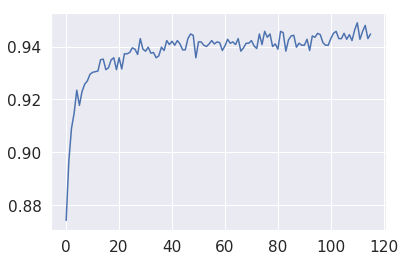

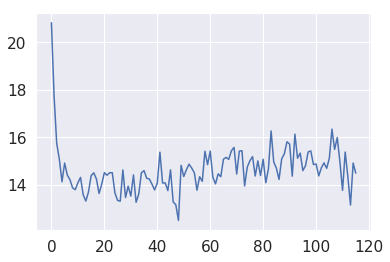

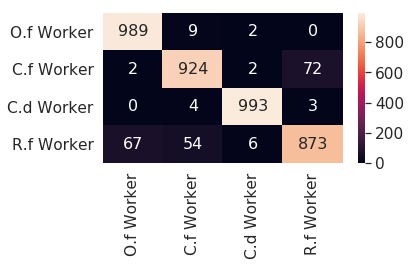

3 3
3 3
2 2
1 1
3 0
1 1
1 1
1 1
3 3
0 0
0 0
3 3
1 1
0 0
1 1
3 3
3 3
3 3
1 1
0 0
2 2
2 2
1 1
2 2
0 0
1 1
2 2
3 0
2 2
3 3
3 3
0 0
1 1
2 2
3 3
2 2
3 3
1 1
0 0
1 1
0 0
2 2
0 0
3 3
0 0
1 1
3 3
1 1
2 2
3 0
0 0
1 1
3 3
0 0
0 0
1 1
3 3
1 1
3 3
1 1
1 1
0 0
1 1
1 3
0 0
3 3
1 1
1 1
0 0
3 3
2 2
3 3
1 1
1 1
1 1
1 1
0 0
2 2
0 0
2 2
3 3
2 2
1 1
3 3
3 3
3 3
2 2
2 2
0 0
0 0
1 1
3 3
2 2
3 3
2 2
0 0
1 1
3 3
2 2
0 0
2 2
0 0
1 1
1 3
3 3
3 3
1 1
2 2
3 3
2 2
0 0
3 3
3 3
1 1
1 1
3 3
0 0
2 2
0 0
3 3
3 3
2 2
1 1
0 0
2 2
1 1
2 2
0 0
3 1
3 3
2 2
2 2
3 3
3 1
2 2
1 1
2 2
3 3
2 2
3 3
3 3
0 1
3 3
1 1
3 3
2 2
0 0
1 1
3 3
1 1
2 2
0 0
2 2
3 3
0 0
3 0
0 0
1 1
0 0
1 1
1 1
2 2
3 3
0 0
2 2
2 2
3 3
3 3
2 2
3 3
3 0
2 2
2 2
2 2
0 0
0 0
3 3
1 1
3 3
0 0
3 1
2 2
3 3
1 1
2 2
0 1
1 3
0 0
2 2
0 0
3 0
1 1
2 2
3 3
3 0
3 3
1 1
2 2
3 3
0 0
1 1
3 3
2 2
3 0
3 3
1 1
1 1
2 2
3 3
3 3
1 1
1 1
1 1
3 3
0 0
2 2
1 1
3 0
3 0
1 0
2 2
3 3
2 2
2 2
0 0
1 1
0 0
3 3
3 3
3 3
2 2
3 3
2 2
0 0
3 3
3 1
3 3
1 1
3 3
1 1
1 1
1 1
2 2
2 2
2 2
3 3
1 1
1 1
3 3
2 2


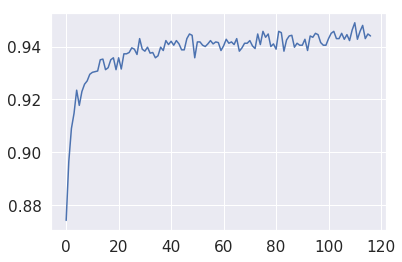

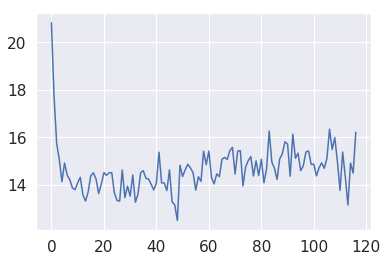

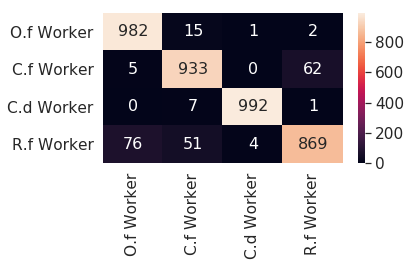

0 0
3 3
1 1
3 3
2 2
3 3
2 2
0 0
0 0
3 0
3 3
3 3
3 3
2 2
2 2
1 3
1 1
0 0
0 0
0 0
2 2
1 1
1 1
0 0
2 2
3 3
2 2
1 1
3 3
2 2
1 1
3 3
2 2
0 0
1 1
2 2
1 1
1 1
2 2
3 3
0 0
2 2
3 3
0 0
0 0
1 1
2 2
2 2
0 0
0 0
3 3
2 2
2 2
1 1
2 2
0 0
2 2
1 1
3 1
1 1
2 2
3 0
1 1
0 0
1 1
3 3
3 3
1 1
2 2
2 2
1 1
3 3
2 2
1 1
0 0
0 0
0 0
0 0
3 3
1 1
0 0
1 1
2 2
0 0
0 0
3 3
3 0
1 1
2 2
1 1
2 2
1 1
0 0
2 2
3 3
3 3
1 1
3 3
3 3
3 3
2 2
1 1
3 3
2 2
0 0
1 1
1 1
3 3
1 1
2 2
1 1
0 0
1 1
0 0
0 0
0 0
0 0
3 3
2 2
3 3
1 1
0 0
1 1
1 1
0 0
1 1
0 0
1 3
2 2
2 2
0 0
0 0
2 2
3 3
0 0
2 2
3 3
0 0
3 3
2 2
1 1
0 0
2 2
2 2
0 0
2 2
0 0
1 1
0 0
3 3
0 0
1 1
3 3
0 0
1 1
1 1
1 1
3 3
2 2
2 2
3 0
0 0
3 0
3 3
1 1
2 2
2 2
0 0
0 0
0 0
0 0
0 0
3 3
2 2
3 3
3 3
0 0
1 1
1 1
3 3
0 1
2 2
3 3
1 1
3 3
2 2
0 0
0 0
3 3
0 0
0 0
0 0
2 2
0 0
3 3
1 1
2 2
1 1
3 3
3 3
2 2
0 0
0 0
0 0
3 3
1 1
2 2
1 1
3 3
2 2
2 2
1 1
0 0
2 2
2 2
2 2
1 1
2 2
0 0
0 0
1 1
0 0
1 1
3 3
1 1
1 1
0 0
1 1
2 2
1 1
1 1
0 0
0 0
1 1
3 3
3 3
2 2
1 1
3 3
2 2
0 0
2 2
2 2
2 2
1 1
0 0
3 3
1 1
2 2
0 0


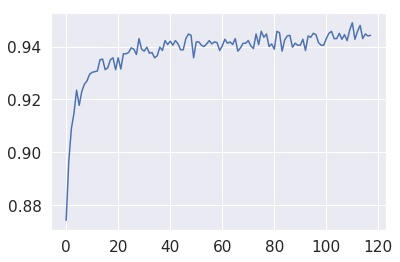

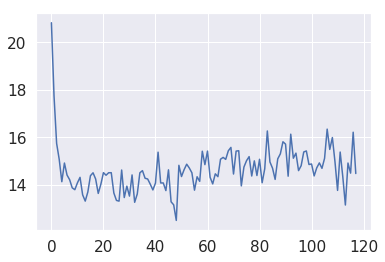

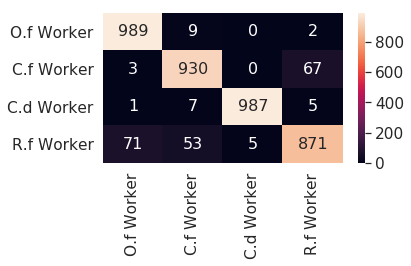

3 3
0 0
0 0
3 3
0 0
0 0
0 0
1 1
1 1
2 2
1 1
1 1
0 0
2 2
3 3
3 3
3 3
1 1
3 3
0 0
3 3
0 0
2 2
0 0
1 1
2 2
2 2
1 1
0 0
3 3
1 1
3 3
3 3
1 1
3 3
1 1
3 3
2 2
2 2
1 1
0 0
1 1
2 2
0 0
3 3
2 2
3 3
1 1
3 3
0 0
2 2
2 2
3 3
0 0
0 0
2 2
3 3
0 0
3 3
0 0
2 2
0 0
1 1
3 0
0 0
3 3
0 0
0 0
2 2
0 0
2 2
0 0
3 3
1 3
3 3
1 1
1 1
0 0
0 0
3 0
0 0
1 1
3 3
2 2
3 3
3 3
3 3
1 1
0 0
3 3
3 3
3 3
1 1
2 2
0 0
1 1
2 2
3 1
1 1
0 0
1 1
3 3
1 1
2 2
0 0
1 1
3 3
0 0
3 3
0 0
0 0
0 0
0 2
2 2
2 2
1 1
0 0
2 2
0 0
3 3
3 3
2 2
3 0
1 1
0 0
0 0
0 1
0 0
1 3
0 0
1 1
3 3
3 3
0 0
0 0
3 3
0 0
2 2
2 2
0 0
3 3
2 2
1 1
0 0
0 0
0 0
2 2
0 0
3 3
1 1
3 3
3 3
0 0
2 2
0 0
1 1
1 1
0 0
1 1
2 2
3 3
1 1
2 2
1 1
2 2
0 0
1 1
1 1
3 3
0 0
3 3
2 2
3 3
1 1
2 2
0 0
2 2
3 3
1 1
1 1
3 3
2 2
0 1
0 0
0 0
1 1
3 3
0 0
2 2
2 2
3 3
0 0
2 2
3 3
3 3
3 3
3 0
2 2
2 2
1 1
0 0
1 1
1 1
3 3
3 0
2 2
3 3
1 1
2 2
1 1
0 0
2 2
1 1
2 2
2 2
1 1
2 2
3 3
1 1
2 2
0 0
0 0
3 3
0 0
2 2
2 2
1 1
0 0
1 1
1 3
2 2
3 3
1 1
2 2
2 2
1 1
0 0
2 2
2 2
1 1
3 3
2 2
0 0
3 3
1 1
2 2
3 3
2 2
3 3
2 2


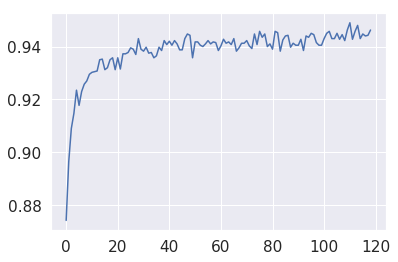

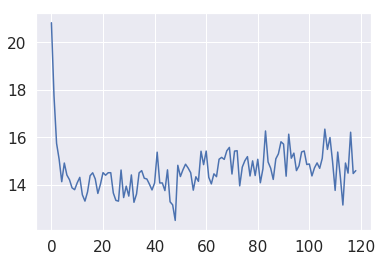

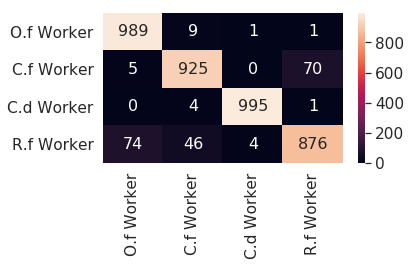

0 0
2 2
3 3
0 0
1 1
1 1
1 1
3 0
1 1
2 2
1 1
2 2
0 0
1 1
0 0
2 2
0 0
1 1
3 0
1 1
2 2
0 0
3 3
1 1
3 3
2 2
3 3
2 2
1 1
1 1
2 2
1 0
0 0
0 0
0 0
1 1
2 2
2 2
2 2
0 0
3 3
3 3
2 2
1 1
3 3
1 1
3 3
2 2
1 1
1 3
3 3
0 0
3 3
2 2
1 1
0 0
0 0
2 2
1 1
3 0
1 1
1 1
0 0
3 3
1 1
1 1
0 0
3 3
2 2
3 3
1 1
0 0
1 1
3 3
3 0
2 2
0 0
0 0
2 2
3 3
1 1
3 3
2 2
3 3
2 2
2 2
1 1
3 3
3 3
2 2
2 2
1 1
3 3
2 2
2 2
2 2
3 3
1 1
3 3
0 0
0 0
2 2
0 0
3 3
2 2
2 2
0 0
0 0
1 1
1 1
3 3
2 2
3 3
0 0
0 0
0 0
2 2
2 2
0 0
3 3
2 2
2 2
3 3
1 1
2 2
1 1
2 2
2 2
0 0
2 2
2 2
0 0
2 2
1 1
1 1
1 0
2 2
3 3
3 3
1 1
1 1
1 1
1 1
2 2
0 0
0 0
3 3
0 0
3 3
3 3
2 2
1 1
1 1
3 3
2 2
1 1
1 1
1 1
0 0
3 3
0 0
0 0
2 2
1 3
1 1
0 0
1 1
2 2
1 1
0 0
0 0
2 2
0 0
3 3
1 1
0 0
0 0
3 3
2 2
2 2
2 2
3 1
0 0
1 1
1 3
1 1
2 2
3 0
3 3
2 2
1 1
2 2
1 1
3 3
1 1
1 1
2 2
2 2
3 3
1 1
2 2
2 2
1 1
2 2
2 2
0 0
3 3
3 0
0 0
0 0
0 0
3 3
3 3
2 2
3 0
2 1
3 3
2 2
1 1
2 2
0 0
1 1
3 0
0 0
2 2
1 1
2 2
3 3
2 2
0 0
3 3
3 3
3 0
3 3
3 3
3 3
0 0
2 2
1 1
3 3
2 2
0 0
2 2
1 1
1 1
3 0
1 1
2 2
1 1
2 2


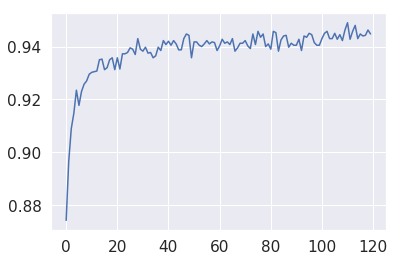

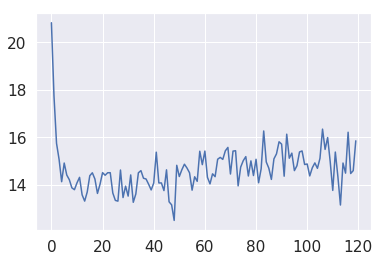

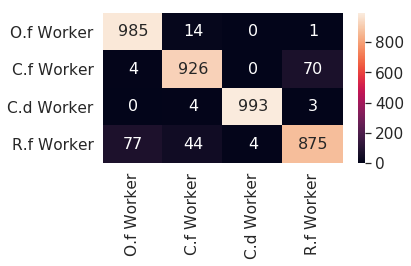

0 0
3 3
2 2
2 2
0 0
0 0
1 1
0 0
0 0
1 1
2 2
2 2
1 1
0 0
1 1
2 2
3 3
3 3
2 2
1 1
2 2
2 2
0 0
3 3
2 2
1 1
2 2
1 1
0 0
0 0
3 3
1 1
0 0
2 2
3 3
0 0
2 2
0 0
2 2
0 0
3 3
3 3
0 0
2 2
2 2
3 3
2 2
0 0
2 2
0 0
1 1
3 3
1 0
2 2
1 1
0 0
2 2
1 3
2 2
2 2
0 0
2 2
0 0
1 1
0 0
2 2
0 0
0 0
2 2
1 1
2 2
3 3
2 2
0 0
2 2
3 3
0 0
1 3
3 1
2 2
2 2
0 0
3 3
3 3
3 3
0 0
3 3
3 3
1 1
2 2
2 2
2 2
0 0
2 2
2 2
0 0
1 3
0 0
2 2
0 0
0 0
1 1
0 0
1 1
1 1
2 2
2 2
2 2
1 1
0 0
1 1
1 1
2 2
3 3
1 1
1 3
0 0
1 1
2 2
2 2
0 0
2 2
1 1
2 2
3 3
1 1
0 0
2 2
0 0
0 0
1 1
2 2
0 0
3 3
2 2
3 3
0 0
2 2
2 2
2 2
1 1
3 3
3 3
1 1
3 3
2 2
3 3
0 0
2 2
1 1
3 3
2 2
3 3
3 3
2 2
3 3
1 1
2 2
3 3
1 1
2 2
2 2
2 2
1 1
1 1
2 2
1 1
3 1
0 0
0 0
2 2
0 0
0 0
3 3
0 0
3 3
2 2
1 1
0 0
3 3
3 3
0 0
1 1
0 0
3 3
3 3
3 3
0 0
2 2
0 0
1 1
0 0
0 0
3 3
1 1
0 0
3 0
0 0
2 2
1 1
2 2
0 0
1 3
0 0
0 0
3 3
0 0
2 2
3 3
0 0
3 3
0 0
1 1
1 1
2 2
1 1
1 1
2 2
3 0
3 3
1 1
3 3
2 2
3 3
0 0
1 1
2 2
2 2
0 0
3 3
3 3
1 1
1 1
2 2
1 1
2 2
0 0
0 0
1 1
2 2
1 1
0 0
2 2
2 2
0 0
3 3
1 3
2 2
2 2
3 1


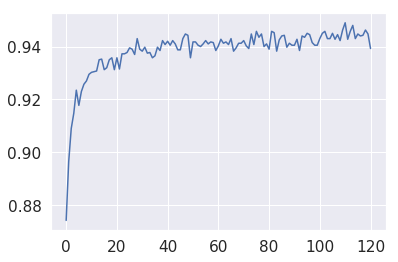

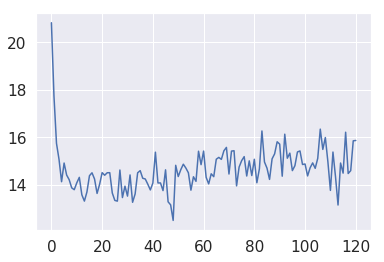

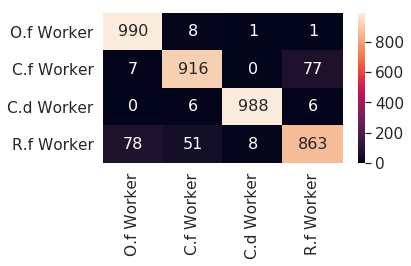

2 2
0 0
1 1
1 1
2 2
3 3
2 2
0 0
1 1
1 1
3 3
3 1
3 3
1 1
2 2
3 3
0 0
1 1
0 0
3 3
3 3
2 2
0 0
2 2
1 1
1 1
0 0
2 2
3 1
2 2
1 1
0 0
1 3
0 0
2 2
3 3
3 3
3 3
0 0
2 2
1 1
0 0
3 3
1 1
2 2
1 1
0 0
2 2
3 3
2 2
3 3
3 3
3 0
0 0
1 1
0 0
3 3
3 3
0 0
1 1
0 0
1 3
2 2
2 2
1 1
1 1
3 3
2 2
0 0
1 1
0 0
3 3
3 1
2 2
2 2
1 1
2 2
0 0
3 3
2 2
2 1
1 1
1 1
3 3
0 0
1 1
3 0
0 0
2 2
3 0
1 3
3 3
1 1
2 2
2 2
2 2
2 2
2 2
1 1
1 1
0 0
3 3
2 2
2 2
1 1
1 3
2 2
0 0
2 2
2 2
1 1
0 0
2 2
0 0
1 1
1 1
2 2
1 1
2 2
1 1
1 3
0 0
1 1
2 2
2 2
3 3
2 2
0 0
2 2
3 3
3 0
3 3
3 0
0 0
1 1
3 3
3 3
0 0
2 2
1 1
0 0
1 1
1 1
2 2
0 0
0 0
3 3
2 2
3 3
0 0
2 2
3 3
3 3
3 3
3 3
3 3
3 3
2 2
1 1
3 3
1 1
3 3
2 2
2 2
0 0
3 3
3 3
1 1
0 0
2 2
2 2
0 0
3 3
1 1
0 0
2 2
1 1
0 0
1 1
1 1
2 2
2 2
0 0
3 0
1 1
1 1
2 2
2 2
1 1
2 2
1 1
0 0
1 1
0 0
0 0
3 3
0 0
2 2
3 0
2 2
2 2
2 2
0 0
1 3
0 0
2 2
2 2
0 0
1 1
0 0
2 2
3 3
2 2
3 3
0 0
1 1
3 0
1 3
3 1
0 0
0 0
3 3
1 1
0 0
2 2
1 1
0 0
1 1
2 2
3 3
2 2
0 0
3 3
3 3
1 1
3 3
3 3
1 1
1 1
2 2
0 0
3 3
2 2
2 2
3 3
2 2
0 0
3 3
0 0
0 0


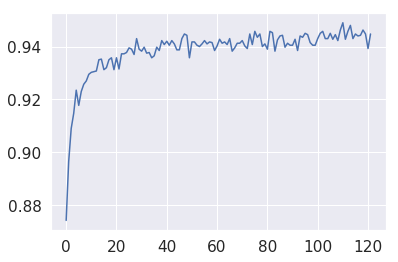

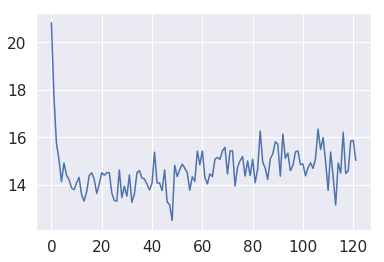

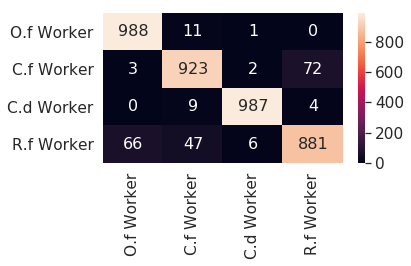

1 1
0 0
3 3
3 3
1 1
1 1
1 1
1 1
0 0
2 2
3 3
1 1
3 0
3 3
0 0
2 2
1 1
0 0
3 3
2 2
0 0
2 2
1 1
0 0
3 3
2 2
2 2
0 0
1 1
3 3
0 0
3 3
2 2
1 1
3 1
2 2
3 3
3 3
0 0
2 2
2 2
2 2
1 1
0 0
3 3
1 1
1 1
1 1
1 1
0 0
3 3
2 2
2 2
3 3
1 1
3 0
0 0
1 1
2 2
2 2
3 3
2 2
3 3
3 3
2 2
3 3
0 0
1 1
2 2
2 2
0 0
1 1
2 2
1 1
2 2
2 2
1 1
2 2
1 1
3 3
0 0
3 3
0 0
1 1
1 1
0 0
0 0
2 2
2 2
0 0
1 1
0 0
2 2
0 0
3 3
3 3
0 0
1 1
1 1
0 0
0 0
1 1
2 2
1 1
0 0
3 3
3 3
1 1
0 0
0 2
0 0
3 3
2 2
1 1
3 3
3 3
3 3
1 1
1 1
1 1
3 3
1 1
1 1
3 3
3 3
2 2
1 1
3 3
3 0
3 3
0 0
2 2
0 0
3 3
1 1
2 2
3 3
2 2
0 0
0 0
2 2
1 1
3 3
1 1
0 0
0 0
1 1
2 2
3 3
0 0
1 1
0 0
1 1
2 2
2 2
3 3
3 3
1 1
2 2
1 1
0 0
3 3
0 0
0 0
3 3
3 3
1 1
2 2
1 1
3 3
0 0
3 3
3 0
3 3
2 2
0 0
2 2
3 3
3 3
0 0
3 3
1 1
1 1
1 1
2 2
0 0
1 1
3 3
3 3
2 2
2 2
3 3
3 3
1 1
1 1
3 3
1 1
3 3
0 0
2 2
2 2
1 1
2 2
1 1
1 1
2 2
2 2
0 0
0 0
2 2
2 2
0 0
2 2
2 2
2 2
1 1
1 1
3 3
2 2
1 1
1 1
3 3
0 0
3 3
1 1
3 3
0 0
1 1
0 0
3 0
3 3
2 2
1 1
0 0
3 3
3 3
2 2
2 2
3 3
2 2
0 0
1 1
1 1
1 1
0 0
1 1
0 0
3 3
3 3
1 1


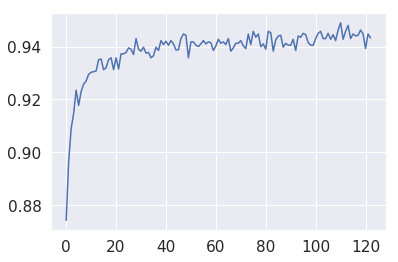

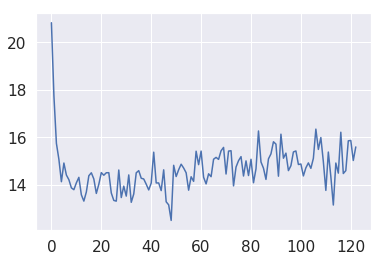

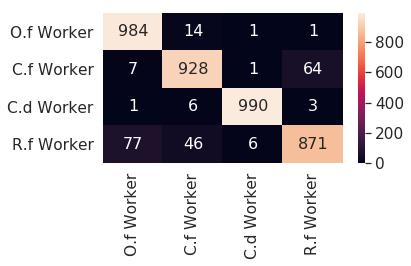

2 2
2 2
2 2
3 3
1 1
3 3
3 3
0 0
1 1
2 2
2 2
3 3
1 1
1 1
2 2
3 3
3 3
3 3
0 0
0 0
0 0
2 2
2 2
2 2
1 1
3 0
1 3
3 3
0 0
0 0
1 1
2 2
0 0
2 2
0 0
2 2
0 0
1 1
2 2
3 3
3 1
2 2
1 1
1 1
0 0
1 1
0 0
3 3
1 1
2 2
3 3
3 3
2 2
1 1
1 1
3 3
2 2
0 0
0 0
2 2
3 1
2 2
1 1
0 0
1 1
0 0
1 1
0 0
0 0
0 0
2 2
1 1
3 3
3 3
2 2
2 2
0 0
0 0
3 3
3 3
3 3
2 2
2 2
1 1
3 3
3 3
2 2
1 1
1 1
0 0
3 3
1 1
3 3
3 3
2 2
2 2
2 2
2 2
2 2
2 2
2 2
2 2
2 2
2 2
0 0
0 0
0 0
1 1
1 1
3 3
1 1
2 2
1 1
2 2
3 3
3 3
3 0
1 1
1 1
1 1
3 0
3 3
1 1
3 1
1 1
1 1
3 3
2 2
3 3
2 2
2 2
3 3
0 0
1 1
1 3
1 1
3 3
3 3
1 1
2 2
1 1
3 3
0 0
0 0
3 3
3 3
1 1
1 1
1 1
0 0
2 2
1 1
1 1
1 1
0 0
1 1
1 1
2 2
0 0
2 2
3 3
2 2
0 0
1 1
0 0
1 1
0 0
1 1
1 3
2 2
1 1
3 3
2 2
2 2
3 3
1 1
1 1
0 0
1 1
0 0
2 2
0 0
3 3
2 2
2 2
1 1
1 1
0 0
1 1
0 0
0 0
3 3
3 3
0 0
1 1
2 2
2 2
2 2
3 3
0 0
2 2
1 3
0 0
2 2
1 1
3 3
2 2
1 1
3 3
3 0
0 0
2 1
1 1
3 0
1 1
2 2
0 0
3 3
1 1
1 1
3 3
3 3
1 1
2 2
1 1
3 3
3 3
0 0
2 2
3 3
3 3
2 2
1 1
2 2
0 0
0 0
3 3
1 1
1 1
3 3
0 0
0 0
2 2
0 0
2 2
1 1
3 3
0 0
2 2
2 2


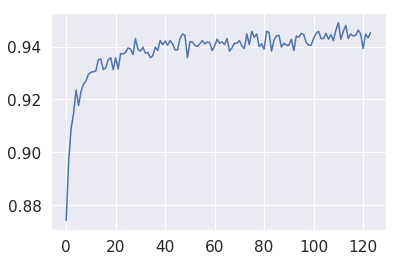

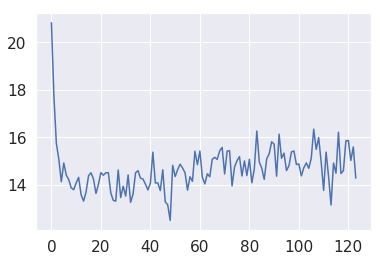

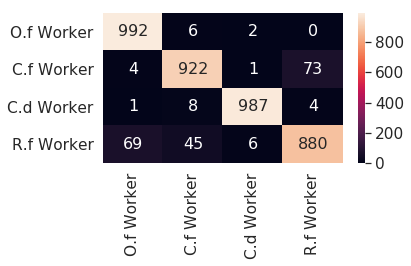

0 0
1 1
0 0
2 2
2 2
1 1
3 3
3 3
3 3
0 0
0 0
1 1
2 2
2 2
3 3
2 2
3 3
1 1
3 3
0 0
3 3
0 0
1 1
3 3
0 0
2 2
3 3
3 3
3 3
3 3
3 3
3 3
2 2
0 0
0 0
1 1
0 0
3 3
1 1
2 2
3 3
0 0
0 0
1 1
1 1
1 1
2 2
3 3
3 3
0 0
2 2
2 2
3 3
0 0
2 2
3 3
0 0
1 1
2 2
2 2
3 3
2 2
0 0
0 0
1 1
0 0
2 2
0 0
0 0
3 3
2 2
3 3
1 1
3 3
2 2
0 0
0 0
3 3
1 1
2 2
2 2
2 2
0 0
0 0
2 2
2 2
3 3
1 1
1 1
2 2
1 1
1 1
2 2
3 3
3 3
0 0
3 3
2 2
0 0
2 2
1 1
3 3
0 0
1 1
0 0
1 1
1 1
1 1
1 1
0 0
2 2
0 0
2 2
3 3
0 0
0 0
3 3
1 3
0 0
1 1
3 3
3 3
0 0
2 2
2 2
0 0
3 3
3 0
3 3
1 1
2 2
3 3
2 2
0 0
2 2
1 1
1 1
2 2
2 2
0 0
0 0
1 1
2 2
1 1
3 3
3 3
1 1
0 0
3 0
0 0
3 3
2 2
1 1
3 3
0 0
0 0
1 1
1 1
1 1
2 2
1 1
0 0
2 2
2 2
2 2
0 0
1 1
2 2
1 1
1 1
2 2
1 1
2 2
2 2
0 0
1 1
2 2
3 3
0 0
3 3
1 1
1 1
0 0
1 1
2 2
1 1
0 0
0 0
0 0
1 1
2 2
0 0
2 2
1 1
3 3
3 3
3 3
0 0
3 3
2 2
2 2
3 3
1 1
2 2
0 0
0 0
3 3
1 1
1 1
2 2
0 0
3 3
2 2
3 3
1 1
0 0
1 1
1 1
2 2
1 1
3 0
3 3
0 0
1 1
0 0
0 0
2 2
0 0
0 0
3 3
2 2
0 0
0 0
3 3
0 0
3 3
1 1
0 0
0 0
1 1
3 3
1 1
1 1
1 1
3 3
0 0
1 1
3 1
3 3
3 3


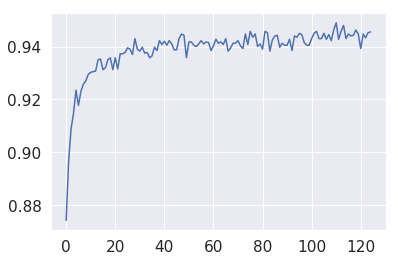

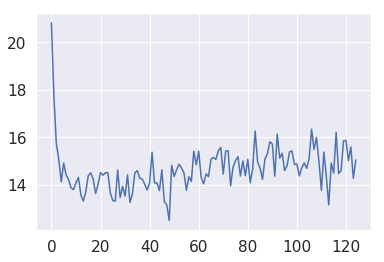

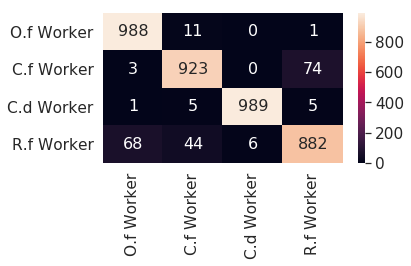

2 2
0 0
0 0
0 0
1 1
1 1
1 1
1 1
0 0
2 2
2 2
0 0
0 0
3 3
2 2
0 0
2 2
1 1
2 2
1 1
2 2
3 3
2 2
2 2
3 3
1 1
3 3
1 1
0 0
1 1
0 0
2 2
2 2
0 0
1 1
0 0
3 3
0 0
1 3
2 2
1 1
2 2
3 3
2 2
2 2
0 0
1 1
0 0
0 0
3 3
1 1
3 3
0 0
2 2
2 2
0 0
0 0
0 0
2 2
0 0
1 1
2 2
3 3
0 0
0 0
0 0
0 2
0 0
0 0
3 3
0 0
0 0
1 1
1 1
2 2
3 3
1 3
1 1
1 3
0 0
1 1
2 2
2 2
2 2
2 2
2 2
2 2
2 2
0 0
3 3
1 1
0 0
1 1
3 3
2 2
0 0
2 2
0 0
1 1
0 0
2 2
2 2
0 0
2 2
1 1
1 1
0 0
0 0
3 0
2 2
0 0
1 1
3 3
3 3
3 3
3 3
3 3
2 2
3 3
0 1
3 3
0 0
0 1
2 2
0 0
1 1
3 3
0 0
0 0
2 2
0 0
2 2
2 2
2 2
2 2
2 2
1 1
1 1
1 0
2 2
2 2
1 1
3 3
2 2
3 3
0 0
1 1
1 1
2 2
3 3
0 0
2 2
3 3
3 3
0 0
0 0
1 1
0 0
2 2
0 0
3 3
0 0
3 3
3 0
1 1
0 0
3 3
3 3
0 0
1 1
1 1
2 2
1 1
1 3
3 0
3 3
1 3
0 0
2 2
1 1
2 2
3 3
3 1
1 1
3 3
3 3
1 1
1 1
2 2
0 0
0 0
3 3
1 1
3 3
1 1
2 2
0 0
1 1
3 3
2 2
2 2
2 2
2 2
1 3
1 1
0 0
2 2
3 3
0 0
1 1
2 2
1 1
0 0
3 0
3 0
1 1
2 2
0 0
0 0
3 3
0 0
2 2
0 0
2 2
0 0
3 3
0 0
1 1
2 2
0 0
2 2
1 1
2 3
3 3
2 2
0 0
2 2
3 3
1 1
2 2
3 3
3 3
0 0
0 0
1 1
2 2
3 3
2 2
0 0
0 0


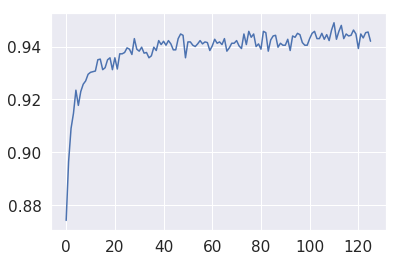

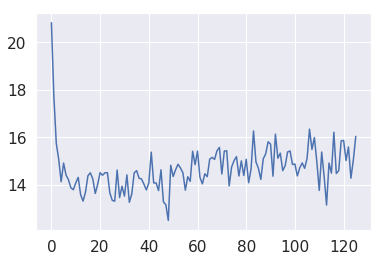

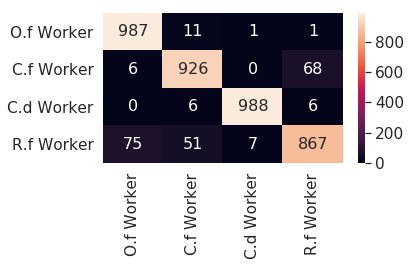

2 2
0 0
1 3
1 0
3 3
1 1
3 3
3 3
0 0
3 3
1 1
0 0
2 2
3 3
1 1
2 2
0 0
2 2
1 1
0 0
0 0
3 3
1 1
0 0
1 1
1 1
3 3
2 2
1 1
2 2
1 1
2 2
3 3
0 0
2 2
2 2
1 1
2 2
0 0
1 1
3 3
3 3
2 2
2 2
3 0
1 1
2 2
2 2
3 3
3 3
2 2
1 1
1 1
0 0
1 1
2 2
3 0
1 1
1 1
0 0
2 2
1 3
3 3
2 2
1 1
1 1
3 3
0 0
0 0
0 0
3 3
0 0
1 1
1 1
1 1
3 3
2 2
0 0
1 1
0 0
1 1
2 2
0 0
3 3
3 3
1 1
3 3
0 0
1 1
2 2
0 0
1 1
2 2
1 1
1 1
2 2
2 2
3 3
3 3
2 2
0 0
2 2
2 2
1 1
2 2
1 1
2 2
2 2
1 1
2 2
0 0
1 1
2 2
2 2
0 0
2 2
0 0
2 2
0 0
2 2
2 2
2 2
2 2
0 0
1 1
1 1
3 3
0 0
2 2
3 0
2 1
3 3
2 2
0 0
1 1
2 2
2 2
2 2
2 2
2 2
2 2
3 3
0 0
2 2
2 2
1 1
2 2
0 0
0 0
1 1
0 0
2 2
3 3
2 2
2 2
3 3
3 3
3 1
0 0
1 1
2 2
0 0
1 1
0 0
1 1
2 2
3 3
2 2
3 3
3 3
1 1
0 0
1 1
2 2
1 1
2 2
2 2
1 1
1 1
3 1
1 1
1 1
0 0
3 0
3 3
2 2
2 2
2 2
3 3
1 1
1 3
2 2
1 1
3 3
3 3
1 3
3 3
2 2
2 2
0 0
0 0
3 3
0 0
3 3
3 3
1 1
1 1
2 2
0 0
0 0
0 0
3 3
2 2
1 1
2 2
0 0
3 3
2 2
2 2
3 3
3 3
1 1
3 3
3 3
0 0
1 1
1 1
2 2
2 2
1 1
3 3
3 3
1 1
3 3
1 1
2 2
0 0
1 1
1 1
1 1
3 3
2 2
1 1
3 0
0 0
1 1
0 0
3 3
2 2
2 2


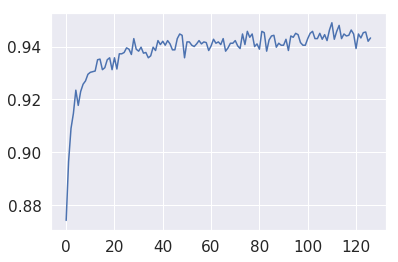

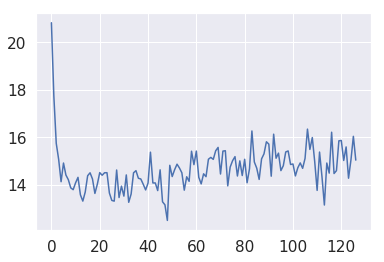

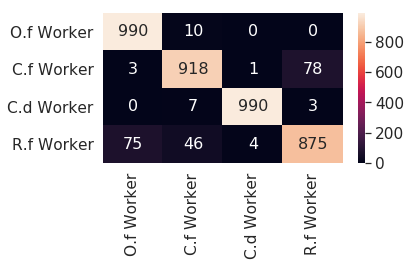

0 0
0 0
2 2
3 3
0 0
1 1
0 0
0 0
1 1
2 2
1 3
1 1
1 1
0 0
3 3
0 0
3 0
2 1
3 3
2 2
0 0
1 1
1 1
3 3
3 3
2 2
1 1
0 0
0 0
2 2
0 0
3 3
2 2
0 0
3 3
1 1
2 2
3 3
3 3
2 2
3 3
1 3
2 2
1 1
1 3
1 1
2 2
2 2
0 0
1 1
1 1
1 1
1 1
0 0
3 3
2 2
1 1
2 2
1 1
1 1
3 3
2 2
0 0
1 1
3 1
0 0
1 1
3 3
0 0
3 3
0 0
2 2
1 1
1 1
0 0
3 3
1 1
1 1
0 0
3 3
2 2
1 1
3 3
1 1
3 0
2 2
0 0
2 2
1 1
2 2
3 3
3 3
1 3
3 3
0 0
0 0
1 1
0 0
3 3
1 1
2 2
0 0
2 2
0 0
0 0
1 1
3 3
2 2
1 1
3 3
2 2
0 0
0 0
0 0
2 2
2 2
3 3
1 1
0 0
3 3
0 0
3 3
2 2
0 0
0 0
3 3
2 2
3 3
1 1
0 0
2 2
3 3
0 0
1 1
3 3
0 0
2 2
3 3
1 1
3 3
1 3
0 0
0 0
2 2
3 3
2 2
3 3
3 3
3 3
3 3
2 2
3 3
3 3
3 3
2 2
1 1
2 2
1 1
3 3
3 3
3 3
1 1
1 1
1 1
1 1
0 0
0 0
1 1
2 2
1 1
0 0
0 0
0 0
2 2
0 0
0 0
0 0
3 3
2 2
2 2
2 2
0 0
2 2
2 2
0 0
2 2
0 0
0 0
3 3
2 2
3 3
3 3
2 2
1 1
0 0
0 0
3 0
3 3
3 3
0 0
1 1
1 1
1 1
0 0
1 1
1 1
0 0
3 3
2 2
2 2
0 0
2 2
1 1
1 1
1 1
2 2
3 3
1 1
3 3
1 1
0 0
3 3
3 3
2 2
1 1
2 2
2 2
1 1
3 3
1 3
0 0
2 2
0 0
3 3
0 0
1 1
2 2
2 2
2 2
3 3
3 3
0 0
2 2
1 1
0 0
2 2
3 3
1 1
2 2
0 0


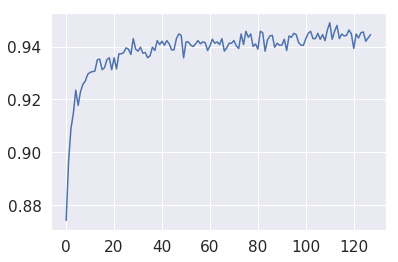

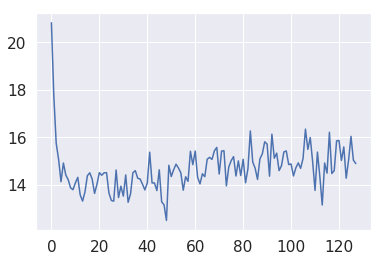

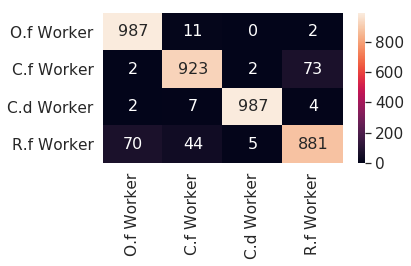

2 2
0 0
1 1
2 2
0 0
3 1
1 1
2 1
1 1
1 1
2 2
3 3
2 2
3 3
2 2
0 0
2 2
1 1
2 2
0 0
0 0
2 2
0 0
3 3
0 0
0 0
0 0
0 0
0 0
0 1
2 2
3 3
2 2
3 3
3 3
3 0
3 3
0 0
2 2
3 3
1 1
0 0
3 3
3 3
1 1
2 2
3 1
1 3
2 2
1 1
0 0
2 2
3 3
3 1
1 1
2 2
0 0
2 2
2 2
3 3
0 0
0 0
1 1
2 2
0 1
2 2
2 2
3 3
2 2
2 2
0 0
1 1
3 3
0 0
0 0
0 0
3 3
2 2
3 3
2 2
1 1
0 0
0 0
0 0
0 0
0 0
0 0
1 3
0 0
3 3
0 0
2 2
3 3
3 3
2 2
2 2
3 3
3 3
0 0
3 1
2 2
1 1
3 3
1 1
3 3
2 2
0 0
1 1
0 0
0 0
1 1
3 3
1 1
1 3
3 3
2 2
2 2
3 3
2 2
0 0
2 2
0 0
1 1
3 3
0 0
0 0
0 0
0 0
0 0
1 1
0 0
3 3
3 3
1 1
1 1
2 2
3 3
0 0
2 2
2 2
3 3
3 3
1 1
3 3
1 1
0 0
2 2
1 1
3 3
2 2
3 3
0 0
0 0
1 1
1 1
2 2
0 0
0 0
0 0
0 0
0 0
0 0
1 1
2 2
0 0
1 1
0 0
1 1
3 3
1 1
1 1
1 1
0 0
0 0
3 3
2 2
2 2
0 0
0 0
0 0
1 3
2 2
2 2
1 1
3 1
3 3
1 1
2 2
0 0
0 0
3 3
3 3
2 2
1 1
2 2
0 0
0 0
2 2
3 3
0 0
1 1
2 2
3 3
0 0
3 3
2 2
0 0
3 3
3 3
3 3
3 3
1 1
1 1
0 0
1 1
3 3
1 1
3 3
1 1
0 0
0 0
1 1
3 3
0 0
3 3
1 3
0 0
3 3
2 2
0 0
2 2
1 1
3 3
2 2
2 2
2 2
0 0
0 0
0 0
3 3
2 2
3 3
0 0
0 0
1 1
3 3
2 2
2 2
3 3
0 0


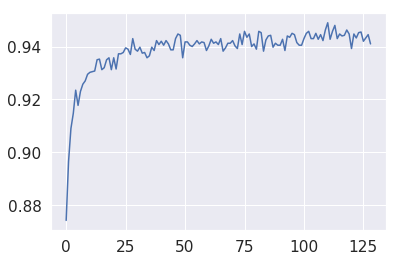

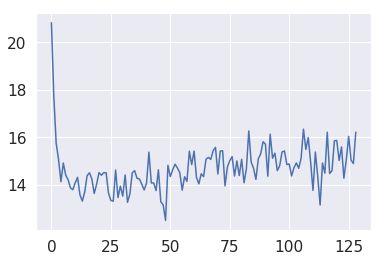

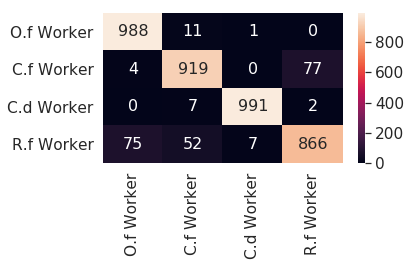

3 3
2 2
0 0
2 2
2 2
3 1
1 1
3 1
3 3
3 3
0 0
3 3
1 1
0 0
1 1
3 3
3 0
2 2
0 0
0 0
3 1
3 1
0 0
3 3
3 3
3 3
3 3
0 0
2 2
2 2
0 0
2 2
3 3
0 0
3 3
3 1
1 1
3 1
0 0
3 3
0 0
0 0
2 2
1 1
2 2
3 3
2 2
0 0
2 2
3 3
0 0
2 2
0 0
3 3
2 2
3 1
0 0
0 0
0 0
3 0
2 2
1 1
3 3
3 3
0 0
0 0
0 0
0 0
1 3
1 1
0 0
0 0
0 0
2 2
2 2
1 1
1 1
2 2
1 1
3 1
2 2
1 1
2 2
3 3
1 3
2 2
1 1
2 2
3 3
0 0
1 1
3 3
1 1
1 1
0 0
0 0
0 0
3 3
1 1
3 3
1 3
0 0
0 0
0 0
3 3
1 1
2 2
0 0
0 0
0 0
0 0
2 2
2 2
3 3
3 3
2 2
1 1
2 2
2 2
0 0
0 0
3 3
3 3
3 3
3 3
3 3
1 1
1 1
2 2
3 3
1 1
0 0
2 2
2 2
1 1
2 2
2 2
0 0
2 2
2 1
1 1
2 2
3 3
2 2
2 2
2 2
2 2
0 0
0 0
3 3
1 1
1 3
2 2
0 0
1 1
3 1
3 3
3 3
0 0
3 3
0 0
0 0
3 3
2 2
3 3
2 2
3 3
0 0
0 0
3 3
2 2
1 1
2 2
1 1
1 3
2 2
0 0
1 3
1 1
1 1
3 3
3 3
0 0
2 2
0 0
2 2
0 0
3 3
3 3
3 0
1 1
1 1
0 0
1 3
1 1
2 2
3 3
0 0
0 0
2 2
2 2
3 3
1 1
3 1
0 0
1 1
1 1
2 2
1 1
3 3
1 1
0 0
0 0
0 1
0 0
1 1
1 1
3 1
0 0
3 3
0 0
3 3
2 2
0 0
0 0
0 0
0 0
1 1
1 1
3 3
3 3
0 0
3 0
0 0
1 1
1 1
0 0
1 1
1 1
3 3
0 0
0 0
3 3
2 2
3 3
1 1
2 2
3 3
1 1
0 0


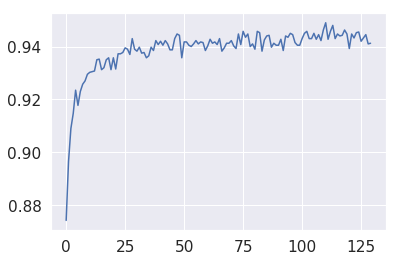

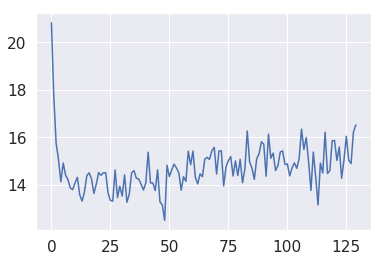

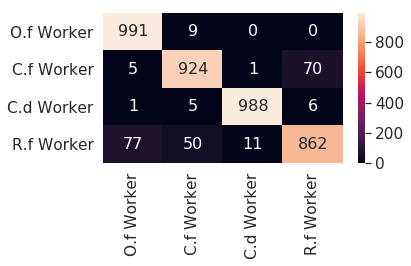

0 0
1 1
0 0
3 3
1 1
0 0
1 1
0 0
2 2
0 0
1 1
0 0
3 3
1 3
1 1
1 1
2 2
0 0
3 0
0 0
0 0
1 1
2 2
3 3
2 2
2 2
1 1
0 0
1 1
2 2
0 0
3 3
3 3
3 3
0 0
3 3
0 0
1 1
0 0
1 1
3 3
1 1
3 3
3 3
0 0
0 0
2 2
3 3
1 1
1 1
1 1
1 1
2 2
2 2
1 1
1 1
3 3
2 2
3 3
1 3
3 3
1 1
3 3
1 1
3 3
3 1
1 1
0 0
0 0
0 0
3 2
2 2
0 0
0 0
0 0
2 2
3 3
0 0
3 3
2 2
0 0
3 3
0 0
3 3
1 1
0 0
3 3
3 1
1 1
3 3
1 1
2 2
3 3
2 2
1 1
0 0
1 1
2 2
2 2
2 2
0 0
3 3
2 2
1 1
1 1
0 0
2 2
2 2
3 3
3 3
3 1
0 0
3 3
0 0
0 0
2 2
2 2
3 3
3 3
1 1
0 0
1 1
1 1
1 1
2 2
3 3
1 3
3 3
2 2
0 0
0 0
0 0
0 0
2 2
3 3
1 1
1 1
3 3
0 0
0 0
0 0
2 2
2 2
0 0
1 1
2 2
0 0
3 3
3 3
2 2
2 2
2 2
1 1
3 1
3 3
2 2
2 2
3 0
2 2
3 3
3 0
3 0
3 3
3 3
2 2
0 0
1 1
3 3
2 2
2 2
1 1
1 1
0 0
1 1
0 0
1 3
0 0
2 3
3 3
2 2
2 2
0 0
1 1
2 2
1 1
3 3
2 2
3 3
0 0
2 2
0 0
0 0
1 1
1 1
1 1
2 2
0 0
1 1
1 1
1 1
2 2
3 3
1 1
0 0
3 3
1 1
3 3
2 2
1 1
3 3
0 0
3 3
0 0
2 2
3 3
1 1
2 2
0 0
0 0
0 0
1 1
1 1
1 1
1 1
1 1
1 1
0 0
1 3
3 3
3 3
0 0
3 3
3 3
2 2
2 2
1 1
3 3
3 3
1 0
0 0
1 0
1 1
0 0
3 3
3 3
2 2
3 3
0 0
1 1
2 2


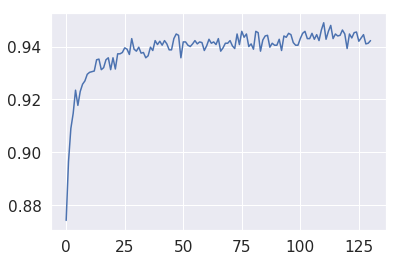

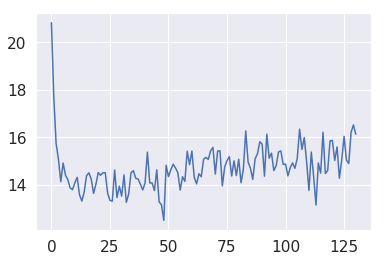

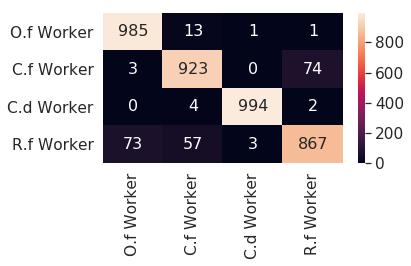

0 0
3 3
1 1
2 2
2 2
3 0
0 0
0 0
3 3
2 2
1 1
3 3
3 3
0 0
1 1
2 2
2 2
1 1
0 0
0 0
1 1
0 0
3 3
1 1
1 1
3 3
0 0
1 3
2 2
0 0
2 2
3 3
2 2
3 3
2 2
0 0
2 1
2 2
3 3
3 3
3 3
0 0
0 0
0 0
3 3
0 0
0 0
1 1
2 2
3 3
0 0
2 2
2 2
2 2
1 1
1 1
3 3
2 2
3 1
2 2
1 1
1 1
0 1
3 1
0 0
2 2
3 3
2 2
3 3
3 3
0 0
3 3
2 2
3 3
0 0
2 2
3 0
1 3
1 1
1 1
1 3
1 1
3 3
1 1
1 1
3 3
1 1
0 0
2 2
3 3
1 1
2 2
3 3
2 2
2 2
1 1
3 3
0 0
2 2
3 3
2 2
1 1
3 3
3 3
0 0
3 3
1 1
1 1
2 2
0 0
3 3
2 2
3 3
0 0
3 3
3 3
0 0
0 0
2 2
1 1
1 1
0 0
1 1
2 2
3 3
1 1
0 0
0 0
0 0
3 3
0 0
2 2
0 0
1 1
1 1
1 1
3 3
2 2
1 1
0 0
3 3
3 3
3 3
3 3
0 0
1 1
3 3
0 0
0 0
2 2
1 1
1 1
0 0
3 3
3 0
1 1
2 2
2 2
0 0
3 0
0 0
3 3
1 1
2 2
1 1
0 0
2 2
3 3
0 0
1 1
3 3
3 3
1 1
0 0
0 0
3 3
1 1
1 1
2 2
1 1
0 0
3 0
1 1
3 3
1 1
1 1
0 0
2 2
3 3
3 3
0 0
2 2
1 1
2 2
0 0
0 0
0 0
2 2
2 2
1 1
0 0
0 0
3 3
0 0
2 2
3 3
3 0
1 1
2 2
0 0
1 1
1 1
0 0
0 0
1 1
3 3
2 2
1 1
2 2
1 1
3 3
0 0
1 1
2 2
2 2
2 2
2 2
1 1
1 3
2 2
3 3
0 0
3 3
1 1
1 3
3 3
1 1
2 2
0 0
0 0
2 2
1 1
0 0
3 3
1 1
2 2
2 2
2 2
2 2
3 3


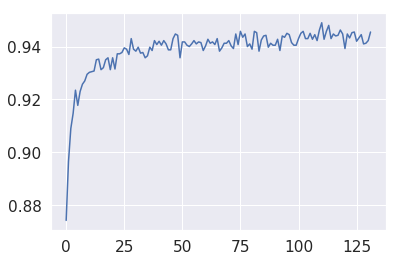

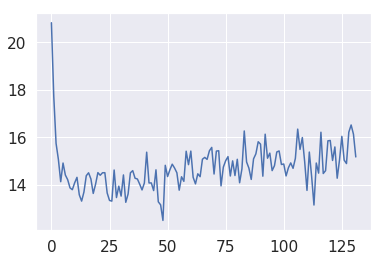

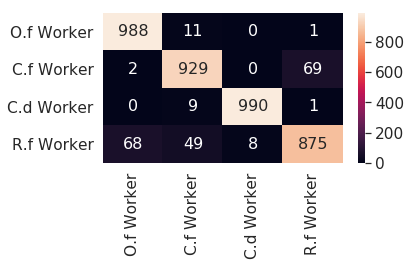

1 1
0 0
1 1
2 2
3 3
3 3
3 3
1 1
3 0
3 3
0 0
2 2
0 0
1 1
1 1
1 1
1 1
0 0
1 1
0 0
1 1
0 0
2 2
1 1
2 2
0 0
1 1
3 3
1 1
2 2
2 2
2 2
3 3
1 1
1 1
3 3
2 2
0 0
0 0
3 3
0 0
0 0
1 1
1 1
3 3
1 1
3 3
2 2
3 0
2 2
1 1
0 0
3 3
3 3
3 3
2 2
2 2
3 3
3 3
3 3
3 0
2 2
2 2
0 0
3 3
0 0
2 2
3 3
0 0
2 2
1 1
2 2
1 1
2 2
0 0
1 1
3 3
1 1
0 0
3 3
3 3
1 1
1 1
1 1
2 2
0 0
2 2
1 1
1 1
3 3
3 3
3 3
3 3
3 3
2 2
1 1
1 1
2 2
2 2
1 3
2 2
0 0
3 3
3 3
0 0
2 2
0 0
0 0
2 2
3 3
2 2
3 3
3 3
0 0
0 0
3 3
3 3
0 0
1 1
1 1
0 0
3 3
1 1
2 2
0 0
2 2
3 3
0 0
3 3
3 1
2 2
3 3
3 3
2 2
3 0
2 2
2 2
3 3
2 2
1 1
3 3
2 2
0 0
3 3
1 1
2 2
2 2
3 3
1 1
2 2
3 3
2 2
0 0
2 2
2 2
2 2
3 3
2 2
0 0
3 3
2 2
1 1
3 3
2 2
1 1
2 2
1 1
2 2
2 2
0 0
0 0
3 1
2 2
1 1
3 3
2 2
2 2
1 1
0 0
3 3
3 3
1 1
0 0
0 0
3 3
3 3
3 0
1 1
0 0
1 1
1 1
1 1
2 2
3 3
3 3
0 0
1 1
2 2
0 0
3 3
3 3
1 1
0 0
1 1
1 1
2 2
1 1
1 3
1 1
1 1
0 0
2 2
2 2
1 3
1 1
0 0
2 2
1 1
2 2
1 3
1 1
0 0
2 2
0 0
2 2
2 2
0 0
0 0
0 0
2 2
2 2
3 3
0 0
3 3
3 3
1 1
1 1
3 3
3 3
2 2
2 2
1 1
1 3
1 3
0 0
3 3
3 3
3 3
0 0
1 1


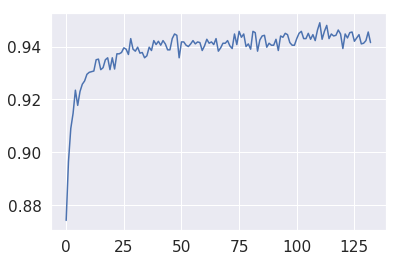

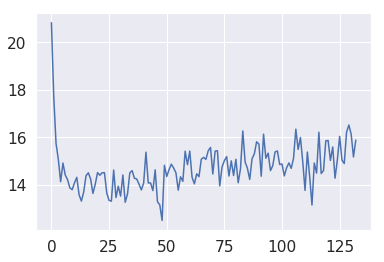

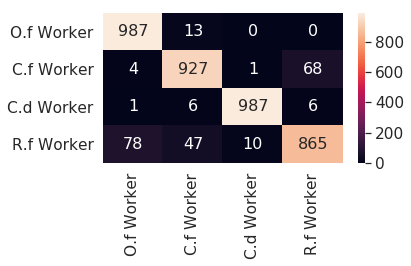

2 2
0 0
0 0
2 2
0 0
2 2
1 1
0 1
1 1
0 0
2 2
2 2
0 0
3 3
1 1
2 2
2 2
2 2
2 2
1 1
3 3
3 3
3 3
0 0
0 0
1 1
3 3
1 1
2 2
2 2
0 0
2 2
0 0
2 2
1 1
2 2
3 0
2 2
1 1
2 2
2 3
0 0
3 3
0 0
3 3
3 3
0 0
1 1
0 0
0 0
1 1
2 2
1 1
0 0
3 1
2 2
3 3
2 2
1 1
1 1
2 2
0 0
2 2
2 2
0 1
0 0
3 3
2 2
0 0
0 0
3 3
0 0
2 2
2 2
0 0
0 0
2 2
2 2
2 2
1 1
3 3
0 0
0 0
3 3
0 0
0 0
2 2
1 1
3 3
3 3
1 1
3 3
1 3
0 0
2 2
1 1
0 0
0 0
2 2
3 3
3 3
2 2
0 0
3 3
1 1
2 2
0 0
0 0
3 3
2 2
1 1
3 3
0 0
2 1
0 0
3 3
2 2
3 3
0 0
0 0
3 3
1 1
0 0
3 3
0 0
1 1
3 3
1 1
0 0
2 2
1 1
0 0
3 3
3 3
1 1
1 1
3 3
3 3
0 0
2 2
0 0
0 0
2 2
1 1
3 3
2 2
0 0
1 1
3 3
1 1
0 0
2 2
2 2
0 0
2 2
0 0
1 3
3 3
0 0
2 2
1 1
3 3
0 0
0 0
0 0
3 3
2 2
1 1
0 0
1 1
3 3
1 1
2 2
0 0
1 1
2 2
0 0
2 2
1 1
1 1
3 3
0 0
0 0
1 1
0 0
2 2
3 3
3 3
3 1
2 2
0 0
2 2
2 2
1 1
3 3
1 1
0 0
2 2
2 2
1 1
2 2
3 3
0 0
0 0
1 3
3 3
1 1
2 2
2 2
0 0
1 1
0 0
1 1
3 3
0 0
1 1
0 0
2 2
0 0
2 2
1 1
0 0
2 2
1 1
0 0
1 1
3 3
2 2
1 1
0 0
3 1
3 3
3 3
2 2
1 1
0 0
0 0
0 0
1 1
0 0
0 0
3 3
2 2
1 3
1 1
3 3
3 3
3 3
1 1
1 1


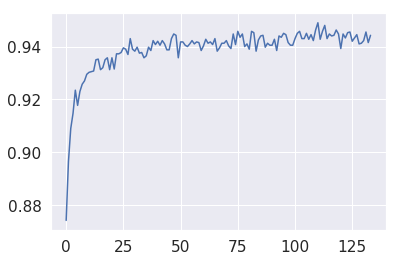

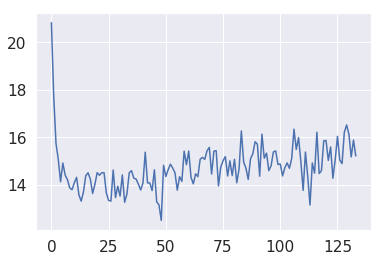

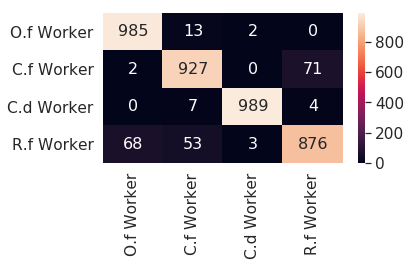

1 1
0 0
0 0
2 2
0 0
2 2
0 0
0 0
3 3
0 0
3 3
0 0
3 3
2 2
2 2
2 2
2 2
1 1
2 2
0 0
0 0
1 1
0 0
3 3
3 3
3 3
0 0
0 0
1 1
2 2
2 2
0 0
1 1
2 2
0 0
0 0
1 1
0 0
2 2
3 3
1 1
1 1
3 3
1 3
0 0
3 3
1 1
2 2
0 0
0 0
1 1
2 2
3 3
0 0
0 0
2 2
3 3
2 2
3 3
3 3
3 3
3 3
3 3
3 3
2 2
3 3
1 1
1 1
1 1
2 2
0 0
3 3
1 1
2 2
3 3
1 1
2 2
2 2
2 2
1 1
3 1
2 2
2 2
2 2
2 2
2 2
3 3
1 1
0 0
0 0
1 1
3 1
2 2
2 2
1 1
2 2
0 0
0 0
0 0
0 0
3 3
2 2
1 1
2 2
2 2
2 2
0 0
3 3
0 0
1 1
1 3
3 3
1 1
3 1
3 3
3 0
2 2
0 0
1 1
0 0
3 3
0 0
0 0
1 1
0 0
0 0
0 0
1 1
3 3
2 2
2 2
1 1
0 0
3 0
1 1
3 3
3 3
0 0
0 0
1 1
0 0
1 1
0 0
0 0
0 0
0 0
3 3
0 0
2 2
0 0
2 2
0 0
0 0
3 3
3 1
1 1
0 0
2 2
2 2
1 1
0 0
0 0
2 2
2 2
3 3
1 1
3 3
3 3
1 1
2 2
3 3
3 3
2 2
2 2
2 2
3 3
0 0
1 1
3 3
2 2
0 0
2 2
1 1
2 2
0 0
3 3
0 0
0 0
1 1
0 0
3 3
3 3
2 2
0 0
0 0
1 1
0 0
3 3
3 3
0 0
3 3
0 0
2 2
1 1
1 1
3 3
0 0
3 3
1 3
0 0
0 0
1 1
3 0
1 2
3 3
0 0
3 1
0 0
1 1
2 2
1 1
3 1
3 3
2 2
1 1
2 2
0 0
3 3
1 3
1 1
3 3
3 0
1 1
2 2
0 0
1 1
3 3
0 0
3 3
0 0
1 1
2 2
0 0
1 1
3 3
3 3
1 1
1 1
0 0
0 0


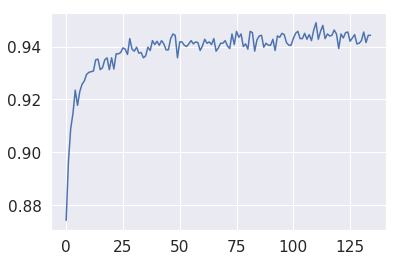

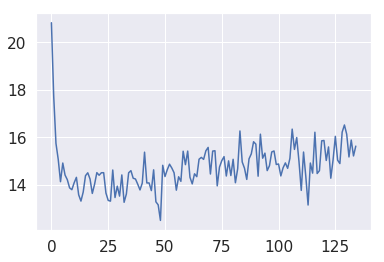

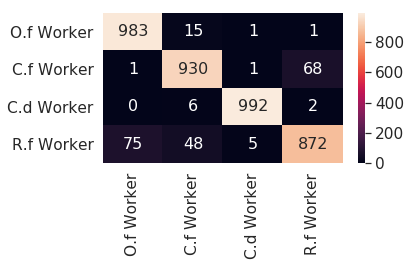

1 1
1 1
0 0
1 1
2 2
0 0
0 0
0 0
3 3
0 0
2 2
0 0
2 2
0 0
3 0
0 0
2 2
0 0
1 1
1 3
1 1
2 2
3 3
1 1
2 2
2 2
3 3
0 0
3 3
1 1
1 1
0 0
1 1
1 1
2 2
0 0
1 1
0 0
1 1
0 0
1 1
2 2
2 2
0 0
1 1
1 1
2 2
0 0
0 0
2 2
0 0
0 0
3 3
1 1
2 2
0 0
0 0
2 2
3 3
2 2
3 3
2 2
2 2
3 3
0 0
1 1
3 3
3 3
2 2
1 1
1 1
1 1
2 2
1 1
2 2
3 3
0 0
1 1
1 1
0 0
1 1
2 2
2 2
3 1
0 0
0 0
2 2
2 2
3 3
0 0
1 1
2 2
3 0
1 1
3 3
0 0
0 0
0 0
2 2
2 2
3 3
1 1
2 2
0 0
0 0
2 2
0 0
3 3
2 2
2 2
1 1
3 3
1 1
3 3
1 3
2 2
3 3
3 3
1 1
0 0
0 0
1 1
0 0
3 3
2 2
1 1
3 3
3 1
3 3
3 3
0 0
0 0
1 1
3 3
0 0
1 1
0 0
2 2
3 0
2 2
3 3
2 2
2 2
3 0
2 2
2 2
2 2
2 2
1 1
1 1
1 1
1 1
1 1
1 1
2 2
2 2
0 0
1 1
2 2
3 1
2 2
0 0
0 0
3 3
3 3
0 0
1 1
0 0
3 3
1 3
2 2
3 3
1 1
2 2
0 0
3 0
2 2
2 2
3 1
1 3
3 3
0 0
0 0
3 3
3 3
1 1
1 1
2 2
3 3
1 1
0 0
3 1
1 1
1 1
3 3
2 2
3 3
1 1
2 2
3 3
0 0
3 3
1 1
1 1
3 3
1 1
0 0
1 1
1 1
0 0
2 2
3 3
2 2
1 1
0 0
2 2
3 3
2 2
3 3
3 3
0 0
1 1
0 0
3 3
3 3
0 0
3 3
0 0
0 0
1 3
3 3
1 1
2 2
1 1
0 0
0 0
1 1
1 1
2 2
3 3
3 3
2 2
3 3
2 2
0 0
1 1
1 1
2 2
1 3
1 1


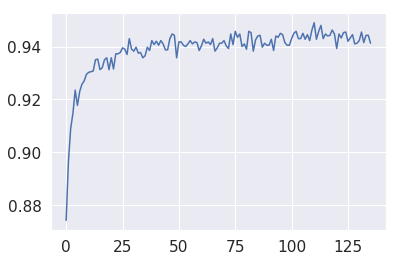

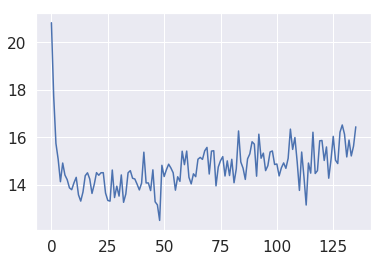

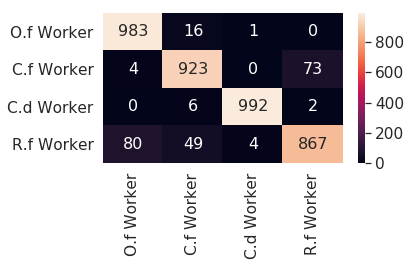

2 2
0 0
0 0
0 0
1 1
0 0
1 1
0 0
0 0
1 1
2 2
1 1
3 3
2 2
2 2
0 0
1 1
1 1
3 3
3 3
2 2
3 3
3 3
0 0
3 3
1 3
2 2
1 1
1 1
0 0
1 1
0 0
2 2
1 1
1 1
0 0
2 2
3 3
2 2
3 3
0 0
0 0
2 2
2 2
0 0
0 0
2 2
0 1
1 1
0 0
2 2
0 0
2 2
0 0
1 1
1 1
0 0
3 3
0 0
0 0
1 1
1 1
3 3
1 1
3 1
1 1
0 0
3 3
0 0
1 1
3 3
1 1
3 3
0 0
2 2
2 2
0 0
3 3
2 2
2 2
0 0
3 3
3 3
3 3
1 1
0 0
2 2
2 2
3 3
0 0
0 0
1 1
1 1
2 2
2 2
3 3
0 0
3 3
2 2
3 0
1 1
3 3
0 0
1 1
1 1
1 1
1 1
0 0
3 3
1 1
2 2
3 3
3 3
3 3
0 0
1 1
3 3
2 2
3 3
3 3
1 1
1 1
2 2
2 2
3 3
1 1
2 2
1 1
0 0
2 2
0 0
2 2
0 0
1 1
3 3
2 2
2 2
2 2
0 0
0 0
3 3
2 2
2 2
3 3
3 1
0 0
1 1
3 3
1 1
1 1
0 0
0 0
2 2
2 2
3 3
1 1
1 1
2 2
0 0
2 2
2 2
3 3
3 3
1 1
1 1
2 2
0 0
2 2
0 0
1 1
2 2
2 2
3 3
1 1
3 3
2 2
3 3
1 1
2 2
3 1
3 3
0 0
3 0
3 3
3 1
1 1
3 3
3 3
2 2
2 2
0 0
3 3
0 0
3 3
3 3
0 0
3 3
1 1
3 3
2 2
1 1
3 3
1 1
2 2
3 3
2 2
1 1
1 3
1 1
2 2
1 1
3 3
2 2
2 2
2 2
3 3
0 0
0 0
0 0
3 3
0 0
2 2
1 1
2 2
2 2
3 0
1 1
3 3
0 0
2 2
3 1
0 0
1 1
1 1
0 0
0 0
1 1
0 0
3 3
0 0
2 2
2 2
0 0
0 0
2 2
1 1
1 1
0 0
2 2
0 0


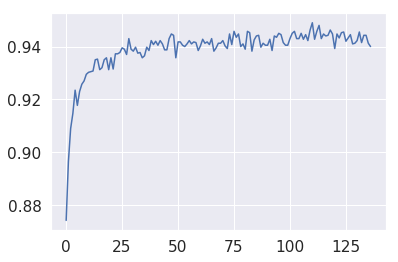

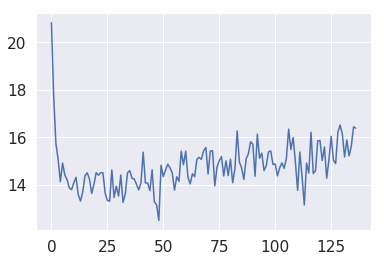

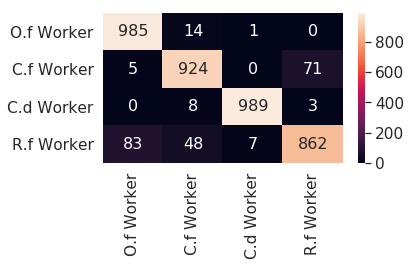

2 2
3 3
3 3
3 0
1 1
3 3
2 2
3 3
2 2
0 0
3 3
0 0
1 1
2 2
1 1
2 2
3 3
3 0
3 3
0 0
2 2
0 0
0 0
3 3
3 3
0 0
3 3
1 1
2 2
2 2
1 1
3 3
1 1
3 1
0 0
0 0
3 3
1 1
3 3
2 2
3 3
2 2
2 2
3 3
0 0
2 2
1 1
0 0
3 3
0 0
1 1
0 0
1 1
3 1
3 3
3 0
0 0
3 3
3 3
0 0
2 2
1 1
3 3
2 2
0 0
0 0
1 1
0 0
3 3
2 2
1 1
3 3
2 2
2 2
1 1
0 0
3 1
2 2
0 0
3 3
1 1
0 0
1 1
2 2
0 0
0 0
2 2
0 0
2 2
0 0
3 3
1 1
3 3
3 3
1 1
0 1
1 1
1 1
1 1
2 2
2 2
3 3
3 3
3 1
3 3
2 2
0 0
3 3
1 1
0 0
3 3
1 1
1 1
0 0
2 2
3 3
0 0
0 0
2 2
2 2
0 0
3 3
2 2
2 2
3 3
2 2
2 2
3 3
2 2
2 2
0 0
0 0
2 2
0 0
1 1
0 0
1 1
0 0
0 0
2 1
3 3
3 3
3 3
2 2
3 3
0 0
3 3
3 3
2 2
2 2
3 3
3 3
2 2
0 0
0 0
3 3
2 2
3 3
2 2
2 2
0 1
3 3
0 0
2 2
3 3
3 3
0 1
0 0
3 3
2 2
2 2
1 1
0 0
1 1
3 3
0 0
1 3
0 0
2 2
2 2
0 0
3 1
1 1
2 2
0 0
0 0
2 2
3 3
2 2
2 2
0 0
0 0
0 0
3 0
1 1
2 2
1 1
3 1
0 0
1 1
1 1
2 2
0 0
1 3
3 3
3 3
1 3
2 2
2 2
1 1
3 1
0 0
1 1
3 0
2 2
3 3
1 1
3 3
1 3
1 0
1 1
1 1
1 1
3 3
3 0
1 3
3 3
1 1
1 1
1 1
0 0
1 1
2 2
3 3
2 2
3 3
3 0
3 3
3 3
1 1
2 2
1 1
2 2
1 1
2 2
0 0
1 1
1 1
1 1
3 3


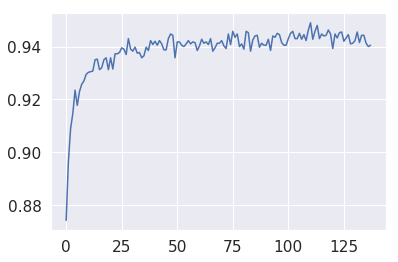

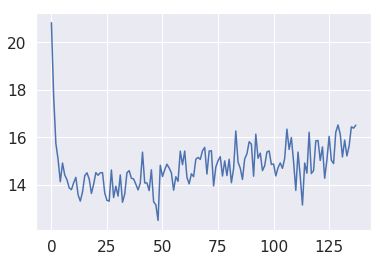

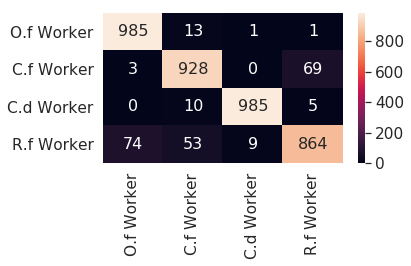

1 1
3 3
3 3
1 1
2 2
3 3
1 1
3 3
3 3
2 2
0 0
0 0
0 0
2 2
2 2
3 3
3 0
2 2
1 1
2 2
1 1
0 0
3 3
2 2
1 3
0 0
1 1
3 3
2 2
3 3
0 0
0 0
0 0
0 0
0 0
1 1
2 1
1 1
1 1
0 0
1 1
3 3
3 3
3 3
3 3
0 0
3 3
2 2
0 0
0 0
3 3
2 2
1 1
0 0
0 0
3 3
1 1
3 3
2 2
2 2
0 0
0 0
1 1
3 3
2 2
1 1
0 0
3 3
0 0
1 1
2 2
3 3
2 2
3 3
1 1
2 2
1 1
1 1
1 1
3 3
2 2
1 1
1 1
0 0
2 2
3 0
1 1
2 2
3 3
3 3
2 2
2 2
2 2
2 2
2 2
1 1
3 3
1 1
3 3
3 0
2 2
2 2
3 3
1 1
0 0
2 2
1 1
1 1
1 1
0 0
1 1
0 0
2 2
1 1
3 0
3 3
1 1
2 2
2 2
2 2
0 0
3 3
0 0
2 2
2 2
3 3
1 1
3 3
3 3
2 2
3 3
0 0
2 2
0 0
0 0
1 1
0 0
2 2
2 2
3 0
3 3
1 1
2 2
0 0
2 2
1 1
0 0
1 1
0 0
0 0
3 3
2 2
0 0
2 2
3 3
1 1
1 1
2 2
3 3
3 3
0 0
3 3
2 2
1 1
3 3
2 2
3 1
2 2
3 3
2 2
3 3
1 1
0 0
3 3
0 0
0 0
2 2
3 3
0 0
1 1
2 2
1 1
0 0
0 0
0 0
1 1
1 1
1 1
1 3
3 3
2 2
3 1
1 1
2 2
3 3
0 0
3 3
1 1
2 2
2 2
2 3
3 3
2 2
0 0
0 0
2 2
3 3
0 0
3 3
1 1
2 2
1 1
1 1
3 2
1 1
1 1
0 0
0 0
1 1
3 3
0 0
1 1
2 2
0 0
1 1
3 3
0 0
1 1
0 0
1 1
2 2
3 3
1 1
0 0
0 0
1 1
3 3
3 3
1 1
1 3
3 3
1 1
0 0
0 0
3 3
2 2
3 3
2 2
2 2
0 0


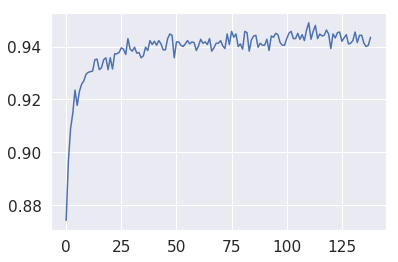

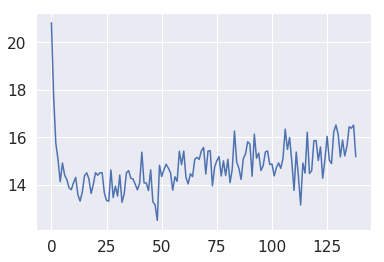

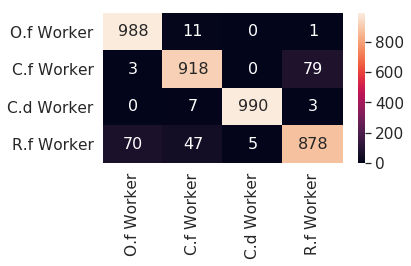

0 0
0 0
0 0
2 2
3 3
0 0
1 1
3 3
0 0
2 2
2 2
1 1
1 1
3 3
2 2
3 3
2 2
1 1
2 2
2 2
2 2
0 0
0 0
0 0
2 3
1 1
1 3
1 1
0 0
1 1
3 3
3 3
1 1
2 2
2 2
0 0
3 3
2 2
2 2
0 0
2 2
1 1
3 3
2 2
3 3
0 0
1 1
1 1
0 0
0 0
1 1
1 1
1 1
2 2
2 2
1 1
0 0
3 0
1 1
1 1
2 2
1 1
0 0
3 3
3 3
1 1
0 0
2 2
2 2
3 3
3 3
0 0
3 3
3 3
2 2
0 0
0 0
3 3
0 0
3 3
3 3
2 2
1 1
1 1
0 3
1 1
0 0
2 2
3 3
2 2
0 0
3 3
1 1
2 2
1 1
3 3
1 3
1 1
1 1
3 3
0 0
3 3
0 0
3 3
1 1
0 0
0 0
0 0
2 2
3 3
1 1
0 0
0 1
2 2
1 3
0 0
2 2
0 0
0 0
0 0
2 2
0 0
2 2
2 2
0 0
2 2
0 0
0 0
2 2
0 0
2 2
3 3
1 1
0 0
1 1
0 0
1 1
3 3
1 1
1 1
1 3
2 2
1 1
1 1
1 1
0 0
1 1
3 3
2 2
3 3
3 3
3 3
3 1
3 3
0 0
3 3
0 0
2 2
0 0
3 3
2 2
2 2
0 0
3 3
1 1
2 2
1 1
1 1
3 3
1 1
0 0
1 1
1 1
3 3
0 0
2 2
3 3
0 0
3 0
0 0
2 2
0 0
2 2
1 1
0 0
0 0
0 0
3 3
2 2
2 2
1 1
2 2
1 1
1 1
3 3
3 3
3 3
3 3
2 2
0 0
2 2
0 0
1 1
0 0
0 0
0 0
3 3
1 1
3 0
2 2
2 2
0 0
3 3
0 0
0 0
1 1
0 0
1 1
2 2
1 1
2 2
1 3
1 1
0 0
2 2
1 1
3 3
3 3
1 3
3 3
3 3
2 2
0 0
2 2
0 0
2 2
2 2
2 2
1 1
2 2
0 0
1 1
3 3
1 1
0 0
1 1
2 2
2 2
3 3
0 0


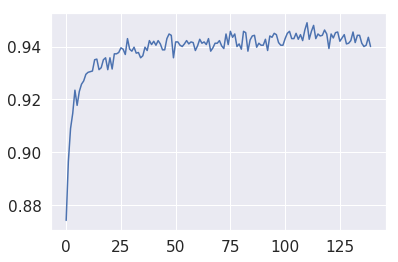

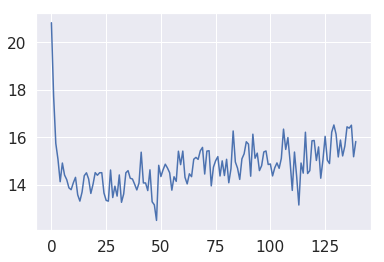

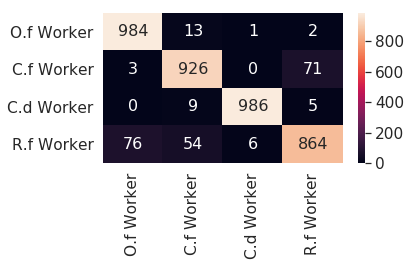

3 3
1 3
2 2
0 0
0 0
0 0
0 0
1 1
2 2
2 2
3 3
1 1
1 1
1 1
3 3
0 0
3 3
2 2
2 2
3 3
3 3
2 2
2 2
1 1
3 3
3 3
3 3
1 1
0 0
3 3
1 1
0 0
1 1
0 0
2 2
0 0
1 1
2 2
2 2
3 3
3 3
0 0
1 1
0 0
1 1
3 3
0 0
1 1
0 0
1 1
1 1
1 1
1 1
0 0
2 2
1 1
1 1
0 0
3 3
0 0
1 1
2 2
2 2
3 3
1 1
2 2
2 2
3 3
2 2
2 2
2 3
0 0
0 0
0 0
2 2
2 2
3 3
3 3
0 0
0 0
3 3
3 1
2 2
1 1
3 3
0 0
3 3
2 2
2 2
1 1
0 0
2 2
2 2
1 1
3 3
0 0
2 2
2 3
0 0
3 3
3 3
3 3
1 3
0 0
1 1
1 1
2 2
1 3
2 2
0 0
3 3
1 1
1 1
0 0
3 3
0 0
2 2
1 1
3 3
2 2
2 2
1 1
0 0
1 1
3 3
3 3
0 0
1 1
2 2
2 2
0 0
2 2
1 1
3 3
1 1
1 1
0 0
1 1
2 2
2 2
0 0
2 2
0 0
3 3
2 2
3 3
0 0
2 2
0 0
2 1
2 2
2 2
1 1
2 2
0 0
1 1
3 0
2 2
2 2
2 2
2 2
3 3
2 2
2 2
3 3
1 1
3 3
3 3
2 2
2 2
3 3
1 1
1 1
1 1
2 2
2 2
1 1
1 1
3 3
1 1
0 0
0 0
0 0
0 0
0 0
3 3
0 0
0 0
1 1
1 1
1 1
3 3
1 1
0 0
3 3
1 1
1 3
2 2
2 2
1 1
3 3
3 3
2 2
3 3
0 0
3 3
2 2
3 0
0 0
3 3
3 3
0 0
1 1
3 3
3 3
3 3
1 1
1 1
2 2
1 1
2 2
1 1
1 1
3 3
0 0
2 2
2 2
3 0
1 3
0 0
0 0
0 0
3 3
1 1
2 2
0 0
3 3
0 0
1 1
0 0
3 3
0 0
3 3
1 1
2 2
2 2
3 3
1 1
1 1
2 2


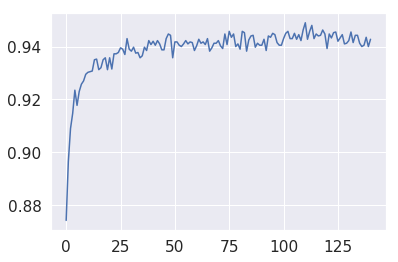

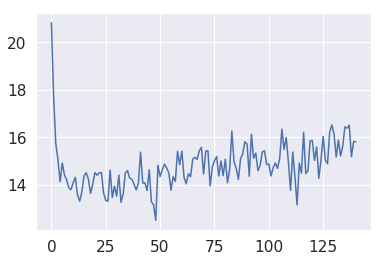

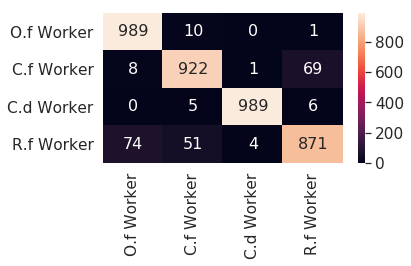

1 1
1 1
0 0
1 1
1 3
0 0
0 0
1 1
3 3
2 2
3 3
0 0
3 0
0 0
0 0
1 1
0 0
1 1
2 2
0 0
2 2
2 2
1 1
2 2
2 2
1 1
1 1
3 3
2 2
3 3
2 2
0 0
1 1
1 3
2 2
0 0
0 0
2 2
2 2
1 1
0 0
1 1
2 2
1 1
2 2
1 3
3 3
1 1
2 2
3 3
2 2
1 1
3 3
3 3
0 0
2 2
2 2
1 1
3 3
1 1
1 1
3 3
3 3
2 2
0 0
0 0
1 1
0 0
1 3
0 0
3 0
0 0
0 0
1 1
2 2
1 1
2 2
0 0
2 2
2 2
0 0
3 3
2 2
2 2
0 0
3 3
1 1
1 1
1 1
0 0
2 2
1 1
3 3
2 2
1 1
2 2
0 0
1 1
2 2
2 2
1 1
2 2
2 2
2 2
3 3
2 2
3 1
1 1
0 0
0 0
1 1
3 3
0 0
1 1
3 3
2 2
3 3
3 3
1 1
2 2
0 0
3 3
1 1
3 3
2 2
3 3
3 3
3 3
3 3
1 1
0 0
3 1
2 2
1 1
0 0
2 2
3 3
1 1
2 2
0 0
2 2
2 2
3 3
2 2
1 1
2 2
0 0
1 1
2 2
0 0
1 1
0 0
1 1
3 3
0 0
3 3
0 0
3 3
3 3
2 2
0 0
1 1
3 3
2 2
3 3
2 2
3 3
3 3
0 0
3 3
0 0
0 2
3 3
3 3
2 2
1 1
0 0
3 3
3 3
1 1
2 2
0 0
3 0
2 2
0 0
1 1
3 3
2 2
3 3
2 2
2 2
2 2
3 3
2 2
3 3
2 2
3 3
1 1
1 1
3 3
2 2
3 3
2 2
1 1
2 2
2 2
3 0
1 1
2 2
1 1
3 3
1 1
0 0
1 1
3 3
3 3
0 0
1 1
3 3
3 3
3 3
0 0
1 1
2 1
3 3
0 0
0 0
1 1
3 3
2 2
2 2
2 2
0 0
1 1
3 3
2 2
0 0
2 2
3 3
2 2
3 3
2 2
1 1
2 2
1 1
1 1
3 3
2 2
2 2
2 2


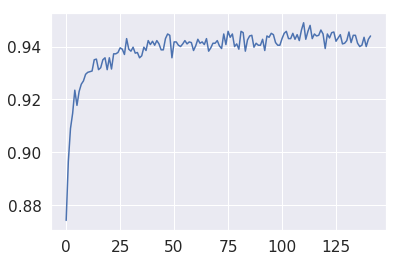

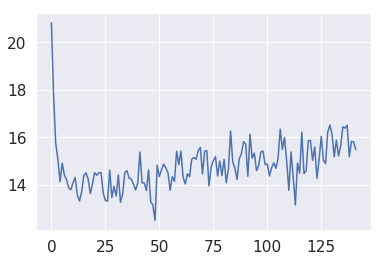

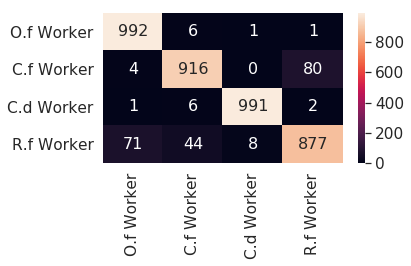

0 0
2 2
2 2
3 3
0 0
3 3
0 0
0 0
3 3
0 0
2 2
1 1
1 1
3 3
2 2
1 1
0 0
0 0
2 2
2 2
3 3
1 1
3 3
2 2
3 3
1 1
0 0
3 3
2 2
1 3
0 0
1 1
2 2
2 2
1 1
2 2
2 2
1 1
2 1
2 2
0 0
3 0
0 0
2 2
3 3
2 2
0 0
1 1
3 3
2 2
1 1
0 0
2 2
3 3
1 1
1 1
2 2
1 1
1 1
2 2
1 1
0 0
0 0
1 3
0 0
0 0
3 3
2 2
3 3
1 1
0 0
3 3
3 3
3 3
2 2
3 3
1 1
1 1
2 2
3 3
3 3
1 1
2 2
1 1
1 1
3 3
1 1
1 1
2 2
2 2
0 0
3 3
2 2
1 1
1 1
2 2
3 1
2 2
2 2
1 1
2 2
0 0
0 0
1 1
0 0
0 0
0 0
0 0
1 1
3 3
2 2
3 3
1 1
3 3
2 2
0 0
1 1
2 2
1 1
3 3
3 3
2 2
2 2
1 1
2 2
3 0
3 3
0 0
0 0
1 1
1 1
3 3
3 3
0 0
2 2
1 1
1 1
3 3
2 2
2 2
0 0
2 2
0 0
3 3
1 1
1 1
2 2
0 0
1 1
0 0
2 2
3 3
1 1
2 2
1 1
0 0
3 1
2 2
0 0
2 2
1 1
3 3
0 0
0 0
3 3
3 3
1 1
0 0
2 2
0 0
2 2
2 2
0 0
0 0
0 0
0 0
3 1
1 3
3 3
3 0
1 1
1 1
1 1
1 1
3 3
0 0
0 0
3 3
0 0
1 1
0 0
3 3
0 0
1 1
3 3
0 0
0 0
3 3
3 3
2 2
0 0
2 2
2 2
2 2
1 1
0 0
3 3
2 2
2 2
3 3
3 3
0 0
2 2
0 0
1 1
0 0
1 1
2 2
1 1
1 1
2 2
0 0
0 0
0 0
0 0
1 1
1 1
3 3
3 3
1 1
2 2
3 3
0 0
0 0
2 2
1 1
1 1
2 2
0 0
1 1
2 2
2 2
0 1
2 2
0 0
0 0
3 3
0 0
1 1
0 0


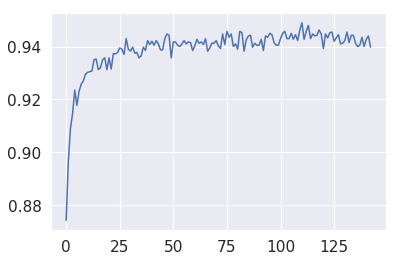

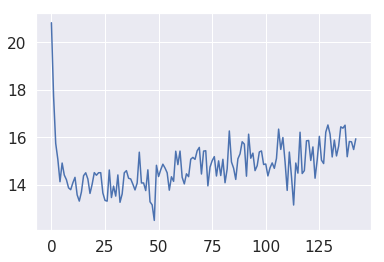

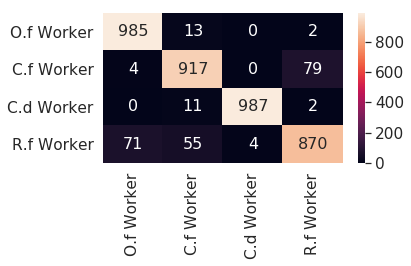

3 3
3 3
1 1
1 1
3 1
3 0
2 2
1 3
0 0
0 0
2 2
0 0
2 2
3 2
1 1
0 0
0 0
0 0
0 0
3 3
3 0
3 3
0 0
1 1
3 3
2 2
3 3
3 3
0 0
1 1
1 1
2 2
3 3
1 1
2 2
2 2
0 0
0 0
1 1
3 3
0 0
2 2
2 2
2 2
3 3
1 1
3 3
1 1
1 1
0 0
0 0
3 3
2 2
3 3
0 0
3 3
2 2
1 1
0 0
3 3
1 1
0 0
1 1
0 0
0 0
1 3
0 0
0 0
0 0
0 0
3 3
1 1
2 2
0 0
1 1
0 0
1 1
2 2
3 3
0 0
3 3
2 2
2 2
3 3
0 0
1 1
2 2
0 0
1 1
1 1
3 3
1 3
1 1
0 0
1 1
3 1
2 2
1 1
2 2
3 3
2 2
0 0
0 0
1 1
2 2
2 2
1 1
2 2
2 2
1 1
0 0
3 3
0 0
2 2
2 2
3 3
2 2
1 1
0 0
2 2
0 0
1 1
0 0
2 2
0 0
3 3
0 1
3 3
0 0
0 0
0 0
2 2
2 2
2 2
3 3
1 1
1 1
3 3
0 0
0 0
2 2
3 3
0 0
3 3
3 3
0 0
0 0
3 3
2 2
3 3
2 2
0 0
3 3
0 0
2 2
0 0
3 3
2 2
2 2
1 1
3 0
3 3
0 0
3 3
3 3
3 1
0 0
0 0
2 2
3 3
2 2
2 2
2 2
1 1
1 1
1 1
1 1
3 3
2 2
3 3
3 3
0 0
1 1
2 2
0 1
0 0
0 0
3 1
2 2
2 2
2 2
1 1
1 1
1 1
3 3
3 3
3 3
1 1
1 1
3 3
2 2
2 2
3 3
1 1
1 1
2 2
2 2
3 3
2 2
1 1
3 0
2 2
1 1
0 0
3 3
0 0
0 0
1 1
0 0
2 2
2 2
3 3
0 0
3 3
1 1
3 3
0 0
1 1
1 1
2 2
3 3
3 3
1 3
3 0
2 2
2 2
1 1
3 0
0 0
1 1
3 0
2 2
2 2
2 2
1 1
3 0
1 1
0 0
1 1
3 0


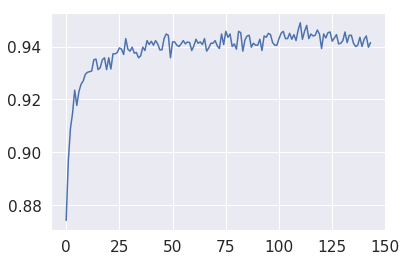

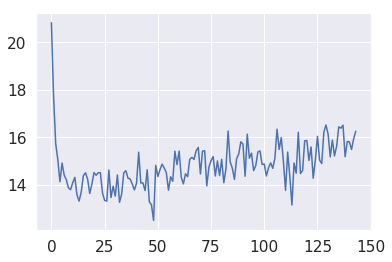

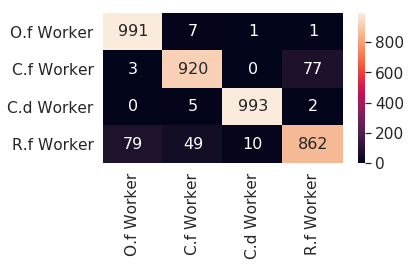

2 2
1 1
2 2
3 3
1 1
0 0
3 3
1 1
3 3
2 2
2 2
2 2
3 3
2 2
2 2
0 0
2 2
0 0
2 2
0 0
2 2
0 0
1 1
1 1
3 3
0 0
2 2
3 3
2 2
3 3
3 3
1 1
0 0
0 0
0 0
3 0
1 1
0 0
0 0
0 0
1 1
2 2
1 1
3 0
3 0
2 2
1 1
3 3
2 2
2 2
3 3
1 1
0 0
2 2
3 3
1 1
1 1
1 1
3 3
2 2
2 2
3 3
1 3
3 3
2 2
0 0
0 0
2 2
0 0
3 3
2 2
3 3
0 0
3 3
2 2
3 3
1 1
0 0
3 3
1 1
3 3
0 0
3 3
2 2
2 2
3 0
2 2
3 3
3 3
2 2
0 0
3 3
1 1
1 1
3 3
0 0
0 0
1 1
0 0
1 1
1 1
1 1
2 2
3 1
1 1
3 3
0 0
2 2
0 0
3 3
0 0
0 0
2 2
2 2
0 0
1 1
2 2
0 0
3 3
1 1
1 1
3 3
3 3
1 1
0 0
0 0
1 1
1 1
3 3
1 1
3 3
1 1
0 0
0 0
1 0
1 1
3 3
1 1
0 0
2 2
1 1
2 2
2 2
3 3
2 2
1 1
1 3
2 2
1 1
0 0
1 1
3 3
0 0
3 3
1 1
2 2
2 2
3 0
2 2
0 0
2 2
0 0
1 1
1 1
3 3
2 2
0 0
0 0
3 1
3 0
1 1
2 2
3 3
2 2
1 1
2 2
3 3
2 2
0 0
0 0
1 1
0 0
1 1
3 1
0 0
2 2
1 1
1 0
2 2
0 0
1 1
2 2
0 0
2 2
2 2
3 3
1 1
1 1
1 1
3 3
2 2
3 3
0 0
0 0
2 2
1 1
0 0
0 0
3 3
0 0
2 2
3 3
2 2
0 0
2 2
2 2
2 2
2 2
3 3
2 2
2 2
1 1
3 3
3 3
0 1
3 3
0 0
1 1
2 3
0 0
3 0
0 0
2 2
0 0
3 3
1 1
0 0
0 0
3 3
2 2
2 2
3 3
2 2
0 0
1 1
1 1
3 3
0 0
2 2
2 2


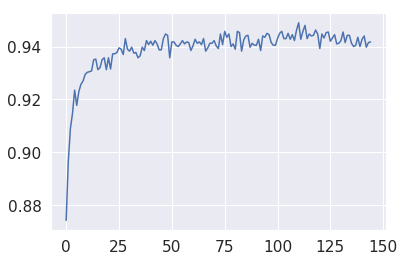

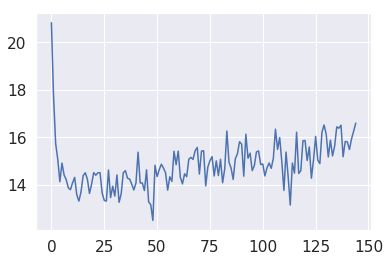

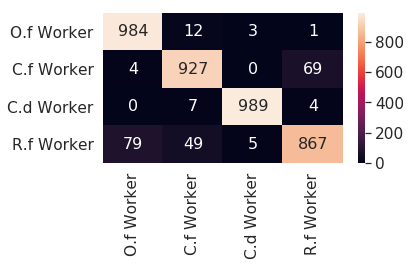

0 0
0 0
2 2
0 0
0 1
0 0
0 0
3 3
2 2
1 3
2 2
0 0
1 1
3 3
2 2
2 2
0 0
2 2
0 0
0 0
0 0
3 0
1 1
2 2
1 1
3 3
2 2
0 0
0 0
1 1
2 2
1 1
1 1
1 1
1 1
2 2
0 0
1 1
0 0
0 0
0 0
1 1
0 0
0 0
1 1
1 1
3 0
0 0
3 3
1 1
1 3
2 2
1 1
0 0
0 0
0 0
0 0
1 1
0 0
3 3
3 3
2 2
1 3
1 1
3 3
1 1
2 2
3 3
0 0
1 1
1 1
3 3
3 3
0 0
2 2
0 0
3 3
2 2
0 0
0 0
1 1
1 1
1 1
0 0
1 1
1 1
0 0
2 2
0 0
2 2
1 1
1 1
1 1
2 2
1 1
0 0
0 0
0 0
1 1
0 0
0 0
3 3
1 3
1 1
2 2
0 0
0 0
0 0
3 3
0 0
1 1
1 3
2 2
2 2
1 1
0 0
0 0
0 0
2 2
3 3
2 2
0 0
3 3
3 0
3 1
2 2
1 1
1 1
0 0
2 2
1 1
0 1
2 2
2 2
3 3
0 0
1 1
1 1
1 3
2 2
1 3
2 2
0 0
2 2
1 1
1 1
0 0
2 2
1 1
1 1
3 3
0 0
2 2
0 0
0 0
2 2
2 2
0 0
2 2
3 3
0 0
1 1
2 2
3 3
1 1
0 0
0 0
0 0
1 1
0 0
2 2
1 1
0 0
2 2
0 0
1 1
3 3
1 1
1 1
2 2
1 1
1 1
0 0
3 3
2 2
0 0
3 3
0 0
1 1
3 3
0 0
0 0
3 3
2 2
1 1
1 1
0 0
2 2
0 0
3 3
1 1
1 1
1 1
2 2
2 2
1 1
3 3
0 0
1 1
1 1
0 0
1 1
1 1
1 1
3 3
2 2
3 3
2 2
0 0
0 0
0 0
1 1
3 3
1 1
3 3
1 1
2 2
3 3
3 3
0 0
2 2
3 3
2 2
1 1
1 1
1 1
1 1
3 3
0 0
0 0
2 2
0 0
2 2
0 0
2 1
1 1
3 3
0 0
3 3
1 3


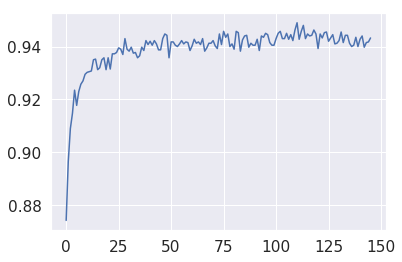

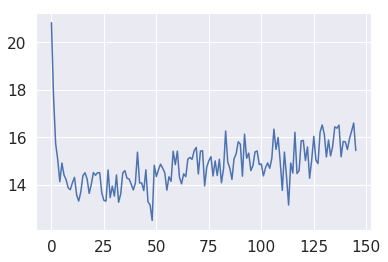

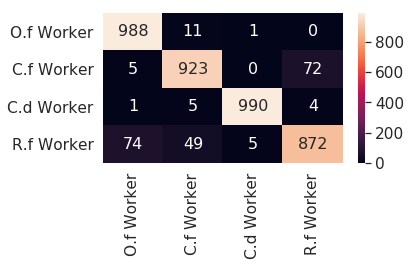

3 3
3 3
2 2
3 3
3 3
2 2
2 2
1 1
0 0
2 2
1 1
3 3
2 2
0 0
0 1
2 2
2 2
2 2
1 1
0 0
1 1
0 0
0 0
2 2
3 3
2 2
0 0
3 0
0 0
2 2
1 1
0 0
3 3
2 2
0 1
2 2
2 2
0 0
0 0
3 3
0 0
3 3
3 3
2 2
2 2
3 3
2 2
2 2
0 0
2 2
1 1
1 1
3 3
3 3
0 0
0 0
0 0
0 0
1 1
2 2
0 0
0 0
2 2
3 3
0 0
1 1
2 2
0 0
0 0
0 0
0 0
3 3
0 0
0 0
3 3
3 3
2 2
2 2
0 0
1 1
3 3
2 2
1 1
3 3
3 3
1 1
0 0
2 2
0 0
1 1
1 1
3 3
0 0
3 0
2 2
1 1
3 3
2 2
2 2
3 3
1 1
1 1
2 2
3 3
1 1
2 2
2 2
2 2
0 0
3 3
3 3
3 3
3 1
2 2
2 2
1 1
2 2
1 3
0 0
2 2
2 2
1 1
3 3
1 1
2 2
1 1
2 2
1 1
2 2
2 2
0 0
3 3
3 3
3 3
0 0
0 0
1 1
0 0
3 3
2 2
3 3
3 3
1 1
3 3
0 0
2 2
2 2
2 2
1 1
3 3
1 1
2 2
3 3
2 2
3 0
0 0
3 0
1 1
3 2
1 1
2 2
3 3
0 0
2 2
1 1
3 0
1 1
3 3
0 0
0 1
0 0
2 2
3 3
1 1
1 1
0 0
3 3
3 3
3 1
2 2
1 1
3 3
3 1
0 0
0 0
0 0
2 2
0 0
3 0
3 1
2 2
3 1
1 1
0 0
1 1
3 3
1 1
3 3
0 0
1 1
3 3
3 3
2 2
0 0
2 2
1 1
2 2
3 0
1 1
0 0
1 3
3 3
0 0
3 1
1 1
2 2
1 1
1 1
0 0
3 3
2 2
0 0
0 0
3 3
2 2
2 2
3 1
1 1
1 1
0 0
3 3
2 2
3 3
0 0
0 0
2 2
0 0
2 2
3 3
0 0
1 1
0 0
2 2
0 0
3 2
1 1
1 1
3 3
0 0
2 2


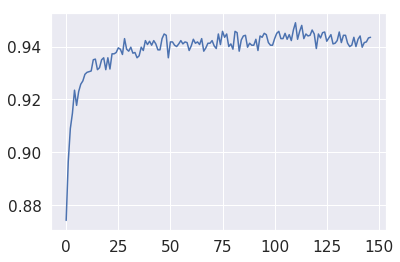

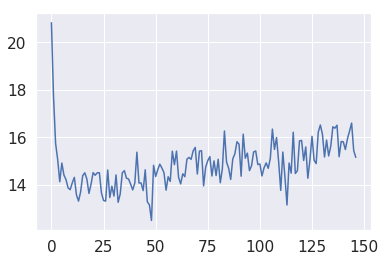

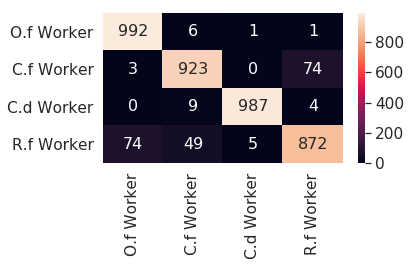

2 2
2 2
3 3
2 2
3 3
0 0
0 0
1 1
2 2
2 2
3 3
0 0
0 0
1 1
2 2
3 3
2 3
3 3
2 2
2 2
3 3
1 1
1 1
2 2
3 3
2 2
1 1
1 1
2 2
1 1
3 3
1 1
1 1
1 1
0 0
2 2
3 3
0 0
2 2
1 1
2 2
2 2
3 1
3 3
3 3
2 2
0 0
1 1
3 3
0 0
3 3
2 2
0 0
1 1
3 3
1 0
1 1
2 2
0 0
1 1
3 3
0 0
0 0
3 3
2 2
1 1
2 2
0 0
3 3
2 2
3 3
2 2
3 3
3 3
1 1
3 3
3 3
0 0
0 0
0 0
2 2
0 0
2 2
0 0
2 2
1 1
2 2
3 3
1 1
1 1
1 1
0 0
1 1
0 0
2 2
3 1
2 2
1 1
1 1
0 0
3 3
3 3
2 2
0 0
0 0
1 1
0 0
1 1
1 1
3 3
2 2
1 1
2 2
3 3
0 0
1 1
1 1
0 0
1 3
2 2
3 1
0 0
1 1
3 0
0 0
2 2
1 3
2 2
0 0
0 0
0 0
0 0
2 2
2 2
1 1
1 1
3 3
1 1
1 1
1 1
2 2
3 3
3 3
1 1
0 0
3 3
1 1
1 1
0 0
3 3
3 0
3 3
3 3
2 2
1 1
2 2
1 1
1 1
3 3
3 3
0 0
3 3
2 2
3 3
0 0
2 2
0 0
1 3
2 2
3 3
1 1
2 2
0 0
2 2
0 0
0 0
0 0
0 0
2 2
3 3
1 1
1 1
3 3
0 0
0 0
2 2
1 1
1 1
1 1
0 0
0 0
1 1
2 2
0 0
1 1
1 1
3 3
1 1
0 0
3 3
1 1
2 2
3 3
0 0
3 3
0 0
2 2
3 3
2 2
3 3
0 0
3 3
0 0
0 0
1 1
3 3
0 0
2 2
1 1
3 3
0 0
0 0
1 1
3 3
0 1
0 0
3 3
2 2
1 1
2 2
1 1
1 1
1 1
0 0
1 1
1 1
0 0
1 1
0 0
1 1
1 1
1 1
2 2
1 1
0 0
1 3
0 0
1 1
2 2
1 1


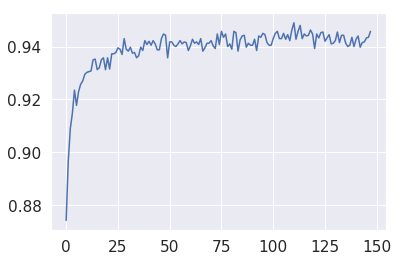

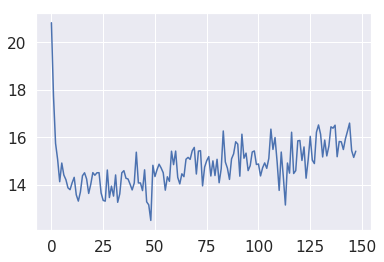

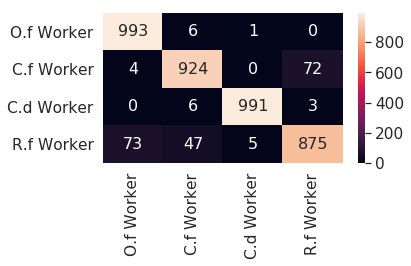

3 3
0 0
1 3
2 2
3 3
1 1
1 1
0 0
3 3
3 3
3 3
0 0
3 3
3 3
1 1
2 2
3 3
2 2
2 2
1 1
1 1
0 0
3 3
1 1
0 0
1 1
3 0
2 2
2 2
3 3
0 0
3 0
2 2
1 1
3 3
2 2
1 1
0 0
2 2
2 2
3 3
1 1
1 3
0 0
2 2
1 1
2 2
2 2
1 3
2 2
1 1
1 1
1 1
1 1
2 2
2 2
1 1
1 1
2 2
2 2
1 0
3 3
3 0
2 2
3 3
3 3
3 3
3 3
0 0
0 0
3 3
3 3
1 1
2 2
1 1
3 3
2 2
0 0
2 2
1 1
2 2
1 3
0 0
3 3
3 3
3 3
0 0
3 3
0 0
1 1
1 1
2 2
1 1
1 1
3 3
0 0
2 2
0 0
1 3
2 2
1 1
3 3
2 2
2 2
2 2
0 0
2 2
2 2
1 1
1 1
0 0
0 0
0 0
1 1
0 0
0 0
2 2
2 2
2 2
0 0
3 1
1 1
2 2
2 2
2 2
0 0
1 1
2 2
2 2
1 1
1 1
1 1
0 0
0 0
1 1
1 1
3 3
1 1
1 1
2 2
3 3
2 2
1 1
2 2
0 0
0 0
0 0
3 3
1 1
2 2
0 0
1 3
1 1
3 1
2 2
3 3
1 1
1 1
1 1
0 0
1 1
1 1
0 0
1 1
3 3
0 0
3 3
1 3
2 2
1 1
0 0
3 3
3 3
2 2
3 1
3 3
3 3
2 2
1 1
2 2
1 1
2 2
2 2
2 2
2 2
0 0
2 2
0 0
2 2
3 3
2 2
0 0
3 3
2 2
3 1
0 0
1 1
3 3
3 3
3 3
0 0
2 2
2 2
1 1
0 0
0 1
0 1
2 2
1 1
2 2
0 0
3 3
3 3
2 2
2 2
0 0
0 0
0 0
2 2
3 3
1 1
3 3
1 1
3 3
2 2
3 3
1 1
0 0
3 3
0 0
0 0
2 2
0 0
2 2
0 0
1 1
3 3
0 0
0 0
2 2
2 2
3 3
0 0
2 2
1 1
0 0
1 1
0 0
3 3
2 2


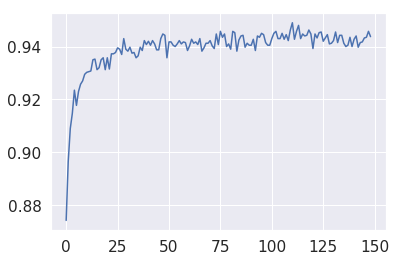

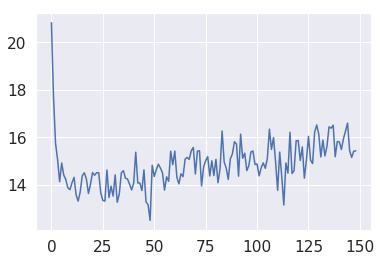

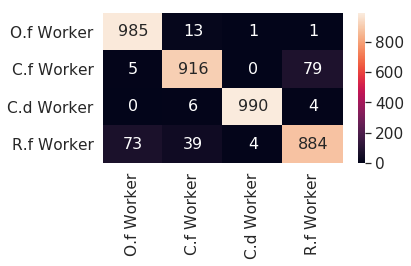

1 1
3 3
1 0
1 1
2 2
2 2
1 1
3 3
1 1
2 2
0 0
1 0
0 0
0 0
3 3
2 2
1 1
1 1
2 2
3 3
0 0
2 2
2 2
1 1
1 1
1 1
2 2
1 1
1 1
1 3
1 1
3 3
2 2
3 3
2 2
0 0
1 3
3 3
1 1
3 0
2 2
3 3
3 3
1 1
2 2
2 2
2 2
3 3
2 2
2 2
3 3
1 1
1 1
0 0
1 1
0 0
2 2
2 2
0 0
3 1
2 2
0 0
1 1
0 0
0 0
3 3
3 3
1 1
3 3
1 1
1 1
0 0
3 3
3 3
2 2
3 3
1 1
2 2
1 1
3 3
2 2
0 0
0 0
1 1
1 1
3 3
0 0
0 0
0 0
2 2
2 2
3 3
0 0
0 0
0 0
0 0
1 1
0 0
0 0
2 2
0 0
0 1
0 0
1 1
2 2
3 3
1 1
0 0
3 3
2 2
3 3
2 2
3 3
2 2
3 3
3 3
2 2
1 1
1 1
2 2
1 1
0 0
2 2
3 3
2 2
2 2
2 2
3 3
2 2
3 3
2 2
2 2
1 1
1 1
3 3
1 1
3 3
3 3
0 0
0 0
3 3
1 1
0 0
1 1
3 3
1 1
3 3
3 3
3 0
0 0
0 0
1 1
2 2
2 2
3 3
0 0
1 1
3 3
1 1
0 0
2 2
0 0
0 0
3 3
0 0
3 3
1 3
0 0
3 3
2 2
2 2
2 2
2 2
2 2
1 1
2 2
3 1
3 3
2 2
2 2
3 3
1 1
0 0
1 1
2 2
1 1
1 1
2 2
0 0
1 1
1 1
2 2
2 2
2 2
2 2
0 0
0 0
0 0
1 1
3 3
1 1
1 1
2 2
1 1
0 0
3 3
2 2
2 2
2 2
3 3
3 3
1 1
0 0
3 3
3 3
3 3
2 2
0 0
1 1
3 3
0 0
3 3
3 1
1 1
1 1
2 2
1 1
3 3
2 2
3 3
1 1
2 2
2 2
1 1
3 3
2 2
0 0
3 0
3 3
3 3
0 0
3 3
0 0
1 1
2 2
0 0
3 3
0 0
1 1
1 1


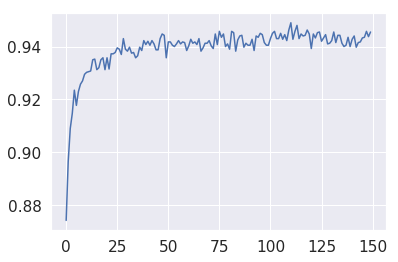

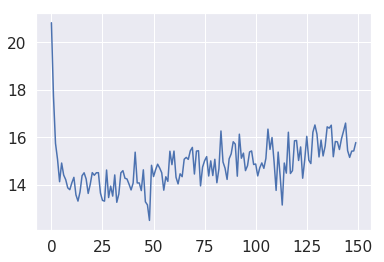

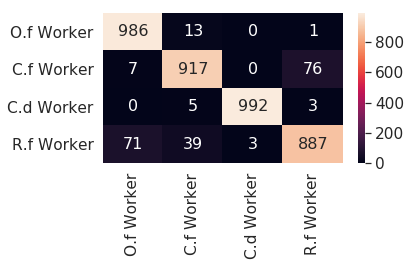

2 2
1 1
1 1
2 2
1 1
3 3
1 1
2 2
3 3
0 0
1 1
2 2
0 0
1 3
2 2
1 1
0 0
3 0
3 3
3 3
3 3
1 1
3 3
1 1
2 2
1 1
3 3
0 0
3 0
2 2
2 1
2 2
1 1
2 2
2 2
2 2
0 0
3 3
1 1
1 1
3 3
2 2
1 1
3 3
0 0
0 0
0 0
0 0
3 3
3 3
2 2
1 3
3 3
1 1
0 0
0 0
2 2
2 2
1 1
3 3
1 1
2 2
1 1
0 0
2 2
3 3
2 2
2 2
3 1
3 3
3 1
2 2
1 1
3 3
2 2
0 0
1 1
1 1
1 1
1 1
1 1
2 2
3 1
1 1
3 3
1 1
3 3
1 1
1 1
1 1
0 0
3 3
0 0
3 3
3 3
0 0
1 1
0 0
2 2
2 2
1 1
3 3
0 0
2 2
1 1
0 0
1 1
2 2
3 3
2 2
0 0
3 3
1 1
3 3
2 2
0 0
3 3
3 3
1 1
1 1
1 1
1 1
2 2
2 2
1 1
1 1
1 1
3 3
2 2
0 0
3 3
0 0
3 3
0 0
2 2
1 3
3 3
1 1
0 0
2 2
2 2
1 1
1 1
3 0
0 0
1 1
2 2
2 2
2 2
3 3
3 3
2 2
1 1
0 0
3 3
0 0
3 1
1 1
0 0
0 0
1 1
2 2
3 3
0 0
2 2
0 0
3 3
0 0
3 3
0 0
2 2
3 3
3 3
1 1
1 1
1 1
1 1
0 0
2 2
0 0
3 3
3 3
0 0
1 1
1 1
3 3
2 2
3 3
0 0
1 1
3 0
2 2
2 2
3 3
1 1
3 3
1 1
0 0
1 1
3 3
3 3
2 2
3 3
1 1
0 0
3 3
0 0
0 0
0 0
0 0
2 2
2 2
3 3
1 1
0 0
1 1
2 2
3 3
3 3
0 0
1 1
2 2
1 1
0 0
3 3
3 3
0 0
0 0
3 3
2 2
2 2
1 1
2 2
0 0
2 2
1 1
0 0
2 2
0 0
0 0
0 0
1 1
1 1
2 2
2 2
0 0
1 1
3 3
0 0
2 2


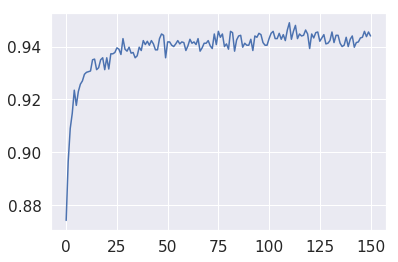

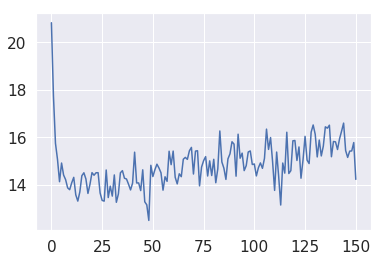

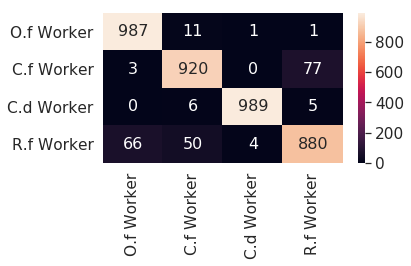

1 1
1 1
1 1
0 0
1 1
0 0
1 1
0 0
0 0
2 2
0 0
3 3
0 0
1 1
1 1
0 0
0 0
1 1
1 1
1 1
2 2
1 1
1 1
3 3
2 2
2 2
1 1
3 3
0 0
1 1
2 2
1 1
3 3
2 2
1 1
2 2
3 3
0 0
2 2
1 1
2 2
1 1
1 1
0 0
2 2
1 1
1 3
2 2
1 3
3 3
0 0
3 3
3 3
3 3
3 3
1 1
2 1
1 1
3 0
2 2
3 3
2 2
2 2
1 3
1 1
2 2
1 3
0 0
3 3
2 2
3 1
0 0
0 0
0 0
0 0
1 1
2 2
1 1
1 1
2 2
1 1
2 2
1 1
1 1
0 0
1 3
2 2
3 3
0 0
0 0
3 3
2 2
1 1
1 1
2 2
0 0
0 0
2 2
3 3
0 0
1 1
2 2
3 3
2 2
3 0
3 3
3 3
2 2
3 3
1 1
0 0
0 0
1 1
2 2
2 2
3 3
3 3
3 3
2 2
0 0
2 2
3 0
2 2
2 2
1 1
3 3
0 0
0 0
2 2
1 1
3 3
0 0
1 1
0 0
3 3
3 3
1 1
3 3
2 2
1 1
1 1
2 2
2 2
0 0
3 3
3 0
3 3
0 0
3 3
2 2
0 0
1 1
3 3
0 0
3 3
2 2
0 0
3 0
2 2
1 1
2 2
2 2
0 0
1 1
1 1
2 2
1 1
3 3
3 3
2 2
2 2
0 0
1 1
1 1
3 3
0 0
2 2
0 0
1 1
3 0
0 0
2 2
0 0
2 2
0 0
0 0
2 2
2 2
3 3
1 1
3 3
1 3
1 1
1 1
2 2
3 1
0 0
2 2
2 2
3 3
1 1
3 3
0 0
1 1
2 2
2 2
3 3
3 3
2 2
2 2
0 0
0 0
0 0
0 1
0 0
0 0
0 0
3 0
0 0
0 0
2 2
1 1
1 1
0 0
0 0
0 0
2 2
0 0
1 1
3 3
0 0
3 3
1 1
0 0
3 1
2 2
0 0
3 3
3 1
2 2
3 3
3 3
2 2
3 3
2 2
2 2
1 1
3 3
0 0
3 3


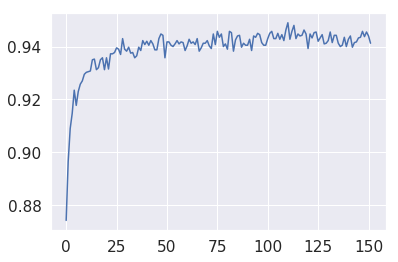

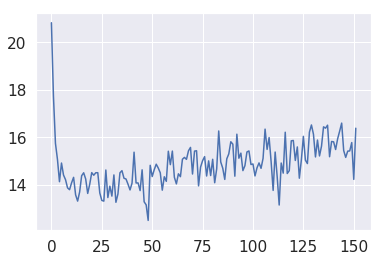

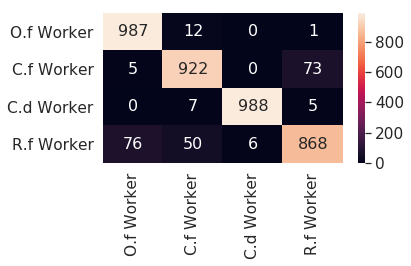

1 1
1 1
1 1
2 2
1 1
2 2
2 2
3 1
0 0
2 2
2 2
0 0
2 2
3 3
0 0
0 0
2 2
3 3
1 3
3 1
0 0
2 2
1 3
1 1
1 1
1 1
0 0
2 2
3 3
2 2
3 3
2 2
1 1
0 0
0 0
1 3
0 0
3 3
3 3
1 1
3 1
0 0
3 3
0 0
0 0
3 3
1 1
2 2
3 3
1 1
3 3
1 1
1 1
1 1
2 2
0 0
2 2
0 0
3 0
3 3
2 2
2 2
0 0
3 3
2 2
1 1
0 0
3 3
1 1
0 0
1 1
0 0
3 3
3 3
1 3
0 0
0 0
0 0
3 3
0 0
1 1
1 1
1 1
0 0
0 0
2 2
2 2
2 2
1 1
1 1
2 2
1 1
3 1
1 1
3 1
0 0
2 2
0 0
0 0
1 3
2 2
0 0
2 2
3 3
3 3
3 3
1 1
1 1
1 1
3 3
2 2
2 2
2 2
3 3
3 3
0 0
2 2
3 3
3 3
2 2
2 2
2 2
3 3
0 0
2 2
2 2
3 3
0 0
3 3
3 3
1 1
1 1
1 1
2 2
1 1
0 0
2 2
0 0
3 0
2 2
3 3
0 0
0 0
2 2
0 0
3 3
3 3
3 3
3 3
0 0
2 2
1 1
3 3
1 1
2 2
1 1
1 1
3 3
3 3
3 0
1 1
1 1
3 3
0 0
2 2
2 2
1 1
0 0
3 3
1 1
3 3
3 1
1 1
0 0
1 1
1 1
1 1
2 2
3 3
2 2
2 2
3 0
2 2
1 1
2 2
3 3
1 1
0 0
0 0
0 0
0 0
3 3
1 1
1 1
0 0
1 1
1 1
2 2
3 3
3 0
3 3
0 0
0 0
2 2
2 2
0 0
3 3
0 0
3 0
0 0
1 1
3 3
0 0
2 2
2 2
0 0
0 0
3 3
0 0
2 2
3 3
3 3
0 0
1 3
1 1
1 1
3 3
1 1
3 3
0 0
2 2
3 3
0 0
3 3
1 1
2 2
3 2
3 3
0 0
1 1
3 3
1 1
0 0
1 1
1 1
2 2
0 0
1 1
2 2
1 3


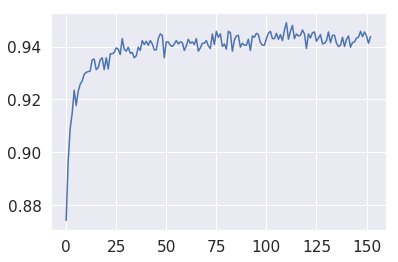

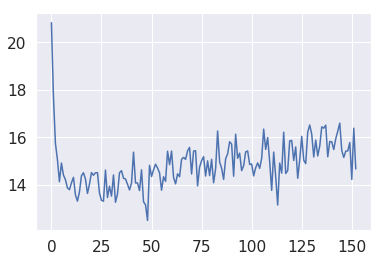

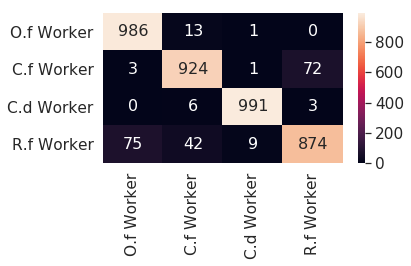

2 2
1 1
0 0
1 1
1 1
2 2
2 2
1 1
1 1
0 0
1 1
3 3
2 2
0 0
0 0
3 3
2 2
3 3
1 1
2 2
3 3
2 2
0 0
3 3
0 0
3 3
0 0
1 1
0 0
1 1
1 3
2 2
1 1
0 0
0 0
2 2
2 2
3 3
3 3
0 0
1 1
3 3
0 0
3 3
3 3
1 1
0 0
2 2
3 3
2 2
3 3
0 0
0 0
3 3
0 0
0 0
1 1
1 1
1 3
1 1
1 1
2 2
1 1
3 3
0 1
1 0
1 1
1 1
2 2
2 2
2 2
1 1
2 2
3 3
0 0
3 3
3 3
3 3
3 3
0 0
3 3
2 2
3 3
0 0
0 0
0 0
2 2
2 2
2 2
1 1
2 2
0 0
0 1
2 2
0 0
2 2
2 2
1 1
0 0
2 2
2 1
3 3
2 2
2 2
1 1
3 3
0 0
3 3
1 1
3 3
2 2
3 3
2 2
2 2
0 0
0 0
2 2
0 0
2 2
1 1
0 0
0 0
0 0
0 0
1 1
3 3
2 2
3 3
3 3
0 1
3 3
3 3
1 1
1 1
1 1
0 0
2 2
2 2
2 2
0 0
0 0
0 0
1 1
1 1
0 0
3 3
0 0
0 0
3 3
3 3
2 2
0 0
2 2
2 2
3 1
1 1
3 3
2 2
0 0
1 1
3 3
3 3
1 1
1 3
3 3
2 2
0 0
0 0
0 0
2 2
0 0
1 1
2 2
1 1
0 0
3 3
0 0
1 1
1 1
1 1
3 3
2 2
3 3
1 1
0 0
0 0
0 0
1 1
2 2
2 2
3 3
0 0
2 2
3 3
1 1
3 3
2 2
1 1
2 2
3 3
0 0
1 1
3 3
0 0
3 3
0 0
1 3
3 3
3 1
0 0
1 3
2 2
0 0
0 0
3 3
0 0
2 2
2 2
0 0
0 0
2 2
0 0
3 3
0 0
0 0
0 0
0 0
2 2
2 2
1 1
2 2
2 2
0 0
0 0
3 3
1 1
1 1
0 0
0 0
0 0
1 1
3 3
3 1
1 1
1 1
1 1
3 3
3 3
1 1
2 2


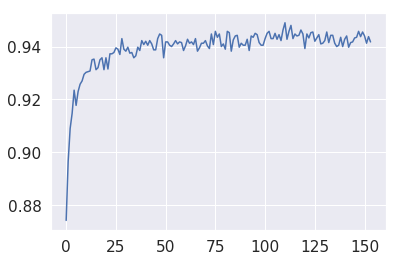

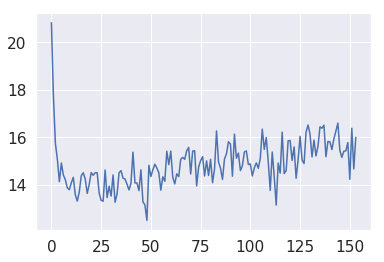

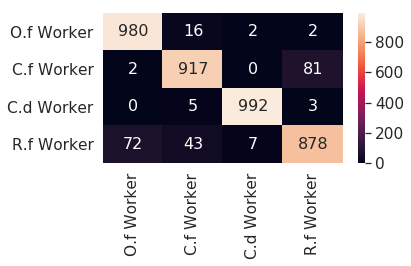

2 2
1 1
0 0
2 2
1 1
0 0
2 2
1 1
3 3
2 2
0 0
1 1
3 3
1 1
3 3
3 3
2 2
0 0
1 1
1 1
3 3
3 3
2 2
0 0
3 3
3 3
2 2
3 3
1 1
2 2
2 2
1 1
3 3
0 0
3 1
2 2
1 1
2 2
0 0
0 0
1 1
0 0
3 3
0 0
0 0
2 2
2 2
0 3
0 0
0 0
1 1
0 0
0 0
1 1
3 3
1 1
0 0
0 0
0 0
3 3
2 2
3 3
0 0
3 3
1 1
2 2
1 1
0 0
3 3
0 0
2 2
2 2
2 2
2 2
2 2
1 1
2 2
0 0
3 3
0 0
2 2
0 0
3 3
2 2
0 0
2 2
0 0
2 2
1 1
1 3
1 1
3 3
0 0
0 0
3 3
0 0
2 2
3 1
3 3
1 1
2 2
2 2
2 2
3 3
3 3
3 3
1 1
3 3
0 0
1 1
1 1
2 2
3 3
3 3
2 2
2 2
0 0
2 2
1 1
1 1
1 1
2 2
1 1
3 3
2 2
0 0
2 2
3 3
0 0
1 1
1 1
0 0
0 0
2 2
1 1
3 3
1 1
2 2
1 1
0 0
3 3
1 1
3 3
2 2
0 0
1 3
2 2
2 2
3 3
0 0
1 1
2 2
1 1
0 0
1 1
3 3
1 1
1 1
0 0
2 2
2 2
2 2
2 2
0 0
2 2
3 3
2 2
2 2
1 1
3 3
1 1
3 3
0 0
0 0
3 3
3 3
2 2
1 1
0 0
3 3
0 0
0 0
1 1
0 0
0 0
1 1
0 0
3 3
0 0
1 1
0 0
2 2
1 1
1 1
3 3
2 2
1 1
3 3
0 0
0 0
0 0
3 3
0 0
1 1
0 0
3 3
1 1
1 1
3 1
0 1
1 1
1 1
2 2
0 0
0 0
0 0
0 0
2 2
3 3
3 3
2 2
1 1
0 0
3 0
1 3
3 3
1 1
2 2
1 1
3 3
2 2
3 3
2 2
0 0
0 0
3 3
3 3
3 3
2 2
0 0
1 1
2 2
3 2
2 2
1 3
3 3
1 1
0 0
0 0
2 2


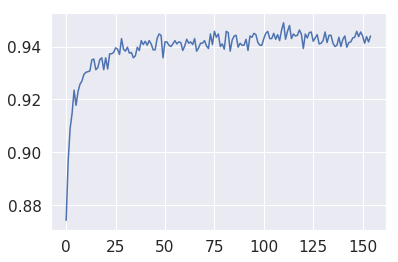

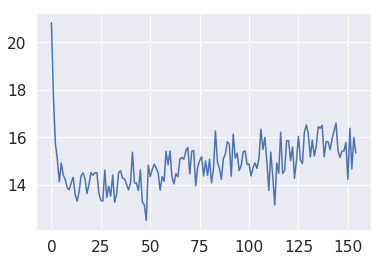

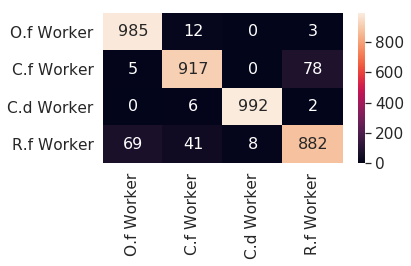

2 2
0 0
0 0
3 3
3 3
1 1
3 3
3 3
0 0
3 3
1 1
3 3
0 0
2 2
3 3
1 1
0 0
2 2
2 2
2 2
0 0
2 2
3 3
1 1
3 3
3 3
0 0
1 1
2 2
2 2
3 3
2 2
2 2
3 3
0 0
2 2
2 2
2 2
3 0
1 1
3 3
0 0
3 3
2 2
0 0
1 1
1 1
0 0
0 0
2 2
2 2
0 0
3 3
0 0
1 1
3 3
3 3
3 3
3 0
1 1
1 1
0 0
2 2
3 3
1 1
3 3
3 3
3 3
2 2
0 0
1 3
0 0
1 1
0 0
2 2
2 2
0 1
1 1
1 1
1 1
1 1
0 0
2 2
3 3
2 2
1 1
3 3
1 1
1 1
1 1
2 2
0 0
2 2
3 3
1 1
3 3
2 2
2 2
3 3
0 0
0 0
3 3
3 3
2 2
1 1
3 3
1 1
0 0
3 3
2 2
1 1
2 1
0 0
2 2
2 2
1 1
3 3
3 3
0 0
1 1
2 2
0 0
0 0
3 3
0 0
0 0
2 2
0 0
3 3
1 1
0 0
2 2
0 0
3 3
3 1
0 0
2 2
1 1
0 0
2 2
0 0
3 3
0 0
2 2
0 0
0 0
3 3
1 1
0 0
0 1
3 3
3 3
3 3
2 2
1 1
1 1
1 1
0 0
1 1
2 2
3 3
3 3
0 0
2 2
1 1
2 2
1 1
0 0
3 3
2 2
3 1
3 3
1 1
2 2
0 0
3 3
3 3
2 2
2 2
3 3
0 0
0 0
1 1
0 0
2 2
1 1
1 1
2 2
2 2
2 2
2 2
3 3
3 3
0 0
0 0
1 1
0 0
1 1
0 0
1 1
3 2
1 3
3 3
2 2
1 1
3 0
0 0
3 3
1 1
0 0
1 1
1 1
0 0
1 1
1 1
1 1
2 2
2 2
3 3
0 0
2 2
1 1
1 1
1 1
0 0
2 2
0 0
3 3
0 0
3 3
0 0
3 3
0 0
3 3
2 2
3 3
3 3
3 3
3 3
0 0
1 1
1 1
3 3
1 1
3 3
1 1
2 2
2 2
1 1
0 0


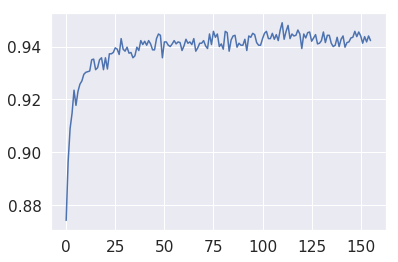

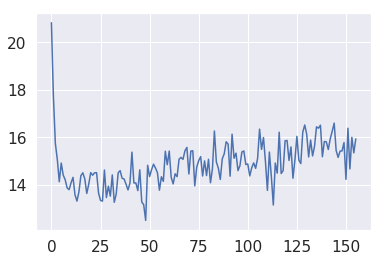

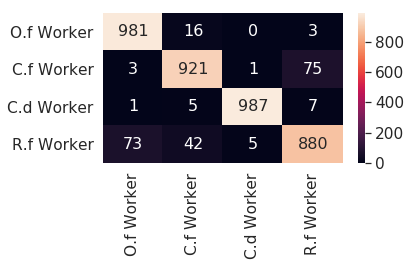

1 3
1 1
1 1
1 1
1 1
3 3
3 3
2 2
0 0
3 3
2 2
2 2
0 0
2 2
1 1
0 0
3 3
0 0
1 1
3 3
3 3
0 0
2 2
0 0
0 0
3 2
1 1
0 0
2 2
0 0
0 0
1 1
1 1
3 3
2 2
1 3
2 2
2 2
3 3
1 1
0 0
1 1
2 2
0 0
0 0
1 1
2 2
1 1
3 3
1 1
1 1
0 0
2 2
1 1
1 1
3 3
2 2
0 0
3 3
2 2
0 0
2 2
1 1
3 1
1 1
2 2
1 1
0 0
3 3
3 3
3 3
1 1
3 3
0 0
1 1
3 3
3 0
3 3
1 1
0 0
2 2
0 0
0 0
0 0
1 1
2 2
3 3
3 3
1 1
0 0
0 0
2 2
1 1
3 3
1 1
0 0
3 3
2 2
1 1
0 0
3 1
1 1
0 0
0 0
2 2
2 2
3 3
3 3
3 3
0 0
0 0
1 1
3 3
2 2
3 3
3 3
1 1
2 2
2 2
3 3
1 1
1 1
0 0
3 3
3 3
0 0
1 1
0 0
2 2
3 0
2 2
2 2
3 3
1 1
0 0
3 3
0 0
2 2
2 2
1 1
0 0
3 3
3 3
1 1
3 3
1 1
3 3
2 2
2 2
2 2
1 1
2 2
0 0
0 0
2 3
0 0
2 2
0 0
0 0
2 2
1 1
0 0
3 3
1 1
2 2
3 3
3 3
0 0
1 1
2 2
0 0
3 3
3 3
3 3
1 1
3 3
2 2
3 3
2 2
1 1
2 2
3 3
0 0
0 0
0 0
2 2
0 0
2 2
0 0
2 2
2 2
2 2
0 0
3 3
1 1
3 3
3 3
3 3
3 0
0 0
0 0
1 1
2 2
3 3
1 1
1 1
1 1
0 0
0 0
2 2
0 0
1 1
2 2
1 1
1 1
2 2
3 3
1 1
0 0
2 2
0 0
0 0
3 3
2 2
0 0
2 2
2 2
2 2
1 1
0 0
2 2
2 2
1 1
3 3
1 1
1 1
2 2
0 0
2 2
3 3
3 3
3 3
1 1
2 2
0 0
1 1
1 1
2 2
0 0
1 1


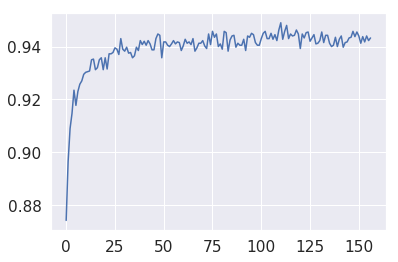

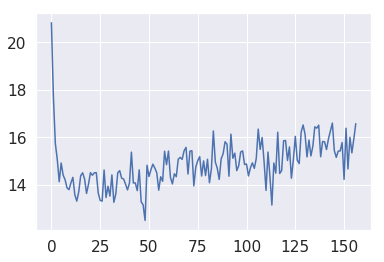

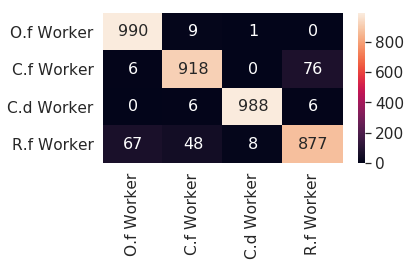

3 3
2 2
2 2
2 2
1 1
0 0
1 1
1 1
3 1
2 2
3 3
2 2
0 0
0 0
2 2
1 1
1 1
0 0
1 3
1 3
0 0
1 1
0 0
2 2
3 1
1 1
0 0
1 1
3 3
3 0
1 1
2 2
0 0
1 1
1 1
0 0
2 2
1 1
1 1
2 2
0 0
1 3
0 0
3 3
3 3
0 0
1 1
3 0
0 0
3 3
3 3
1 1
1 1
3 3
0 0
2 2
3 3
2 2
1 1
3 3
1 1
1 1
0 0
1 1
1 1
3 3
3 1
3 3
0 0
1 1
0 0
1 1
2 2
2 2
3 3
0 0
0 0
3 0
0 0
1 1
0 0
3 0
1 1
2 2
1 1
3 3
3 3
1 1
1 3
0 0
3 3
2 2
0 0
3 1
1 1
0 0
1 1
2 2
0 0
1 1
2 2
2 2
3 3
2 2
2 3
0 0
1 1
3 3
2 2
2 2
3 3
0 0
0 0
2 2
2 2
2 2
3 3
1 1
1 1
1 1
0 0
1 1
3 3
2 2
3 3
0 0
2 2
3 3
2 2
2 2
3 3
3 3
3 3
1 1
1 1
0 0
2 2
1 1
2 2
1 1
2 2
2 2
3 3
1 1
0 0
2 2
2 2
3 3
2 2
1 1
1 1
0 0
1 1
0 0
1 3
2 2
3 3
2 2
1 1
1 1
0 0
3 3
3 0
2 2
1 1
0 0
3 0
3 0
0 0
2 2
2 2
1 1
1 1
3 3
3 3
1 1
3 3
2 2
0 0
1 1
1 1
2 2
3 3
0 0
1 1
1 1
1 1
1 3
2 2
1 1
3 3
1 1
2 2
0 0
3 3
3 3
1 1
2 2
2 2
2 2
0 0
1 1
2 2
0 0
3 3
2 2
3 3
3 3
3 3
1 1
3 3
2 2
0 0
2 2
2 2
1 1
2 2
0 0
1 1
1 1
0 0
0 0
1 1
3 3
2 2
1 1
0 0
0 0
2 2
0 0
1 1
1 1
2 2
2 2
3 3
3 3
1 1
0 0
1 1
3 3
0 0
0 0
3 0
3 3
0 0
1 1
3 3
0 0
3 3
2 2


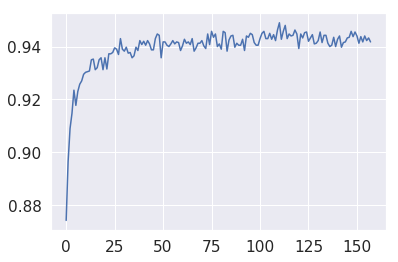

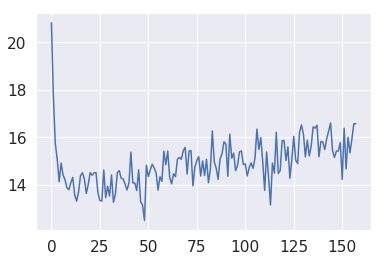

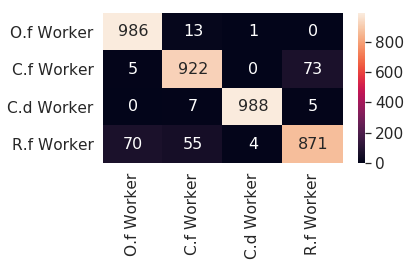

2 2
0 0
0 0
1 1
1 1
2 2
0 0
3 3
0 0
1 1
0 0
2 2
1 1
1 1
0 0
3 0
2 2
2 2
3 3
1 3
1 1
0 0
3 1
0 0
2 2
2 2
0 0
1 1
2 2
2 2
1 1
3 3
3 3
1 1
0 0
1 1
2 2
2 2
0 0
0 0
3 3
1 1
0 0
3 3
2 2
0 0
2 2
3 3
3 3
0 0
2 2
1 1
3 3
1 1
1 1
1 1
1 1
0 0
0 0
3 3
0 0
2 2
3 3
1 1
2 2
1 3
3 3
2 2
0 0
1 1
2 2
2 2
1 1
2 2
2 2
3 1
2 2
1 1
0 0
1 1
0 0
1 1
0 0
0 0
3 3
3 3
2 2
1 1
1 1
1 1
3 3
3 3
2 2
2 2
1 1
1 1
2 2
0 0
2 2
3 3
1 3
0 0
1 1
0 0
0 0
2 2
1 1
2 2
2 2
2 2
3 3
1 1
1 1
0 0
2 2
0 0
1 1
0 0
2 2
1 1
2 2
1 1
3 3
0 0
2 2
0 0
2 2
1 1
0 0
0 0
3 3
2 2
3 3
3 3
1 1
1 1
2 2
3 3
3 3
0 0
0 0
1 1
0 0
1 1
2 2
3 3
2 2
3 3
3 3
3 3
0 0
1 1
1 1
0 0
2 2
3 3
3 3
1 1
0 0
0 0
2 2
2 2
0 0
1 1
3 3
3 3
2 2
3 3
3 3
0 0
2 2
0 0
2 2
3 3
2 2
0 0
3 3
2 2
1 1
2 2
1 1
3 3
0 0
1 1
2 2
3 3
0 0
3 3
3 3
2 2
1 1
3 3
1 1
1 1
3 3
0 0
0 0
0 0
0 0
3 3
3 2
1 1
1 1
1 1
3 3
3 3
3 3
0 0
3 3
2 2
1 1
3 1
0 0
3 3
3 3
3 0
1 1
3 3
2 2
3 0
0 0
3 3
3 3
2 2
3 3
0 0
2 2
3 3
3 1
3 3
1 1
2 2
2 2
0 0
3 3
1 1
0 0
0 0
1 1
1 1
1 1
3 3
1 1
0 0
3 3
1 1
3 0
1 1
3 3
3 3


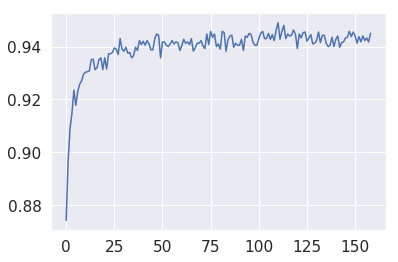

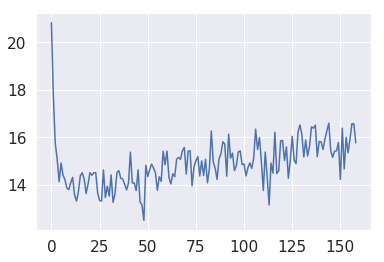

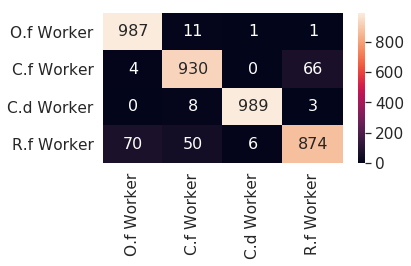

3 3
2 2
0 0
2 2
0 0
1 1
3 3
0 0
3 3
0 0
1 1
3 3
1 1
2 2
3 3
3 3
0 0
1 1
2 2
0 0
0 0
0 0
1 1
3 3
3 3
2 2
0 0
3 3
1 1
1 1
0 0
0 0
1 1
0 0
3 3
0 0
1 3
1 1
1 1
3 3
3 3
1 1
3 3
0 0
0 0
0 0
3 3
2 2
1 1
0 0
2 2
0 0
3 3
2 2
3 3
0 0
2 2
2 2
0 0
1 1
0 0
0 0
0 0
2 2
3 3
0 0
1 1
0 0
2 2
0 0
2 2
0 0
1 1
0 0
1 1
2 2
2 2
0 0
0 0
0 0
3 3
2 2
2 2
2 2
2 2
0 0
3 1
1 1
2 2
1 1
1 1
0 0
1 1
0 0
1 1
3 3
2 2
1 1
2 2
2 2
2 2
3 3
2 2
0 0
1 3
1 1
1 1
1 1
2 2
2 2
2 2
1 1
3 3
2 2
1 1
0 0
0 0
2 2
2 2
3 3
2 2
1 1
3 3
1 1
3 3
1 1
2 2
1 1
1 3
2 2
0 0
2 2
1 1
2 2
0 0
0 0
3 3
0 0
0 0
0 0
1 1
3 3
3 3
3 3
3 0
1 1
3 0
0 0
0 0
3 3
3 3
0 0
3 3
1 1
0 0
2 2
1 1
3 3
0 0
2 2
2 2
1 1
3 3
0 0
3 3
0 0
2 2
1 1
1 1
0 0
2 2
0 0
3 3
1 1
1 1
1 1
1 1
1 1
1 1
0 0
0 0
1 1
1 1
3 0
3 0
3 3
3 3
1 1
3 3
0 0
1 1
2 2
2 2
3 3
0 0
3 3
0 0
3 3
2 2
3 3
1 2
1 1
2 2
1 1
1 1
3 3
0 0
1 1
0 0
3 3
0 0
1 1
3 0
1 1
0 0
3 3
2 2
3 3
3 0
3 3
0 0
3 3
1 1
1 1
1 3
3 0
0 0
3 3
3 1
3 2
3 3
0 0
0 0
0 0
0 0
0 0
0 0
0 0
2 2
3 3
3 3
1 1
3 3
3 1
2 2
0 0
1 1
2 2
3 3
0 0


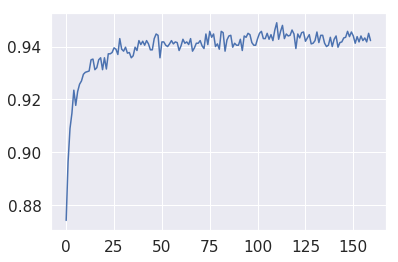

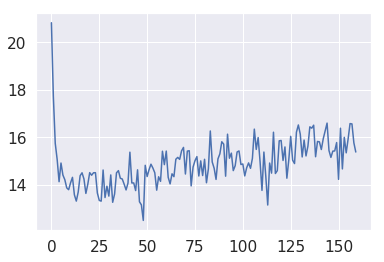

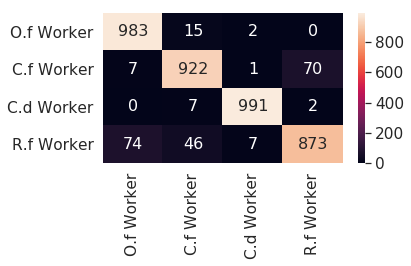

3 3
1 1
2 2
0 0
2 2
1 1
0 0
1 1
1 1
1 1
0 0
2 2
2 2
1 3
0 0
1 3
0 0
3 3
3 3
0 0
0 0
3 3
3 3
2 2
2 2
0 0
1 1
2 2
1 1
0 0
1 1
1 1
2 2
2 2
1 1
2 2
3 3
1 1
0 0
1 1
0 0
0 0
2 2
1 1
1 1
1 1
3 3
0 0
0 0
2 2
1 1
3 3
0 0
2 2
3 3
3 3
1 1
2 2
2 2
3 3
2 2
0 0
0 0
0 0
2 2
3 3
2 2
0 0
2 2
0 0
1 1
2 2
0 0
1 1
3 3
3 3
2 2
3 3
2 2
1 1
1 1
3 3
2 2
2 2
2 2
1 1
0 0
1 1
1 1
1 3
2 2
1 1
3 3
2 2
2 2
0 0
2 2
1 0
2 2
3 3
1 1
1 1
2 2
1 1
2 2
1 1
0 0
2 2
1 1
2 2
2 2
1 1
2 2
0 0
3 3
1 1
1 1
0 0
1 1
1 1
1 1
2 2
1 1
1 1
2 2
3 3
2 2
1 3
0 0
1 1
2 2
1 1
0 0
3 3
3 3
2 2
2 2
0 0
0 0
1 1
1 1
1 1
3 3
1 1
2 2
1 1
1 1
3 3
1 1
3 3
3 3
0 0
1 1
3 3
2 2
2 2
1 1
3 3
2 2
2 2
0 0
0 0
3 0
0 0
2 2
1 1
3 3
1 3
0 0
2 2
1 1
1 1
3 3
0 0
1 3
0 0
3 3
3 3
2 2
3 3
1 1
3 3
2 2
1 3
1 1
1 1
2 2
2 2
0 0
1 1
1 1
1 1
3 3
3 3
0 0
0 0
2 2
3 0
3 3
3 3
3 3
2 2
0 0
0 1
3 3
3 3
2 2
2 2
2 2
3 3
0 0
2 2
1 1
3 3
0 0
2 2
3 3
0 0
1 1
0 0
3 3
3 3
1 1
2 2
1 1
3 3
2 2
2 2
0 0
2 2
2 2
1 1
0 0
3 3
2 2
0 0
0 0
1 1
1 1
2 2
0 0
0 0
0 0
2 2
0 0
2 2
1 1
0 0
1 1
0 0


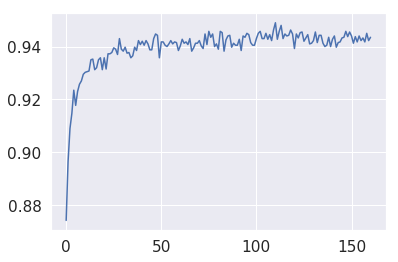

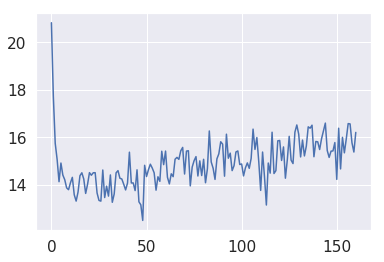

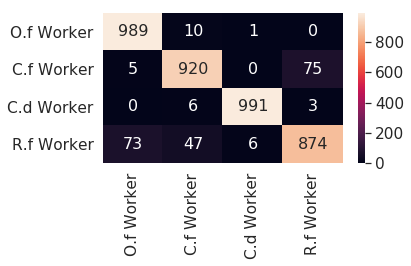

2 2
3 3
1 1
2 2
3 3
1 1
3 3
1 1
2 2
0 0
2 2
3 3
1 1
1 1
0 0
2 2
2 2
2 2
1 1
0 0
3 3
3 3
1 3
0 0
1 1
1 1
3 3
0 0
1 1
0 0
0 0
2 2
0 0
3 3
2 2
3 3
0 0
1 1
2 2
3 3
2 2
0 0
0 0
1 1
2 2
2 2
2 2
1 1
0 0
1 1
1 1
0 0
0 0
1 1
2 2
0 0
0 0
2 2
3 3
1 1
1 1
2 2
2 2
0 0
2 2
2 2
0 0
2 2
3 3
3 3
3 3
2 2
0 0
2 2
1 1
3 3
0 0
0 0
3 3
0 0
1 1
2 2
0 0
1 1
0 0
0 0
1 1
0 0
2 2
0 0
3 3
2 2
1 1
0 0
3 3
0 0
2 2
2 2
3 3
1 1
1 1
0 0
3 3
3 3
0 0
1 1
3 3
2 2
2 2
2 2
0 0
1 1
0 0
2 2
2 2
3 0
2 2
0 0
1 1
1 1
2 2
0 0
3 3
0 0
1 1
1 3
1 1
3 3
0 0
3 3
2 2
3 3
1 1
1 1
1 1
3 3
3 3
1 3
3 3
1 1
2 2
2 2
2 2
2 2
1 1
0 0
0 0
1 1
0 0
0 0
1 1
3 3
1 1
2 2
2 2
2 2
1 1
1 1
2 2
2 2
0 0
3 3
0 0
2 2
3 3
1 1
0 0
3 3
3 0
2 2
1 1
2 2
3 3
2 2
0 0
0 0
1 1
1 1
0 0
2 2
0 0
2 2
1 1
2 2
1 1
3 3
1 1
1 1
0 0
3 3
2 2
3 3
1 1
2 2
0 0
2 2
1 1
3 0
1 1
0 0
2 2
3 0
2 2
1 1
3 3
3 1
0 0
2 2
3 3
3 0
0 0
2 2
2 2
3 3
1 1
3 3
3 3
2 2
2 2
1 1
3 3
2 2
0 0
1 1
3 0
2 2
0 0
0 0
2 2
2 2
2 2
2 2
3 3
0 0
3 3
2 2
3 3
3 3
0 0
3 3
2 2
3 3
1 1
2 2
3 3
3 3
2 1
1 1
0 0
3 3


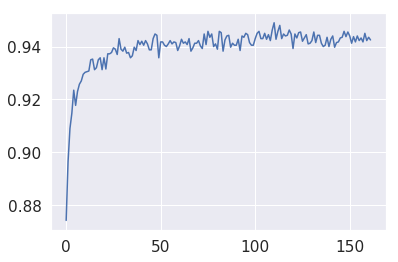

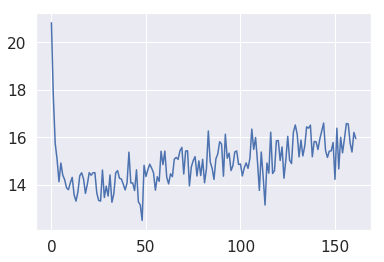

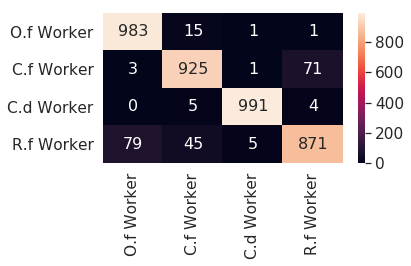

2 2
2 2
3 3
2 2
0 0
1 1
1 1
0 0
1 1
2 2
1 1
2 2
3 3
2 2
0 0
1 1
2 2
0 0
3 3
3 3
1 1
3 1
3 3
1 1
3 3
3 3
1 1
0 0
2 2
2 2
3 0
1 1
3 3
0 0
1 1
1 1
2 2
2 2
2 2
1 1
3 3
3 3
1 1
1 1
0 0
0 0
1 1
1 1
1 1
3 3
3 3
2 2
0 0
1 1
2 2
1 3
2 2
3 3
0 0
3 3
2 2
3 3
1 1
2 2
0 0
0 0
1 1
3 3
2 2
2 2
2 2
3 3
0 0
0 0
3 3
3 3
2 2
0 0
2 2
2 2
3 3
2 2
3 3
2 2
0 0
3 3
3 3
0 0
0 0
2 2
0 0
2 2
0 0
1 1
3 3
3 3
3 3
3 2
3 3
1 1
3 3
1 1
2 2
0 1
1 1
1 1
0 0
0 0
3 3
3 1
0 0
2 2
2 2
3 3
2 2
0 0
0 0
0 0
2 2
1 1
1 1
0 0
1 1
2 2
1 1
1 1
0 0
0 0
2 2
3 3
1 1
3 3
1 1
2 2
0 0
2 2
0 0
1 1
3 0
2 2
1 1
0 0
3 3
2 2
3 3
2 2
3 3
0 0
0 0
0 0
3 3
2 2
2 2
0 0
3 3
0 0
0 0
3 3
0 0
3 3
3 3
0 0
0 0
0 0
0 0
3 3
2 2
0 0
3 3
0 0
0 0
3 3
3 3
1 1
3 3
2 2
2 2
1 1
1 1
1 1
3 3
2 2
1 1
1 1
3 3
3 3
1 1
3 3
0 0
3 3
3 3
1 1
2 2
3 3
1 1
3 3
0 0
0 0
1 3
0 0
0 0
3 3
3 0
0 0
3 3
3 0
3 3
1 1
1 1
0 0
1 1
0 0
1 1
1 1
3 3
2 2
3 3
3 3
0 0
0 0
0 0
1 1
0 0
0 0
3 3
2 2
3 3
3 3
3 3
3 3
2 2
0 0
2 2
0 0
0 0
3 3
2 2
1 1
3 3
2 2
1 1
1 1
2 2
0 0
0 0
3 3
2 2
0 0
3 3
0 0


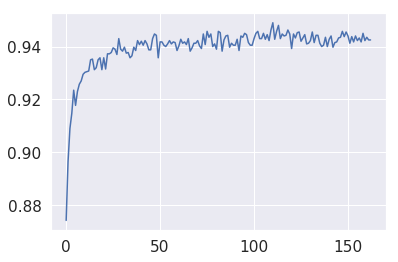

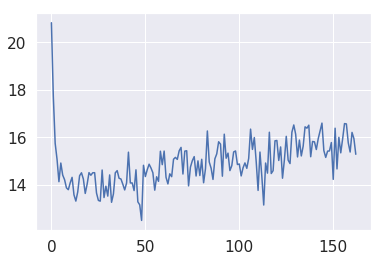

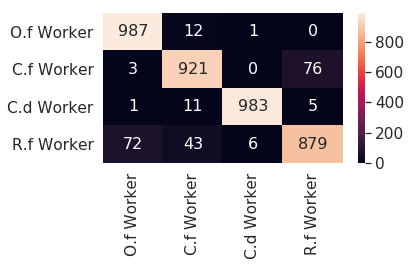

1 1
2 2
0 0
3 3
1 1
2 2
0 0
2 2
2 2
1 1
0 0
2 2
3 3
1 1
2 2
0 0
3 3
3 3
3 3
1 3
1 1
0 0
1 1
0 0
3 3
1 1
0 0
0 0
0 0
1 1
3 3
0 0
3 3
0 0
0 0
2 2
2 2
0 0
2 2
0 0
1 1
0 0
0 0
2 2
2 2
2 2
3 3
2 2
0 0
1 3
2 2
0 0
2 2
3 3
1 1
0 0
0 0
3 3
3 3
0 0
2 2
1 1
2 2
0 0
0 0
2 2
0 0
0 0
0 0
1 1
0 0
1 1
3 3
0 0
3 3
3 3
0 0
0 0
1 1
1 1
2 2
0 0
0 0
1 1
3 3
0 0
3 3
1 1
3 3
2 2
3 3
2 2
1 3
0 0
1 1
2 2
2 2
3 3
1 1
2 2
3 3
1 1
3 3
0 0
0 0
3 3
1 1
2 2
0 0
2 2
1 1
2 2
2 2
1 1
2 2
1 1
0 0
2 2
2 2
0 0
1 1
3 3
2 2
3 0
0 0
3 3
3 3
0 0
1 1
3 3
1 1
2 2
0 0
1 3
1 1
2 2
0 0
2 2
3 3
1 1
0 0
0 0
1 1
1 1
3 3
0 0
0 0
3 3
3 3
0 0
0 0
3 3
0 0
0 0
2 2
3 1
3 3
2 2
2 2
2 2
1 1
2 2
2 2
1 1
2 2
0 0
3 3
1 1
2 2
0 0
3 3
0 0
0 0
0 0
0 0
1 1
2 2
3 3
1 1
0 0
3 3
3 3
3 3
3 3
2 2
0 0
3 3
1 1
1 1
1 1
1 1
1 1
0 0
0 0
0 0
2 2
0 0
0 0
2 2
2 2
3 3
3 3
2 2
2 2
2 2
3 1
3 3
2 2
0 0
0 0
0 0
1 1
2 2
3 3
3 3
0 0
1 1
3 3
3 3
3 3
0 0
0 0
1 1
2 2
3 3
1 1
3 3
2 2
2 2
1 1
1 1
0 0
1 1
0 0
2 2
0 0
2 2
0 0
1 3
0 0
0 0
2 2
0 0
2 2
3 3
1 1
1 1
2 2
2 2
0 0


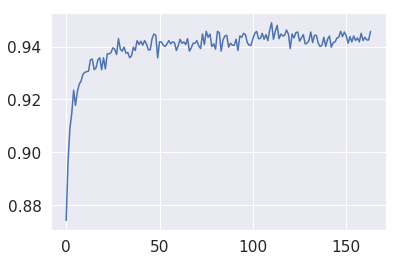

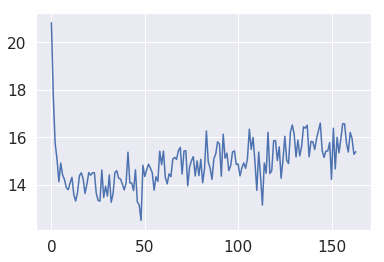

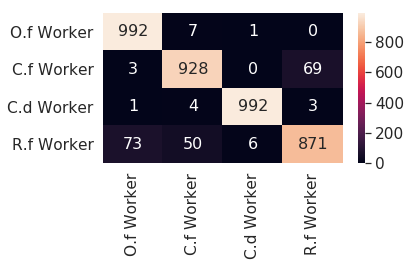

In [18]:
import seaborn as sn
import pandas as pd
import matplotlib.pyplot as plt

classes2 = ["O.f Worker","C.f Worker", "C.d Worker", "R.f Worker"]
test_acc = []
test_loss = []
for model_num in range(1, EPOCH+1):
    wrong_images = []
    wrong_answer = []
    actual_answer = []
    weight_path = model_directory + "%03d_weights.pt" % (model_num)
    state_dict = torch.load(weight_path)
    model.load_state_dict(state_dict)
    running_loss = 0.0
    total = 0
    correct = 0
    confusion_matrix = torch.zeros(len(classes2), len(classes2))
    for step, (labels, images, paths) in enumerate(testloader):
        optimizer.zero_grad()
        images = images.detach().cuda()
        labels = labels.detach().cuda()
        outputs = model(images)
        _, predicted = torch.max(outputs.data, 1)
        # append to the wrong list (test log file)
        for i in range(len(predicted)):
            if predicted[i] != labels[i]:
#                 print(paths[i], predicted[i], labels[i])
                wrong_images.append(paths[i])
                wrong_answer.append(predicted[i].item())
                actual_answer.append(labels[i].item())
        loss = criterion(outputs, labels)
        running_loss += loss.item()
        total += labels.size(0)
        correct += (predicted == labels).sum().item()
        for t, p in zip(labels.view(-1), predicted.view(-1)):
            print(t.item(), p.item())
#             mapp = {4: 2}
        
#             confusion_matrix[mapp[t.item()], mapp[p.item()]] += 1
            confusion_matrix[t.item(), p.item()] += 1
    
    acc = correct / total
    print('\n[%d] accuracy: %.3f loss: %.3f\n' % (model_num, acc, running_loss))
    
    test_acc.append(acc)
    test_loss.append(running_loss)
    print(test_acc)
    print(test_loss)
    plt.figure()
    plt.plot(range(0,model_num), test_acc)
    plt.savefig(test_directory + "test_acc_E%03d.jpg" % (model_num), dpi=500)
    plt.show()
    plt.figure()
    plt.plot(range(0,model_num), test_loss)
    plt.savefig(test_directory + "test_loss_E%03d.jpg" % (model_num), dpi=500)
    plt.show()
    
    
#     print(wrong_answer)
    with open(test_directory + "%03d_wrong.txt" % (model_num), 'w') as wrong:
#         c = zip(wrong_images, wrong_answer, actual_answer)
#         c = sorted(c)
#         (wrong_images, wrong_answer, actual_answer) = zip(*c)
#         print(wrong_images)
        for i in range(len(wrong_images)):
            wrong.write(wrong_images[i] + " " + classes[wrong_answer[i]] + " " + classes[actual_answer[i]])
#             print(wrong_images[i] + " " + classes[wrong_answer[i]] + " " + classes[actual_answer[i]])
            wrong.write("\n")
        wrong.close()
#     print(confusion_matrix)
    confusion_matrix = confusion_matrix.numpy().astype(int)
#     print(confusion_matrix)
    df_cm = pd.DataFrame(confusion_matrix, index = [i for i in classes2],
                  columns = [i for i in classes2])
#     print(df_cm)
    sn.set(font_scale=1.4)#for label size
#     print(classes)
    img = sn.heatmap(df_cm, annot=True,annot_kws={"size": 16}, fmt="d")
    figure = img.get_figure()
    plt.tight_layout()
    plt.savefig(test_directory + "confusion_matrix_%03d.jpg" % (model_num), dpi=500)
    plt.show()
    


In [19]:
resultfile = open(model_directory+"test_results.txt", "a")
resultfile.write("test")
resultfile.write("\n")
resultfile.write(str(test_acc))
resultfile.write("\n")
resultfile.write(str(test_loss))
resultfile.write("\n")
resultfile.close()
